In [1]:
from scipy.sparse import csr_matrix
from scipy.sparse.csgraph import minimum_spanning_tree

In [2]:
import numpy as np

import matplotlib as mpl
mpl.rcParams['savefig.dpi'] = 100
mpl.rcParams['figure.dpi'] = 100

import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
import string
import mplcursors
import collections
import sklearn.cluster
import os
from tqdm import tqdm_notebook
#%matplotlib inline
%matplotlib notebook
#%matplotlib notebook

<IPython.core.display.Javascript object>


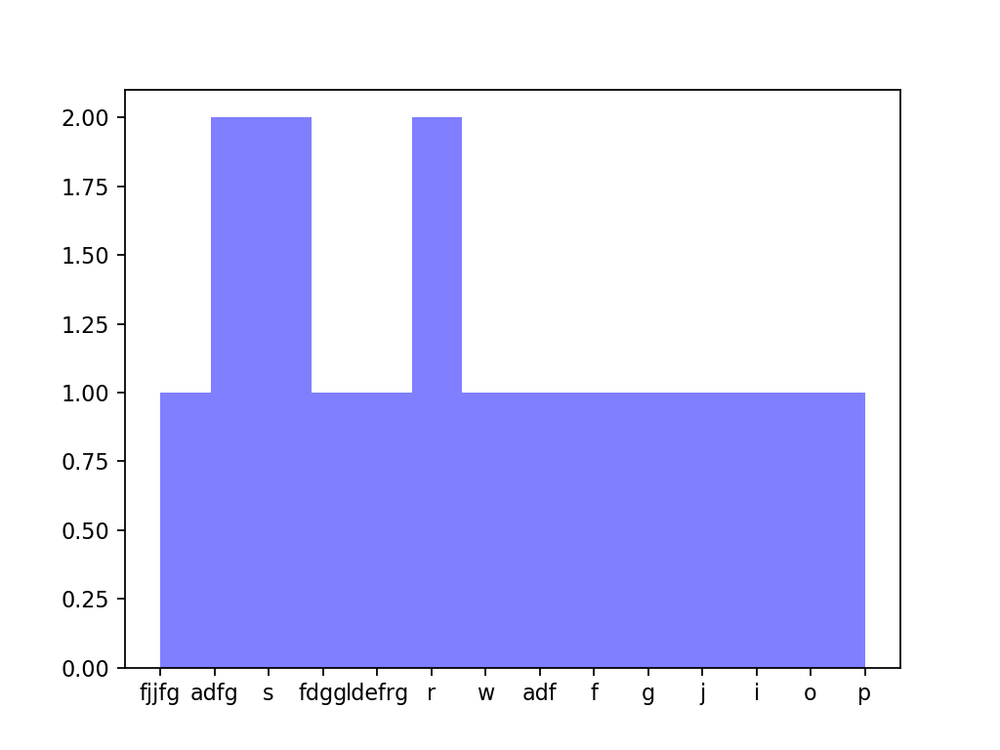

In [4]:
x = [21,22,23,4,5,6,77,8,9,10,31,32,32,33,34,35,36,37,18,49,50,100]
x = ["fjjfg", "adfg", "adfg", "s", "fdgg", "ldefrg", "r", "s", "r", "w", "adf", "f", "g", "j", "i", "o", "p"]
num_bins = len(np.unique(x))
n, bins, patches = plt.hist(x, num_bins, facecolor='blue', alpha=0.5)
plt.show()

In [93]:
hs = [1,5,6,2,8,15,83,42,74]

plt.bar(np.arange(len(hs)), hs, width=1)
plt.show()

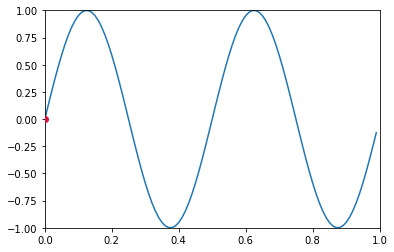

In [4]:
import matplotlib.pyplot as plt
import matplotlib.widgets as widgets
import numpy as np


class SnaptoCursor(object):
    def __init__(self, ax, x, y):
        self.ax = ax
        self.ly = ax.axvline(color='k', alpha=0.2)  # the vert line
        self.marker, = ax.plot([0],[0], marker="o", color="crimson", zorder=3) 
        self.x = x
        self.y = y
        self.txt = ax.text(0.7, 0.9, '')

    def mouse_move(self, event):
        if not event.inaxes: return
        x, y = event.xdata, event.ydata
        indx = np.searchsorted(self.x, [x])[0]
        x = self.x[indx]
        y = self.y[indx]
        self.ly.set_xdata(x)
        self.marker.set_data([x],[y])
        self.txt.set_text('x=%1.2f, y=%1.2f' % (x, y))
        self.txt.set_position((x,y))
        self.ax.figure.canvas.draw_idle()

t = np.arange(0.0, 1.0, 0.01)
s = np.sin(2*2*np.pi*t)
fig, ax = plt.subplots()

#cursor = Cursor(ax)
cursor = SnaptoCursor(ax, t, s)
cid =  plt.connect('motion_notify_event', cursor.mouse_move)

ax.plot(t, s,)
plt.axis([0, 1, -1, 1])
plt.show()

#hs = [1,5,6,2,8,15,83,42,74]
#ax.bar(np.arange(len(hs)), hs, width=1)
#plt.show()

<IPython.core.display.Javascript object>


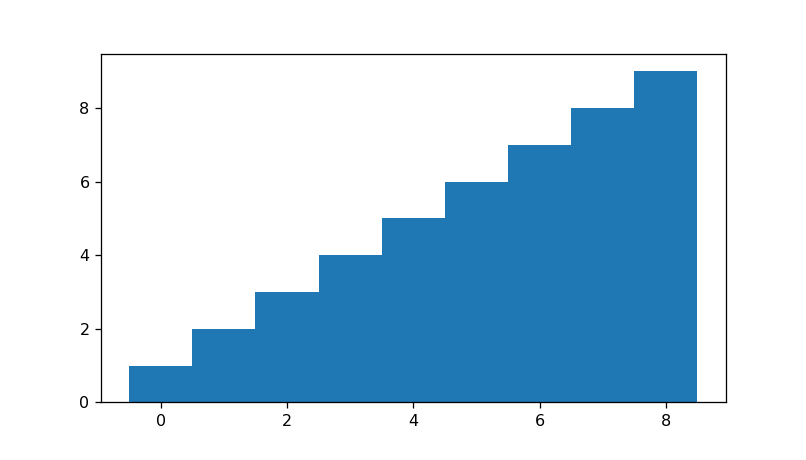

In [1059]:
import string
import matplotlib.pyplot as plt
import mplcursors

fig, ax = plt.subplots(1, 1, figsize=(7, 4))

ax.bar(range(9), range(1, 10), align="center", width=1)
labels = string.ascii_uppercase[:9]
#ax.set(xticks=range(9), xticklabels=labels, title="Hover over a bar")

cursor = mplcursors.cursor(hover=True)
@cursor.connect("add")
def on_add(sel):
    x, y, width, height = sel.artist[sel.target.index].get_bbox().bounds
    #sel.annotation.set(text=f"{x+width/2}: {height}", position=(0, 20))
    #sel.annotation.xy = (x + width / 2, y + height)
    sel.annotation.set_text(f'x={int(x + 0.5)} h={int(height)}')
    
def format_coord(x, y):
    col = int(x + 0.5)
    return 'x=%1.4f, y=%1.4f' % (col, y)

ax.format_coord = format_coord

plt.show()

In [1040]:
#RESULTS_FOR_HIST_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/result_for_hist_big_data"
RESULTS_FOR_HIST_PATH = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50"

In [10]:
#considered_patterns = ["9 35", "10 136", "11 719", "14 239", "18 800", "22 3921", "25 8331", "27 3622", "27 7869"]

In [11]:
import string
import matplotlib.pyplot as plt
import mplcursors

cursor = mplcursors.cursor(hover=True)
@cursor.connect("add")
def on_add(sel):
    x, y, width, height = sel.artist[sel.target.index].get_bbox().bounds
    sel.annotation.set_text(f'x={int(x + 0.5)} h={int(height)}')
    
def format_coord(x, y):
    col = int(x + 0.5)
    return 'x=%1.4f, y=%1.4f' % (col, y)

def show_hist(hist_data):
    fig, ax = plt.subplots(1, 1, figsize=(9, 3))
    ax.bar(range(len(hist_data)), hist_data, align="center", width=1)

    ax.format_coord = format_coord
    plt.show()

In [23]:
def print_hist_for_pattern(pattern, ngram, A, B):
    hist_path = RESULTS_FOR_HIST_PATH + "/" + pattern + "/" + str(ngram) + "gram" + "/" + "hist.txt"
    hist_file = open(hist_path, "r")
    hist_data = hist_file.read().split(" ")
    #print(hist_data)
    hist_data = [int(elem) for elem in hist_data if elem != '']
    hist_data = hist_data[A:B]
    show_hist(hist_data)
    hist_file.close()

In [24]:
def print_hist_for_sample(pattern, sample, ngram, A, B):
    hist_path = RESULTS_FOR_HIST_PATH + "/" + pattern + "/" + str(ngram) + "gram" + "/" + sample + "_hist.txt"
    hist_file = open(hist_path, "r")
    hist_data = hist_file.read().split(" ")
    #print(hist_data)
    hist_data = [int(elem) for elem in hist_data if elem != '']
    #print(len(hist_data))
    hist_data = hist_data[A:B]
    #print(hist_data)
    show_hist(hist_data)

<IPython.core.display.Javascript object>


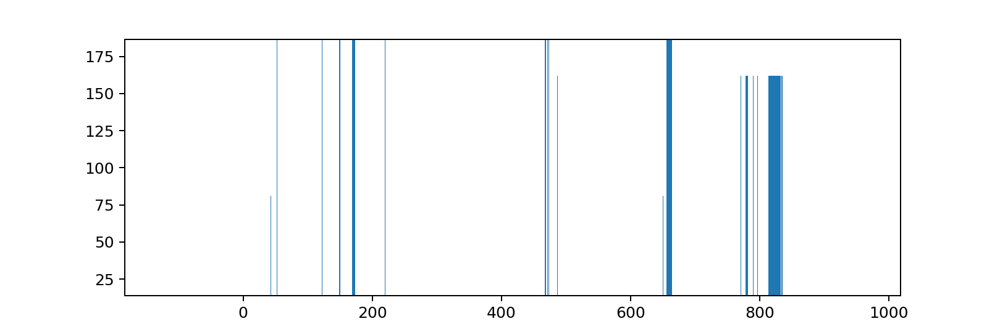

In [34]:
print_hist_for_pattern("9 35", 7, 0, -1)

<IPython.core.display.Javascript object>


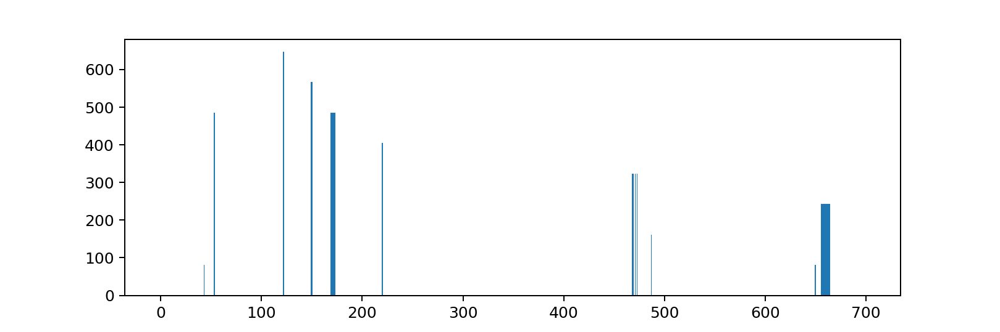

In [37]:
print_hist_for_pattern("9 35", 7, 0, 700)

### Considering particular samples:

<IPython.core.display.Javascript object>


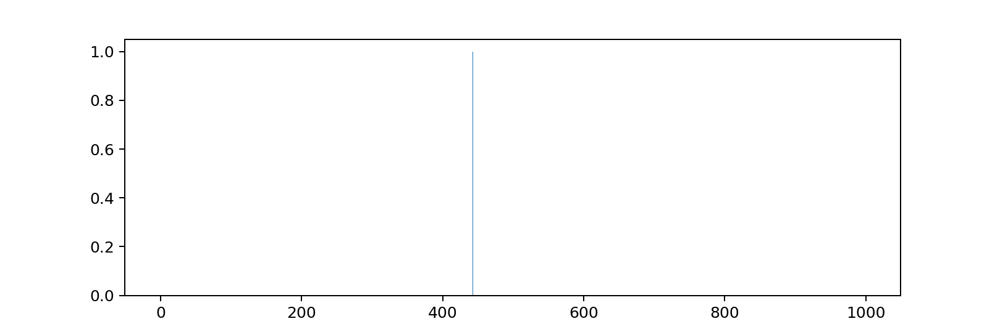

<IPython.core.display.Javascript object>


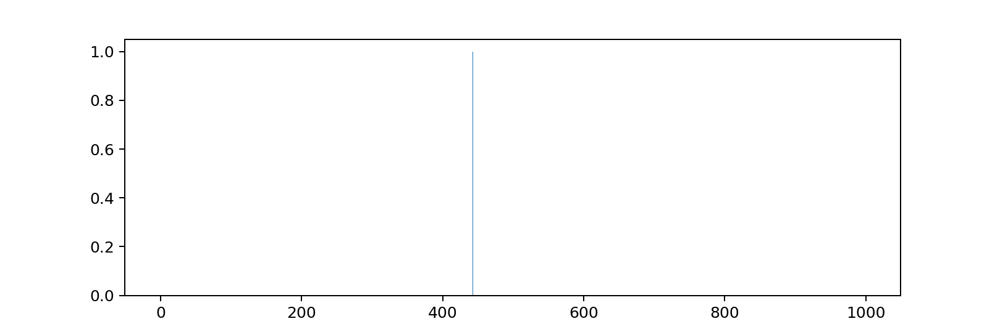

<IPython.core.display.Javascript object>


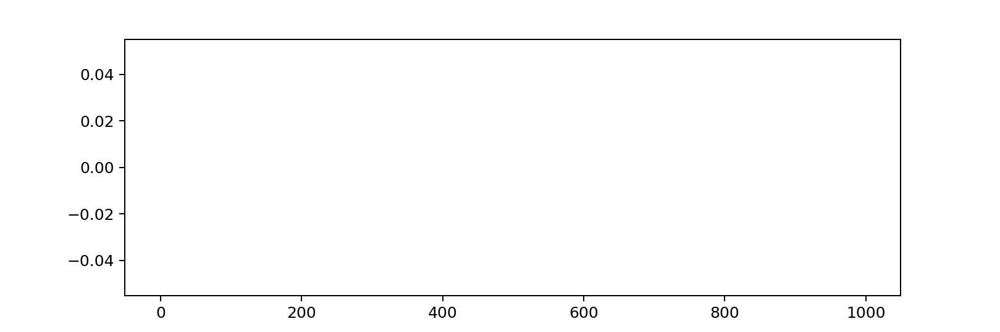

<IPython.core.display.Javascript object>


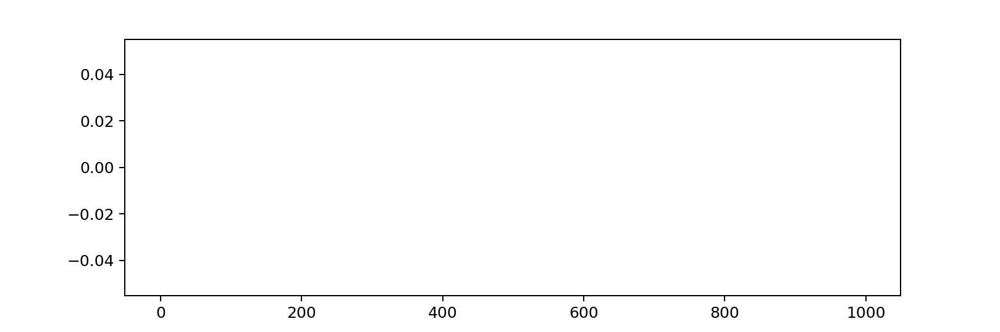

In [81]:
print_hist_for_sample("6 3264", "sampleChange1", 5, 0, 1000)
print_hist_for_sample("6 3264", "sampleChange2", 5, 0, 1000)
print_hist_for_sample("6 3264", "sampleChange3", 5, 0, 1000)
print_hist_for_sample("6 3264", "sampleChange4", 5, 0, 1000)

In [ ]:
print_hist_for_pattern("10 136", 7, 0, -1)

In [ ]:
print_hist_for_pattern("11 719", 7, 0, -1)

In [ ]:
print_hist_for_pattern("14 239", 7, 0, -1)

In [ ]:
print_hist_for_pattern("18 800", 7, 0, -1)

<IPython.core.display.Javascript object>


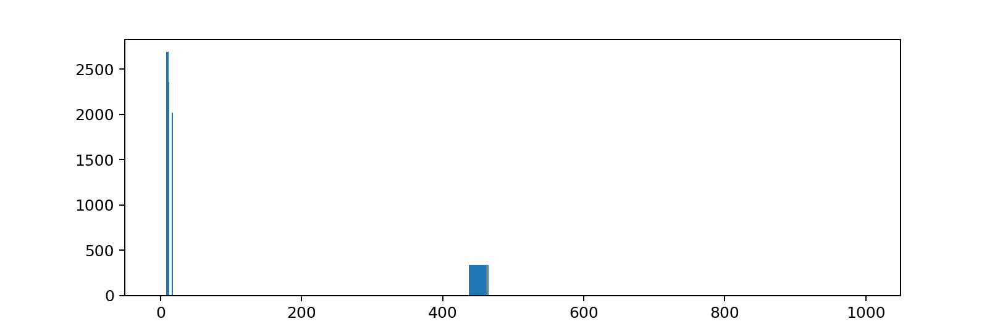

<IPython.core.display.Javascript object>


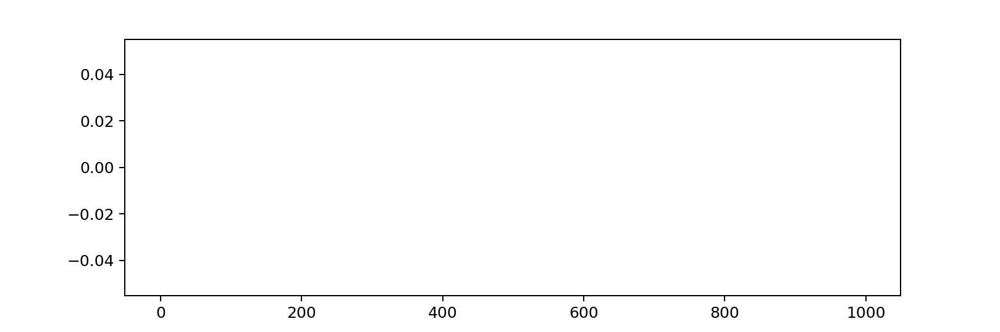

<IPython.core.display.Javascript object>


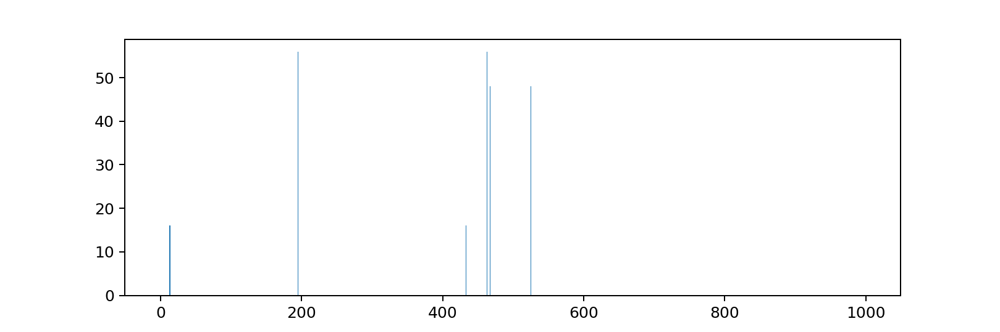

In [38]:
print_hist_for_pattern("22 3921", 7, 0, 1000)
print_hist_for_pattern("25 8331", 7, 0, 1000)
print_hist_for_pattern("27 3622", 7, 0, 1000)

<IPython.core.display.Javascript object>


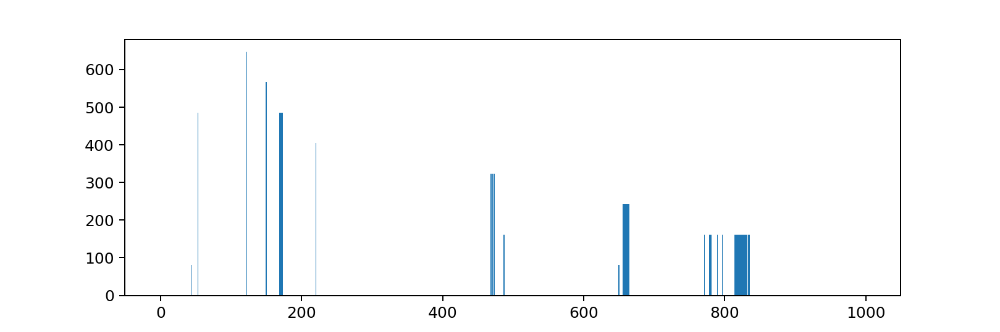

<IPython.core.display.Javascript object>


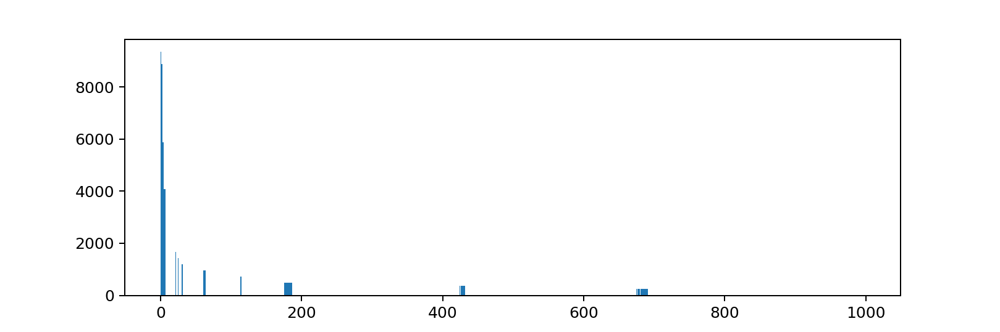

In [18]:
print_hist_for_pattern("9 35", 7, 0, 1000)
print_hist_for_pattern("11 719", 7, 0, 1000)

<IPython.core.display.Javascript object>


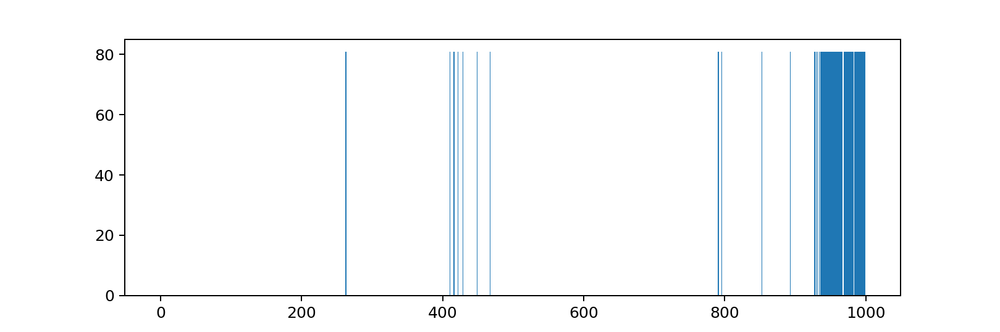

<IPython.core.display.Javascript object>


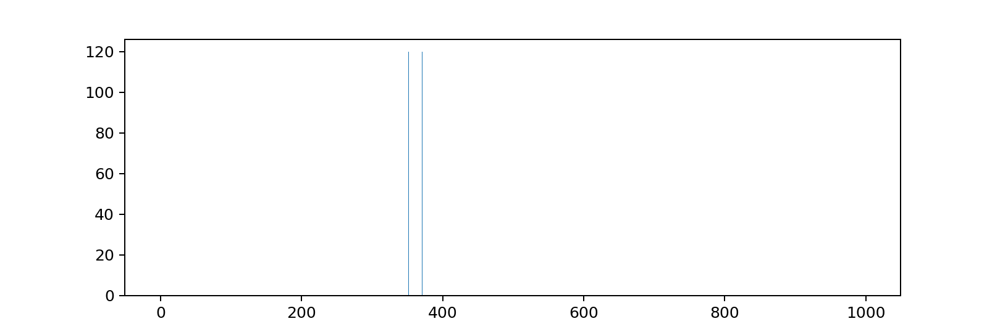

In [19]:
print_hist_for_pattern("9 35", 7, 1000, 2000)
print_hist_for_pattern("11 719", 7, 1000, 2000)

In [25]:
def print_hist_for_edit_script(edit_script, A, B):
    hist_path = RESULTS_FOR_HIST_PATH + "/" + edit_script + "/" + "hist.txt"
    hist_file = open(hist_path, "r")
    hist_data = hist_file.read().split(" ")
    #print(hist_data)
    hist_data = [int(elem) for elem in hist_data if elem != '']
    hist_data = hist_data[A:B]
    show_hist(hist_data)

<IPython.core.display.Javascript object>


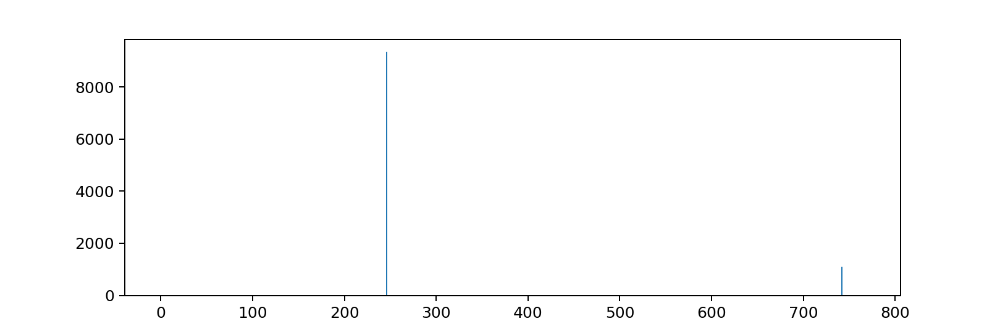

In [24]:
edit_script = "DEL 32@@ DEL 21@@ DEL 42@@ DEL 32@@ DEL 21@@"
print_hist_for_edit_script(edit_script, 0, -1)

<IPython.core.display.Javascript object>


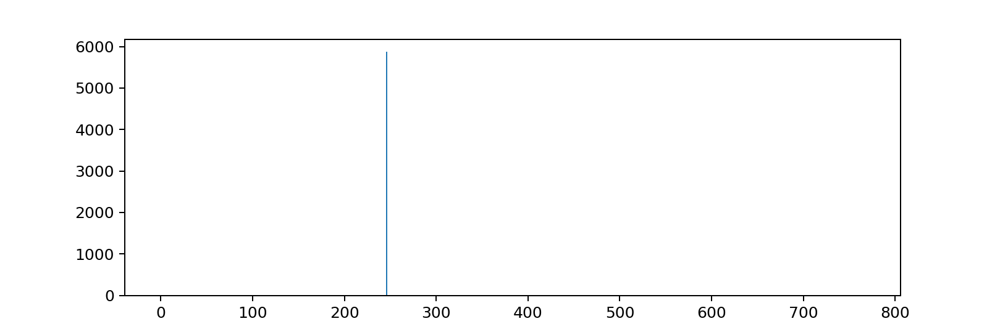

In [25]:
edit_script = "INS 32@@ 32@@ at 0 MOV 42@@ 32@@ at 1 MOV 3@@ 32@@ at 2 MOV 3@@ 32@@ at 3 INS 32@@ 32@@ at 0"
print_hist_for_edit_script(edit_script, 0, -1)

In [ ]:
edit_script = "INS 42@@ 32@@ at 0 INS 42@@ 32@@ at 1 INS 40@@ 32@@ at 2 INS 9@@ 32@@ at 3 MOV 21@@ 8@@ at 0"
print_hist_for_edit_script(edit_script, 0, -1)

In [ ]:
edit_script = "INS 8@@ 25@@ at 1 INS 32@@ 25@@ at 0 INS 8@@ 25@@ at 1 INS 32@@ 25@@ at 0 INS 8@@ 25@@ at 1"
print_hist_for_edit_script(edit_script, 0, -1)

In [ ]:
edit_script = "INS 32@@ 59@@ at 1 INS 42@@ 43@@ at 0 INS 42@@ 59@@ at 0 MOV 32@@ 59@@ at 1 INS 42@@ 32@@ at 0"
print_hist_for_edit_script(edit_script, 0, -1)

<IPython.core.display.Javascript object>


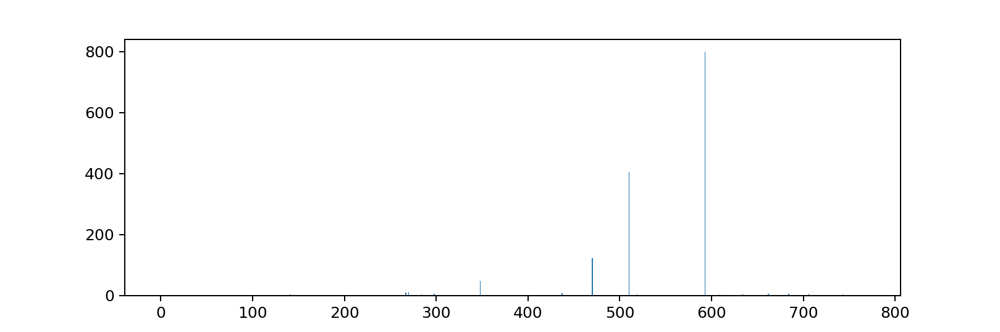

In [29]:
edit_script = "MOV 42@@ 32@@ at 0 UPD 42@@ MOV 42@@ 32@@ at 1 UPD 42@@ MOV 42@@ 32@@ at 2"
print_hist_for_edit_script(edit_script, 0, -1)

      MOV SimpleName@@ to MethodInvocation@@ at 0    
      UPD SimpleName@@ 
      MOV SimpleName@@ to MethodInvocation@@ at 1 
      UPD SimpleName@@ 
      MOV SimpleName@@ to MethodInvocation@@ at 2
#### Patterns:
    141 (4)
    160 (2)
    267 (10)
    270 (11)
    348 (48)
    437 (7)
    470 (123)
    510 (400)
    593 (800)

In [32]:
edit_script = "MOV 42@@ 32@@ at 0 UPD 42@@ MOV 42@@ 32@@ at 1 UPD 42@@ MOV 42@@ 32@@ at 2"
hist_path = RESULTS_FOR_HIST_PATH + "/" + edit_script + "/" + "hist.txt"
hist_file = open(hist_path, "r")
hist_data = hist_file.read().split(" ")
#print(hist_data)
hist_data = [int(elem) for elem in hist_data if elem != '']

hist_data[270]

11

In [ ]:
RESULTS_FOR_HIST_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/result_for_hist_big_data"

<IPython.core.display.Javascript object>


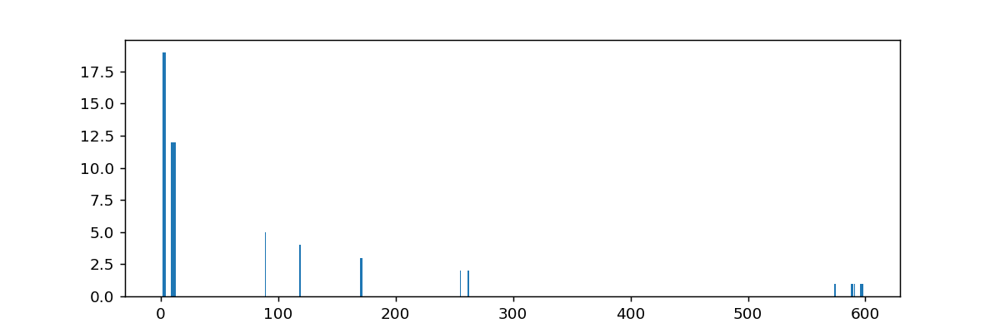

<IPython.core.display.Javascript object>


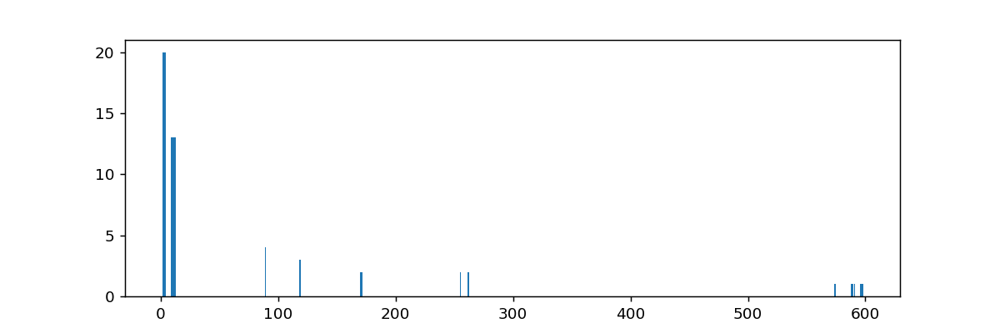

<IPython.core.display.Javascript object>


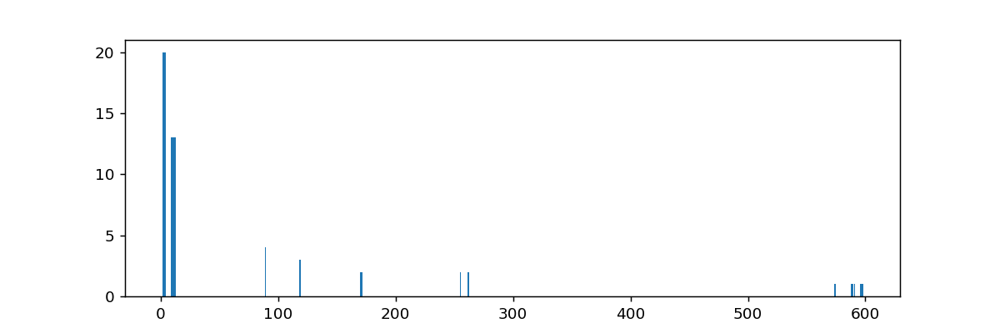

In [200]:
print_hist_for_sample("11 719", "sampleChange1", 5, 0, 600)
print_hist_for_sample("11 719", "sampleChange4", 5, 0, 600)
print_hist_for_sample("11 719", "sampleChange46", 5, 0, 600)

<IPython.core.display.Javascript object>


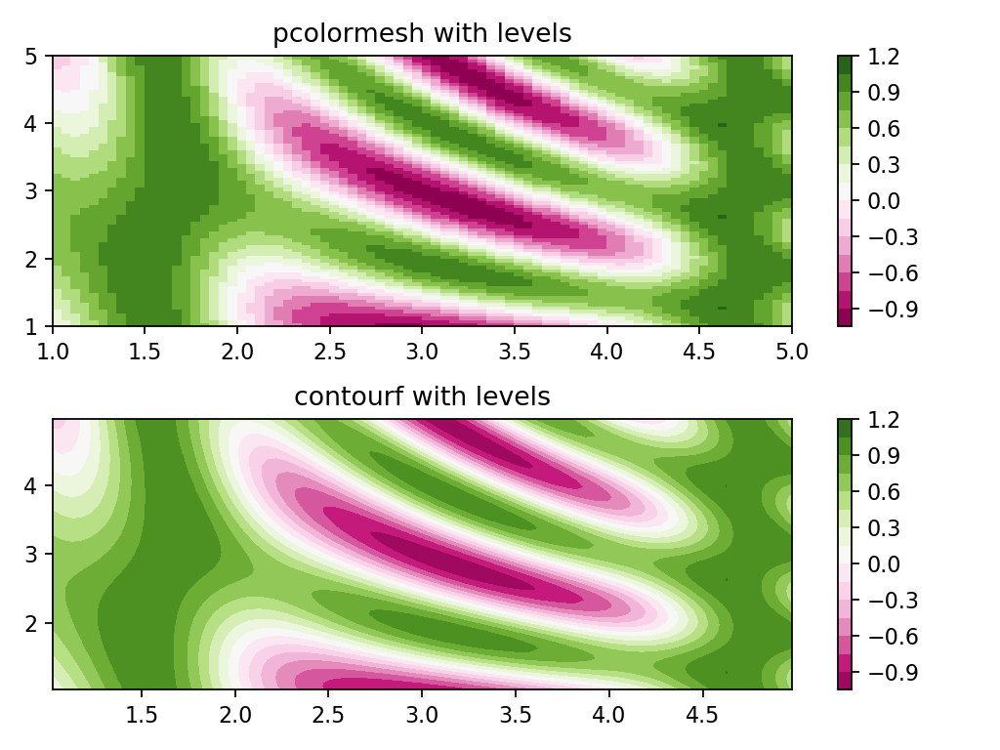

[[ 0.18037951  0.26823017  0.36335424 ...  0.81967616  0.70887839
   0.58107739]
 [ 0.20738012  0.2942647   0.38808212 ...  0.79738125  0.68002396
   0.54664565]
 [ 0.23430727  0.3201529   0.41259223 ...  0.78164078  0.66058997
   0.5247303 ]
 ...
 [-0.17535841 -0.1651069  -0.10633898 ...  0.83935699  0.70681157
   0.55135416]
 [-0.19534556 -0.17962168 -0.11478605 ...  0.81308152  0.67850552
   0.52732772]
 [-0.21439958 -0.19297694 -0.12193009 ...  0.79244172  0.65971059
   0.51699498]]


In [12]:
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import BoundaryNorm
from matplotlib.ticker import MaxNLocator
import numpy as np


# make these smaller to increase the resolution
dx, dy = 0.05, 0.05

# generate 2 2d grids for the x & y bounds
y, x = np.mgrid[slice(1, 5 + dy, dy),
                slice(1, 5 + dx, dx)]

z = np.sin(x)**10 + np.cos(10 + y*x) * np.cos(x)

# x and y are bounds, so z should be the value *inside* those bounds.
# Therefore, remove the last value from the z array.
z = z[:-1, :-1]
levels = MaxNLocator(nbins=15).tick_values(z.min(), z.max())


# pick the desired colormap, sensible levels, and define a normalization
# instance which takes data values and translates those into levels.
cmap = plt.get_cmap('PiYG')
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)

fig, (ax0, ax1) = plt.subplots(nrows=2)

im = ax0.pcolormesh(x, y, z, cmap=cmap, norm=norm)

print(z)


fig.colorbar(im, ax=ax0)
ax0.set_title('pcolormesh with levels')


# contours are *point* based plots, so convert our bound into point
# centers
cf = ax1.contourf(x[:-1, :-1] + dx/2.,
                  y[:-1, :-1] + dy/2., z, levels=levels,
                  cmap=cmap)
fig.colorbar(cf, ax=ax1)
ax1.set_title('contourf with levels')

# adjust spacing between subplots so `ax1` title and `ax0` tick labels
# don't overlap
fig.tight_layout()

plt.show()

In [2]:
# CHECKING PATTERNS WITH DIFFERENT FRAGMENTS

patterns_path = "/Users/aliscafo/Downloads/CPatMiner-master 2/SemanticChangeGraphMiner/output/patterns/repos-hybrid/1"

patterns_dir = os.fsencode(patterns_path)

sorted_size_dirs = [int(os.fsdecode(el)) for el in os.listdir(patterns_dir) if os.fsdecode(el).isnumeric()]
sorted_size_dirs.sort()

final_ok_num = 0
all_patterns = 0

set_of_patterns_with_different_fragments = set()
changes_with_different_fragments = []

for size_dir in sorted_size_dirs:
    size_dir_str = str(size_dir)
    sorted_id_dirs = [int(os.fsdecode(el)) for el in os.listdir(patterns_path + os.sep + size_dir_str) if os.fsdecode(el).isnumeric()]
    sorted_id_dirs.sort()
    
    #if size_dir_str != "41":
    #    continue
        
    num_ids = 0

    for id_dir in sorted_id_dirs:
        path = patterns_path + os.sep + size_dir_str + os.sep + str(id_dir) + os.sep + "details.html"

        #if id_dir > 100:
        #    break
        
        #if num_ids >= 166:
        #    break
        num_ids += 1
        
        if not os.path.exists(path):
            continue

        with open(path, 'r', encoding="latin-1") as file:
            content = file.read()
            
        #freq_ind_start = content.index("<div id='frequency'>Frequency: ") + len("<div id='frequency'>Frequency: ")
        #freq_ind_end = content.index("</div><BR><div id='size'>")
        #freq = int(content[freq_ind_start:freq_ind_end])
        
        last_ind = 0
        
        print(size_dir_str, str(id_dir))
        
        all_patterns += 1
        
        set_of_names = set()
        
        num_change = 0
        
        while True:
            num_change += 1
            
            start = 0
            end = 0
            
            try:
                start = content.index("<div id='method'>", last_ind) + len("<div id='method'>") 
                end = content.index("</div><BR>", start)
            except:
                break
            
            name = content[start:end]
            parts = name.split(',')
            project_name = parts[0]
            nickname = project_name.split('/')[0]
            
            last_ind = end
            
            #if project_name.split('/')[1] in exist:
                #print("exist")
            #    continue
            #exist.add(project_name.split('/')[1])
            
            print(project_name)
            
            if name not in set_of_names:
                set_of_names.add(name)
                changes_with_different_fragments.append((size_dir, id_dir, num_change))
        
        print(len(set_of_names))
        if (len(set_of_names) > 1):
            final_ok_num += 1
            set_of_patterns_with_different_fragments.add((size_dir, id_dir))
            print("OK")
        else:
            changes_with_different_fragments.pop()
            

print(final_ok_num)
print(all_patterns)

3 1
ashish-gehani/SPADE
ashish-gehani/SPADE
ashish-gehani/SPADE
2
OK
3 10
OpenHFT/Chronicle-Queue
OpenHFT/Chronicle-Queue
OpenHFT/Chronicle-Queue
OpenHFT/Chronicle-Queue
OpenHFT/Chronicle-Queue
OpenHFT/Chronicle-Queue
4
OK
3 16
spring-projects/spring-integration-kafka
spring-projects/spring-integration-kafka
spring-projects/spring-integration-kafka
spring-projects/spring-integration-kafka
spring-projects/spring-integration-kafka
1
3 19
jOOQ/jOOL
jOOQ/jOOL
jOOQ/jOOL
jOOQ/jOOL
jOOQ/jOOL
jOOQ/jOOL
jOOQ/jOOL
7
OK
3 20
Elopteryx/upload-parser
Elopteryx/upload-parser
Elopteryx/upload-parser
2
OK
3 22
spring-projects/spring-data-gemfire
spring-projects/spring-amqp
ralscha/extclassgenerator
3
OK
3 25
codice/imaging-nitf
codice/imaging-nitf
SonarSource/sonar-ldap
codice/imaging-nitf
codice/imaging-nitf
5
OK
3 27
UnboundID/scim2
UnboundID/scim2
UnboundID/scim2
3
OK
3 41
imagej/imagej-ops
imagej/imagej-ops
imagej/imagej-ops
imagej/imagej-ops
4
OK
3 52
Maxr1998/MaxLock
xbmc/Kore
Maxr1998/MaxLock
3

3 976
freedomotic/freedomotic
mslosarz/nextrtc-signaling-server
leancloud/leanmessage-demo
FINRAOS/DataGenerator
4
OK
3 981
cloudsoft/brooklyn-tosca
GeoNode/geoserver-geonode-ext
jenkinsci/github-oauth-plugin
3
OK
3 989
fujaba/SDMLib
fujaba/SDMLib
fujaba/SDMLib
fujaba/SDMLib
2
OK
3 991
neevek/Paginize
neevek/Paginize
maxpower47/PinDroid
3
OK
3 1001
google/android-classyshark
google/android-classyshark
ribasco/async-gamequery-lib
2
OK
3 1004
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
naver/arcus-java-client
12
OK
3 1025
ethereumproject/etherjar
dbmdz/iiif-presentation-api
dbmdz/iiif-presentation-api
marklogic/marklogic-data-hub


3 2107
udevbe/wayland-java-bindings
udevbe/wayland-java-bindings
udevbe/wayland-java-bindings
udevbe/wayland-java-bindings
udevbe/wayland-java-bindings
3
OK
3 2123
gemini-hlsw/ocs
gemini-hlsw/ocs
gemini-hlsw/ocs
gemini-hlsw/ocs
4
OK
3 2125
pentaho/pentaho-reporting
pentaho/pentaho-reporting
krs-world/bridges
krs-world/bridges
4
OK
3 2136
wayshall/onetwo
kiselev-dv/gazetteer
kiselev-dv/gazetteer
kiselev-dv/gazetteer
3
OK
3 2143
FoxDenStudio/FoxGuard
FoxDenStudio/FoxGuard
FoxDenStudio/FoxGuard
smarr/are-we-fast-yet
FoxDenStudio/FoxGuard
FoxDenStudio/FoxGuard
FoxDenStudio/FoxGuard
FoxDenStudio/FoxGuard
FoxDenStudio/FoxGuard
3
OK
3 2150
jeffdcamp/dbtools-gen
droolsjbpm/kie-wb-common
jOOQ/jOOQ
Red5/red5-io
jeffdcamp/dbtools-gen
5
OK
3 2154
osmandapp/OsmAnd-tools
osmandapp/OsmAnd-tools
osmandapp/OsmAnd-tools
3
OK
3 2155
ops4j/org.ops4j.pax.logging
Teiid-Designer/komodo
ops4j/org.ops4j.pax.logging
3
OK
3 2165
square/flow
square/flow
2
OK
3 2167
stephentuso/welcome-android
diwi/PixelFlow
diwi/

3 2796
atomix/atomix
atomix/copycat
atomix/copycat
atomix/copycat
atomix/atomix
4
OK
3 2803
glowroot/glowroot
glowroot/glowroot
glowroot/glowroot
2
OK
3 2805
treasure-data/td-android-sdk
mrmans0n/smart-location-lib
treasure-data/td-android-sdk
3
OK
3 2824
forcedotcom/idecore
forcedotcom/idecore
forcedotcom/idecore
forcedotcom/idecore
Riverside-Software/sonar-openedge
forcedotcom/idecore
forcedotcom/idecore
forcedotcom/idecore
8
OK
3 2826
CoprHD/coprhd-controller
CoprHD/coprhd-controller
CoprHD/coprhd-controller
CoprHD/coprhd-controller
CoprHD/coprhd-controller
5
OK
3 2834
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
powermock/powermock
5
OK
3 2857
code-troopers/android-betterpickers
CUTR-at-USF/OpenTripPlanner-for-Android
lessthanoptimal/BoofAndroidDemo
3
OK
3 2864
jdbi/jdbi
jdbi/jdbi
jdbi/jdbi
jdbi/jdbi
jdbi/jdbi

3 3512
adjust/android_sdk
adjust/android_sdk
adjust/android_sdk
3
OK
3 3521
yahoo/pulsar
yahoo/pulsar
cnaude/PurpleIRC
cltl/EventCoreference
zalando/nakadi
cnaude/PurpleIRC-spigot
6
OK
3 3530
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
justjanne/QuasselDroid-ng
5
OK
3 3531
vivo-project/Vitro
vivo-project/Vitro
vivo-project/Vitro
vivo-project/Vitro
vivo-project/Vitro
vivo-project/Vitro
vivo-project/Vitro
vivo-project/Vitro
8
OK
3 3532
forcedotcom/idecore
forcedotcom/idecore
forcedotcom/idecore
3
OK
3 3535
Watchful1/PermissionsChecker
Watchful1/PermissionsChecker
Watchful1/PermissionsChecker
1
3 3538
linkedpipes/etl
Darkyenus/glsl4idea
javamonkey/beetl2.0
3
OK
3 3557
react-native-community/react-native-video
lipangit/JieCaoVideoPlayer
react-native-community/react-native-video
3
OK
3 3566
apache/uima-uimafit
analytically/capsul

3 4462
cloudant/java-cloudant
cloudant/java-cloudant
cloudant/java-cloudant
3
OK
3 4463
XiaomoAndroid/xiaomo-info-java
XiaomoAndroid/xiaomo-info-java
XiaomoAndroid/xiaomo-info-java
3
OK
3 4477
Maxr1998/MaxLock
Maxr1998/MaxLock
Maxr1998/MaxLock
Maxr1998/MaxLock
1
3 4482
auth0/Lock.Android
auth0/Lock.Android
auth0/Lock.Android
auth0/Lock.Android
4
OK
3 4487
ReikaKalseki/DragonAPI
Sejoslaw/VanillaMagic
copygirl/WearableBackpacks
CreativeMD/LittleTiles
CreativeMD/LittleTiles
4
OK
3 4505
apache/felix
apache/felix
apache/felix
3
OK
3 4517
mezz/JustEnoughItems
mezz/JustEnoughItems
haraldk/TwelveMonkeys
3
OK
3 4535
auth0/java-jwt
auth0/java-jwt
auth0/java-jwt
2
OK
3 4540
TheGreyGhost/MinecraftByExample
squeek502/VeganOption
TheGreyGhost/MinecraftByExample
3
OK
3 4553
DevOnTheRocks/SkyClaims
DevOnTheRocks/SkyClaims
DevOnTheRocks/SkyClaims
DevOnTheRocks/SkyClaims
DevOnTheRocks/SkyClaims
DevOnTheRocks/SkyClaims
DevOnTheRocks/SkyClaims
DevOnTheRocks/SkyClaims
4
OK
3 4559
Reading-eScience-Centre/ed

3 5608
HdrHistogram/HdrHistogram
HdrHistogram/HdrHistogram
HdrHistogram/HdrHistogram
HdrHistogram/HdrHistogram
HdrHistogram/HdrHistogram
5
OK
3 5615
EvoSuite/evosuite
hibernate/hibernate-search
hibernate/hibernate-search
3
OK
3 5616
apache/incubator-pirk
apache/incubator-pirk
apache/incubator-pirk
apache/incubator-pirk
apache/incubator-pirk
apache/incubator-pirk
3
OK
3 5617
aliyun/aliyun-oss-java-sdk
aliyun/aliyun-oss-java-sdk
aliyun/aliyun-oss-java-sdk
2
OK
3 5621
metaborg/runtime-libraries
metaborg/runtime-libraries
davidfauthoux/ninio
apache/httpcore
3
OK
3 5623
farmerbb/Notepad
farmerbb/Notepad
farmerbb/Notepad
sqlcipher/android-database-sqlcipher
farmerbb/Notepad
couchbase/couchbase-lite-android-liteserv
6
OK
3 5629
ThomasDaheim/ownNoteEditor
OpenSourcePhysics/osp
cordova-plugin-camera-preview/cordova-plugin-camera-preview
walkmod/walkmod-core
QQ986945193/DavidAndroidProjectTools
apache/uima-uimafit
6
OK
3 5630
PureDark/H-Viewer
PureDark/H-Viewer
PureDark/H-Viewer
PureDark/H-Viewe

3 6281
markfisher/spring-cloud-function
markfisher/spring-cloud-function
markfisher/spring-cloud-function
3
OK
3 6300
bguerout/jongo
googlesamples/tango-examples-java
GeoWebCache/geowebcache
3
OK
3 6309
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
opendedup/sdfs
10
OK
3 6310
Squarespace/template-compiler
Squarespace/template-compiler
Squarespace/template-compiler
Squarespace/template-compiler
1
3 6313
neuroph/neuroph
neuroph/neuroph
neuroph/neuroph
neuroph/neuroph
neuroph/neuroph
neuroph/neuroph
neuroph/neuroph
neuroph/neuroph
8
OK
3 6314
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
yandex/clickhouse-jdbc
1
3 6321
clafonta/Mockey
clafonta/Mockey
clafonta/Mockey
2


3 7158
gr8pefish/IronBackpacks
eclipse/eclipse.jdt.ui
eclipse/eclipse.jdt.ui
ForestryMC/ForestryMC
3
OK
3 7159
fabric8io/ipaas-quickstarts
fabric8io/ipaas-quickstarts
fabric8io/ipaas-quickstarts
fabric8io/ipaas-quickstarts
4
OK
3 7169
FoxDenStudio/FoxCore
FoxDenStudio/FoxCore
FoxDenStudio/FoxCore
3
OK
3 7183
AKSW/AGDISTIS
AKSW/AGDISTIS
AKSW/AGDISTIS
1
3 7184
blay09/CookingForBlockheads
BuiltBrokenModding/VoltzEngine
blay09/CookingForBlockheads
3
OK
3 7233
bobbylight/RSyntaxTextArea
bobbylight/RSyntaxTextArea
bobbylight/RSyntaxTextArea
bobbylight/RSyntaxTextArea
bobbylight/RSyntaxTextArea
4
OK
3 7235
FTSRG/BME-MODES3
FTSRG/BME-MODES3
FTSRG/BME-MODES3
3
OK
3 7255
tcurdt/jdeb
tcurdt/jdeb
tcurdt/jdeb
1
3 7262
ZhangZhenghao/Material-WeCenter
ZhangZhenghao/Material-WeCenter
ZhangZhenghao/Material-WeCenter
ZhangZhenghao/Material-WeCenter
2
OK
3 7263
pockethub/PocketHub
dlangerenken/SimpleNews
pockethub/PocketHub
3
OK
3 7270
caman9119/SpaceLaunchNow
HTWDD/HTWDD
domoticz/domoticz-android
domoti

KeyboardInterrupt: 

In [233]:
print(len(set_of_patterns_with_different_fragments))

7310


In [234]:


#RESULTS_FOR_HIST_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/result_for_hist_big_data"
RESULTS_FOR_HIST_PATH = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50"

results_for_hist_dir = os.fsencode(RESULTS_FOR_HIST_PATH)
patterns = [os.fsdecode(el) for el in os.listdir(results_for_hist_dir) 
               if os.path.isdir(RESULTS_FOR_HIST_PATH + "/" + os.fsdecode(el)) and len(os.fsdecode(el)) < 10]
patterns = [(int(el.split(' ')[0]), int(el.split(' ')[1])) for el in patterns]
patterns.sort()

changes_names = []
patterns_with_max_change = []

for el in tqdm_notebook(patterns):
    size, id = el[0], el[1]
    
    if (size, id) not in set_of_patterns_with_different_fragments:
        continue
    
    path_to_pattern = RESULTS_FOR_HIST_PATH + "/" + str(size) + " " + str(id) + "/5gram"
    files = [int(os.fsdecode(el)[12:-9]) for el in os.listdir(path_to_pattern) if os.fsdecode(el).startswith("sampleChange")]
    files.sort()
    
    for file in files:
        changes_names.append((size, id, file))
    patterns_with_max_change.append((size, id, files[-1]))
                        
print(changes_names)


[(3, 20, 2), (3, 22, 1), (3, 22, 2), (3, 22, 3), (3, 27, 1), (3, 27, 3), (3, 52, 1), (3, 52, 2), (3, 52, 3), (3, 92, 1), (3, 92, 2), (3, 92, 3), (3, 92, 4), (3, 92, 5), (3, 92, 6), (3, 94, 1), (3, 94, 2), (3, 94, 3), (3, 94, 4), (3, 117, 2), (3, 117, 3), (3, 119, 1), (3, 119, 2), (3, 119, 3), (3, 125, 2), (3, 125, 3), (3, 147, 2), (3, 147, 3), (3, 147, 5), (3, 147, 6), (3, 147, 7), (3, 147, 8), (3, 165, 1), (3, 165, 2), (3, 165, 3), (3, 167, 1), (3, 167, 3), (3, 192, 3), (3, 192, 4), (3, 207, 1), (3, 207, 2), (3, 207, 3), (3, 207, 4), (3, 207, 5), (3, 207, 6), (3, 207, 7), (3, 207, 8), (3, 217, 2), (3, 217, 3), (3, 218, 1), (3, 218, 2), (3, 225, 1), (3, 225, 2), (3, 225, 3), (3, 237, 8), (3, 237, 12), (3, 241, 2), (3, 241, 3), (3, 241, 4), (3, 245, 1), (3, 245, 2), (3, 245, 3), (3, 261, 10), (3, 269, 1), (3, 269, 2), (3, 269, 3), (3, 274, 4), (3, 343, 2), (3, 355, 1), (3, 355, 2), (3, 355, 3), (3, 355, 4), (3, 356, 6), (3, 356, 11), (3, 367, 1), (3, 367, 3), (3, 381, 1), (3, 381, 2), 

In [ ]:
# FOR 3-GRAM!!!!!!!!
# TODO: Rewrite as a function

'''
import os
from tqdm import tqdm_notebook

#RESULTS_FOR_HIST_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/result_for_hist_big_data"
RESULTS_FOR_HIST_PATH = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50-3gram"

results_for_hist_dir = os.fsencode(RESULTS_FOR_HIST_PATH)
patterns = [os.fsdecode(el) for el in os.listdir(results_for_hist_dir) 
               if os.path.isdir(RESULTS_FOR_HIST_PATH + "/" + os.fsdecode(el)) and len(os.fsdecode(el)) < 10]
patterns = [(int(el.split(' ')[0]), int(el.split(' ')[1])) for el in patterns]
patterns.sort()

changes_names = []
patterns_with_max_change = []

for el in tqdm_notebook(patterns):
    size, id = el[0], el[1]
    
    if (size, id) not in set_of_patterns_with_different_fragments:
        continue
    
    path_to_pattern = RESULTS_FOR_HIST_PATH + "/" + str(size) + " " + str(id) + "/5gram"
    files = [int(os.fsdecode(el)[12:-9]) for el in os.listdir(path_to_pattern) if os.fsdecode(el).startswith("sampleChange")]
    files.sort()
    
    for file in files:
        changes_names.append((size, id, file))
    patterns_with_max_change.append((size, id, files[-1]))
                        
print(changes_names)
'''

In [235]:
print(len(patterns_with_max_change))
print(len(changes_names))
print(len(changes_with_different_fragments))
real_read_changes_with_different_fragments = [el for el in changes_names if el in changes_with_different_fragments]
print(len(real_read_changes_with_different_fragments))

6363
38917
30657
23133


In [236]:
import collections

pattern_to_remained_num = collections.defaultdict(int)
for el in real_read_changes_with_different_fragments:
    pattern_to_remained_num[(el[0], el[1])] += 1
    
# read changes with different fragments which was filtered so that length of patterns is more than 1
real_changes = [el for el in real_read_changes_with_different_fragments
                if pattern_to_remained_num[(el[0], el[1])] > 1]

In [237]:
print(len(real_changes))

22705


In [238]:
#print(pattern_to_remained_num)
sorted_dict = {k: v for k, v in sorted(pattern_to_remained_num.items(), key=lambda item: item[1], reverse=True)}
print(list(sorted_dict.items())[:20])

[((9, 6293), 87), ((5, 5396), 85), ((4, 1645), 78), ((6, 3264), 69), ((8, 2266), 69), ((6, 14981), 53), ((5, 2013), 48), ((8, 1486), 48), ((10, 3256), 48), ((7, 10354), 39), ((10, 11483), 38), ((4, 6376), 35), ((6, 14540), 34), ((4, 3135), 33), ((5, 4912), 33), ((5, 6537), 33), ((6, 628), 32), ((3, 6789), 30), ((6, 4703), 30), ((8, 8667), 30)]


In [239]:
tops = list(sorted_dict.items())[:20]
print(tops)
selected_patterns = [el[0] for el in tops]
#selected_patterns

[((9, 6293), 87), ((5, 5396), 85), ((4, 1645), 78), ((6, 3264), 69), ((8, 2266), 69), ((6, 14981), 53), ((5, 2013), 48), ((8, 1486), 48), ((10, 3256), 48), ((7, 10354), 39), ((10, 11483), 38), ((4, 6376), 35), ((6, 14540), 34), ((4, 3135), 33), ((5, 4912), 33), ((5, 6537), 33), ((6, 628), 32), ((3, 6789), 30), ((6, 4703), 30), ((8, 8667), 30)]


In [21]:
#some_patterns_with_max_change = patterns_with_max_change[2100:2110]
#some_patterns = [(el[0], el[1]) for el in some_patterns_with_max_change]
#print(some_patterns[0], some_patterns[-1])

In [240]:
some_patterns = selected_patterns

some_changes = [el for el in real_changes if (el[0], el[1]) in some_patterns and
                (el[0], el[1]) != (14, 1319)]
print(len(some_changes))

952


In [241]:
print("\n".join([str(elem) for elem in some_changes]))

(3, 6789, 3)
(3, 6789, 4)
(3, 6789, 5)
(3, 6789, 6)
(3, 6789, 7)
(3, 6789, 8)
(3, 6789, 9)
(3, 6789, 10)
(3, 6789, 12)
(3, 6789, 13)
(3, 6789, 14)
(3, 6789, 15)
(3, 6789, 16)
(3, 6789, 17)
(3, 6789, 19)
(3, 6789, 21)
(3, 6789, 22)
(3, 6789, 23)
(3, 6789, 24)
(3, 6789, 25)
(3, 6789, 28)
(3, 6789, 30)
(3, 6789, 31)
(3, 6789, 32)
(3, 6789, 33)
(3, 6789, 34)
(3, 6789, 35)
(3, 6789, 36)
(3, 6789, 37)
(3, 6789, 38)
(4, 1645, 1)
(4, 1645, 2)
(4, 1645, 3)
(4, 1645, 4)
(4, 1645, 5)
(4, 1645, 6)
(4, 1645, 7)
(4, 1645, 8)
(4, 1645, 9)
(4, 1645, 10)
(4, 1645, 11)
(4, 1645, 12)
(4, 1645, 14)
(4, 1645, 15)
(4, 1645, 16)
(4, 1645, 17)
(4, 1645, 18)
(4, 1645, 19)
(4, 1645, 20)
(4, 1645, 21)
(4, 1645, 22)
(4, 1645, 23)
(4, 1645, 24)
(4, 1645, 25)
(4, 1645, 26)
(4, 1645, 27)
(4, 1645, 28)
(4, 1645, 29)
(4, 1645, 30)
(4, 1645, 31)
(4, 1645, 32)
(4, 1645, 33)
(4, 1645, 34)
(4, 1645, 35)
(4, 1645, 36)
(4, 1645, 37)
(4, 1645, 38)
(4, 1645, 39)
(4, 1645, 41)
(4, 1645, 42)
(4, 1645, 43)
(4, 1645, 44)
(4, 1645

In [242]:
hist_len_5gram = None

RESULTS_FOR_HIST_PATH = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50"
es_path = RESULTS_FOR_HIST_PATH + "/" + "edit_scripts_5grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_5gram = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_5gram)

267762


In [243]:
hist_len_3gram = None

RESULTS_FOR_HIST_PATH = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50-3gram"
es_path = RESULTS_FOR_HIST_PATH + "/" + "edit_scripts_3grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_3gram = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_3gram)

116270


In [24]:
# Previous way to get (read) hists

'''
from tqdm import tqdm_notebook
RESULTS_FOR_HIST_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/result_for_hist_big_data"

hists = []

for i in tqdm_notebook(some_changes):
    size1, id1, file1 = i[0], i[1], i[2]
    hist_path1 = RESULTS_FOR_HIST_PATH + "/" + str(size1) + " " + str(id1) + "/5gram/sampleChange" + str(file1) + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    hist_data1 = hist_file1.read().split(" ")
    hist_data1 = [(i, int(elem)) for i, elem in enumerate(hist_data1) if elem != '' and int(elem) != 0]
    # hist_data1 = [int(elem) for elem in hist_data1 if elem != '']
    hists.append(hist_data1)
    #print(len(hist_data1))
'''

In [244]:
from tqdm import tqdm_notebook
#RESULTS_FOR_HIST_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/result_for_hist_big_data"
RESULTS_FOR_HIST_PATH = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50"

hists = []

for i in tqdm_notebook(some_changes):
    size1, id1, file1 = i[0], i[1], i[2]
    hist_path1 = RESULTS_FOR_HIST_PATH + "/" + str(size1) + " " + str(id1) + "/5gram/sampleChange" + str(file1) + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    #hist_data1 = [(i, int(elem)) for i, elem in enumerate(hist_data1) if elem != '' and int(elem) != 0]
    hists.append(hist_data1)
    hist_file1.close()
    
    # Checking example
    if len(hists) == 5:
        print(size1, id1, file1)
        print(hist_data1)

3 6789 7
[(44421, 1), (61056, 1), (61989, 1), (113224, 1)]



In [245]:
# Getting 3-gram

from tqdm import tqdm_notebook
#RESULTS_FOR_HIST_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/result_for_hist_big_data"
RESULTS_FOR_HIST_PATH = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50-3gram"

hists_3gram = []

for i in tqdm_notebook(some_changes):
    size1, id1, file1 = i[0], i[1], i[2]
    hist_path1 = RESULTS_FOR_HIST_PATH + "/" + str(size1) + " " + str(id1) + "/3gram/sampleChange" + str(file1) + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    #hist_data1 = [(i, int(elem)) for i, elem in enumerate(hist_data1) if elem != '' and int(elem) != 0]
    hists_3gram.append(hist_data1)
    hist_file1.close()
    
    # Checking example
    if len(hists_3gram) == 5:
        print(size1, id1, file1)
        print(hist_data1)

3 6789 7
[(3726, 1), (11761, 1), (26857, 1), (34659, 1), (40354, 1), (56665, 1)]



In [246]:
# The same code, but a function for this:

RESULTS_FOR_HIST_PATH_5GRAM = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50"
RESULTS_FOR_HIST_PATH_3GRAM = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50-3gram"
RESULTS_FOR_HIST_PATH_4GRAM = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50-4gram"
RESULTS_FOR_HIST_PATH_2GRAM = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50-2gram"
RESULTS_FOR_HIST_PATH_1GRAM = "/Volumes/Seagate/Alina/result_for_hist_all_data3-50-1gram"

from tqdm import tqdm_notebook

def get_hists(some_changes, hists_path, gram_path):

    hists = []

    for i in tqdm_notebook(some_changes):
        size1, id1, file1 = i[0], i[1], i[2]
        hist_path1 = hists_path + "/" + str(size1) + " " + str(id1) + "/" + gram_path + "/sampleChange" + str(file1) + "_hist.txt"
        hist_file1 = open(hist_path1, "r")
        lines = hist_file1.read().split("\n")
        hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
        hists.append(hist_data1)
        hist_file1.close()

        # Checking example
        #if len(hists) == 5:
        #    print(size1, id1, file1)
        #    print(hist_data1)
        
    return hists

In [247]:
hists_4gram = get_hists(some_changes, hists_path=RESULTS_FOR_HIST_PATH_4GRAM, gram_path="4gram")

In [270]:
hists_2gram = get_hists(some_changes, hists_path=RESULTS_FOR_HIST_PATH_2GRAM, gram_path="2gram")

In [248]:
hist_len_4gram = None

RESULTS_FOR_HIST_PATH = RESULTS_FOR_HIST_PATH_4GRAM
es_path = RESULTS_FOR_HIST_PATH + "/" + "edit_scripts_4grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_4gram = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_4gram)

197808


In [249]:
hist_len_2gram = None

RESULTS_FOR_HIST_PATH = RESULTS_FOR_HIST_PATH_2GRAM
es_path = RESULTS_FOR_HIST_PATH + "/" + "edit_scripts_2grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_2gram = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_2gram)

42193


In [250]:
hist_len_1gram = None

RESULTS_FOR_HIST_PATH = RESULTS_FOR_HIST_PATH_1GRAM
es_path = RESULTS_FOR_HIST_PATH + "/" + "edit_scripts_1grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_1gram = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_1gram)

FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/Seagate/Alina/result_for_hist_all_data3-50-1gram/edit_scripts_1grams_mapped.txt'

In [178]:
# Just counting a histogram length (old way)

'''
hist_path1 = RESULTS_FOR_HIST_PATH + "/" + str(19) + " " + str(13424) + "/5gram/sampleChange" + str(25) + "_hist.txt"
hist_file1 = open(hist_path1, "r")
hist_data1 = hist_file1.read().split(" ")
hist_data1 = [(i, int(elem)) for i, elem in enumerate(hist_data1) if elem != '']
len(hist_data1)
'''

169102

In [251]:
print(len(hists[0]))

3


In [3]:
# NEW IMPLEMENTATION

import math

def get_intersections(hist1, hist2):
    len1 = len(hist1)
    len2 = len(hist2)
    intersections = []
    i = 0
    j = 0

    while i < len1 and j < len2:
        if hist1[i][0] < hist2[j][0]:
            i += 1
        elif hist1[i][0] == hist2[j][0]:
            intersections.append((hist1[i][0], hist1[i][1], hist2[j][1]))
            i += 1
            j += 1
        elif hist1[i][0] > hist2[j][0]:
            j += 1
            
    return intersections

def get_union_inds(hist1, hist2):
    len1 = len(hist1)
    len2 = len(hist2)
    union = []
    i = 0
    j = 0

    while i < len1 or j < len2:
        if i >= len1:
            union.append(hist2[j][0])
            j += 1
        elif j >= len2:
            union.append(hist1[i][0])
            i += 1
        elif hist1[i][0] < hist2[j][0]:
            union.append(hist1[i][0])
            i += 1
        elif hist1[i][0] == hist2[j][0]:
            union.append(hist1[i][0])
            i += 1
            j += 1
        elif hist1[i][0] > hist2[j][0]:
            union.append(hist2[j][0])
            j += 1
            
    return union


def jaccard_metric(hist1, hist2, hist_len=None):
    intersections = get_intersections(hist1, hist2)

    metric = 0

    for ind, v1, v2 in intersections:
        mx = max(v1, v2)
        mn = min(v1, v2)
        metric += mn / mx

    len_intersections = len(intersections)

    if (len_intersections != 0):
        metric = metric / len(intersections)
    else:
        metric = 0

    return 1 - metric

def canberra_metric(hist1, hist2, hist_len=None):
    metric = 0
    i = 0
    j = 0
    n = len(hist1)
    m = len(hist2)
    
    union_len = 0
    
    while i < n or j < m:
        if i >= n:
            metric += abs(hist2[j][1]) / abs(hist2[j][1]) # 1
            j += 1
        elif j >= m:
            metric += abs(hist1[i][1]) / abs(hist1[i][1]) # 1
            i += 1
        elif hist1[i][0] == hist2[j][0]:
            metric += abs(hist1[i][1] - hist2[j][1]) / (abs(hist1[i][1]) + abs(hist2[j][1]))
            i += 1
            j += 1
        elif hist1[i][0] < hist2[j][0]:
            metric += abs(hist1[i][1]) / abs(hist1[i][1]) # 1
            i += 1
        elif hist1[i][0] > hist2[j][0]:
            metric += abs(hist2[j][1]) / abs(hist2[j][1]) # 1
            j += 1
        
        #union_len += 1
            
    union_len = len(get_union_inds(hist1, hist2))
    if union_len == 0:
        return 1
    
    return metric / union_len


def canberra_metric_optimized(hist1, hist2, hist_len=None):
    metric = 0
    i = 0
    j = 0
    n = len(hist1)
    m = len(hist2)
    
    union_len = 0
    
    while i < n or j < m:
        if i >= n:
            metric += 1.0
            j += 1
        elif j >= m:
            metric += 1.0
            i += 1
        elif hist1[i][0] == hist2[j][0]:
            metric += abs(hist1[i][1] - hist2[j][1]) / (abs(hist1[i][1]) + abs(hist2[j][1]))
            i += 1
            j += 1
        elif hist1[i][0] < hist2[j][0]:
            metric += 1.0
            i += 1
        elif hist1[i][0] > hist2[j][0]:
            metric += 1.0
            j += 1
        
        union_len += 1
            
    #union_len = len(get_union_inds(hist1, hist2))
    if union_len == 0:
        return 1
    
    return metric / union_len



'''
def pearsons_correlation(hist1, hist2, hist_len):
    #hist_len = hist_len_3gram
    union_len = len(get_union_inds(hist1, hist2))
    
    top = 0
    left = 0
    right = 0
    
    n = len(hist1)
    m = len(hist2)
    
    i = 0
    j = 0
    
    while i < n or j < m:
        if i >= n:
            top += (- 1/hist_len) * (hist2[j][1] - 1/hist_len)
            left += (- 1/hist_len) ** 2
            right += (hist2[j][1] - 1/hist_len) ** 2
            j += 1
        elif j >= m:
            top += (hist1[i][1] - 1/hist_len) * (- 1/hist_len)
            left += (hist1[i][1] - 1/hist_len)  ** 2
            right += (- 1/hist_len) ** 2
            i += 1
        elif hist1[i][0] == hist2[j][0]:
            top += (hist1[i][1] - 1/hist_len) * (hist2[j][1] - 1/hist_len)
            left += (hist1[i][1] - 1/hist_len)  ** 2
            right += (hist2[j][1] - 1/hist_len) ** 2
            i += 1
            j += 1
        elif hist1[i][0] < hist2[j][0]:
            top += (hist1[i][1] - 1/hist_len) * (- 1/hist_len)
            left += (hist1[i][1] - 1/hist_len)  ** 2
            right += (- 1/hist_len) ** 2
            i += 1
        elif hist1[i][0] > hist2[j][0]:
            top += (- 1/hist_len) * (hist2[j][1] - 1/hist_len)
            left += (- 1/hist_len) ** 2
            right += (hist2[j][1] - 1/hist_len) ** 2
            j += 1

    bottom = math.sqrt(left * right)
    return 1 - top / bottom
'''


def cos_distance(hist1, hist2, hist_len=None):
    intersections = get_intersections(hist1, hist2)

    top = 0

    for ind, v1, v2 in intersections:
        top += v1 * v2
        
    bottom1 = (sum([pair[1] ** 2 for pair in hist1]))
    bottom2 = (sum([pair[1] ** 2 for pair in hist2]))
    
    #print(top)
    #print(bottom1)
    #print(bottom2)
    
    return 1 - abs(top / np.sqrt(bottom1 * bottom2))
    

def pearsons_correlation_mean(hist1, hist2, hist_len):
    union_len = len(get_union_inds(hist1, hist2))
    
    top = 0
    left = 0
    right = 0
    
    n = len(hist1)
    m = len(hist2)
    
    mean1 = sum([pair[1] for pair in hist1]) / hist_len
    mean2 = sum([pair[1] for pair in hist2]) / hist_len
    
    i = 0
    j = 0
    
    while i < n or j < m:
        if i >= n:
            top += (- mean1) * (hist2[j][1] - mean2)
            left += (- mean1) ** 2
            right += (hist2[j][1] - mean2) ** 2
            j += 1
        elif j >= m:
            top += (hist1[i][1] - mean1) * (- mean2)
            left += (hist1[i][1] - mean1)  ** 2
            right += (- mean2) ** 2
            i += 1
        elif hist1[i][0] == hist2[j][0]:
            top += (hist1[i][1] - mean1) * (hist2[j][1] - mean2)
            left += (hist1[i][1] - mean1)  ** 2
            right += (hist2[j][1] - mean2) ** 2
            i += 1
            j += 1
        elif hist1[i][0] < hist2[j][0]:
            top += (hist1[i][1] - mean1) * (- mean2)
            left += (hist1[i][1] - mean1)  ** 2
            right += (- mean2) ** 2
            i += 1
        elif hist1[i][0] > hist2[j][0]:
            top += (- mean1) * (hist2[j][1] - mean2)
            left += (- mean1) ** 2
            right += (hist2[j][1] - mean2) ** 2
            j += 1

    bottom = math.sqrt(left * right)
    return 1 - top / bottom
    

def get_dists(hists, dist_metric, hist_len):
    #hist_len = len(hists[0])
    
    #n = len(hists)
    dists = []
    
    for hist1 in tqdm_notebook(hists):
        cur_dists = []

        for hist2 in hists:
            distance = dist_metric(hist1, hist2, hist_len)
            
            cur_dists.append(distance)

        dists.append(cur_dists)
        
    return dists


def get_dists_optimized(hists, dist_metric, hist_len):
    #hist_len = len(hists[0])
    
    n = len(hists)
    #dists = [[0.0 for i in range(n)] for j in range(n)]
    dists = np.zeros((n, n))
    
    for i in tqdm_notebook(range(n)):
        for j in range(n):
            if i <= j:
                break
                
            distance = dist_metric(hists[i], hists[j], hist_len)
            dists[i][j] = distance
            dists[j][i] = distance
        
    return dists

In [106]:
cos_distance([(4, 1), (34, 1), (43, 1)], [(4, 1), (34, 1), (43, 1)])

3
3
3


0.0

In [94]:
abs(-6.9)

6.9

In [90]:
print(hists[5])
print(hists[8])

[(6714, 1), (15315, 1), (15452, 1), (20095, 1), (44131, 1)]
[(59, 1), (2931, 1), (6714, 1)]


In [50]:
print(canberra_metric(hists[5], hists[8]))
print(canberra_metric(hists[5], hists[400]))

0.8571428571428571
1.0


In [39]:
#for row in dists:
#    print(row)

#dists_for_tops = get_dists(hists)

In [52]:
import sklearn.cluster

# 'auto', ‘ball_tree’, ‘kd_tree’, ‘brute’

#clustering = sklearn.cluster.DBSCAN(eps=0.9, min_samples=2).fit(dists)
#print(clustering.labels_)

In [ ]:
(10, 13553, 1)
(10, 13553, 2)
(10, 13553, 3)

(10, 13714, 1)
(10, 13714, 2)
(10, 13714, 3)

(10, 13751, 1)
(10, 13751, 2)
(10, 13751, 3)

(10, 13987, 1)
(10, 13987, 2)

(10, 14021, 1)
(10, 14021, 2)

(10, 14030, 1)
(10, 14030, 2)
(10, 14030, 3)

(10, 14076, 1)
(10, 14076, 2)

(10, 14084, 1)
(10, 14084, 2)
(10, 14084, 3)

(10, 14189, 1)
(10, 14189, 2)
(10, 14189, 3)
(10, 14189, 4)
(10, 14189, 5)

(10, 14204, 1)
(10, 14204, 3)

In [41]:
# Clustering was moved down

#dists_for_tops = get_dists(hists)
#clustering = sklearn.cluster.DBSCAN(eps=0.9, min_samples=2).fit(dists_for_tops)
#print(clustering.labels_)

In [234]:
# OLD IMPLEMENTATION

'''
metrics = []

hist_len = len(hists[0])

for hist1 in tqdm_notebook(hists):
    cur_metrics = []
    
    for hist2 in hists:
        metric = 0
        
        for ind in range(hist_len):
            mx = max(hist1[ind], hist2[ind])
            if mx == 0:
                continue
            mn = min(hist1[ind], hist2[ind])
            metric += mn / mx
            
        cur_metrics.append(metric)
        
    metrics.append(cur_metrics)
'''

In [ ]:
'''for i in tqdm_notebook(some_changes):
    size1, id1, file1 = i[0], i[1], i[2]
    hist_path1 = RESULTS_FOR_HIST_PATH + "/" + str(size1) + " " + str(id1) + "/5gram/sampleChange" + str(file1) + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    hist_data1 = hist_file1.read().split(" ")
    hist_data1 = [int(elem) for elem in hist_data1 if elem != '']
    print(len(hist_data1))
    
    cur_metrics = []
        
    for j in tqdm_notebook(some_changes):
        size2, id2, file2 = j[0], j[1], j[2]
        
        hist_path2 = RESULTS_FOR_HIST_PATH + "/" + str(size2) + " " + str(id2) + "/5gram/sampleChange" + str(file2) + "_hist.txt"
        hist_file2 = open(hist_path2, "r")
        hist_data2 = hist_file2.read().split(" ")
        hist_data2 = [int(elem) for elem in hist_data2 if elem != '']
'''

In [25]:
ID = 11

def save_metrics(id_, metrics):
    PATH_FOR_METRICS = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/calculated_disrs"
    #os.makedirs(PATH_FOR_METRICS)

    path_to_dir = PATH_FOR_METRICS + "/" + "changes_" + str(id_)
    os.makedirs(path_to_dir)

    changes_file = open(path_to_dir + "/" + "changes", "w")
    num = 0
    for i in some_changes:
        changes_file.write(str(num) + ") " + str(i) + "\n")
        num += 1
    changes_file.close()

    metrics_file = open(path_to_dir + "/" + "dists", "w")
    for i in metrics:
        for j in i:
            metrics_file.write(str(j) + " ")
        metrics_file.write("\n")
    metrics_file.close()
    
save_metrics(ID, dists_for_tops)

NameError: name 'dists_for_tops' is not defined

In [76]:
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import BoundaryNorm
from matplotlib.ticker import MaxNLocator
import numpy as np

flatten = lambda l: [item for sublist in l for item in sublist]


def drawhist2(some_changes, metrics, lines=False, lw=0.1, provided_lines_pos=None, title="Distance Matrix"):
    # make these smaller to increase the resolution
    dx, dy = 1, 1

    # generate 2 2d grids for the x & y bounds
    y, x = np.mgrid[slice(0, len(some_changes)+1, dy),
                    slice(0, len(some_changes)+1, dx)]

    #z = 10 * (np.sin(x)**10 + np.cos(10 + y*x) * np.cos(x))
    z = np.array(metrics)
    
    #print(y.shape)
    #print(x.shape)
    #print(z.shape)

    # x and y are bounds, so z should be the value *inside* those bounds.
    # Therefore, remove the last value from the z array.
    #z = z[:-1, :-1]
    flatten_z = z.flatten()
    levels = MaxNLocator(nbins=15).tick_values(flatten_z.min(), flatten_z.max())


    # pick the desired colormap, sensible levels, and define a normalization
    # instance which takes data values and translates those into levels.
    cmap = plt.get_cmap('PiYG')
    norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)

    fig, ax0 = plt.subplots(nrows=1, figsize=(12, 9))

    im = ax0.pcolormesh(x, y, z, cmap=cmap, norm=norm, zorder=-1)


    fig.colorbar(im, ax=ax0)
    ax0.set_title(title, fontsize=30)


    # adjust spacing between subplots so `ax1` title and `ax0` tick labels
    # don't overlap
    fig.tight_layout()
    
    EPS = 0.00
    n = len(some_changes)
    
    if (lines):
        i = 0
        common_sum = 0

        while (i < n):
            j = i
            while j < n and (some_changes[i][0], some_changes[i][1]) == (some_changes[j][0], some_changes[j][1]):
                j += 1
            common_sum += (j - i)
            ax0.axvline(x=common_sum - EPS, lw=lw, c='black', zorder=15)
            ax0.axhline(y=common_sum, lw=lw, c='black', zorder=15)
            i = j
            
    if provided_lines_pos is not None:
        for pos in provided_lines_pos:
            ax0.axvline(x=pos - EPS, lw=lw, c='black', zorder=15)
            ax0.axhline(y=pos, lw=lw, c='black', zorder=15)
        
    #print(common_sum)
    
    plt.ylim((0, n))
    plt.xlim((0, n))
    
    plt.show()

In [37]:
# Just testing before drawing lines

some_changes_nums = []

i = 0
n = len(some_changes)
common_sum = 0

while (i < n):
    j = i
    while j < n and (some_changes[i][0], some_changes[i][1]) == (some_changes[j][0], some_changes[j][1]):
        j += 1
    common_sum += (j - i)
    some_changes_nums.append(((some_changes[i][0], some_changes[i][1]), j - i, i))
    i = j

<IPython.core.display.Javascript object>


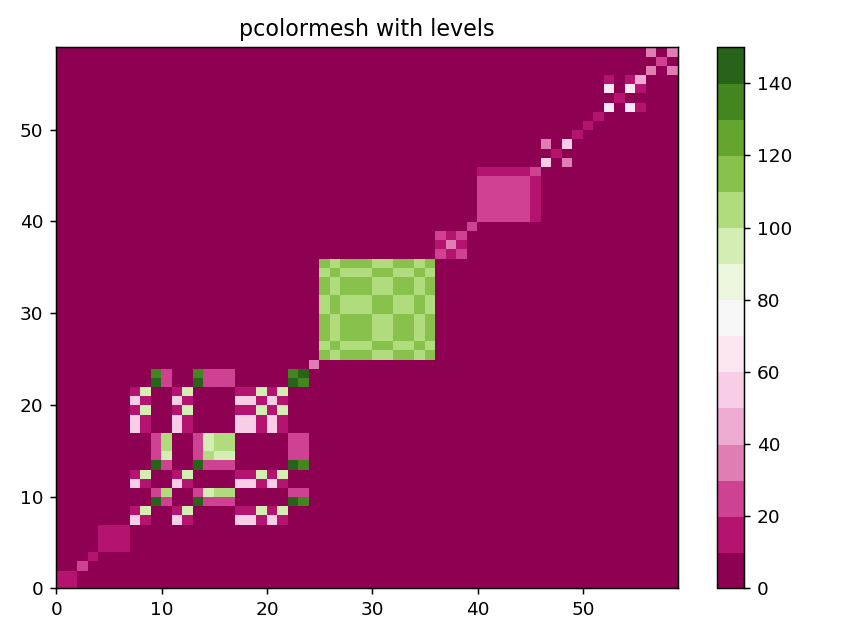

In [188]:
drawhist2(some_changes, metrics)

<IPython.core.display.Javascript object>


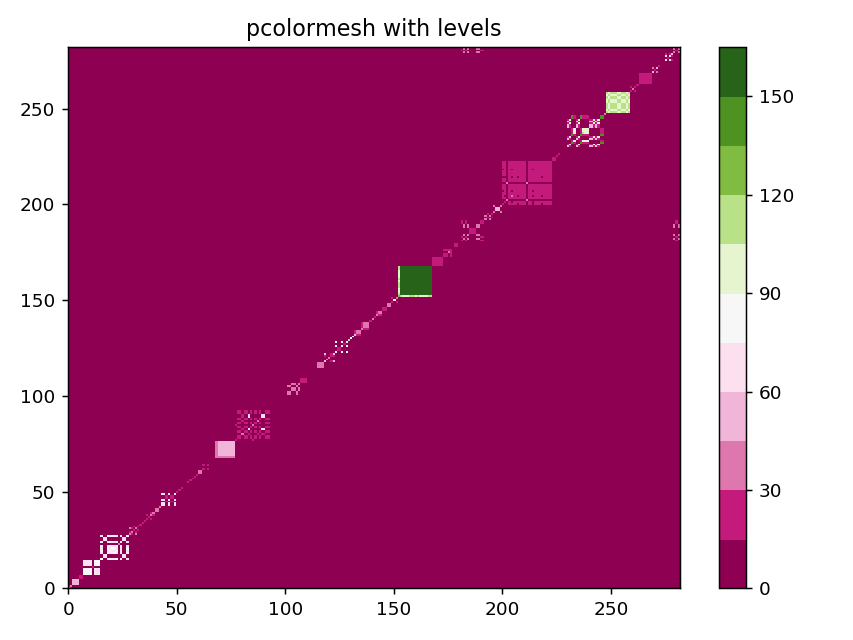

In [197]:
drawhist2(some_changes, metrics)

<IPython.core.display.Javascript object>


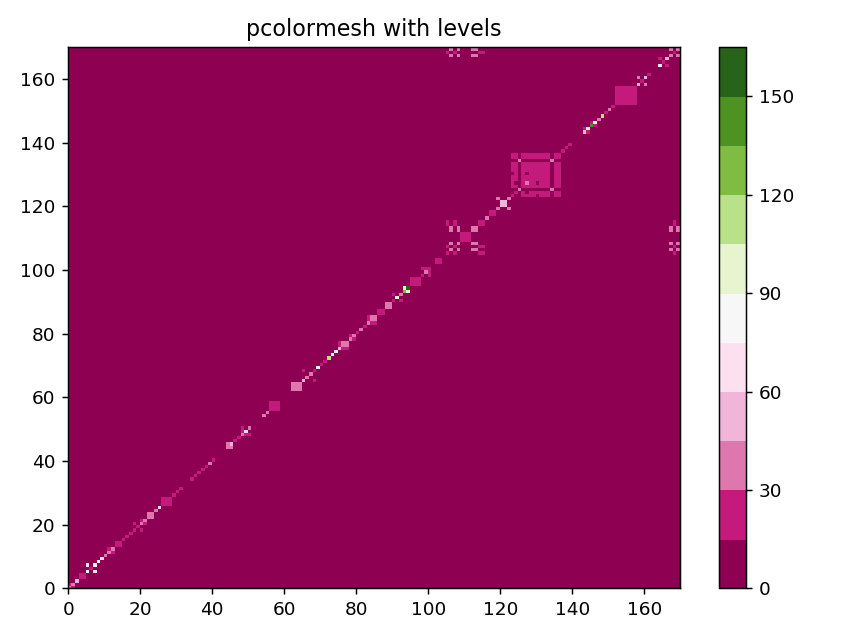

In [216]:
drawhist2(some_changes, metrics) # 50 patterns with different fragments

<IPython.core.display.Javascript object>


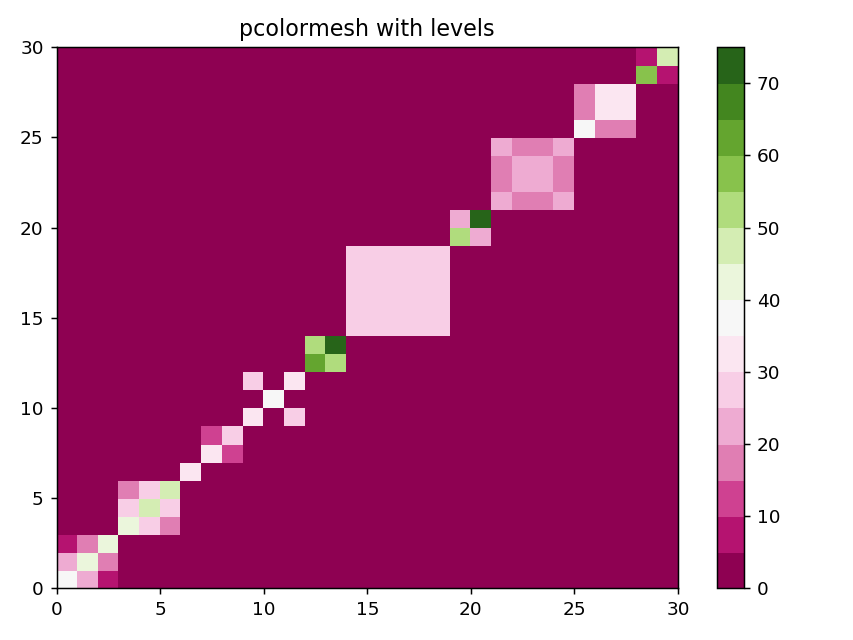

In [223]:
drawhist2(some_changes, metrics) # 10 patterns with different fragments

In [225]:
(19, 4767, 1)
(19, 4767, 2)
(19, 4767, 3)

(19, 4834, 1)
(19, 4834, 2)
(19, 4834, 3)

(19, 4968, 1)
(19, 4968, 2)
(19, 4968, 3)
(19, 4974, 1)
(19, 4974, 2)
(19, 4974, 5)
(19, 5234, 1)
(19, 5234, 2)
(19, 6167, 1)
(19, 6167, 2)
(19, 6167, 3)
(19, 6167, 4)
(19, 6167, 5)
(19, 6479, 1)
(19, 6479, 3)
(19, 6480, 1)
(19, 6480, 2)
(19, 6480, 3)
(19, 6480, 4)
(19, 6657, 1)
(19, 6657, 2)
(19, 6657, 4)
(19, 7314, 1)
(19, 7314, 2)
(19, 7314, 4)

(19, 7314, 4)

<IPython.core.display.Javascript object>


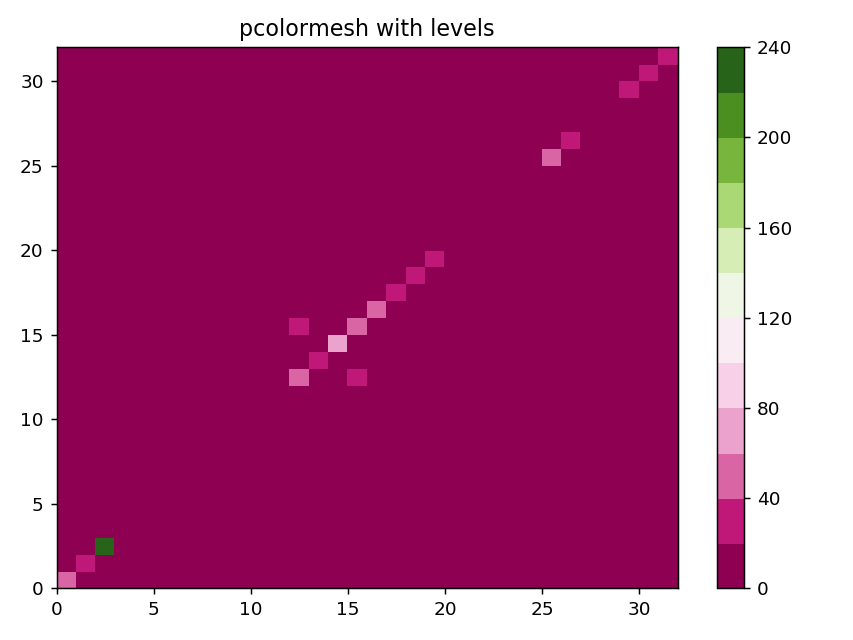

In [230]:
drawhist2(some_changes, metrics) # 10 patterns with different fragments

In [ ]:
(10, 6441, 1)
(10, 6441, 2)
(10, 6441, 3)
(10, 6489, 1)
(10, 6489, 2)
(10, 6489, 3)
(10, 6489, 4)
(10, 6489, 5)
(10, 6489, 6)
(10, 6515, 1)
(10, 6515, 2)
(10, 6515, 3)
(10, 6538, 1)
(10, 6538, 2)
(10, 6538, 3)
(10, 6538, 4)
(10, 6538, 5)
(10, 6646, 1)
(10, 6646, 2)
(10, 6646, 3)
(10, 6660, 1)
(10, 6660, 2)
(10, 6660, 3)
(10, 6660, 4)
(10, 6660, 5)
(10, 6754, 1)
(10, 6754, 2)
(10, 6764, 1)
(10, 6764, 3)
(10, 6843, 1)
(10, 6843, 2)
(10, 6881, 1)
(10, 6881, 4)

<IPython.core.display.Javascript object>


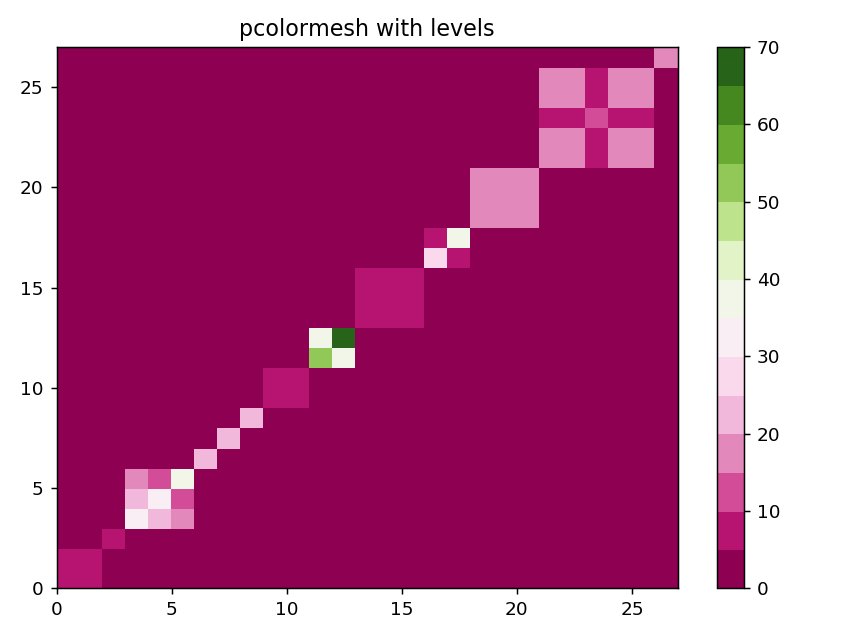

In [236]:
drawhist2(some_changes, metrics) # 10 patterns with different fragments

<IPython.core.display.Javascript object>


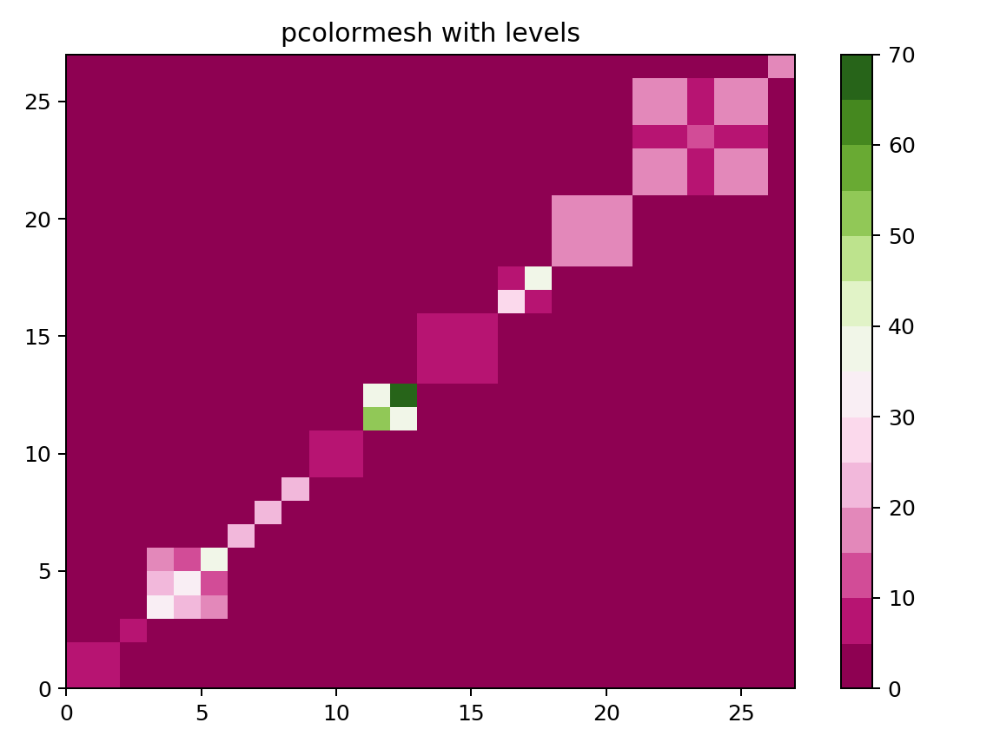

In [47]:
drawhist2(some_changes, metrics)

<IPython.core.display.Javascript object>


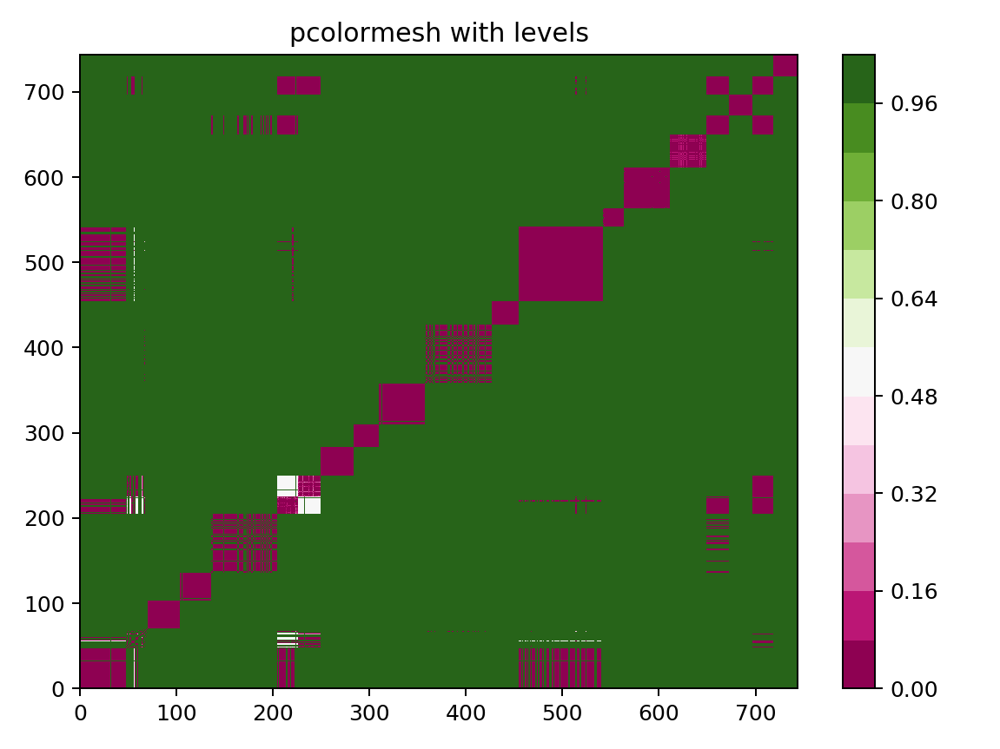

In [119]:
drawhist2(some_changes, dists_for_tops)

<IPython.core.display.Javascript object>


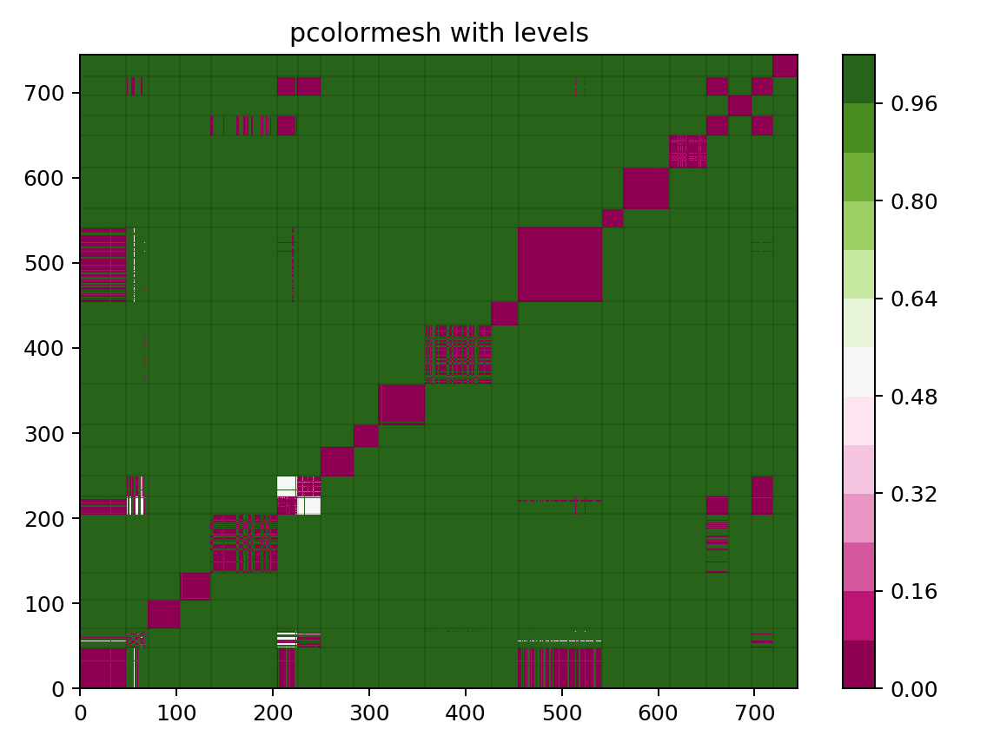

In [198]:
drawhist2(some_changes, dists_for_tops, True)

### Наблюдения:
1. Данные не такие уж плохие (т. е., не идентичные пределах паттерна), так как некоторые изменения из разных паттернов близки, а внутри паттернов — нет
2. У паттернов (5, 2013) и (9, 6293) много близких изменений. Например, у двух изменений (5, 2013, 16) и (9, 6293, 54) два общих n-грамма ([(14, 1, 1), (17, 1, 1)]):

        DEL SimpleName@@ DEL SimpleName@@ DEL MethodInvocation@@ DEL SimpleName@@ DEL SimpleName@@
        DEL SimpleName@@ DEL MethodInvocation@@ DEL SimpleName@@ DEL SimpleName@@ DEL MethodInvocation@@

(удаление вызова метода, в аргументах которого вызывался ещё один метод)

При этом у (9, 6293, 54) и (9, 6293, 52) тоже два общих n-грамма ([(354, 1, 1), (3666, 1, 1)]):

        DEL Block@@ DEL SimpleName@@ DEL SimpleType@@ DEL SimpleName@@ DEL SingleVariableDeclaration@@
        DEL SimpleName@@ DEL Block@@ DEL SimpleName@@ DEL SimpleType@@ DEL SimpleName@@
(удаление **catch (AssertionError e) {}**)
3. У паттерна (8, 2266) много далёких изменений


In [180]:
dists_for_tops[15][508]
print(hists[15])
print(hists[508])
print("Intersections:", get_intersections(hists[15], hists[508]))
print("Intersections:", get_intersections(hists[506], hists[508]))
print(some_changes[15], some_changes[508], some_changes[506])

[(14, 1), (17, 1), (201, 1), (288, 1), (303, 1), (442, 1), (1152, 1), (5441, 1)]
[(14, 1), (17, 1), (302, 1), (354, 1), (601, 1), (622, 1), (1141, 1), (3116, 1), (3666, 1), (3794, 1), (3816, 1), (4248, 1), (4285, 1), (18081, 1), (29234, 1), (30600, 1), (30955, 1), (34899, 1)]
Intersections: [(14, 1, 1), (17, 1, 1)]
Intersections: [(354, 1, 1), (3666, 1, 1)]
(5, 2013, 16) (9, 6293, 54) (9, 6293, 52)


In [ ]:
Dictionary of possible labels

1 AnonymousClassDeclaration
2 ArrayAccess
3 ArrayCreation
4 ArrayInitializer
5 ArrayType
6 AssertStatement
7 Assignment
8 Block
9 BooleanLiteral
10 BreakStatement
11 CastExpression
12 CatchClause
13 CharacterLiteral
14 ClassInstanceCreation
15 CompilationUnit
16 ConditionalExpression
17 ConstructorInvocation
18 ContinueStatement
19 DoStatement
20 EmptyStatement
21 ExpressionStatement
22 FieldAccess
23 FieldDeclaration
24 ForStatement
25 IfStatement
26 ImportDeclaration
27 InfixExpression
28 Initializer
29 Javadoc
30 LabeledStatement
31 MethodDeclaration
32 MethodInvocation
33 NullLiteral
34 NumberLiteral
35 PackageDeclaration
36 ParenthesizedExpression
37 PostfixExpression
38 PrefixExpression
39 PrimitiveType
40 QualifiedName
41 ReturnStatement
42 SimpleName
43 SimpleType
44 SingleVariableDeclaration
45 StringLiteral
46 SuperConstructorInvocation
47 SuperFieldAccess
48 SuperMethodInvocation
49 SwitchCase
50 SwitchStatement
51 SynchronizedStatement
52 ThisExpression
53 ThrowStatement
54 TryStatement
55 TypeDeclaration

57 TypeLiteral
58 VariableDeclarationExpression
59 VariableDeclarationFragment
60 VariableDeclarationStatement
61 WhileStatement
62 InstanceofExpression

65 TagElement
66 TextElement
67 MemberRef
68 MethodRef
69 MethodRefParameter
70 EnhancedForStatement
71 EnumDeclaration
72 EnumConstantDeclaration
73 TypeParameter
74 ParameterizedType

76 WildcardType
77 NormalAnnotation
78 MarkerAnnotation
79 SingleMemberAnnotation
80 MemberValuePair

83 Modifier
84 UnionType
85 Dimension
86 LambdaExpression

90 ExpressionMethodReference

In [159]:
some_changes_nums

[((5, 2013), 48, 0),
 ((5, 2065), 23, 48),
 ((5, 6537), 33, 71),
 ((6, 628), 32, 104),
 ((6, 3264), 69, 136),
 ((6, 4656), 21, 205),
 ((6, 12580), 24, 226),
 ((6, 14540), 34, 250),
 ((8, 111), 26, 284),
 ((8, 1486), 48, 310),
 ((8, 2266), 69, 358),
 ((8, 8667), 28, 427),
 ((9, 6293), 87, 455),
 ((9, 9750), 22, 542),
 ((10, 3256), 48, 564),
 ((10, 11483), 38, 612),
 ((11, 6085), 23, 650),
 ((11, 9826), 24, 673),
 ((19, 7496), 22, 697),
 ((19, 13424), 26, 719)]

In [184]:
noise = []
noisy_patterns = set()

clusters = collections.defaultdict(list)
num_changes = len(some_changes)

for i in range(num_changes):
    el = clustering.labels_[i]
    if (el == -1):
        noise.append(some_changes[i])
        noisy_patterns.add((some_changes[i][0], some_changes[i][1]))
    else:
        clusters[el].append(some_changes[i])

for key in clusters:
    print(clusters[key])
    print("\n")
print("NOISE:", noise)

dict_res = collections.defaultdict(int)

print("\n")
for key in clusters:
    if_noisy = ""
    if ((clusters[key][0][0], clusters[key][0][1]) in noisy_patterns):
        if_noisy = "noisy"
    print(clusters[key][0], if_noisy)
    
print(noisy_patterns)

[(5, 2013, 1), (5, 2013, 2), (5, 2013, 3), (5, 2013, 4), (5, 2013, 5), (5, 2013, 6), (5, 2013, 7), (5, 2013, 8), (5, 2013, 9), (5, 2013, 10), (5, 2013, 11), (5, 2013, 12), (5, 2013, 13), (5, 2013, 14), (5, 2013, 15), (5, 2013, 16), (5, 2013, 17), (5, 2013, 18), (5, 2013, 19), (5, 2013, 20), (5, 2013, 21), (5, 2013, 22), (5, 2013, 23), (5, 2013, 24), (5, 2013, 25), (5, 2013, 26), (5, 2013, 27), (5, 2013, 28), (5, 2013, 29), (5, 2013, 30), (5, 2013, 31), (5, 2013, 32), (5, 2013, 34), (5, 2013, 35), (5, 2013, 36), (5, 2013, 37), (5, 2013, 38), (5, 2013, 39), (5, 2013, 40), (5, 2013, 41), (5, 2013, 42), (5, 2013, 43), (5, 2013, 44), (5, 2013, 45), (5, 2013, 46), (5, 2013, 47), (5, 2013, 48)]


[(5, 2065, 1), (5, 2065, 4)]


[(5, 2065, 5), (5, 2065, 6), (5, 2065, 11), (5, 2065, 12), (5, 2065, 18)]


[(5, 2065, 14), (5, 2065, 21)]


[(5, 2065, 19), (5, 2065, 22)]


[(5, 6537, 1), (5, 6537, 2), (5, 6537, 3), (5, 6537, 4), (5, 6537, 5), (5, 6537, 6), (5, 6537, 7), (5, 6537, 8), (5, 6537, 9), (

### Результаты кластеризации:
1. Все кластеры содержат изменения только из одного паттерна
2. **8** паттернов кластеризовались идеально   
**3** паттерна кластеризовались с шумом (какие-то эл-ты были откинуты)  
**2** паттерна кластеризовались на несколько кластеров без шума  
**7** — на несколько кластеров с шумом

In [123]:
some_changes[205:249]

[(6, 4656, 1),
 (6, 4656, 2),
 (6, 4656, 3),
 (6, 4656, 4),
 (6, 4656, 5),
 (6, 4656, 6),
 (6, 4656, 7),
 (6, 4656, 8),
 (6, 4656, 9),
 (6, 4656, 10),
 (6, 4656, 11),
 (6, 4656, 12),
 (6, 4656, 13),
 (6, 4656, 14),
 (6, 4656, 15),
 (6, 4656, 16),
 (6, 4656, 17),
 (6, 4656, 18),
 (6, 4656, 19),
 (6, 4656, 20),
 (6, 4656, 21),
 (6, 12580, 1),
 (6, 12580, 2),
 (6, 12580, 3),
 (6, 12580, 4),
 (6, 12580, 5),
 (6, 12580, 6),
 (6, 12580, 7),
 (6, 12580, 9),
 (6, 12580, 10),
 (6, 12580, 11),
 (6, 12580, 12),
 (6, 12580, 13),
 (6, 12580, 14),
 (6, 12580, 15),
 (6, 12580, 17),
 (6, 12580, 18),
 (6, 12580, 19),
 (6, 12580, 20),
 (6, 12580, 21),
 (6, 12580, 22),
 (6, 12580, 24),
 (6, 12580, 25),
 (6, 12580, 26)]

In [ ]:
(10, 13553, 1)
(10, 13553, 2)
(10, 13553, 3)
(10, 13714, 1)
(10, 13714, 2)
(10, 13714, 3)
(10, 13751, 1)
(10, 13751, 2)
(10, 13751, 3)
(10, 13987, 1)
(10, 13987, 2)
(10, 14021, 1)
(10, 14021, 2)
(10, 14030, 1)
(10, 14030, 2)
(10, 14030, 3)
(10, 14076, 1)
(10, 14076, 2)
(10, 14084, 1)
(10, 14084, 2)
(10, 14084, 3)
(10, 14189, 1)
(10, 14189, 2)
(10, 14189, 3)
(10, 14189, 4)
(10, 14189, 5)
(10, 14204, 1)
(10, 14204, 3)

# Analyzing tops 20 from final dataset (5 gram)

## First metric (Jaccard distance): $\sum_{i \in intersection}\frac{min(hist1[i], hist2[i])}{max(hist1[i], hist2[i])}$

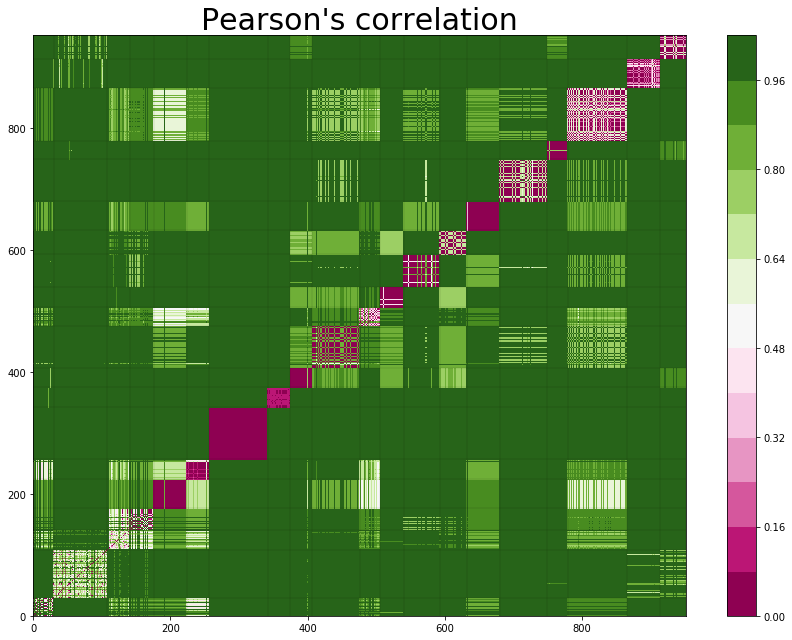

In [611]:
dists_for_tops = get_dists(hists_3gram, pearsons_correlation_mean, hist_len_3gram)
drawhist2(some_changes, dists_for_tops, True, title="Pearson's correlation")

<IPython.core.display.Javascript object>


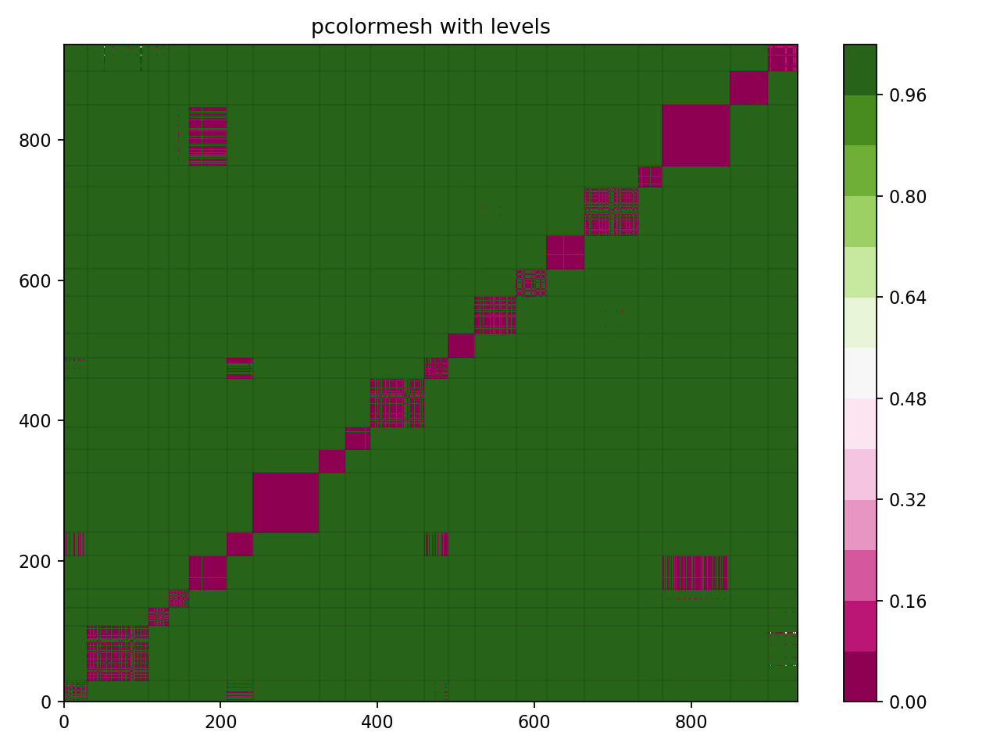

In [38]:
dists_for_tops = get_dists(hists, jaccard_metric, hist_len_5gram)
drawhist2(some_changes, dists_for_tops, True)

In [39]:
some_changes_nums

[((3, 6789), 30, 0),
 ((4, 1645), 78, 30),
 ((4, 8462), 26, 108),
 ((4, 13964), 26, 134),
 ((5, 2013), 48, 160),
 ((5, 4912), 33, 208),
 ((5, 5396), 85, 241),
 ((5, 6537), 33, 326),
 ((6, 628), 32, 359),
 ((6, 3264), 69, 391),
 ((6, 4703), 30, 460),
 ((6, 14540), 34, 490),
 ((6, 14981), 53, 524),
 ((7, 10354), 39, 577),
 ((8, 1486), 48, 616),
 ((8, 2266), 69, 664),
 ((8, 8667), 30, 733),
 ((9, 6293), 87, 763),
 ((10, 3256), 48, 850),
 ((10, 11483), 38, 898)]

In [43]:
# Clustering


clustering = sklearn.cluster.DBSCAN(eps=0.85, min_samples=2, metric='precomputed').fit(dists_for_tops)

In [755]:
def print_clustering_results(clustering, some_changes, to_print=True):
    noise = []
    noisy_patterns = set()
    patterns = set()
    
    ideal_clustered = []
    
    from_pattern_to_num = collections.defaultdict(int)
    
    clusters_only_one_pattern = []

    clusters = collections.defaultdict(list)
    num_changes = len(some_changes)

    for i in range(num_changes):
        pattern = (some_changes[i][0], some_changes[i][1])
        
        patterns.add(pattern)
        from_pattern_to_num[pattern] += 1
        
        el = clustering.labels_[i]
        if (el == -1):
            noise.append(some_changes[i])
            noisy_patterns.add(pattern)
        else:
            clusters[el].append(some_changes[i])
            
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    
    for i in range(len(clustering.labels_)):
        for j in range(len(clustering.labels_)):
            if i < j:
                if some_changes[i][1] == some_changes[j][1]:
                    if clustering.labels_[i] == clustering.labels_[j]:
                        tp += 1
                    else:
                        fp += 1
                else:
                    if clustering.labels_[i] == clustering.labels_[j]:
                        tn += 1
                    else:
                        fn += 1
                        
    rand = round(100 * (tp + fn) / (tp + tn + fp + fn), 3)
                
    if to_print:
        for key in clusters:
            print(clusters[key])

            patterns_in_cluster = set()
            for elem in clusters[key]:
                patterns_in_cluster.add((elem[0], elem[1]))
            if len(patterns_in_cluster) == 1:
                clusters_only_one_pattern.append(key)

                pattern = (clusters[key][0][0], clusters[key][0][1])
                print(len(clusters[key]))
                print(from_pattern_to_num[pattern])

                if len(clusters[key]) == from_pattern_to_num[pattern]:
                    ideal_clustered.append((clusters[key][0][0], clusters[key][0][1]))

            print("\n")
        
        print("NOISE:", noise)

        dict_res = collections.defaultdict(int)

        print("\n")
        for key in clusters:
            if_noisy = ""
            if ((clusters[key][0][0], clusters[key][0][1]) in noisy_patterns):
                if_noisy = "noisy"
            print(clusters[key][0], if_noisy)

        print("\n")

        print("NUM CHANGES:", num_changes)
        print("NUM PATTERNS:", len(patterns))
        print("NUM CLUSTERS:", len(clusters))
        print("\n")

        percent_ideal = round(len(ideal_clustered) / len(patterns) * 100, 2)
        print("IDEAL CLUSTERED PATTERNS:", len(ideal_clustered), "(" + str(percent_ideal) + "%)")
        print("Ideal clustered:", ideal_clustered, "\n")

        percent_clusters_only_one_pattern = round(len(clusters_only_one_pattern) / len(clusters) * 100, 2)
        print("CLUSTERS WITH ELEMENTS FROM ONLY ONE PATTERN:", 
              len(clusters_only_one_pattern), "(" + str(percent_clusters_only_one_pattern) + "%)")
        print("\n")

        percent_noise = round(len(noise) / num_changes * 100, 2)
        print("NUMBER OF NOISE (CHANGES):", len(noise), "(" + str(percent_noise) + "%)")
        print("Noisy patterns:", noisy_patterns)

        print()
        print("Rand:", rand)
    
    return rand
    
print_clustering_results(clustering, some_changes)

[(3, 6789, 3), (3, 6789, 4), (3, 6789, 6), (3, 6789, 7), (3, 6789, 8), (3, 6789, 12), (3, 6789, 13), (3, 6789, 15), (3, 6789, 16), (3, 6789, 17), (3, 6789, 19), (3, 6789, 22), (3, 6789, 23), (3, 6789, 24), (3, 6789, 25), (3, 6789, 28), (3, 6789, 30), (3, 6789, 31), (3, 6789, 33), (3, 6789, 34), (3, 6789, 36), (3, 6789, 38), (5, 4912, 1), (5, 4912, 2), (5, 4912, 3), (5, 4912, 4), (5, 4912, 5), (5, 4912, 6), (5, 4912, 7), (5, 4912, 8), (5, 4912, 9), (5, 4912, 10), (5, 4912, 11), (5, 4912, 12), (5, 4912, 13), (5, 4912, 14), (5, 4912, 15), (5, 4912, 16), (5, 4912, 17), (5, 4912, 18), (5, 4912, 19), (5, 4912, 20), (5, 4912, 21), (5, 4912, 22), (5, 4912, 23), (5, 4912, 24), (5, 4912, 25), (5, 4912, 26), (5, 4912, 27), (5, 4912, 28), (5, 4912, 29), (5, 4912, 30), (5, 4912, 31), (5, 4912, 32), (5, 4912, 33), (6, 4703, 1), (6, 4703, 2), (6, 4703, 3), (6, 4703, 4), (6, 4703, 5), (6, 4703, 6), (6, 4703, 7), (6, 4703, 8), (6, 4703, 9), (6, 4703, 10), (6, 4703, 11), (6, 4703, 12), (6, 4703, 13), (6

96.044

In [45]:
# Let's try to shuffle
import sklearn.cluster

import random

shuffled_some_changes = some_changes.copy()
random.shuffle(shuffled_some_changes)

shuffled_hists = get_hists(shuffled_some_changes, RESULTS_FOR_HIST_PATH_5GRAM, "5gram")
dists_for_shuffled = get_dists(shuffled_hists, jaccard_metric, hist_len_5gram)

In [46]:
clustering_for_shuffled = sklearn.cluster.DBSCAN(eps=0.85, min_samples=2, metric='precomputed').fit(dists_for_shuffled)
print_clustering_results(clustering_for_shuffled, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 48), (9, 6293, 36), (9, 6293, 66), (5, 2013, 12), (4, 13964, 13), (4, 13964, 17), (9, 6293, 63), (9, 6293, 73), (5, 2013, 45), (5, 2013, 6), (5, 2013, 7), (5, 2013, 35), (5, 2013, 9), (5, 2013, 14), (9, 6293, 77), (9, 6293, 28), (9, 6293, 61), (9, 6293, 38), (5, 2013, 20), (5, 2013, 11), (9, 6293, 50), (9, 6293, 69), (9, 6293, 43), (9, 6293, 71), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (5, 2013, 8), (9, 6293, 52), (9, 6293, 29), (9, 6293, 55), (9, 6293, 59), (9, 6293, 8), (5, 2013, 18), (9, 6293, 45), (4, 13964, 3), (9, 6293, 2), (9, 6293, 17), (5, 2013, 21), (9, 6293, 81), (9, 6293, 9), (9, 6293, 70), (5, 2013, 2), (9, 6293, 31), (9, 6293, 27), (5, 2013, 32), (9, 6293, 46), (9, 6293, 12), (4, 13964, 10), (9, 62

## Canberra metric: $\sum_i\frac{|p_i - q_i|}{|p_i| + |q_i|} / |union(p, q)|$

<IPython.core.display.Javascript object>


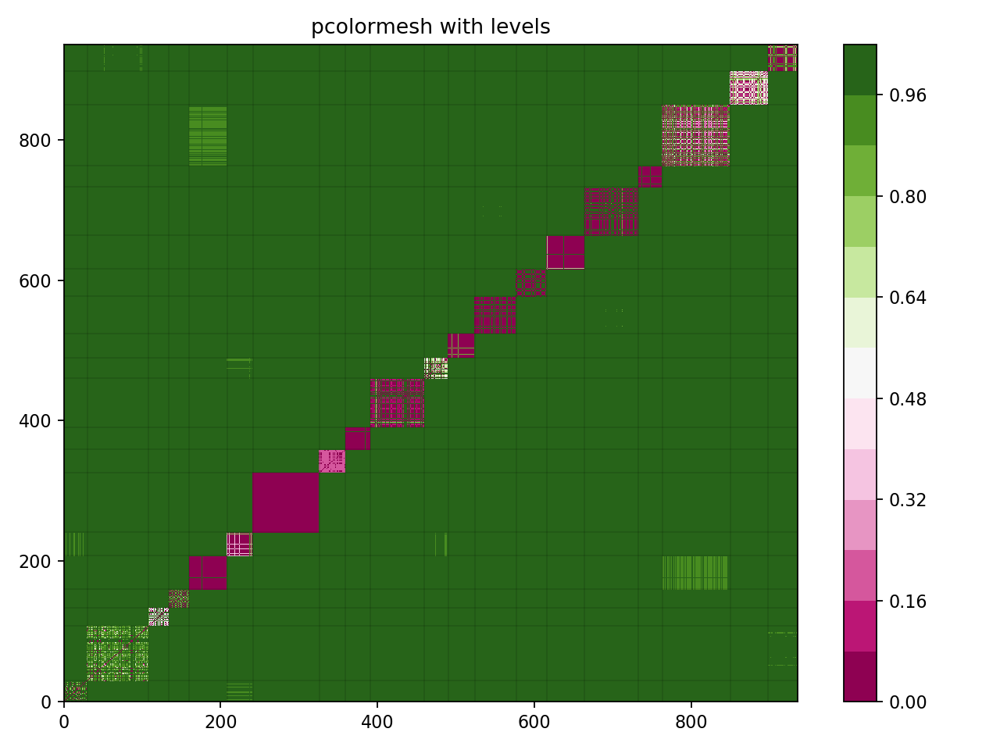

In [47]:
canberra_dists = get_dists(hists, canberra_metric, hist_len_5gram)
drawhist2(some_changes, canberra_dists, True)

In [145]:
print(numpy.array(canberra_dists)[500:524][:,500:524])

[[0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.8 0.8 0.8 0.  0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8
  0.8 0.8 0.8 0.8 0.8 0.8]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.8 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. ]

<IPython.core.display.Javascript object>


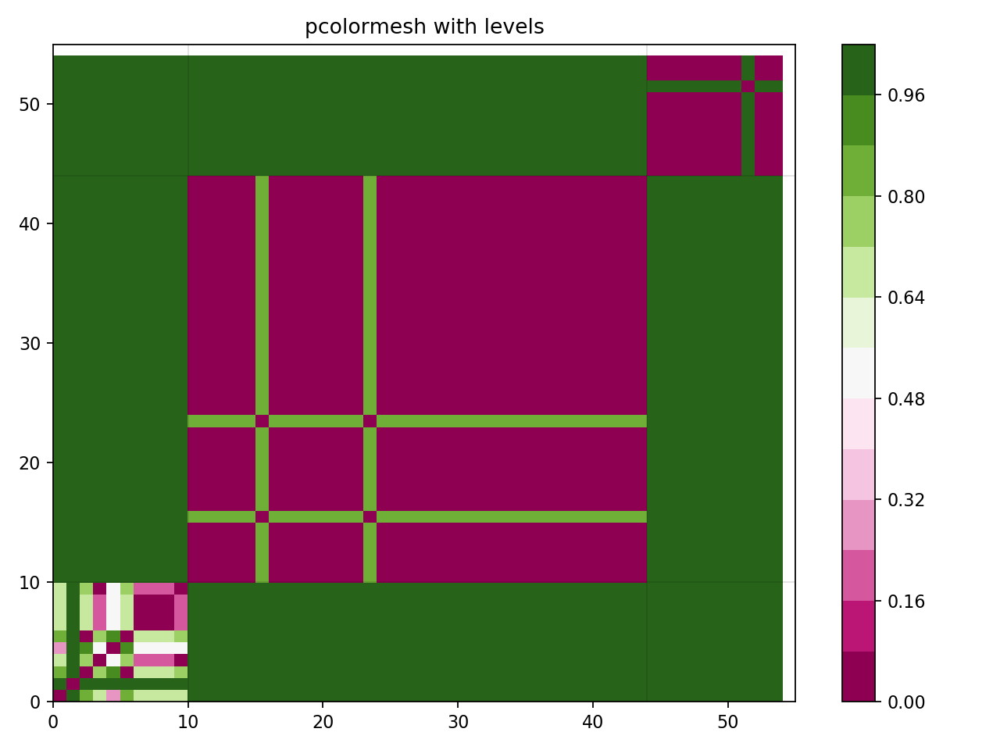

[(6, 14540, 1), (6, 14540, 2), (6, 14540, 3), (6, 14540, 4), (6, 14540, 5), (6, 14540, 6), (6, 14540, 7), (6, 14540, 8), (6, 14540, 9), (6, 14540, 10), (6, 14540, 11), (6, 14540, 12), (6, 14540, 13), (6, 14540, 14), (6, 14540, 15), (6, 14540, 16), (6, 14540, 17), (6, 14540, 18), (6, 14540, 19), (6, 14540, 20), (6, 14540, 21), (6, 14540, 22), (6, 14540, 23), (6, 14540, 24), (6, 14540, 25), (6, 14540, 26), (6, 14540, 27), (6, 14540, 28), (6, 14540, 29), (6, 14540, 30), (6, 14540, 31), (6, 14540, 32), (6, 14540, 33), (6, 14540, 34)]
34
34


NOISE: []


(6, 14540, 1) 


NUM CHANGES: 34
NUM PATTERNS: 1
NUM CLUSTERS: 1


IDEAL CLUSTERED PATTERNS: 1 (100.0%)
Ideal clustered: [(6, 14540)] 

CLUSTERS WITH ELEMENTS FROM ONLY ONE PATTERN: 1 (100.0%)


NUMBER OF NOISE (CHANGES): 0 (0.0%)
Noisy patterns: set()


In [163]:
import numpy

# Example I need to think about !!!
# Why DBSCAN doesn't take two green lines (corresponding changes) to the cluster?
# SOLVED (metric='precomputed')

ds = numpy.array(canberra_dists)[490:524][:,490:524]

drawhist2(some_changes[480:535], numpy.array(canberra_dists)[480:535][:,480:535], True)

clustering_tmp = sklearn.cluster.DBSCAN(eps=0.8, min_samples=1, metric='precomputed').fit(ds)
print_clustering_results(clustering_tmp, some_changes[490:524])

In [48]:
# Using shuffled some_changes

dists_canberra = get_dists(shuffled_hists, canberra_metric, hist_len_5gram)

In [49]:
clustering_canberra = sklearn.cluster.DBSCAN(eps=0.85, min_samples=2, metric='precomputed').fit(dists_canberra)
print_clustering_results(clustering_canberra, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 66), (9, 6293, 43), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (9, 6293, 29), (9, 6293, 59), (9, 6293, 17), (9, 6293, 70), (9, 6293, 12), (9, 6293, 4), (9, 6293, 86), (9, 6293, 85), (9, 6293, 19), (9, 6293, 7), (9, 6293, 72), (9, 6293, 51), (9, 6293, 76), (9, 6293, 14), (9, 6293, 78), (9, 6293, 24), (9, 6293, 1), (9, 6293, 54), (9, 6293, 87), (9, 6293, 39), (9, 6293, 53), (9, 6293, 15)]
28
87


[(8, 2266, 29), (8, 2266, 74), (8, 2266, 2), (8, 2266, 24), (8, 2266, 40), (8, 2266, 68), (8, 2266, 53), (8, 2266, 37), (8, 2266, 46), (8, 2266, 88), (8, 2266, 59), (8, 2266, 94), (8, 2266, 86), (8, 2266, 45), (8, 2266, 8), (8, 2266, 43)]
16
69


[(9, 6293, 48), (9, 6293, 36), (9, 6293, 63), (9, 6293, 73), (9, 6293, 77), (9,

In [ ]:
# MeanShift doesn't have metric='precomputed' option

'''
clustering_canberra = sklearn.cluster.MeanShift(bandwidth=2).fit(dists_canberra)
print_clustering_results(clustering_canberra, shuffled_some_changes)
'''

In [50]:
dists_canberra = get_dists(shuffled_hists, canberra_metric, hist_len_5gram)
clustering_canberra = sklearn.cluster.DBSCAN(eps=0.5, min_samples=5, metric='precomputed').fit(dists_canberra)
print_clustering_results(clustering_canberra, shuffled_some_changes)


[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 43), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (9, 6293, 29), (9, 6293, 59), (9, 6293, 70), (9, 6293, 12), (9, 6293, 4), (9, 6293, 86), (9, 6293, 85), (9, 6293, 19), (9, 6293, 7), (9, 6293, 72), (9, 6293, 51), (9, 6293, 76), (9, 6293, 14), (9, 6293, 78), (9, 6293, 24), (9, 6293, 1), (9, 6293, 54), (9, 6293, 87), (9, 6293, 39), (9, 6293, 15)]
25
87


[(8, 2266, 29), (8, 2266, 74), (8, 2266, 2), (8, 2266, 24), (8, 2266, 40), (8, 2266, 68), (8, 2266, 53), (8, 2266, 37), (8, 2266, 46), (8, 2266, 88), (8, 2266, 59), (8, 2266, 94), (8, 2266, 86), (8, 2266, 45), (8, 2266, 8), (8, 2266, 43)]
16
69


[(9, 6293, 48), (9, 6293, 36), (9, 6293, 63), (9, 6293, 73), (9, 6293, 77), (9, 6293, 28), (9, 6293, 61), (9, 6293, 38), (9

<IPython.core.display.Javascript object>


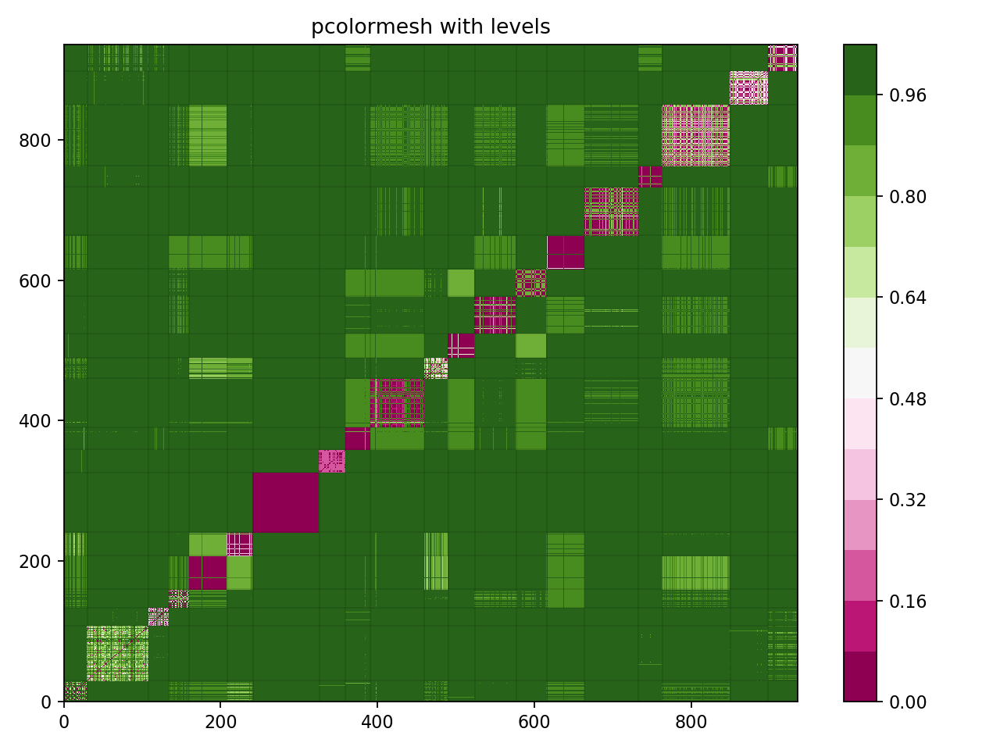

In [51]:
canberra_dists_3gram = get_dists(hists_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes, canberra_dists_3gram, True)

## Pearson's Correlation Coefficient: $1 - \frac{\sum_i(h_1(i) - \frac{1}{n})(h_2(i) - \frac{1}{n})}{\sqrt{\sum_i(h_1(i) - \frac{1}{n})^2 \sum_i(h_2(i) - \frac{1}{n})^2}}$

In [52]:
pearson_dists = get_dists(hists, pearsons_correlation, hist_len_5gram)

<IPython.core.display.Javascript object>


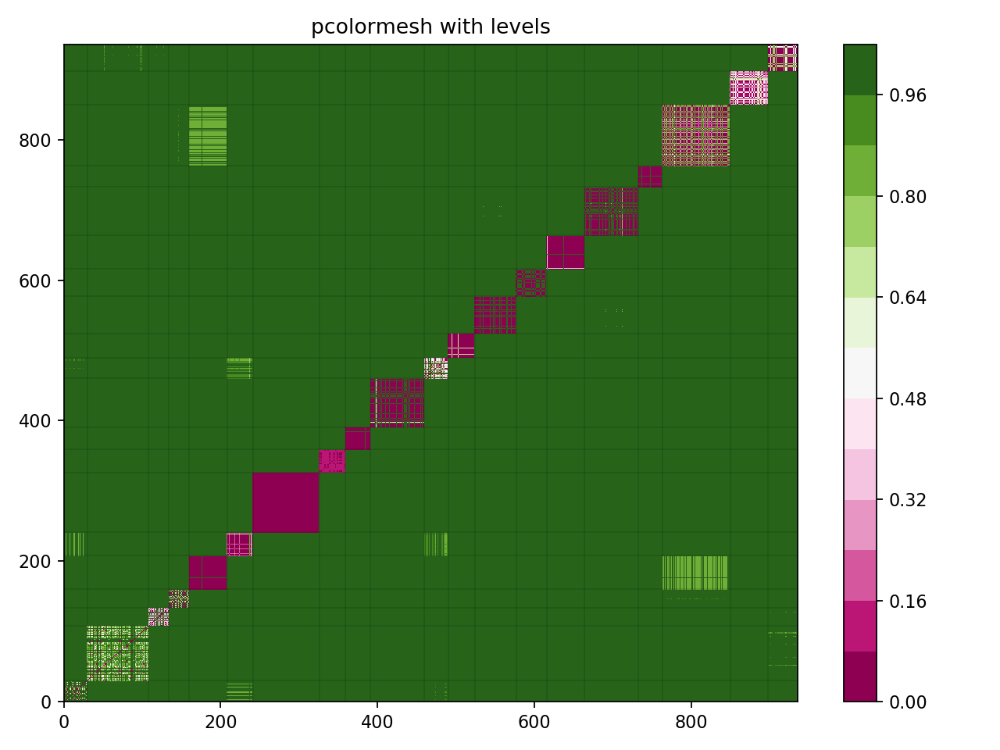

In [53]:
drawhist2(some_changes, pearson_dists, True)

In [54]:
some_changes_nums

[((3, 6789), 30, 0),
 ((4, 1645), 78, 30),
 ((4, 8462), 26, 108),
 ((4, 13964), 26, 134),
 ((5, 2013), 48, 160),
 ((5, 4912), 33, 208),
 ((5, 5396), 85, 241),
 ((5, 6537), 33, 326),
 ((6, 628), 32, 359),
 ((6, 3264), 69, 391),
 ((6, 4703), 30, 460),
 ((6, 14540), 34, 490),
 ((6, 14981), 53, 524),
 ((7, 10354), 39, 577),
 ((8, 1486), 48, 616),
 ((8, 2266), 69, 664),
 ((8, 8667), 30, 733),
 ((9, 6293), 87, 763),
 ((10, 3256), 48, 850),
 ((10, 11483), 38, 898)]

In [ ]:
# Research and think about Pearson dists

print(numpy.array(canberra_dists)[33:40][:,33:40])
print(numpy.array(pearson_dists)[33:40][:,33:40])
print(numpy.array(pearson_dists)[243:260][:,33:40])

In [55]:
# Using shuffled some_changes

dists_pearson = get_dists(shuffled_hists, pearsons_correlation, hist_len_5gram)

In [56]:
clustering_pearson = sklearn.cluster.DBSCAN(eps=0.7, min_samples=7, metric='precomputed').fit(dists_pearson)
print_clustering_results(clustering_pearson, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 66), (9, 6293, 43), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (9, 6293, 29), (9, 6293, 59), (9, 6293, 17), (9, 6293, 70), (9, 6293, 12), (9, 6293, 4), (9, 6293, 86), (9, 6293, 85), (9, 6293, 19), (9, 6293, 7), (9, 6293, 72), (9, 6293, 51), (9, 6293, 76), (9, 6293, 14), (9, 6293, 78), (9, 6293, 24), (9, 6293, 1), (9, 6293, 54), (9, 6293, 87), (9, 6293, 39), (9, 6293, 53), (9, 6293, 15)]
28
87


[(8, 2266, 29), (8, 2266, 74), (8, 2266, 2), (8, 2266, 24), (8, 2266, 40), (8, 2266, 68), (8, 2266, 53), (8, 2266, 37), (8, 2266, 46), (8, 2266, 88), (8, 2266, 59), (8, 2266, 94), (8, 2266, 86), (8, 2266, 45), (8, 2266, 8), (8, 2266, 43)]
16
69


[(9, 6293, 48), (9, 6293, 36), (9, 6293, 63), (9, 6293, 73), (9, 6293, 77), (9,

In [57]:
#dists_pearson = get_dists(shuffled_hists)
clustering_pearson = sklearn.cluster.DBSCAN(eps=0.5, min_samples=5, metric='precomputed').fit(dists_pearson)
print_clustering_results(clustering_pearson, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 66), (9, 6293, 43), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (9, 6293, 29), (9, 6293, 59), (9, 6293, 17), (9, 6293, 70), (9, 6293, 12), (9, 6293, 4), (9, 6293, 86), (9, 6293, 85), (9, 6293, 19), (9, 6293, 7), (9, 6293, 72), (9, 6293, 51), (9, 6293, 76), (9, 6293, 14), (9, 6293, 78), (9, 6293, 24), (9, 6293, 1), (9, 6293, 54), (9, 6293, 87), (9, 6293, 39), (9, 6293, 15)]
27
87


[(8, 2266, 29), (8, 2266, 74), (8, 2266, 2), (8, 2266, 24), (8, 2266, 40), (8, 2266, 68), (8, 2266, 53), (8, 2266, 37), (8, 2266, 46), (8, 2266, 88), (8, 2266, 59), (8, 2266, 94), (8, 2266, 86), (8, 2266, 45), (8, 2266, 8), (8, 2266, 43)]
16
69


[(9, 6293, 48), (9, 6293, 36), (9, 6293, 63), (9, 6293, 73), (9, 6293, 77), (9, 6293, 28), (9,

In [58]:
agglomerative = sklearn.cluster.AgglomerativeClustering(n_clusters=35, affinity='precomputed', linkage='average')
agglomerative = agglomerative.fit(dists_pearson)
print_clustering_results(agglomerative, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 48), (9, 6293, 36), (9, 6293, 66), (5, 2013, 12), (4, 13964, 13), (4, 13964, 17), (9, 6293, 63), (9, 6293, 73), (5, 2013, 45), (5, 2013, 6), (5, 2013, 7), (5, 2013, 35), (5, 2013, 9), (5, 2013, 14), (9, 6293, 77), (9, 6293, 28), (9, 6293, 61), (9, 6293, 38), (5, 2013, 20), (5, 2013, 11), (9, 6293, 50), (9, 6293, 69), (9, 6293, 43), (9, 6293, 71), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (5, 2013, 8), (9, 6293, 52), (9, 6293, 29), (9, 6293, 55), (9, 6293, 59), (9, 6293, 8), (5, 2013, 18), (9, 6293, 45), (4, 13964, 3), (9, 6293, 2), (9, 6293, 17), (5, 2013, 21), (9, 6293, 81), (9, 6293, 9), (9, 6293, 70), (5, 2013, 2), (9, 6293, 31), (9, 6293, 27), (5, 2013, 32), (9, 6293, 46), (9, 6293, 12), (4, 13964, 10), (9, 62

In [59]:
dists_pearson_np = np.array(dists_pearson)
spectral = sklearn.cluster.SpectralClustering(n_clusters=30, affinity='precomputed', 
                        assign_labels="discretize", random_state=0).fit(dists_pearson_np.max() - dists_pearson_np)
print_clustering_results(spectral, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 48), (9, 6293, 36), (9, 6293, 66), (5, 2013, 12), (9, 6293, 63), (9, 6293, 73), (5, 2013, 45), (5, 2013, 6), (5, 2013, 7), (5, 2013, 35), (5, 2013, 9), (5, 2013, 14), (9, 6293, 77), (9, 6293, 28), (9, 6293, 61), (9, 6293, 38), (5, 2013, 20), (5, 2013, 11), (9, 6293, 50), (9, 6293, 69), (9, 6293, 43), (9, 6293, 71), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (5, 2013, 8), (9, 6293, 52), (9, 6293, 29), (9, 6293, 55), (9, 6293, 59), (9, 6293, 8), (5, 2013, 18), (9, 6293, 45), (9, 6293, 2), (9, 6293, 17), (5, 2013, 21), (9, 6293, 81), (9, 6293, 9), (9, 6293, 70), (5, 2013, 2), (9, 6293, 31), (9, 6293, 27), (5, 2013, 32), (9, 6293, 46), (9, 6293, 12), (9, 6293, 79), (5, 2013, 23), (5, 2013, 38), (5, 2013, 29), (5, 2013,

# Researching particular changes

In [60]:
some_changes_nums

[((3, 6789), 30, 0),
 ((4, 1645), 78, 30),
 ((4, 8462), 26, 108),
 ((4, 13964), 26, 134),
 ((5, 2013), 48, 160),
 ((5, 4912), 33, 208),
 ((5, 5396), 85, 241),
 ((5, 6537), 33, 326),
 ((6, 628), 32, 359),
 ((6, 3264), 69, 391),
 ((6, 4703), 30, 460),
 ((6, 14540), 34, 490),
 ((6, 14981), 53, 524),
 ((7, 10354), 39, 577),
 ((8, 1486), 48, 616),
 ((8, 2266), 69, 664),
 ((8, 8667), 30, 733),
 ((9, 6293), 87, 763),
 ((10, 3256), 48, 850),
 ((10, 11483), 38, 898)]

<IPython.core.display.Javascript object>


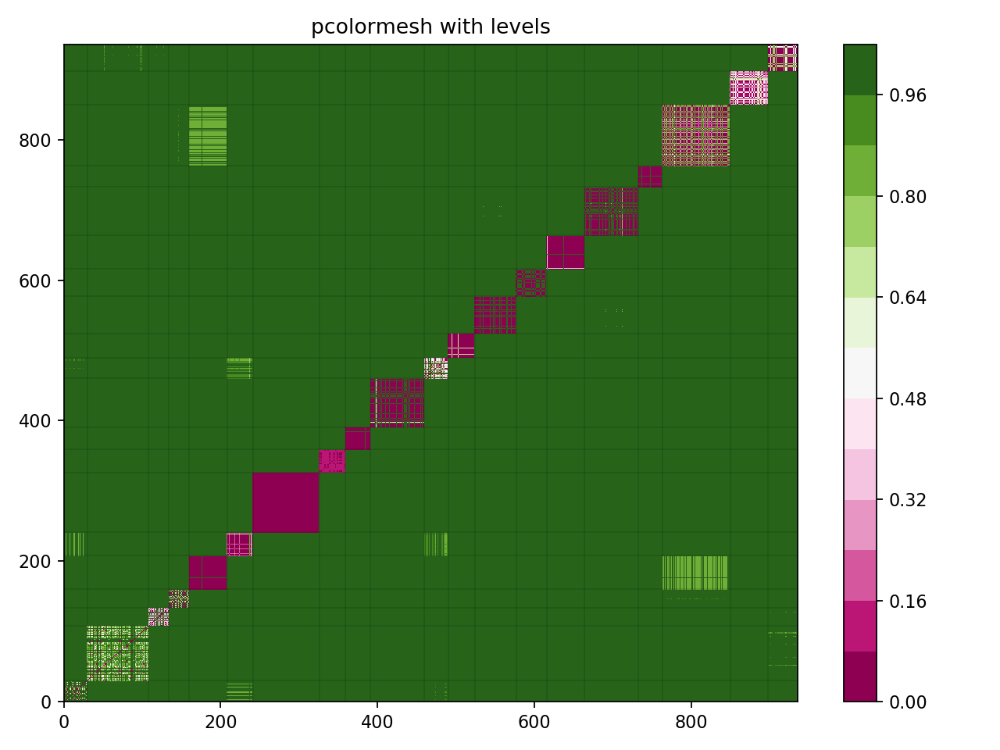

In [61]:
drawhist2(some_changes, pearson_dists, True)

<IPython.core.display.Javascript object>


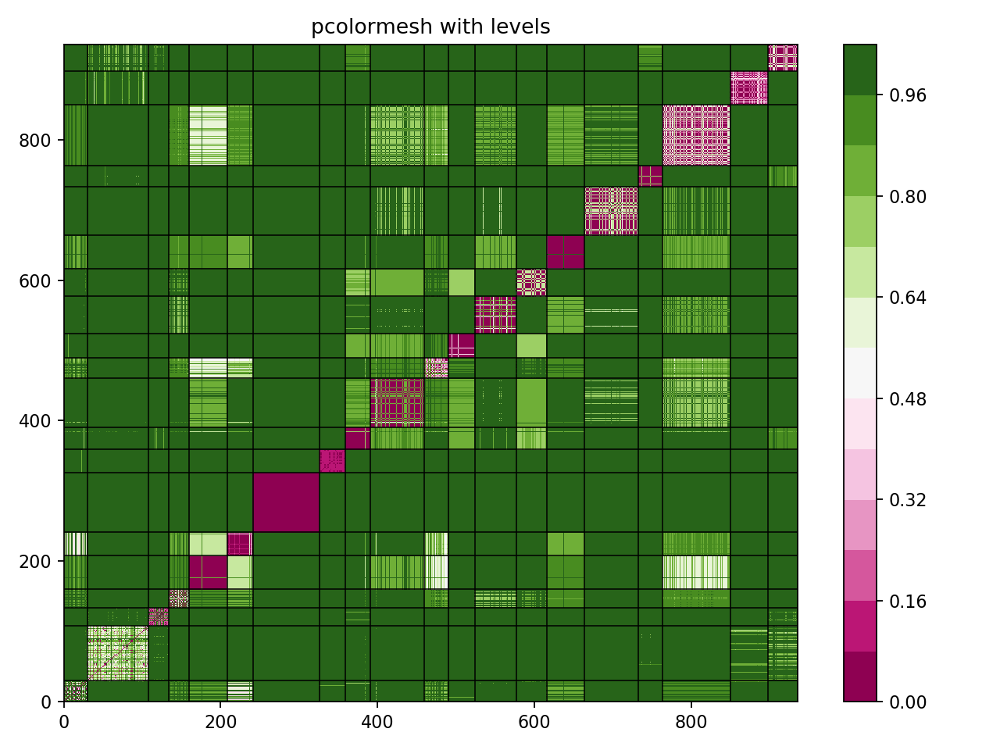

In [62]:
hists_3gram = get_hists(some_changes, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
pearson_dists_3gram = get_dists(hists_3gram, pearsons_correlation, hist_len_3gram)
drawhist2(some_changes, pearson_dists_3gram, True, lw=0.7)

In [175]:
clustering_pearson_3gram = sklearn.cluster.DBSCAN(eps=0.61, min_samples=2, metric='precomputed').fit(pearson_dists_3gram)
print_clustering_results(clustering_pearson_3gram, some_changes)


[(3, 6789, 3), (3, 6789, 4), (3, 6789, 6), (3, 6789, 8), (3, 6789, 12), (3, 6789, 13), (3, 6789, 16), (3, 6789, 17), (3, 6789, 19), (3, 6789, 23), (3, 6789, 24), (3, 6789, 25), (3, 6789, 28), (3, 6789, 30), (3, 6789, 33), (3, 6789, 34), (3, 6789, 36), (3, 6789, 38), (5, 2013, 1), (5, 2013, 2), (5, 2013, 3), (5, 2013, 4), (5, 2013, 5), (5, 2013, 6), (5, 2013, 7), (5, 2013, 8), (5, 2013, 9), (5, 2013, 10), (5, 2013, 11), (5, 2013, 12), (5, 2013, 13), (5, 2013, 14), (5, 2013, 15), (5, 2013, 16), (5, 2013, 18), (5, 2013, 19), (5, 2013, 20), (5, 2013, 21), (5, 2013, 22), (5, 2013, 23), (5, 2013, 24), (5, 2013, 25), (5, 2013, 26), (5, 2013, 27), (5, 2013, 28), (5, 2013, 29), (5, 2013, 30), (5, 2013, 31), (5, 2013, 32), (5, 2013, 33), (5, 2013, 34), (5, 2013, 35), (5, 2013, 36), (5, 2013, 37), (5, 2013, 38), (5, 2013, 39), (5, 2013, 40), (5, 2013, 41), (5, 2013, 42), (5, 2013, 43), (5, 2013, 44), (5, 2013, 45), (5, 2013, 46), (5, 2013, 47), (5, 2013, 48), (5, 4912, 1), (5, 4912, 2), (5, 4912,

<IPython.core.display.Javascript object>


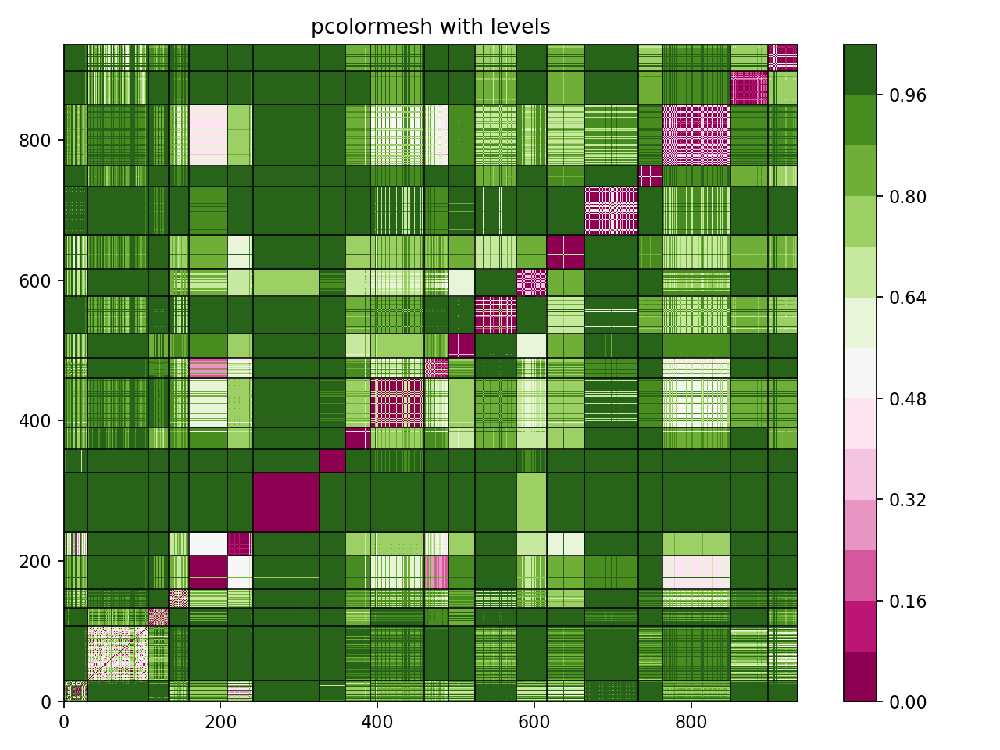

In [63]:
hists_2gram = get_hists(some_changes, hists_path=RESULTS_FOR_HIST_PATH_2GRAM, gram_path="2gram")
pearson_dists_2gram = get_dists(hists_2gram, pearsons_correlation, hist_len_2gram)
drawhist2(some_changes, pearson_dists_2gram, True, lw=0.7)

In [64]:
clustering_pearson_2gram = sklearn.cluster.DBSCAN(eps=0.48, min_samples=2, metric='precomputed').fit(pearson_dists_2gram)
print_clustering_results(clustering_pearson_2gram, some_changes)


[(3, 6789, 3), (3, 6789, 4), (3, 6789, 6), (3, 6789, 8), (3, 6789, 12), (3, 6789, 13), (3, 6789, 16), (3, 6789, 17), (3, 6789, 19), (3, 6789, 23), (3, 6789, 24), (3, 6789, 25), (3, 6789, 28), (3, 6789, 30), (3, 6789, 33), (3, 6789, 34), (3, 6789, 36), (3, 6789, 38), (5, 2013, 1), (5, 2013, 2), (5, 2013, 3), (5, 2013, 4), (5, 2013, 5), (5, 2013, 6), (5, 2013, 7), (5, 2013, 8), (5, 2013, 9), (5, 2013, 10), (5, 2013, 11), (5, 2013, 12), (5, 2013, 13), (5, 2013, 14), (5, 2013, 15), (5, 2013, 16), (5, 2013, 18), (5, 2013, 19), (5, 2013, 20), (5, 2013, 21), (5, 2013, 22), (5, 2013, 23), (5, 2013, 24), (5, 2013, 25), (5, 2013, 26), (5, 2013, 27), (5, 2013, 28), (5, 2013, 29), (5, 2013, 30), (5, 2013, 31), (5, 2013, 32), (5, 2013, 33), (5, 2013, 34), (5, 2013, 35), (5, 2013, 36), (5, 2013, 37), (5, 2013, 38), (5, 2013, 39), (5, 2013, 40), (5, 2013, 41), (5, 2013, 42), (5, 2013, 43), (5, 2013, 44), (5, 2013, 45), (5, 2013, 46), (5, 2013, 47), (5, 2013, 48), (5, 4912, 1), (5, 4912, 2), (5, 4912,

<IPython.core.display.Javascript object>


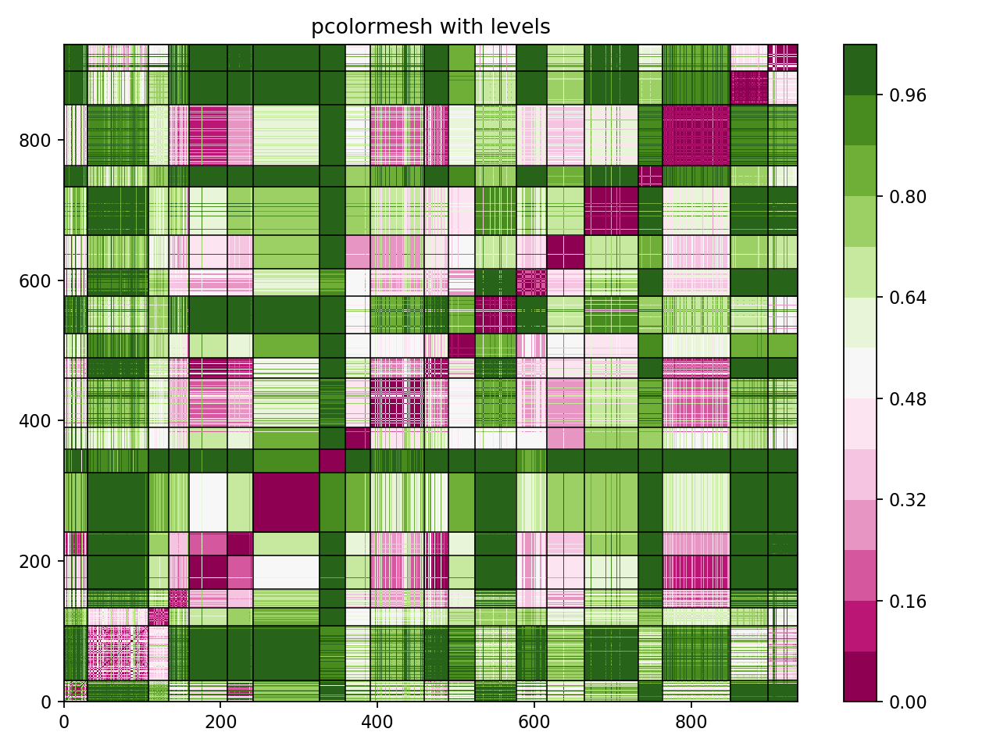

In [65]:
hists_1gram = get_hists(some_changes, hists_path=RESULTS_FOR_HIST_PATH_1GRAM, gram_path="1gram")
pearson_dists_1gram = get_dists(hists_1gram, pearsons_correlation, hist_len_1gram)
drawhist2(some_changes, pearson_dists_1gram, True, lw=0.7)

In [66]:
clustering_pearson_1gram = sklearn.cluster.DBSCAN(eps=0.2, min_samples=2, metric='precomputed').fit(pearson_dists_1gram)
print_clustering_results(clustering_pearson_1gram, some_changes)

[(3, 6789, 3), (3, 6789, 4), (3, 6789, 6), (3, 6789, 8), (3, 6789, 12), (3, 6789, 16), (3, 6789, 17), (3, 6789, 19), (3, 6789, 23), (3, 6789, 24), (3, 6789, 25), (3, 6789, 28), (3, 6789, 30), (3, 6789, 34), (3, 6789, 38), (4, 13964, 1), (4, 13964, 2), (4, 13964, 3), (4, 13964, 4), (4, 13964, 5), (4, 13964, 6), (4, 13964, 7), (4, 13964, 8), (4, 13964, 9), (4, 13964, 10), (4, 13964, 11), (4, 13964, 12), (4, 13964, 13), (4, 13964, 14), (4, 13964, 15), (4, 13964, 16), (4, 13964, 17), (4, 13964, 18), (4, 13964, 19), (4, 13964, 20), (4, 13964, 21), (4, 13964, 22), (4, 13964, 23), (4, 13964, 24), (4, 13964, 26), (5, 2013, 1), (5, 2013, 2), (5, 2013, 3), (5, 2013, 4), (5, 2013, 5), (5, 2013, 6), (5, 2013, 7), (5, 2013, 8), (5, 2013, 9), (5, 2013, 10), (5, 2013, 11), (5, 2013, 12), (5, 2013, 13), (5, 2013, 14), (5, 2013, 15), (5, 2013, 16), (5, 2013, 18), (5, 2013, 19), (5, 2013, 20), (5, 2013, 21), (5, 2013, 22), (5, 2013, 23), (5, 2013, 24), (5, 2013, 25), (5, 2013, 26), (5, 2013, 27), (5, 20

In [67]:
ind = 0

for elem in some_changes:
    print(elem, "<->", ind)
    ind += 1

(3, 6789, 3) <-> 0
(3, 6789, 4) <-> 1
(3, 6789, 5) <-> 2
(3, 6789, 6) <-> 3
(3, 6789, 7) <-> 4
(3, 6789, 8) <-> 5
(3, 6789, 9) <-> 6
(3, 6789, 10) <-> 7
(3, 6789, 12) <-> 8
(3, 6789, 13) <-> 9
(3, 6789, 14) <-> 10
(3, 6789, 15) <-> 11
(3, 6789, 16) <-> 12
(3, 6789, 17) <-> 13
(3, 6789, 19) <-> 14
(3, 6789, 21) <-> 15
(3, 6789, 22) <-> 16
(3, 6789, 23) <-> 17
(3, 6789, 24) <-> 18
(3, 6789, 25) <-> 19
(3, 6789, 28) <-> 20
(3, 6789, 30) <-> 21
(3, 6789, 31) <-> 22
(3, 6789, 32) <-> 23
(3, 6789, 33) <-> 24
(3, 6789, 34) <-> 25
(3, 6789, 35) <-> 26
(3, 6789, 36) <-> 27
(3, 6789, 37) <-> 28
(3, 6789, 38) <-> 29
(4, 1645, 1) <-> 30
(4, 1645, 2) <-> 31
(4, 1645, 3) <-> 32
(4, 1645, 4) <-> 33
(4, 1645, 5) <-> 34
(4, 1645, 6) <-> 35
(4, 1645, 7) <-> 36
(4, 1645, 8) <-> 37
(4, 1645, 9) <-> 38
(4, 1645, 10) <-> 39
(4, 1645, 11) <-> 40
(4, 1645, 12) <-> 41
(4, 1645, 14) <-> 42
(4, 1645, 15) <-> 43
(4, 1645, 16) <-> 44
(4, 1645, 17) <-> 45
(4, 1645, 18) <-> 46
(4, 1645, 19) <-> 47
(4, 1645, 20) <-> 

(8, 1486, 43) <-> 658
(8, 1486, 44) <-> 659
(8, 1486, 45) <-> 660
(8, 1486, 46) <-> 661
(8, 1486, 47) <-> 662
(8, 1486, 48) <-> 663
(8, 2266, 1) <-> 664
(8, 2266, 2) <-> 665
(8, 2266, 3) <-> 666
(8, 2266, 4) <-> 667
(8, 2266, 5) <-> 668
(8, 2266, 6) <-> 669
(8, 2266, 8) <-> 670
(8, 2266, 11) <-> 671
(8, 2266, 12) <-> 672
(8, 2266, 13) <-> 673
(8, 2266, 14) <-> 674
(8, 2266, 15) <-> 675
(8, 2266, 16) <-> 676
(8, 2266, 18) <-> 677
(8, 2266, 19) <-> 678
(8, 2266, 20) <-> 679
(8, 2266, 21) <-> 680
(8, 2266, 22) <-> 681
(8, 2266, 23) <-> 682
(8, 2266, 24) <-> 683
(8, 2266, 25) <-> 684
(8, 2266, 26) <-> 685
(8, 2266, 27) <-> 686
(8, 2266, 29) <-> 687
(8, 2266, 30) <-> 688
(8, 2266, 31) <-> 689
(8, 2266, 32) <-> 690
(8, 2266, 33) <-> 691
(8, 2266, 34) <-> 692
(8, 2266, 35) <-> 693
(8, 2266, 36) <-> 694
(8, 2266, 37) <-> 695
(8, 2266, 40) <-> 696
(8, 2266, 41) <-> 697
(8, 2266, 42) <-> 698
(8, 2266, 43) <-> 699
(8, 2266, 45) <-> 700
(8, 2266, 46) <-> 701
(8, 2266, 47) <-> 702
(8, 2266, 48) <->

In [ ]:
(8, 2266, 12) <-> 672

(8, 2266, 40) <-> 696

In [68]:
pearson_dists[672][696]
get_intersections(hists[672], hists[696])

[]

In [69]:
clustering_pearson = sklearn.cluster.DBSCAN(eps=0.8, min_samples=2, metric='precomputed').fit(dists_pearson)
print_clustering_results(clustering_pearson, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 66), (9, 6293, 43), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (9, 6293, 29), (9, 6293, 59), (9, 6293, 17), (9, 6293, 70), (9, 6293, 12), (9, 6293, 4), (9, 6293, 86), (9, 6293, 85), (9, 6293, 19), (9, 6293, 7), (9, 6293, 72), (9, 6293, 51), (9, 6293, 76), (9, 6293, 14), (9, 6293, 78), (9, 6293, 24), (9, 6293, 1), (9, 6293, 54), (9, 6293, 87), (9, 6293, 39), (9, 6293, 53), (9, 6293, 15)]
28
87


[(8, 2266, 29), (8, 2266, 74), (8, 2266, 2), (8, 2266, 24), (8, 2266, 40), (8, 2266, 68), (8, 2266, 53), (8, 2266, 37), (8, 2266, 46), (8, 2266, 88), (8, 2266, 59), (8, 2266, 94), (8, 2266, 86), (8, 2266, 45), (8, 2266, 8), (8, 2266, 43)]
16
69


[(9, 6293, 48), (9, 6293, 36), (9, 6293, 63), (9, 6293, 73), (9, 6293, 77), (9,

<IPython.core.display.Javascript object>


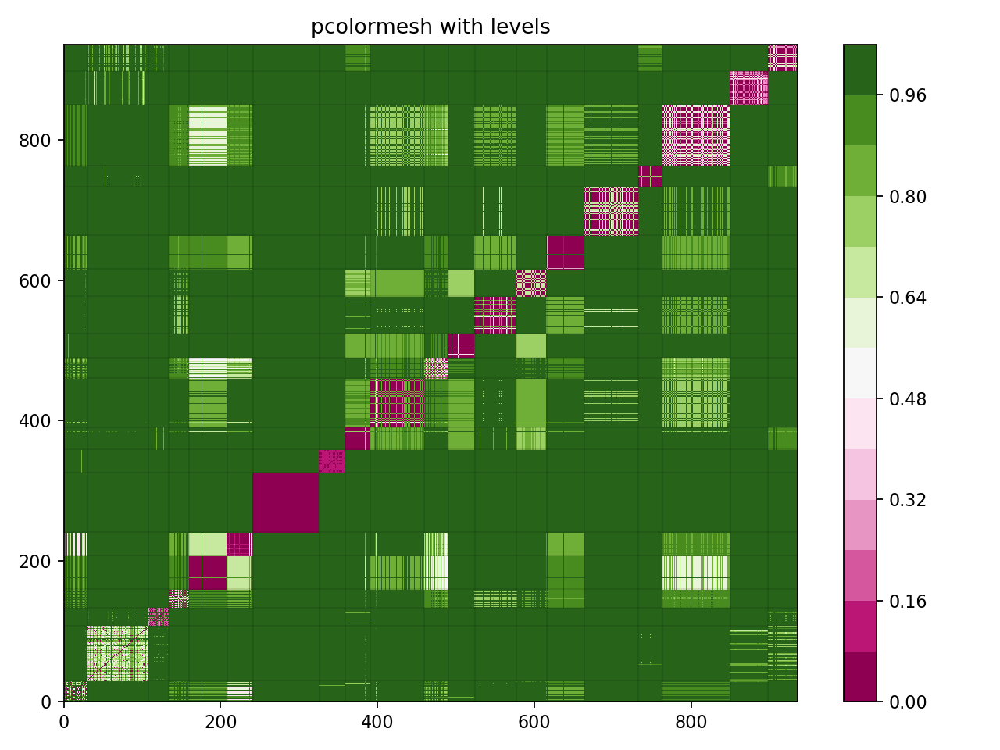

In [70]:
pearson_dists_3gram = get_dists(hists_3gram, pearsons_correlation, hist_len_3gram)
drawhist2(some_changes, pearson_dists_3gram, True)

In [71]:
# Using shuffled some_changes

shuffled_hists_3gram = get_hists(shuffled_some_changes, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
dists_pearson_3gram = get_dists(shuffled_hists_3gram, pearsons_correlation, hist_len_3gram)

In [72]:
clustering_pearson_3gram = sklearn.cluster.DBSCAN(eps=0.65, min_samples=2, metric='precomputed').fit(dists_pearson_3gram)
print_clustering_results(clustering_pearson_3gram, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 48), (9, 6293, 36), (5, 4912, 11), (9, 6293, 66), (5, 2013, 12), (3, 6789, 3), (3, 6789, 6), (6, 4703, 13), (9, 6293, 63), (9, 6293, 73), (5, 4912, 33), (3, 6789, 30), (5, 2013, 45), (3, 6789, 8), (5, 2013, 6), (5, 2013, 7), (5, 2013, 35), (5, 2013, 9), (5, 2013, 14), (9, 6293, 77), (9, 6293, 28), (6, 4703, 17), (3, 6789, 15), (9, 6293, 61), (9, 6293, 38), (5, 2013, 20), (5, 2013, 11), (9, 6293, 50), (5, 4912, 4), (9, 6293, 69), (9, 6293, 43), (5, 4912, 18), (6, 4703, 25), (9, 6293, 71), (9, 6293, 40), (5, 4912, 32), (9, 6293, 32), (6, 4703, 24), (9, 6293, 6), (5, 2013, 8), (6, 4703, 26), (9, 6293, 52), (9, 6293, 29), (9, 6293, 55), (9, 6293, 59), (9, 6293, 8), (5, 4912, 6), (5, 4912, 24), (5, 2013, 18), (9, 6293, 4

In [73]:
clustering_pearson_3gram = sklearn.cluster.DBSCAN(eps=0.6, min_samples=2, metric='precomputed').fit(dists_pearson_3gram)
print_clustering_results(clustering_pearson_3gram, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
16
69


[(9, 6293, 10), (9, 6293, 48), (9, 6293, 36), (5, 4912, 11), (9, 6293, 66), (5, 2013, 12), (3, 6789, 3), (3, 6789, 6), (6, 4703, 13), (9, 6293, 63), (9, 6293, 73), (5, 4912, 33), (3, 6789, 30), (5, 2013, 45), (3, 6789, 8), (5, 2013, 6), (5, 2013, 7), (5, 2013, 35), (5, 2013, 9), (5, 2013, 14), (9, 6293, 77), (9, 6293, 28), (6, 4703, 17), (9, 6293, 61), (9, 6293, 38), (5, 2013, 20), (5, 2013, 11), (9, 6293, 50), (5, 4912, 4), (9, 6293, 69), (9, 6293, 43), (5, 4912, 18), (6, 4703, 25), (9, 6293, 71), (9, 6293, 40), (5, 4912, 32), (9, 6293, 32), (6, 4703, 24), (9, 6293, 6), (5, 2013, 8), (6, 4703, 26), (9, 6293, 52), (9, 6293, 29), (9, 6293, 55), (9, 6293, 59), (9, 6293, 8), (5, 4912, 6), (5, 4912, 24), (5, 2013, 18), (9, 6293, 45), (5, 4912, 1

In [ ]:
# KMeans doesn't have metric='precomputed' option (consider KMedoids from pyclustering)
'''
kmeans = sklearn.cluster.KMeans(n_clusters=30, random_state=0).fit(dists_pearson_3gram)
print_clustering_results(kmeans, shuffled_some_changes)
'''

In [74]:
agglomerative = sklearn.cluster.AgglomerativeClustering(n_clusters=20, affinity='precomputed', linkage = 'average')
agglomerative = agglomerative.fit(dists_pearson_3gram)
print_clustering_results(agglomerative, shuffled_some_changes)

[(6, 3264, 10), (8, 2266, 29), (8, 2266, 74), (6, 3264, 15), (8, 2266, 61), (6, 3264, 67), (8, 2266, 2), (8, 2266, 89), (6, 3264, 51), (6, 14981, 35), (6, 3264, 34), (8, 2266, 73), (8, 2266, 27), (8, 2266, 22), (8, 2266, 5), (6, 3264, 49), (8, 2266, 19), (8, 2266, 24), (6, 3264, 25), (8, 2266, 26), (8, 2266, 52), (8, 2266, 75), (8, 2266, 4), (6, 3264, 57), (8, 2266, 97), (8, 2266, 78), (8, 2266, 64), (8, 2266, 11), (8, 2266, 42), (6, 3264, 65), (8, 2266, 32), (8, 2266, 40), (6, 3264, 7), (8, 2266, 15), (8, 2266, 68), (8, 2266, 48), (8, 2266, 31), (8, 2266, 56), (8, 2266, 55), (8, 2266, 18), (8, 2266, 53), (8, 2266, 25), (8, 2266, 47), (8, 2266, 83), (6, 3264, 13), (8, 2266, 3), (6, 14981, 33), (8, 2266, 37), (8, 2266, 46), (6, 3264, 20), (8, 2266, 90), (8, 2266, 20), (8, 2266, 58), (8, 2266, 62), (8, 2266, 36), (6, 3264, 44), (8, 2266, 79), (8, 2266, 41), (6, 3264, 42), (8, 2266, 72), (8, 2266, 88), (8, 2266, 1), (8, 2266, 16), (8, 2266, 50), (8, 2266, 71), (8, 2266, 59), (8, 2266, 13)

In [75]:
dists_pearson_3gram_np = np.array(dists_pearson_3gram)
spectral = sklearn.cluster.SpectralClustering(n_clusters=28, affinity='precomputed', 
                        assign_labels="discretize", random_state=0).fit(dists_pearson_3gram_np.max()-dists_pearson_3gram_np)
print_clustering_results(spectral, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 7), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
17
69


[(9, 6293, 10), (9, 6293, 66), (9, 6293, 43), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (9, 6293, 29), (9, 6293, 59), (9, 6293, 17), (9, 6293, 70), (9, 6293, 12), (9, 6293, 4), (9, 6293, 86), (9, 6293, 85), (9, 6293, 19), (9, 6293, 7), (9, 6293, 72), (9, 6293, 51), (9, 6293, 76), (9, 6293, 14), (9, 6293, 78), (9, 6293, 24), (9, 6293, 1), (9, 6293, 54), (9, 6293, 87), (9, 6293, 39), (9, 6293, 53), (9, 6293, 15)]
28
87


[(8, 2266, 29), (8, 2266, 74), (8, 2266, 2), (6, 14981, 35), (8, 2266, 24), (8, 2266, 52), (8, 2266, 40), (8, 2266, 68), (8, 2266, 53), (6, 14981, 33), (8, 2266, 37), (8, 2266, 46), (8, 2266, 62), (8, 2266, 88), (8, 2266, 59), (8, 2266, 94), (8, 2266, 86), (8, 2266, 45), (8, 2266, 8), (6, 14981, 12), (8, 2266, 

In [ ]:
# MeanShift doesn't have metric='precomputed' option
'''
mean_shift = sklearn.cluster.MeanShift(bandwidth=5).fit(dists_pearson_3gram)
print_clustering_results(mean_shift, shuffled_some_changes)
'''

In [76]:
dists_pearson_3gram_np = np.array(dists_pearson_3gram)
pearson_affinity_3gram = dists_pearson_3gram_np.max() - dists_pearson_3gram_np

affinity = sklearn.cluster.AffinityPropagation(damping=0.9, affinity='precomputed').fit(pearson_affinity_3gram)
print_clustering_results(affinity, shuffled_some_changes)

[(6, 3264, 10), (6, 3264, 15), (6, 3264, 67), (6, 3264, 51), (6, 3264, 34), (6, 3264, 49), (6, 3264, 25), (6, 3264, 57), (6, 3264, 65), (6, 3264, 7), (6, 3264, 13), (6, 3264, 20), (6, 3264, 44), (6, 3264, 42), (6, 3264, 47), (6, 3264, 46), (6, 3264, 45)]
17
69


[(9, 6293, 10), (9, 6293, 66), (9, 6293, 43), (9, 6293, 40), (9, 6293, 32), (9, 6293, 6), (9, 6293, 29), (9, 6293, 59), (9, 6293, 17), (9, 6293, 70), (9, 6293, 12), (9, 6293, 4), (9, 6293, 86), (9, 6293, 85), (9, 6293, 19), (9, 6293, 7), (9, 6293, 72), (9, 6293, 51), (9, 6293, 76), (9, 6293, 14), (9, 6293, 78), (9, 6293, 24), (9, 6293, 1), (9, 6293, 54), (9, 6293, 87), (9, 6293, 39), (9, 6293, 53), (9, 6293, 15)]
28
87


[(8, 2266, 29), (8, 2266, 74), (8, 2266, 2), (8, 2266, 24), (8, 2266, 52), (8, 2266, 40), (8, 2266, 68), (8, 2266, 53), (6, 14981, 33), (8, 2266, 37), (8, 2266, 46), (8, 2266, 62), (8, 2266, 88), (8, 2266, 59), (8, 2266, 94), (8, 2266, 86), (8, 2266, 45), (8, 2266, 8), (8, 2266, 43)]


[(9, 6293, 48), (9, 6293,

<IPython.core.display.Javascript object>


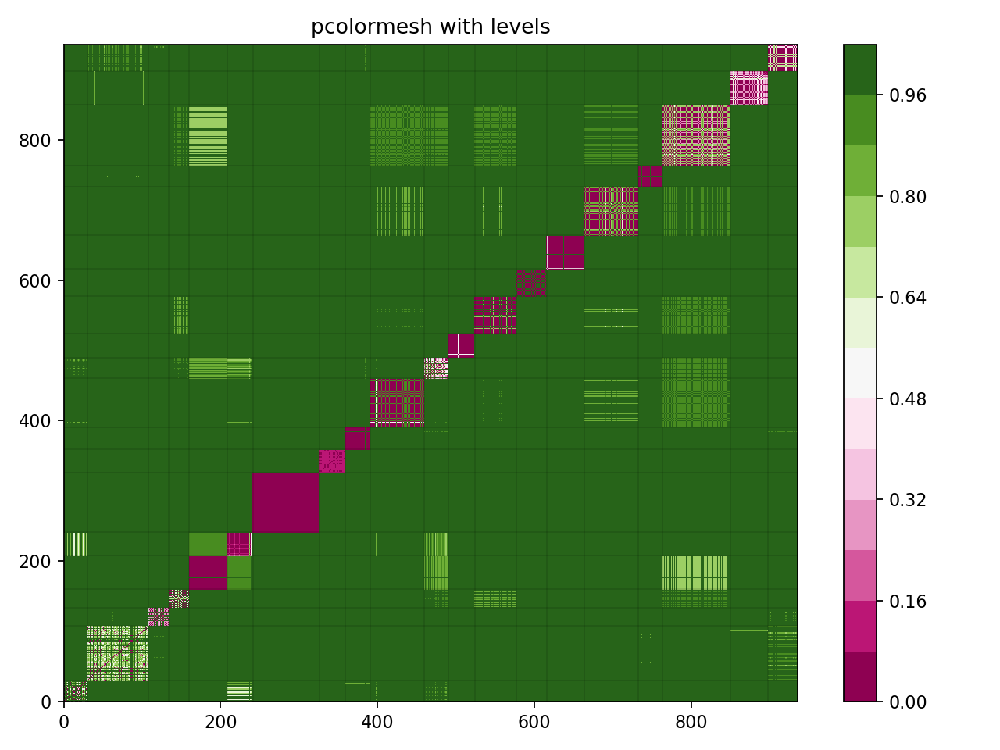

In [77]:
pearson_dists_4gram = get_dists(hists_4gram, pearsons_correlation, hist_len_4gram)
drawhist2(some_changes, pearson_dists_4gram, True)

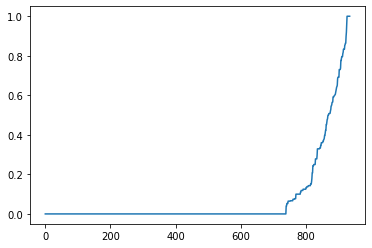

In [745]:
knn_dists(pearson_dists_4gram, 5)

In [756]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    clustering_pearson = sklearn.cluster.DBSCAN(eps=0.3, 
                                                min_samples=2, 
                                                metric='precomputed').fit(pearson_dists_4gram)
    rand = print_clustering_results(clustering_pearson, some_changes, to_print=False)
    
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.001
Best rand: 97.73


In [754]:
clustering_pearson_4gram = sklearn.cluster.DBSCAN(eps=0.3, min_samples=2, metric='precomputed').fit(pearson_dists_4gram)
print_clustering_results(clustering_pearson_4gram, some_changes)


[(3, 6789, 3), (3, 6789, 6), (3, 6789, 12), (3, 6789, 17), (3, 6789, 19), (3, 6789, 25), (3, 6789, 30), (3, 6789, 34)]
8
30


[(3, 6789, 4), (3, 6789, 8), (3, 6789, 16), (3, 6789, 23), (3, 6789, 24), (3, 6789, 28), (3, 6789, 38)]
7
30


[(3, 6789, 7), (3, 6789, 15), (3, 6789, 22), (3, 6789, 31)]
4
30


[(3, 6789, 13), (3, 6789, 33), (3, 6789, 36)]
3
30


[(4, 1645, 1), (4, 1645, 10), (4, 1645, 14), (4, 1645, 24), (4, 1645, 25), (4, 1645, 26), (4, 1645, 74), (4, 1645, 75), (4, 1645, 79)]
9
78


[(4, 1645, 2), (4, 1645, 7), (4, 1645, 23), (4, 1645, 76), (4, 1645, 78)]
5
78


[(4, 1645, 4), (4, 1645, 21), (4, 1645, 57)]
3
78


[(4, 1645, 5), (4, 1645, 9), (4, 1645, 15), (4, 1645, 16), (4, 1645, 19), (4, 1645, 43), (4, 1645, 46), (4, 1645, 58), (4, 1645, 59), (4, 1645, 60), (4, 1645, 67)]
11
78


[(4, 1645, 6), (4, 1645, 8), (4, 1645, 38)]
3
78


[(4, 1645, 11), (4, 1645, 18), (4, 1645, 48), (4, 1645, 62)]
4
78


[(4, 1645, 12), (4, 1645, 20), (4, 1645, 37), (4, 1645, 39), (4, 1645, 41), (

## Exploring changes from different projects

In [287]:
RESULTS_FOR_HIST_PATH = RESULTS_FOR_HIST_PATH_5GRAM
gram_path = "/5gram"


results_for_hist_dir = os.fsencode(RESULTS_FOR_HIST_PATH)
patterns = [os.fsdecode(el) for el in os.listdir(results_for_hist_dir) 
               if os.path.isdir(RESULTS_FOR_HIST_PATH + "/" + os.fsdecode(el)) and len(os.fsdecode(el)) < 10]
patterns = [(int(el.split(' ')[0]), int(el.split(' ')[1])) for el in patterns]
patterns.sort()

# Changes for which hists exist
read_changes_names_5gram = []

for el in tqdm_notebook(patterns):
    size, id = el[0], el[1]
    
    #if (size, id) not in set_of_patterns_with_different_projects:
    #    continue
    
    path_to_pattern = RESULTS_FOR_HIST_PATH + "/" + str(size) + " " + str(id) + gram_path
    files = [int(os.fsdecode(el)[12:-9]) for el in os.listdir(path_to_pattern) if os.fsdecode(el).startswith("sampleChange")]
    files.sort()
    
    for file in files:
        read_changes_names_5gram.append((size, id, file))
                        
print(read_changes_names_5gram)



[(3, 16, 1), (3, 16, 2), (3, 16, 3), (3, 16, 4), (3, 16, 5), (3, 20, 2), (3, 22, 1), (3, 22, 2), (3, 22, 3), (3, 27, 1), (3, 27, 3), (3, 52, 1), (3, 52, 2), (3, 52, 3), (3, 92, 1), (3, 92, 2), (3, 92, 3), (3, 92, 4), (3, 92, 5), (3, 92, 6), (3, 94, 1), (3, 94, 2), (3, 94, 3), (3, 94, 4), (3, 116, 1), (3, 116, 2), (3, 116, 3), (3, 116, 4), (3, 116, 5), (3, 117, 2), (3, 117, 3), (3, 119, 1), (3, 119, 2), (3, 119, 3), (3, 125, 2), (3, 125, 3), (3, 147, 2), (3, 147, 3), (3, 147, 5), (3, 147, 6), (3, 147, 7), (3, 147, 8), (3, 165, 1), (3, 165, 2), (3, 165, 3), (3, 167, 1), (3, 167, 3), (3, 192, 3), (3, 192, 4), (3, 206, 2), (3, 206, 3), (3, 206, 4), (3, 207, 1), (3, 207, 2), (3, 207, 3), (3, 207, 4), (3, 207, 5), (3, 207, 6), (3, 207, 7), (3, 207, 8), (3, 217, 2), (3, 217, 3), (3, 218, 1), (3, 218, 2), (3, 225, 1), (3, 225, 2), (3, 225, 3), (3, 237, 8), (3, 237, 12), (3, 241, 2), (3, 241, 3), (3, 241, 4), (3, 245, 1), (3, 245, 2), (3, 245, 3), (3, 261, 10), (3, 269, 1), (3, 269, 2), (3, 26

In [288]:
# For faster computation

read_changes_names_5gram_set = set(read_changes_names_5gram)

In [ ]:
# CHECKING PATTERNS WITH DIFFERENT PROJECTS

# We consider only changes for which hist exists

patterns_path = "/Users/aliscafo/Downloads/CPatMiner-master 2/SemanticChangeGraphMiner/output/patterns/repos-hybrid/1"

patterns_dir = os.fsencode(patterns_path)
sorted_size_dirs = [int(os.fsdecode(el)) for el in os.listdir(patterns_dir) if os.fsdecode(el).isnumeric()]
sorted_size_dirs.sort()

final_ok_num = 0
all_patterns = 0

set_of_patterns_with_different_projects = set()
changes_with_different_projects = []

for size_dir in sorted_size_dirs:
    size_dir_str = str(size_dir)
    sorted_id_dirs = [int(os.fsdecode(el)) for el in os.listdir(patterns_path + os.sep + size_dir_str) if os.fsdecode(el).isnumeric()]
    sorted_id_dirs.sort()
            
    num_ids = 0

    for id_dir in sorted_id_dirs:
        path = patterns_path + os.sep + size_dir_str + os.sep + str(id_dir) + os.sep + "details.html"

        num_ids += 1
        
        if not os.path.exists(path):
            continue

        with open(path, 'r', encoding="latin-1") as file:
            content = file.read()
                    
        last_ind = 0
        
        print(size_dir_str, str(id_dir))
        
        all_patterns += 1
        
        set_of_projects = set()
        
        num_change = 0
        
        while True:
            num_change += 1
            
            start = 0
            end = 0
            
            try:
                start = content.index("<div id='method'>", last_ind) + len("<div id='method'>") 
                end = content.index("</div><BR>", start)
            except:
                break
            
            name = content[start:end]
            parts = name.split(',')
            project_name = parts[0]
            file_name = parts[2]
            nickname = project_name.split('/')[0]
            
            last_ind = end
            
            print(project_name)
            
            change_tuple = (size_dir, id_dir, num_change)
            
            if project_name not in set_of_projects and change_tuple in read_changes_names_5gram_set and "src/test/java" not in file_name:
                print("Added", change_tuple)
                set_of_projects.add(project_name)
                changes_with_different_projects.append((size_dir, id_dir, num_change))
        
        print(len(set_of_projects))
        if len(set_of_projects) > 1:
            final_ok_num += 1
            set_of_patterns_with_different_projects.add((size_dir, id_dir))
            print("OK")
        elif len(set_of_projects) == 1:
            changes_with_different_projects.pop()
            

print(final_ok_num)
print(all_patterns)


In [290]:
percent = len(set_of_patterns_with_different_projects) / all_patterns
print(len(set_of_patterns_with_different_projects), str(percent * 100) + " %")

print(len(changes_with_different_projects))

1720 20.673076923076923 %
4801


In [291]:
pattern_to_remained_num_projects = collections.defaultdict(int)

for el in changes_with_different_projects:
    pattern_to_remained_num_projects[(el[0], el[1])] += 1
    
# read changes with different projects which was filtered so that length of patterns is more than 1
real_changes_projects = [el for el in changes_with_different_projects
                if pattern_to_remained_num_projects[(el[0], el[1])] > 1]

print(len(real_changes_projects))

4801


In [292]:
sorted_dict_projects = {k: v for k, v in sorted(pattern_to_remained_num_projects.items(), key=lambda item: item[1], reverse=True)}
print(list(sorted_dict_projects.items())[:100])


[((4, 1645), 54), ((5, 2065), 20), ((4, 3135), 18), ((5, 4237), 13), ((10, 13518), 13), ((5, 2829), 12), ((3, 2596), 11), ((6, 784), 11), ((3, 12991), 10), ((4, 5742), 10), ((4, 14722), 10), ((6, 6635), 10), ((3, 2556), 9), ((5, 3117), 9), ((5, 5266), 9), ((5, 10237), 9), ((3, 15195), 8), ((4, 4652), 8), ((4, 13736), 8), ((5, 1904), 8), ((5, 9144), 8), ((5, 9446), 8), ((6, 815), 8), ((3, 3069), 7), ((3, 3080), 7), ((3, 3237), 7), ((3, 5939), 7), ((3, 6476), 7), ((3, 10773), 7), ((3, 13635), 7), ((4, 5012), 7), ((4, 14747), 7), ((5, 6346), 7), ((5, 9633), 7), ((5, 12527), 7), ((5, 14373), 7), ((6, 10044), 7), ((6, 14162), 7), ((6, 14860), 7), ((7, 6974), 7), ((7, 11638), 7), ((10, 8886), 7), ((3, 874), 6), ((3, 2177), 6), ((3, 2206), 6), ((3, 3756), 6), ((3, 4256), 6), ((3, 4970), 6), ((3, 5629), 6), ((3, 9219), 6), ((3, 10602), 6), ((4, 4280), 6), ((4, 9682), 6), ((4, 9917), 6), ((4, 10244), 6), ((4, 12410), 6), ((4, 13305), 6), ((4, 14225), 6), ((5, 2555), 6), ((5, 9818), 6), ((5, 102

In [293]:
tops = list(sorted_dict_projects.items())[:40]
tops2 = list(sorted_dict_projects.items())[40:80]
tops3 = list(sorted_dict_projects.items())[80:130]
tops4 = list(sorted_dict_projects.items())[130:160]
print(tops)
print("\n")
print(tops2)
print("\n")
print(tops3)
print("\n")
print(tops4)
selected_patterns = [el[0] for el in tops]
selected_patterns2 = [el[0] for el in tops2]
selected_patterns3 = [el[0] for el in tops3]
selected_patterns4 = [el[0] for el in tops4]

[((4, 1645), 54), ((5, 2065), 20), ((4, 3135), 18), ((5, 4237), 13), ((10, 13518), 13), ((5, 2829), 12), ((3, 2596), 11), ((6, 784), 11), ((3, 12991), 10), ((4, 5742), 10), ((4, 14722), 10), ((6, 6635), 10), ((3, 2556), 9), ((5, 3117), 9), ((5, 5266), 9), ((5, 10237), 9), ((3, 15195), 8), ((4, 4652), 8), ((4, 13736), 8), ((5, 1904), 8), ((5, 9144), 8), ((5, 9446), 8), ((6, 815), 8), ((3, 3069), 7), ((3, 3080), 7), ((3, 3237), 7), ((3, 5939), 7), ((3, 6476), 7), ((3, 10773), 7), ((3, 13635), 7), ((4, 5012), 7), ((4, 14747), 7), ((5, 6346), 7), ((5, 9633), 7), ((5, 12527), 7), ((5, 14373), 7), ((6, 10044), 7), ((6, 14162), 7), ((6, 14860), 7), ((7, 6974), 7)]


[((7, 11638), 7), ((10, 8886), 7), ((3, 874), 6), ((3, 2177), 6), ((3, 2206), 6), ((3, 3756), 6), ((3, 4256), 6), ((3, 4970), 6), ((3, 5629), 6), ((3, 9219), 6), ((3, 10602), 6), ((4, 4280), 6), ((4, 9682), 6), ((4, 9917), 6), ((4, 10244), 6), ((4, 12410), 6), ((4, 13305), 6), ((4, 14225), 6), ((5, 2555), 6), ((5, 9818), 6), ((5, 

In [294]:
some_patterns_proj = selected_patterns

some_changes_proj = [el for el in real_changes_projects if (el[0], el[1]) in some_patterns_proj and
                (el[0], el[1]) != (14, 1319)]
print(len(some_changes_proj))

403


In [295]:
some_patterns_proj2 = selected_patterns2

some_changes_proj2 = [el for el in real_changes_projects if (el[0], el[1]) in some_patterns_proj2 and
                (el[0], el[1]) != (14, 1319)]
print(len(some_changes_proj2))

242


In [296]:
some_patterns_proj3 = selected_patterns3

some_changes_proj3 = [el for el in real_changes_projects if (el[0], el[1]) in some_patterns_proj3 and
                (el[0], el[1]) != (14, 1319)]
print(len(some_changes_proj3))

255


In [297]:
some_patterns_proj4 = selected_patterns4

some_changes_proj4 = [el for el in real_changes_projects if (el[0], el[1]) in some_patterns_proj4 and
                (el[0], el[1]) != (14, 1319)]
print(len(some_changes_proj4))

120


In [298]:
tops5 = list(sorted_dict_projects.items())[160:200]
print(tops5, '\n')
selected_patterns5 = [el[0] for el in tops5]

some_patterns_proj5 = selected_patterns5

some_changes_proj5 = [el for el in real_changes_projects if (el[0], el[1]) in some_patterns_proj5 and
                (el[0], el[1]) != (14, 1319)]
print(len(some_changes_proj5))





# Counting patterns' positions on the chart

some_changes_proj_nums5 = []

i = 0
n = len(some_changes_proj5)
common_sum_proj5 = 0

while (i < n):
    j = i
    while j < n and (some_changes_proj5[i][0], some_changes_proj5[i][1]) == (some_changes_proj5[j][0], some_changes_proj5[j][1]):
        j += 1
    common_sum_proj5 += (j - i)
    some_changes_proj_nums5.append(((some_changes_proj5[i][0], some_changes_proj5[i][1]), j - i, i))
    i = j
    
    

[((3, 14067), 4), ((3, 14921), 4), ((3, 14931), 4), ((3, 15127), 4), ((4, 718), 4), ((4, 764), 4), ((4, 945), 4), ((4, 1214), 4), ((4, 2676), 4), ((4, 3349), 4), ((4, 3353), 4), ((4, 3592), 4), ((4, 3780), 4), ((4, 6565), 4), ((4, 7238), 4), ((4, 8040), 4), ((4, 8441), 4), ((4, 8690), 4), ((4, 9362), 4), ((4, 10155), 4), ((4, 10828), 4), ((4, 11677), 4), ((4, 12139), 4), ((4, 12155), 4), ((4, 12440), 4), ((4, 12753), 4), ((4, 13510), 4), ((4, 13597), 4), ((4, 13695), 4), ((4, 14726), 4), ((4, 14811), 4), ((5, 86), 4), ((5, 264), 4), ((5, 1085), 4), ((5, 1889), 4), ((5, 2583), 4), ((5, 2869), 4), ((5, 3498), 4), ((5, 3524), 4), ((5, 3569), 4)] 

160


In [299]:
tops6 = list(sorted_dict_projects.items())[200:1300]
tops6 = [el for el in tops6 if int(el[0][0]) >= 9]

print(tops6, '\n')
selected_patterns6 = [el[0] for el in tops6]

some_patterns_proj6 = selected_patterns6

some_changes_proj6 = [el for el in real_changes_projects if (el[0], el[1]) in some_patterns_proj6 and
                (el[0], el[1]) != (14, 1319)]
print(len(some_changes_proj6))





# Counting patterns' positions on the chart

some_changes_proj_nums6 = []

i = 0
n = len(some_changes_proj6)
common_sum_proj6 = 0

while (i < n):
    j = i
    while j < n and (some_changes_proj6[i][0], some_changes_proj6[i][1]) == (some_changes_proj6[j][0], some_changes_proj6[j][1]):
        j += 1
    common_sum_proj6 += (j - i)
    some_changes_proj_nums6.append(((some_changes_proj6[i][0], some_changes_proj6[i][1]), j - i, i))
    i = j
    
    

[((9, 13659), 4), ((11, 7992), 4), ((13, 4774), 4), ((15, 5879), 4), ((15, 13381), 4), ((9, 132), 3), ((9, 713), 3), ((9, 1093), 3), ((9, 2813), 3), ((9, 3297), 3), ((9, 4723), 3), ((9, 6993), 3), ((9, 7485), 3), ((9, 9859), 3), ((9, 11380), 3), ((9, 11627), 3), ((9, 11926), 3), ((9, 12224), 3), ((9, 12587), 3), ((9, 13616), 3), ((9, 14088), 3), ((9, 14800), 3), ((10, 292), 3), ((10, 1113), 3), ((10, 1356), 3), ((10, 1755), 3), ((10, 2336), 3), ((10, 2732), 3), ((10, 3161), 3), ((10, 4742), 3), ((10, 4885), 3), ((10, 6441), 3), ((10, 10818), 3), ((10, 11337), 3), ((11, 4267), 3), ((11, 8292), 3), ((12, 8887), 3), ((12, 9895), 3), ((12, 14920), 3), ((13, 13891), 3), ((15, 2712), 3), ((15, 6539), 3), ((15, 7062), 3), ((15, 7972), 3), ((15, 10648), 3), ((15, 12354), 3), ((16, 7766), 3), ((16, 10802), 3), ((18, 10762), 3), ((19, 9933), 3), ((21, 2114), 3), ((22, 5923), 3), ((25, 14513), 3), ((26, 7684), 3), ((50, 705), 3)] 

170


In [300]:
# Counting patterns' positions on the chart

some_changes_proj_nums = []

i = 0
n = len(some_changes_proj)
common_sum_proj = 0

while (i < n):
    j = i
    while j < n and (some_changes_proj[i][0], some_changes_proj[i][1]) == (some_changes_proj[j][0], some_changes_proj[j][1]):
        j += 1
    common_sum_proj += (j - i)
    some_changes_proj_nums.append(((some_changes_proj[i][0], some_changes_proj[i][1]), j - i, i))
    i = j

In [301]:
some_changes_proj_nums

[((3, 2556), 9, 0),
 ((3, 2596), 11, 9),
 ((3, 3069), 7, 20),
 ((3, 3080), 7, 27),
 ((3, 3237), 7, 34),
 ((3, 5939), 7, 41),
 ((3, 6476), 7, 48),
 ((3, 10773), 7, 55),
 ((3, 12991), 10, 62),
 ((3, 13635), 7, 72),
 ((3, 15195), 8, 79),
 ((4, 1645), 54, 87),
 ((4, 3135), 18, 141),
 ((4, 4652), 8, 159),
 ((4, 5012), 7, 167),
 ((4, 5742), 10, 174),
 ((4, 13736), 8, 184),
 ((4, 14722), 10, 192),
 ((4, 14747), 7, 202),
 ((5, 1904), 8, 209),
 ((5, 2065), 20, 217),
 ((5, 2829), 12, 237),
 ((5, 3117), 9, 249),
 ((5, 4237), 13, 258),
 ((5, 5266), 9, 271),
 ((5, 6346), 7, 280),
 ((5, 9144), 8, 287),
 ((5, 9446), 8, 295),
 ((5, 9633), 7, 303),
 ((5, 10237), 9, 310),
 ((5, 12527), 7, 319),
 ((5, 14373), 7, 326),
 ((6, 784), 11, 333),
 ((6, 815), 8, 344),
 ((6, 6635), 10, 352),
 ((6, 10044), 7, 362),
 ((6, 14162), 7, 369),
 ((6, 14860), 7, 376),
 ((7, 6974), 7, 383),
 ((10, 13518), 13, 390)]

In [302]:
# Counting patterns' positions on the chart

some_changes_proj_nums2 = []

i = 0
n = len(some_changes_proj2)
common_sum_proj2 = 0

while (i < n):
    j = i
    while j < n and (some_changes_proj2[i][0], some_changes_proj2[i][1]) == (some_changes_proj2[j][0], some_changes_proj2[j][1]):
        j += 1
    common_sum_proj2 += (j - i)
    some_changes_proj_nums2.append(((some_changes_proj2[i][0], some_changes_proj2[i][1]), j - i, i))
    i = j

In [303]:
# Counting patterns' positions on the chart

some_changes_proj_nums3 = []

i = 0
n = len(some_changes_proj3)
common_sum_proj3 = 0

while (i < n):
    j = i
    while j < n and (some_changes_proj3[i][0], some_changes_proj3[i][1]) == (some_changes_proj3[j][0], some_changes_proj3[j][1]):
        j += 1
    common_sum_proj3 += (j - i)
    some_changes_proj_nums3.append(((some_changes_proj3[i][0], some_changes_proj3[i][1]), j - i, i))
    i = j

In [304]:
some_changes_proj_nums3

[((3, 207), 5, 0),
 ((3, 389), 5, 5),
 ((3, 2658), 5, 10),
 ((3, 6120), 5, 15),
 ((3, 6808), 5, 20),
 ((3, 11728), 5, 25),
 ((3, 12246), 5, 30),
 ((3, 13558), 5, 35),
 ((3, 14330), 5, 40),
 ((4, 2909), 5, 45),
 ((4, 3084), 5, 50),
 ((4, 4133), 5, 55),
 ((4, 4229), 5, 60),
 ((4, 4404), 5, 65),
 ((4, 4582), 5, 70),
 ((4, 6376), 5, 75),
 ((4, 6915), 5, 80),
 ((4, 6954), 5, 85),
 ((4, 7618), 5, 90),
 ((4, 9213), 5, 95),
 ((4, 9306), 5, 100),
 ((4, 10254), 5, 105),
 ((4, 11491), 5, 110),
 ((4, 12485), 5, 115),
 ((4, 12924), 5, 120),
 ((4, 12982), 5, 125),
 ((4, 13366), 5, 130),
 ((5, 2496), 5, 135),
 ((5, 2649), 5, 140),
 ((5, 3919), 5, 145),
 ((5, 6777), 5, 150),
 ((5, 7538), 5, 155),
 ((5, 11714), 5, 160),
 ((5, 15231), 5, 165),
 ((6, 4024), 5, 170),
 ((6, 6772), 5, 175),
 ((6, 13596), 5, 180),
 ((6, 14447), 5, 185),
 ((6, 14512), 5, 190),
 ((6, 14648), 5, 195),
 ((7, 3515), 5, 200),
 ((7, 3910), 5, 205),
 ((7, 12369), 5, 210),
 ((8, 6560), 5, 215),
 ((13, 13228), 6, 220),
 ((15, 13043), 

In [305]:
# Counting patterns' positions on the chart

some_changes_proj_nums4 = []

i = 0
n = len(some_changes_proj4)
common_sum_proj4 = 0

while (i < n):
    j = i
    while j < n and (some_changes_proj4[i][0], some_changes_proj4[i][1]) == (some_changes_proj4[j][0], some_changes_proj4[j][1]):
        j += 1
    common_sum_proj4 += (j - i)
    some_changes_proj_nums4.append(((some_changes_proj4[i][0], some_changes_proj4[i][1]), j - i, i))
    i = j

In [306]:
hists_proj = get_hists(some_changes_proj, hists_path=RESULTS_FOR_HIST_PATH_5GRAM, gram_path="5gram")

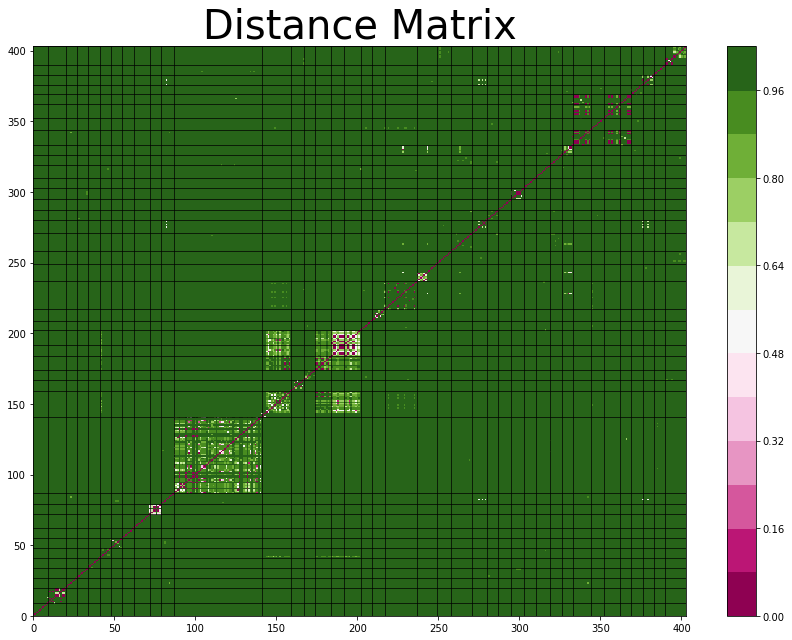

In [307]:
canberra_dists_proj = get_dists(hists_proj, canberra_metric, hist_len_5gram)
drawhist2(some_changes_proj, canberra_dists_proj, True, lw=0.7)

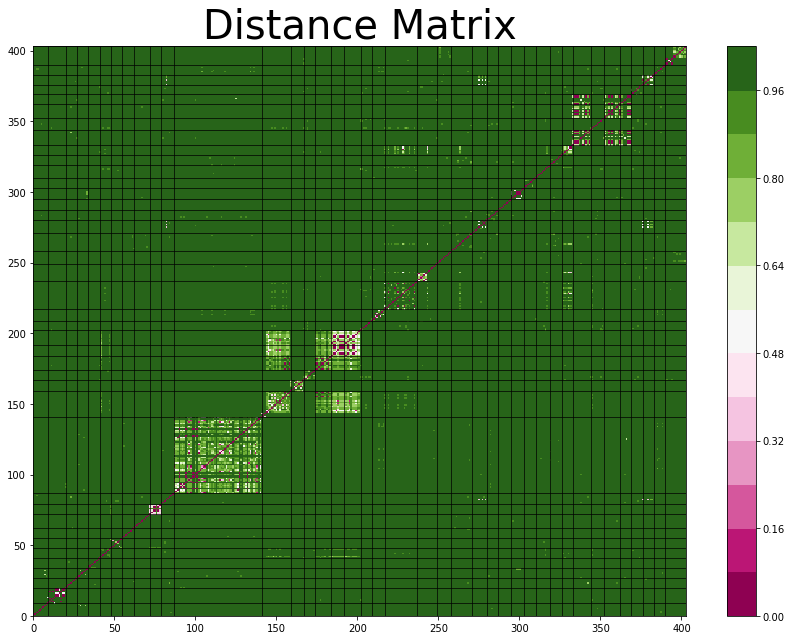

In [308]:
hists_proj_4gram = get_hists(some_changes_proj, hists_path=RESULTS_FOR_HIST_PATH_4GRAM, gram_path="4gram")
canberra_dists_proj_4gram = get_dists(hists_proj_4gram, canberra_metric, hist_len_4gram)
drawhist2(some_changes_proj, canberra_dists_proj_4gram, True, lw=0.7)

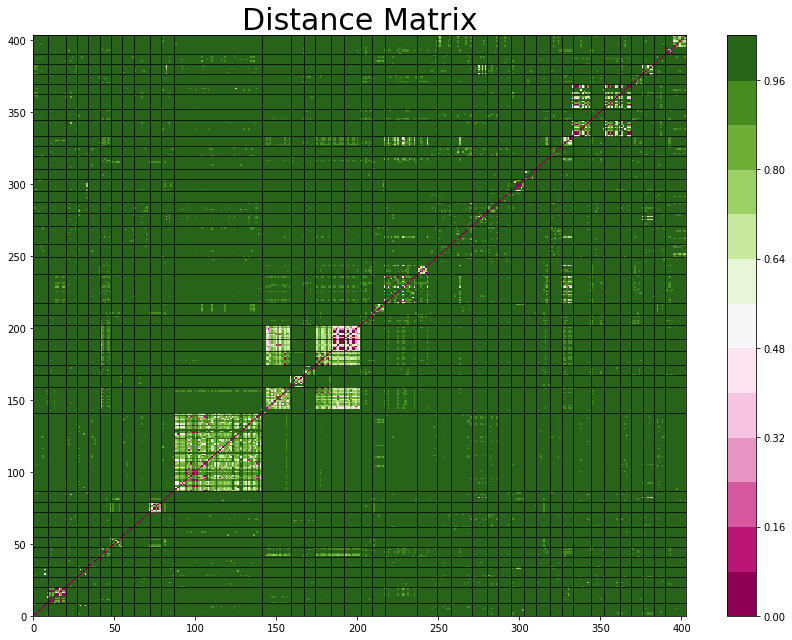

In [324]:
hists_proj_3gram = get_hists(some_changes_proj, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
canberra_dists_proj_3gram = get_dists(hists_proj_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes_proj, canberra_dists_proj_3gram, True, lw=0.7)

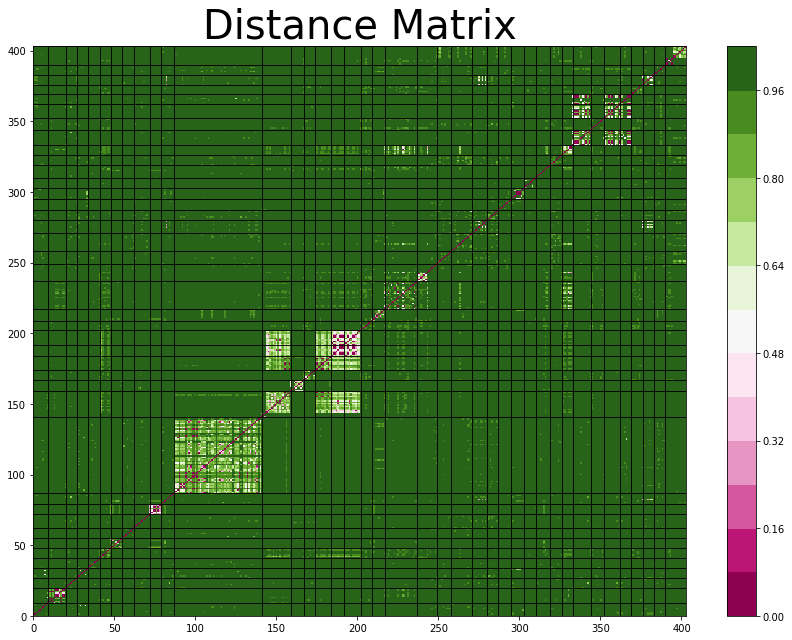

In [320]:
hists_proj_3gram = get_hists(some_changes_proj, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
canberra_dists_proj_3gram = get_dists(hists_proj_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes_proj, canberra_dists_proj_3gram, True, lw=0.9)

In [311]:
clustering_canb_3gram = sklearn.cluster.DBSCAN(eps=0.6, min_samples=2, metric='precomputed').fit(canberra_dists_proj_3gram)
print_clustering_results(clustering_canb_3gram, some_changes_proj)


NameError: name 'print_clustering_results' is not defined

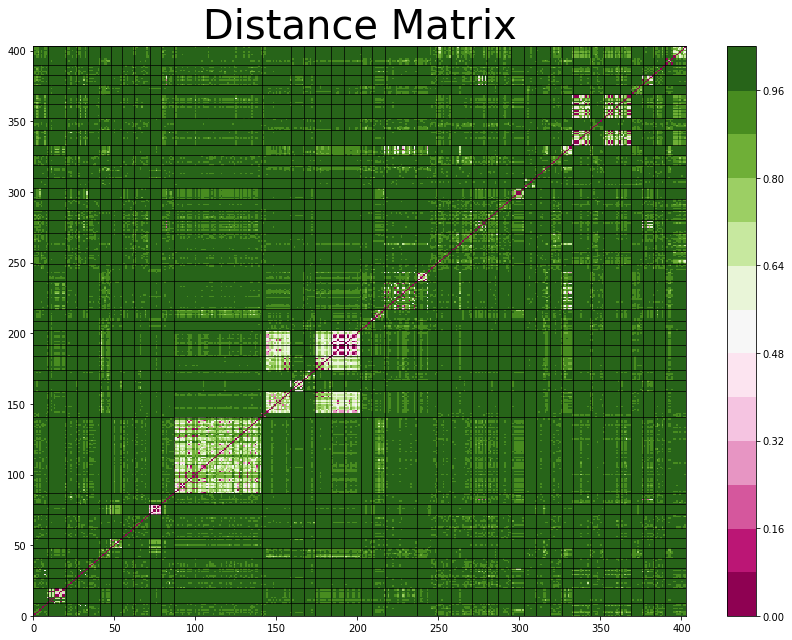

In [312]:
hists_proj_2gram = get_hists(some_changes_proj, hists_path=RESULTS_FOR_HIST_PATH_2GRAM, gram_path="2gram")
canberra_dists_proj_2gram = get_dists(hists_proj_2gram, canberra_metric, hist_len_2gram)
drawhist2(some_changes_proj, canberra_dists_proj_2gram, True, lw=0.7)

In [105]:
clustering_canb_2gram = sklearn.cluster.DBSCAN(eps=0.7, min_samples=2, metric='precomputed').fit(canberra_dists_proj_2gram)
print_clustering_results(clustering_canb_2gram, some_changes_proj)


[(3, 874, 4), (3, 3069, 5), (3, 15195, 8), (4, 1645, 1), (4, 1645, 2), (4, 1645, 4), (4, 1645, 6), (4, 1645, 7), (4, 1645, 8), (4, 1645, 10), (4, 1645, 12), (4, 1645, 14), (4, 1645, 17), (4, 1645, 20), (4, 1645, 22), (4, 1645, 24), (4, 1645, 25), (4, 1645, 26), (4, 1645, 27), (4, 1645, 28), (4, 1645, 29), (4, 1645, 30), (4, 1645, 31), (4, 1645, 32), (4, 1645, 36), (4, 1645, 37), (4, 1645, 39), (4, 1645, 41), (4, 1645, 42), (4, 1645, 44), (4, 1645, 45), (4, 1645, 47), (4, 1645, 48), (4, 1645, 53), (4, 1645, 55), (4, 1645, 56), (4, 1645, 57), (4, 1645, 62), (4, 1645, 65), (4, 1645, 66), (4, 1645, 68), (4, 1645, 70), (4, 1645, 71), (4, 1645, 72), (4, 1645, 73), (4, 1645, 74), (4, 1645, 79), (5, 1904, 5), (5, 1904, 8), (6, 784, 1), (6, 784, 2), (6, 784, 3), (6, 784, 4), (6, 784, 7), (6, 784, 9), (6, 784, 13), (6, 784, 21), (6, 784, 25), (6, 784, 26), (6, 6635, 2), (6, 6635, 4), (6, 6635, 5), (6, 6635, 6), (6, 6635, 8), (6, 6635, 9), (6, 10044, 2), (6, 10044, 4), (6, 10044, 7), (6, 10044, 8

<IPython.core.display.Javascript object>


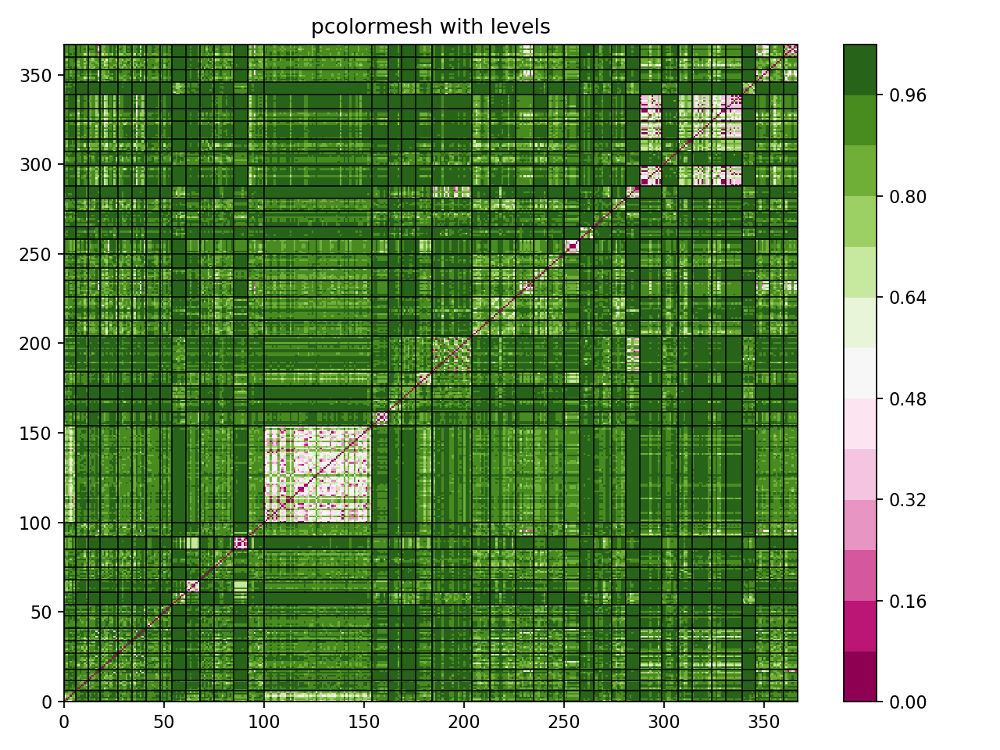

In [106]:
hists_proj_1gram = get_hists(some_changes_proj, hists_path=RESULTS_FOR_HIST_PATH_1GRAM, gram_path="1gram")
canberra_dists_proj_1gram = get_dists(hists_proj_1gram, canberra_metric, hist_len_1gram)
drawhist2(some_changes_proj, canberra_dists_proj_1gram, True, lw=0.7)

In [107]:
clustering_canb_1gram = sklearn.cluster.DBSCAN(eps=0.58, min_samples=2, metric='precomputed').fit(canberra_dists_proj_1gram)
print_clustering_results(clustering_canb_1gram, some_changes_proj)


[(3, 874, 4), (4, 1645, 1), (4, 1645, 2), (4, 1645, 4), (4, 1645, 6), (4, 1645, 7), (4, 1645, 8), (4, 1645, 10), (4, 1645, 12), (4, 1645, 14), (4, 1645, 17), (4, 1645, 20), (4, 1645, 22), (4, 1645, 24), (4, 1645, 25), (4, 1645, 26), (4, 1645, 27), (4, 1645, 28), (4, 1645, 29), (4, 1645, 30), (4, 1645, 31), (4, 1645, 32), (4, 1645, 36), (4, 1645, 37), (4, 1645, 39), (4, 1645, 41), (4, 1645, 42), (4, 1645, 44), (4, 1645, 45), (4, 1645, 47), (4, 1645, 48), (4, 1645, 53), (4, 1645, 55), (4, 1645, 56), (4, 1645, 57), (4, 1645, 62), (4, 1645, 65), (4, 1645, 66), (4, 1645, 68), (4, 1645, 70), (4, 1645, 71), (4, 1645, 72), (4, 1645, 73), (4, 1645, 74), (4, 1645, 79)]


[(3, 874, 6), (4, 1645, 5), (4, 1645, 9), (4, 1645, 15), (4, 1645, 16), (4, 1645, 19), (4, 1645, 33), (4, 1645, 59), (4, 1645, 67)]


[(3, 2177, 2), (3, 2206, 6), (3, 2206, 7), (3, 2556, 4), (3, 2556, 6), (3, 2556, 12), (3, 2556, 14), (3, 3080, 4), (3, 3080, 6), (3, 3080, 7), (3, 15195, 6), (5, 3117, 2), (5, 3117, 3), (5, 3117, 

In [108]:
clustering_pearson_1gram = sklearn.cluster.DBSCAN(eps=0.6, min_samples=2, metric='precomputed').fit(canberra_dists_proj_1gram)
print_clustering_results(clustering_pearson_1gram, some_changes_proj)


[(3, 874, 1), (3, 874, 4), (3, 2177, 2), (3, 2206, 6), (3, 2206, 7), (3, 2556, 4), (3, 2556, 6), (3, 2556, 12), (3, 2556, 14), (3, 3080, 4), (3, 3080, 6), (3, 3080, 7), (3, 15195, 6), (4, 1645, 1), (4, 1645, 2), (4, 1645, 4), (4, 1645, 6), (4, 1645, 7), (4, 1645, 8), (4, 1645, 10), (4, 1645, 12), (4, 1645, 14), (4, 1645, 17), (4, 1645, 20), (4, 1645, 22), (4, 1645, 24), (4, 1645, 25), (4, 1645, 26), (4, 1645, 27), (4, 1645, 28), (4, 1645, 29), (4, 1645, 30), (4, 1645, 31), (4, 1645, 32), (4, 1645, 36), (4, 1645, 37), (4, 1645, 39), (4, 1645, 41), (4, 1645, 42), (4, 1645, 44), (4, 1645, 45), (4, 1645, 47), (4, 1645, 48), (4, 1645, 53), (4, 1645, 55), (4, 1645, 56), (4, 1645, 57), (4, 1645, 62), (4, 1645, 65), (4, 1645, 66), (4, 1645, 68), (4, 1645, 70), (4, 1645, 71), (4, 1645, 72), (4, 1645, 73), (4, 1645, 74), (4, 1645, 79), (5, 3117, 2), (5, 3117, 3), (5, 3117, 5), (5, 4237, 4), (5, 4237, 5), (5, 4237, 9), (5, 4237, 10), (5, 4237, 19), (5, 5266, 3), (5, 5266, 6), (5, 5266, 8), (5, 52

<IPython.core.display.Javascript object>


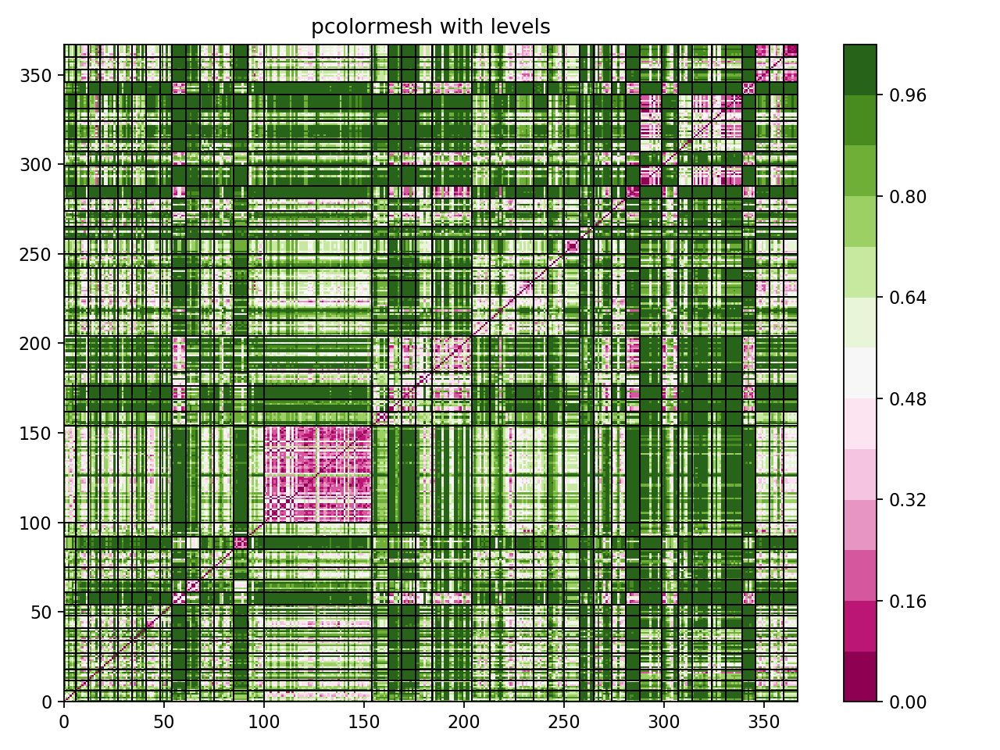

In [109]:
pearsons_dists_proj_1gram = get_dists(hists_proj_1gram, pearsons_correlation, hist_len_1gram)
drawhist2(some_changes_proj, pearsons_dists_proj_1gram, True, lw=0.9)

In [314]:
hists_proj2 = get_hists(some_changes_proj2, hists_path=RESULTS_FOR_HIST_PATH_5GRAM, gram_path="5gram")

In [94]:
some_changes_proj_nums2

[((3, 207), 5, 0),
 ((3, 2658), 5, 5),
 ((3, 4256), 6, 10),
 ((3, 4970), 6, 16),
 ((3, 5629), 6, 22),
 ((3, 6120), 5, 28),
 ((3, 6808), 5, 33),
 ((3, 9219), 6, 38),
 ((4, 4280), 6, 44),
 ((4, 9682), 6, 50),
 ((4, 9917), 6, 56),
 ((4, 10244), 6, 62),
 ((4, 13305), 6, 68),
 ((4, 14225), 6, 74),
 ((5, 2555), 6, 80),
 ((5, 9818), 6, 86),
 ((5, 10220), 6, 92),
 ((5, 10893), 6, 98),
 ((5, 11149), 6, 104),
 ((5, 13829), 6, 110),
 ((6, 543), 6, 116),
 ((6, 889), 6, 122),
 ((6, 5764), 6, 128),
 ((6, 6937), 6, 134),
 ((6, 12209), 6, 140),
 ((7, 841), 6, 146),
 ((7, 892), 6, 152),
 ((7, 6093), 6, 158),
 ((8, 10809), 6, 164),
 ((9, 4011), 6, 170),
 ((9, 12637), 6, 176),
 ((10, 2848), 6, 182),
 ((10, 6489), 6, 188),
 ((13, 3304), 6, 194),
 ((13, 8959), 6, 200),
 ((13, 13228), 6, 206),
 ((19, 8828), 6, 212),
 ((19, 11964), 6, 218),
 ((21, 3149), 6, 224),
 ((27, 4304), 6, 230)]

In [126]:
ind = 0

for elem in some_changes_proj2:
    print(elem, "<->", ind)
    ind += 1

(3, 207, 1) <-> 0
(3, 207, 2) <-> 1
(3, 207, 4) <-> 2
(3, 207, 5) <-> 3
(3, 207, 6) <-> 4
(3, 2658, 2) <-> 5
(3, 2658, 3) <-> 6
(3, 2658, 4) <-> 7
(3, 2658, 5) <-> 8
(3, 2658, 7) <-> 9
(3, 4256, 1) <-> 10
(3, 4256, 2) <-> 11
(3, 4256, 3) <-> 12
(3, 4256, 4) <-> 13
(3, 4256, 6) <-> 14
(3, 4256, 9) <-> 15
(3, 4970, 2) <-> 16
(3, 4970, 3) <-> 17
(3, 4970, 4) <-> 18
(3, 4970, 6) <-> 19
(3, 4970, 7) <-> 20
(3, 4970, 9) <-> 21
(3, 5629, 1) <-> 22
(3, 5629, 2) <-> 23
(3, 5629, 3) <-> 24
(3, 5629, 4) <-> 25
(3, 5629, 5) <-> 26
(3, 5629, 6) <-> 27
(3, 6120, 2) <-> 28
(3, 6120, 3) <-> 29
(3, 6120, 4) <-> 30
(3, 6120, 6) <-> 31
(3, 6120, 8) <-> 32
(3, 6808, 2) <-> 33
(3, 6808, 4) <-> 34
(3, 6808, 5) <-> 35
(3, 6808, 6) <-> 36
(3, 6808, 8) <-> 37
(3, 9219, 1) <-> 38
(3, 9219, 2) <-> 39
(3, 9219, 3) <-> 40
(3, 9219, 4) <-> 41
(3, 9219, 5) <-> 42
(3, 9219, 6) <-> 43
(4, 4280, 1) <-> 44
(4, 4280, 2) <-> 45
(4, 4280, 3) <-> 46
(4, 4280, 4) <-> 47
(4, 4280, 5) <-> 48
(4, 4280, 6) <-> 49
(4, 9682, 1) <-

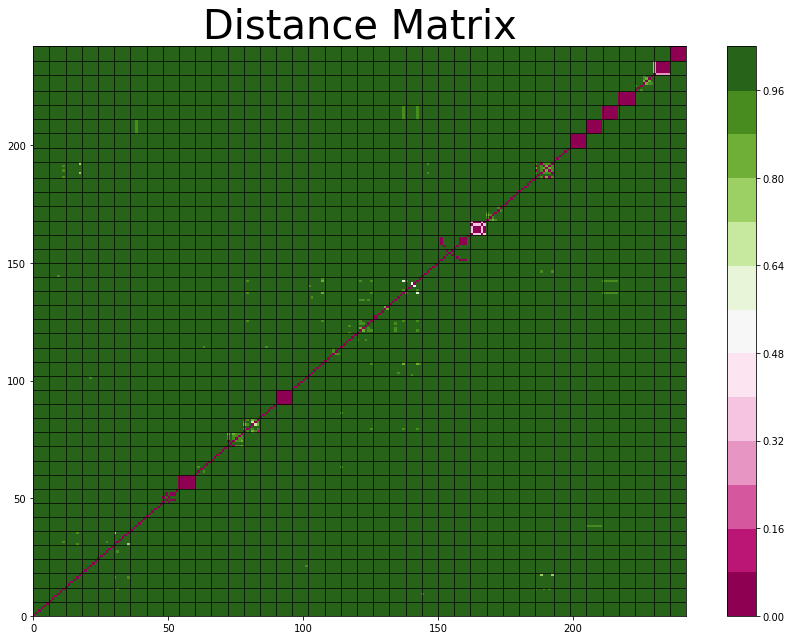

In [315]:
canberra_dists_proj2 = get_dists(hists_proj2, canberra_metric, hist_len_5gram)
drawhist2(some_changes_proj2, canberra_dists_proj2, True, lw=0.7)

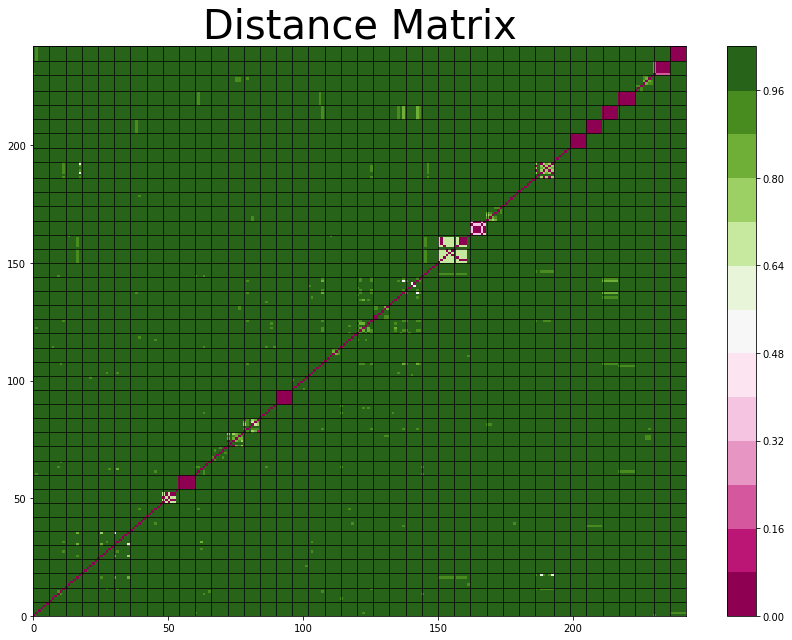

In [316]:
hists_proj2_4gram = get_hists(some_changes_proj2, hists_path=RESULTS_FOR_HIST_PATH_4GRAM, gram_path="4gram")
canberra_dists_proj2_4gram = get_dists(hists_proj2_4gram, canberra_metric, hist_len_4gram)
drawhist2(some_changes_proj2, canberra_dists_proj2_4gram, True, lw=0.7)

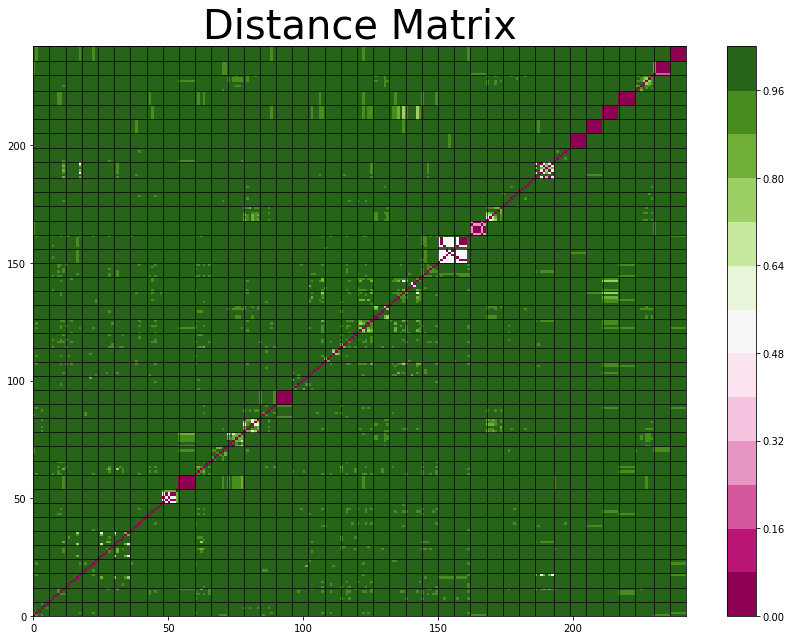

In [317]:
hists_proj2_3gram = get_hists(some_changes_proj2, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
canberra_dists_proj2_3gram = get_dists(hists_proj2_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes_proj2, canberra_dists_proj2_3gram, True, lw=0.7)

In [114]:
clustering_canb_proj2_2gram = sklearn.cluster.DBSCAN(eps=0.4, min_samples=2, metric='precomputed').fit(canberra_dists_proj2_3gram)
print_clustering_results(clustering_canb_proj2_2gram, some_changes_proj2)


[(3, 6808, 6), (3, 6808, 8)]
2
5


[(4, 4280, 1), (4, 4280, 2), (4, 4280, 3), (4, 4280, 4), (4, 4280, 5), (4, 4280, 6)]
6
6


[(4, 10244, 2), (4, 10244, 4)]
2
6


[(4, 14225, 1), (4, 14225, 2), (4, 14225, 3), (4, 14225, 4), (4, 14225, 5), (4, 14225, 6)]
6
6


[(6, 5764, 3), (6, 5764, 6), (6, 6937, 3), (6, 6937, 5), (6, 6937, 6)]


[(6, 12209, 1), (6, 12209, 2), (6, 12209, 3), (6, 12209, 7), (6, 12209, 8), (6, 12209, 10)]
6
6


[(9, 4011, 1), (9, 4011, 2), (9, 4011, 3), (9, 4011, 4), (9, 4011, 5), (9, 4011, 6)]
6
6


[(9, 12637, 1), (9, 12637, 2), (9, 12637, 3), (9, 12637, 4), (9, 12637, 5), (9, 12637, 6)]
6
6


[(10, 2848, 1), (10, 2848, 2), (10, 2848, 3), (10, 2848, 4), (10, 2848, 5), (10, 2848, 6)]
6
6


[(10, 6489, 1), (10, 6489, 2), (10, 6489, 3), (10, 6489, 4), (10, 6489, 5), (10, 6489, 6)]
6
6


[(13, 3304, 1), (13, 3304, 2), (13, 3304, 3), (13, 3304, 4), (13, 3304, 5), (13, 3304, 6)]
6
6


[(13, 8959, 1), (13, 8959, 2), (13, 8959, 4), (13, 8959, 5), (13, 8959, 7), (13, 8959, 9)]

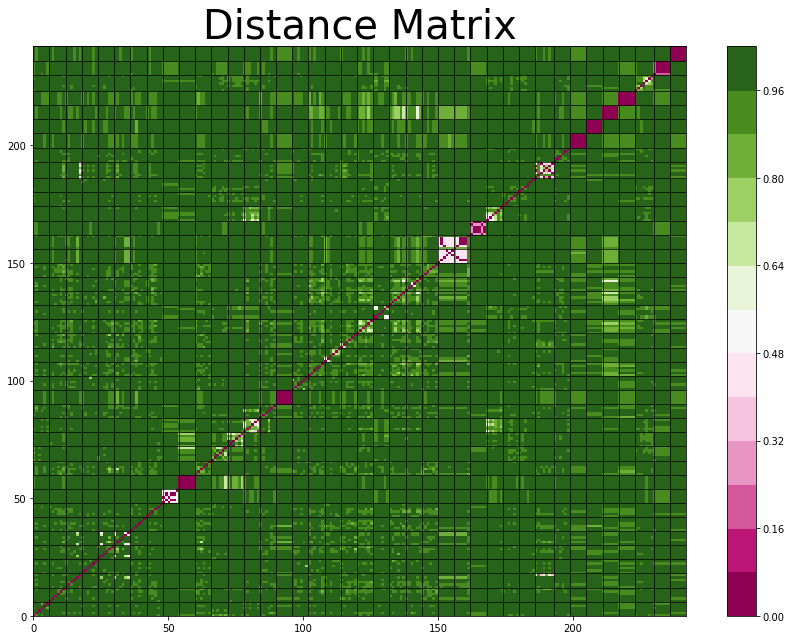

In [318]:
hists_proj2_2gram = get_hists(some_changes_proj2, hists_path=RESULTS_FOR_HIST_PATH_2GRAM, gram_path="2gram")
canberra_dists_proj2_2gram = get_dists(hists_proj2_2gram, canberra_metric, hist_len_2gram)
drawhist2(some_changes_proj2, canberra_dists_proj2_2gram, True, lw=0.7)

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


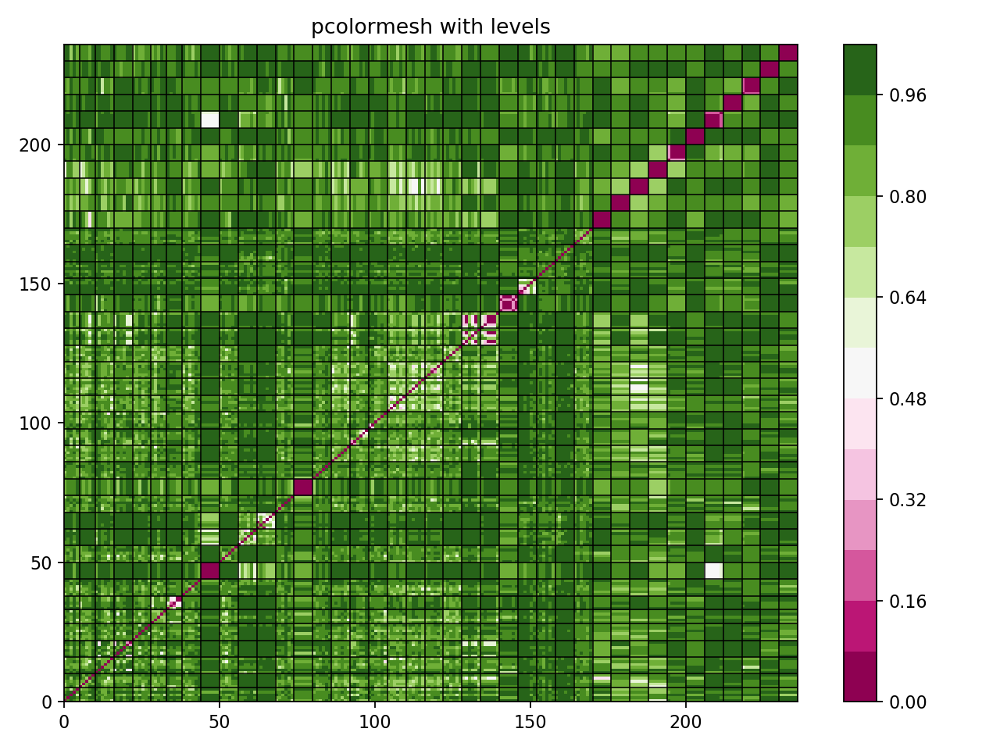

In [116]:
hists_proj2_1gram = get_hists(some_changes_proj2, hists_path=RESULTS_FOR_HIST_PATH_1GRAM, gram_path="1gram")
canberra_dists_proj2_1gram = get_dists(hists_proj2_1gram, canberra_metric, hist_len_1gram)
drawhist2(some_changes_proj2, canberra_dists_proj2_1gram, True, lw=0.7)

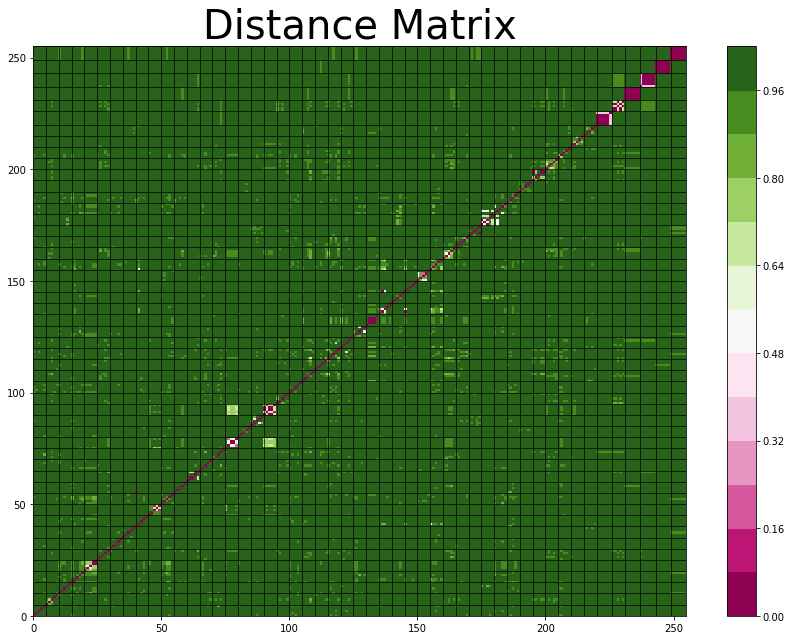

In [319]:
hists_proj3_3gram = get_hists(some_changes_proj3, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
canberra_dists_proj3_3gram = get_dists(hists_proj3_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes_proj3, canberra_dists_proj3_3gram, True, lw=0.7)

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


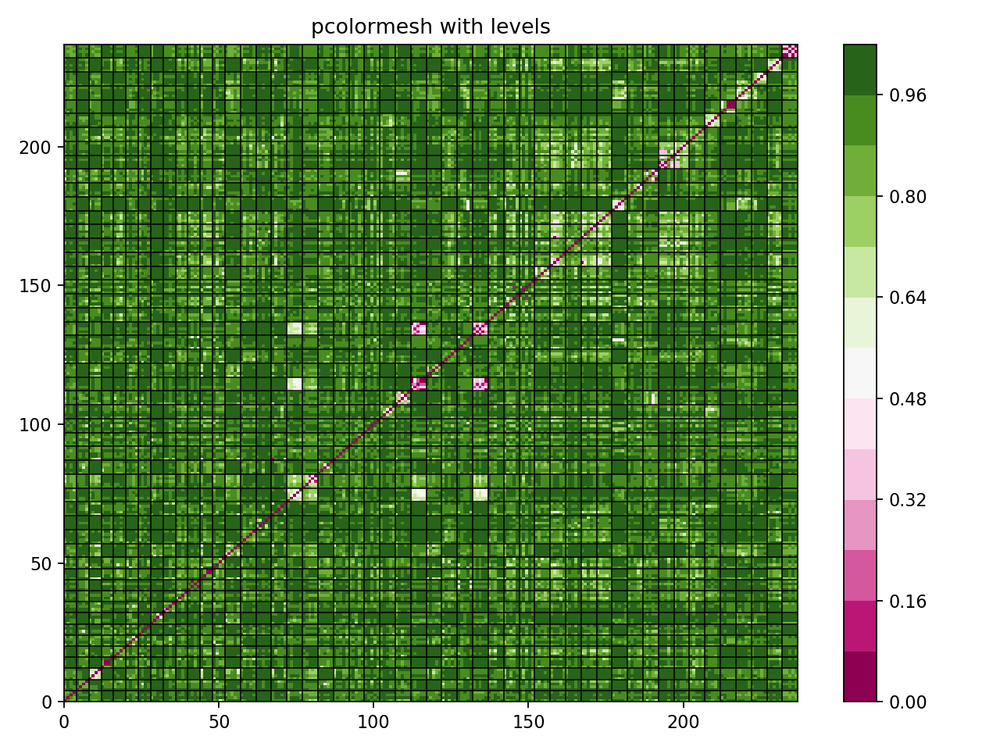

In [118]:
hists_proj3_1gram = get_hists(some_changes_proj3, hists_path=RESULTS_FOR_HIST_PATH_1GRAM, gram_path="1gram")
canberra_dists_proj3_1gram = get_dists(hists_proj3_1gram, canberra_metric, hist_len_1gram)
drawhist2(some_changes_proj3, canberra_dists_proj3_1gram, True, lw=0.7)

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


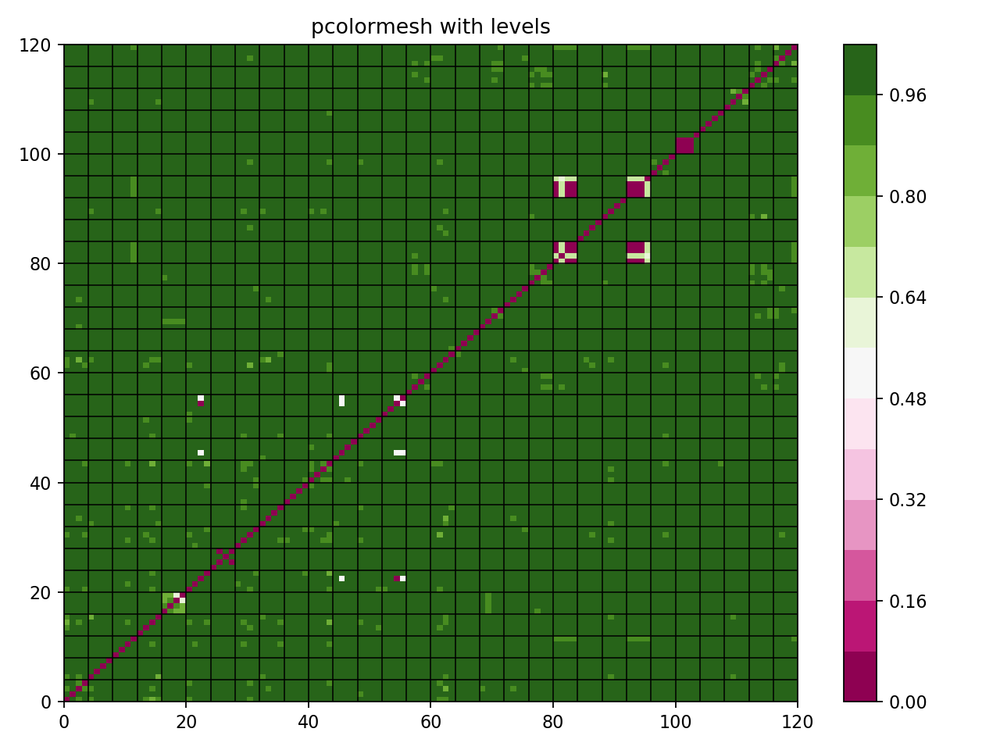

In [119]:
hists_proj4_3gram = get_hists(some_changes_proj4, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
canberra_dists_proj4_3gram = get_dists(hists_proj4_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes_proj4, canberra_dists_proj4_3gram, True, lw=0.7)

In [120]:
some_changes_proj_nums4

[((3, 5683), 4, 0),
 ((3, 5690), 4, 4),
 ((3, 5797), 4, 8),
 ((3, 6684), 4, 12),
 ((3, 6776), 4, 16),
 ((3, 7588), 4, 20),
 ((3, 7789), 4, 24),
 ((3, 7967), 4, 28),
 ((3, 8644), 4, 32),
 ((3, 9789), 4, 36),
 ((3, 9891), 4, 40),
 ((3, 12132), 4, 44),
 ((3, 13077), 4, 48),
 ((3, 14067), 4, 52),
 ((3, 14931), 4, 56),
 ((3, 15127), 4, 60),
 ((4, 718), 4, 64),
 ((4, 764), 4, 68),
 ((4, 945), 4, 72),
 ((4, 1214), 4, 76),
 ((4, 2332), 4, 80),
 ((4, 2676), 4, 84),
 ((4, 3349), 4, 88),
 ((4, 3353), 4, 92),
 ((4, 3592), 4, 96),
 ((4, 3780), 4, 100),
 ((4, 6565), 4, 104),
 ((4, 7238), 4, 108),
 ((4, 8040), 4, 112),
 ((4, 8441), 4, 116)]

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


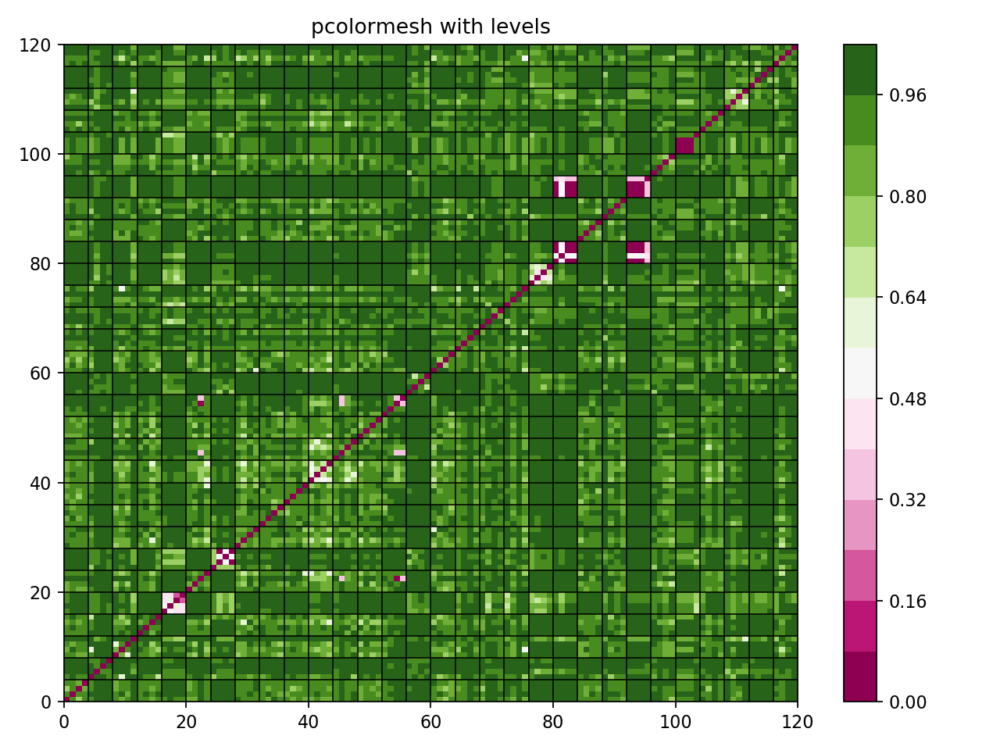

In [121]:
hists_proj4_1gram = get_hists(some_changes_proj4, hists_path=RESULTS_FOR_HIST_PATH_1GRAM, gram_path="1gram")
canberra_dists_proj4_1gram = get_dists(hists_proj4_1gram, canberra_metric, hist_len_1gram)
drawhist2(some_changes_proj4, canberra_dists_proj4_1gram, True, lw=0.7)

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


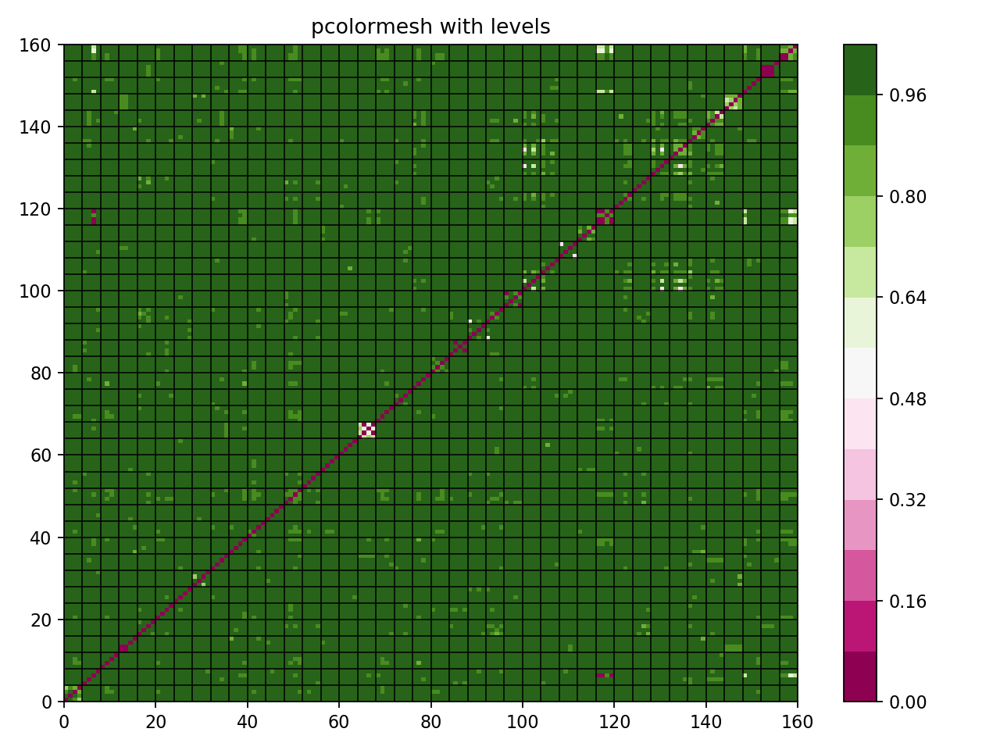

In [122]:
hists_proj5_3gram = get_hists(some_changes_proj5, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
canberra_dists_proj5_3gram = get_dists(hists_proj5_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes_proj5, canberra_dists_proj5_3gram, True, lw=0.7)

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


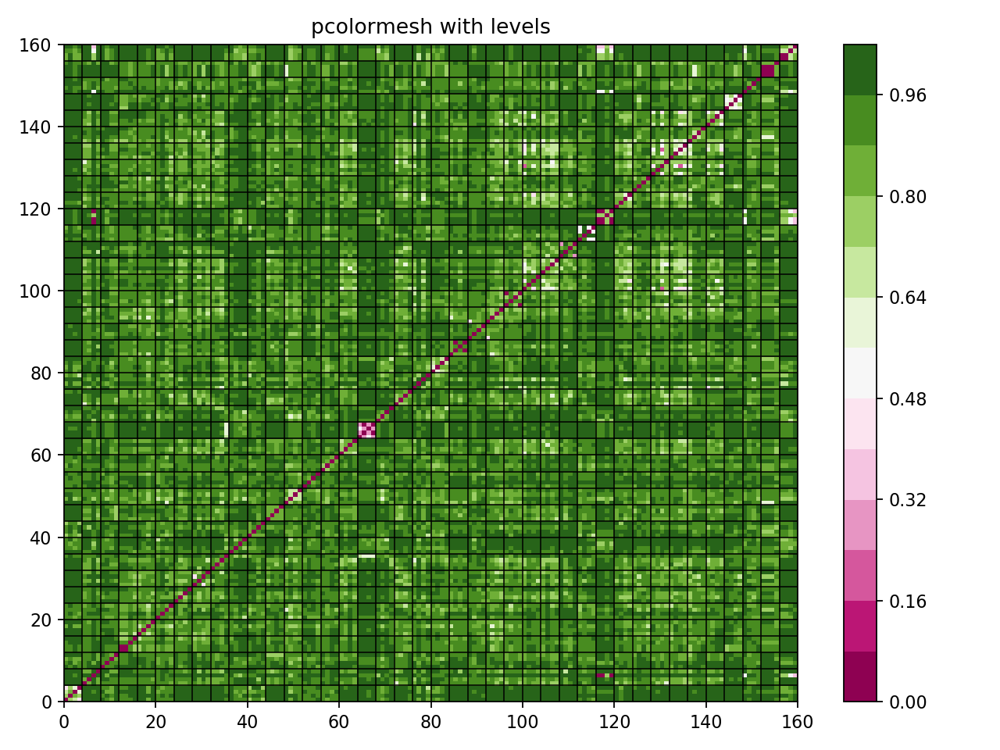

In [123]:
hists_proj5_1gram = get_hists(some_changes_proj5, hists_path=RESULTS_FOR_HIST_PATH_1GRAM, gram_path="1gram")
canberra_dists_proj5_1gram = get_dists(hists_proj5_1gram, canberra_metric, hist_len_1gram)
drawhist2(some_changes_proj5, canberra_dists_proj5_1gram, True, lw=0.7)

In [124]:
some_changes_proj_nums5

[((4, 8690), 4, 0),
 ((4, 9019), 4, 4),
 ((4, 9362), 4, 8),
 ((4, 10155), 4, 12),
 ((4, 10828), 4, 16),
 ((4, 11631), 4, 20),
 ((4, 11677), 4, 24),
 ((4, 12139), 4, 28),
 ((4, 12155), 4, 32),
 ((4, 12440), 4, 36),
 ((4, 12753), 4, 40),
 ((4, 13510), 4, 44),
 ((4, 13597), 4, 48),
 ((4, 13695), 4, 52),
 ((4, 14300), 4, 56),
 ((4, 14726), 4, 60),
 ((4, 14811), 4, 64),
 ((5, 86), 4, 68),
 ((5, 264), 4, 72),
 ((5, 1085), 4, 76),
 ((5, 1889), 4, 80),
 ((5, 2583), 4, 84),
 ((5, 2869), 4, 88),
 ((5, 3498), 4, 92),
 ((5, 3524), 4, 96),
 ((5, 3569), 4, 100),
 ((5, 3660), 4, 104),
 ((5, 3691), 4, 108),
 ((5, 4159), 4, 112),
 ((5, 4353), 4, 116),
 ((5, 5015), 4, 120),
 ((5, 5121), 4, 124),
 ((5, 5515), 4, 128),
 ((5, 5547), 4, 132),
 ((5, 5584), 4, 136),
 ((5, 6137), 4, 140),
 ((5, 6381), 4, 144),
 ((5, 6505), 4, 148),
 ((5, 7487), 4, 152),
 ((5, 7513), 4, 156)]

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


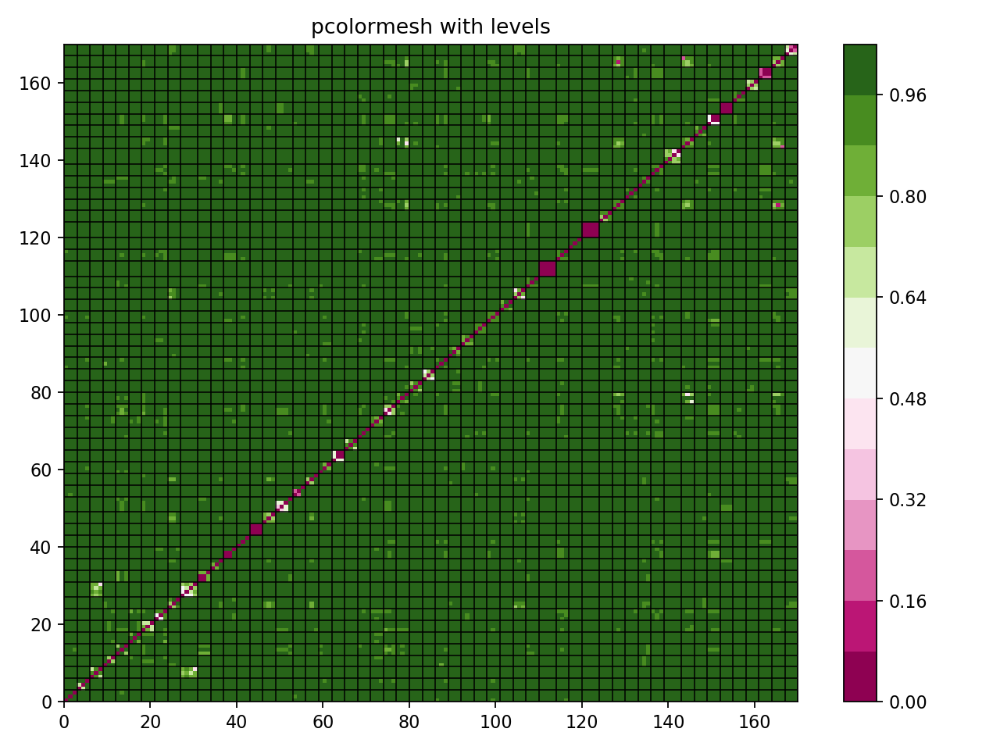

In [125]:
hists_proj6_3gram = get_hists(some_changes_proj6, hists_path=RESULTS_FOR_HIST_PATH_3GRAM, gram_path="3gram")
canberra_dists_proj6_3gram = get_dists(hists_proj6_3gram, canberra_metric, hist_len_3gram)
drawhist2(some_changes_proj6, canberra_dists_proj6_3gram, True, lw=0.7)

## Tufano dataset

In [231]:
RESULTS_FOR_HIST_PATH_TUFANO_5GRAM = "/Volumes/Seagate/Alina/result_for_tufano-5gram"
RESULTS_FOR_HIST_PATH_TUFANO_3GRAM = "/Volumes/Seagate/Alina/result_for_tufano-3gram"

In [232]:
sorted_dirs = [os.fsdecode(el) for el in os.listdir(RESULTS_FOR_HIST_PATH_TUFANO_3GRAM) 
               if os.path.isdir(RESULTS_FOR_HIST_PATH_TUFANO_3GRAM + "/" + os.fsdecode(el))]
sorted_dirs = sorted(sorted_dirs, key=lambda s: int(s.split(" ")[0])) 

In [233]:
sorted_dirs

['1 1',
 '2 2',
 '3 3',
 '4 4',
 '6 6',
 '7 7',
 '9 9',
 '11 11',
 '12 12',
 '16 16',
 '17 17',
 '20 20',
 '21 21',
 '23 23',
 '24 24',
 '25 25',
 '27 27',
 '28 28',
 '30 30',
 '32 32',
 '33 33',
 '34 34',
 '35 35',
 '36 36',
 '37 37',
 '38 38',
 '39 39',
 '40 40',
 '41 41',
 '42 42',
 '43 43',
 '45 45',
 '46 46',
 '47 47',
 '48 48',
 '49 49',
 '50 50',
 '53 53',
 '55 55',
 '56 56',
 '57 57',
 '59 59',
 '60 60',
 '61 61',
 '65 65',
 '67 67',
 '68 68',
 '69 69',
 '70 70',
 '72 72',
 '73 73',
 '74 74',
 '76 76',
 '77 77',
 '80 80',
 '82 82',
 '83 83',
 '85 85',
 '86 86',
 '89 89',
 '90 90',
 '92 92',
 '93 93',
 '95 95',
 '97 97',
 '101 101',
 '108 108',
 '109 109',
 '110 110',
 '111 111',
 '113 113',
 '115 115',
 '116 116',
 '118 118',
 '119 119',
 '120 120',
 '121 121',
 '123 123',
 '125 125',
 '126 126',
 '129 129',
 '130 130',
 '132 132',
 '133 133',
 '134 134',
 '135 135',
 '136 136',
 '137 137',
 '138 138',
 '139 139',
 '140 140',
 '144 144',
 '146 146',
 '148 148',
 '149 149',
 '15

In [234]:
hists_tufano_3gram = []
gram_path = "3gram"

for double_num in tqdm_notebook(sorted_dirs):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_3GRAM + "/" + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_tufano_3gram.append(hist_data1)
    hist_file1.close()

In [220]:
hists_tufano = []
gram_path = "5gram"

for double_num in tqdm_notebook(sorted_dirs):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_5GRAM + "/" + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_tufano.append(hist_data1)
    hist_file1.close()

In [221]:
hists_tufano

[[(245, 1), (578, 1)],
 [(0, 1), (1, 1), (2, 1), (22, 1), (25, 1), (47, 1)],
 [(0, 1), (69, 1)],
 [(371, 1)],
 [(0, 1), (1, 1), (2, 1)],
 [(321, 1), (356, 1), (520, 1), (549, 1), (614, 1)],
 [(73, 1),
  (74, 1),
  (85, 1),
  (132, 1),
  (134, 1),
  (139, 1),
  (149, 1),
  (160, 1),
  (162, 1),
  (164, 1),
  (231, 1),
  (324, 1),
  (494, 1),
  (586, 1)],
 [(241, 1), (364, 1), (617, 1)],
 [(435, 1), (543, 1)],
 [(16, 1), (20, 1), (37, 1), (57, 1)],
 [(35, 1), (38, 1), (46, 1), (50, 1), (109, 1), (118, 1)],
 [(329, 1), (569, 1)],
 [(13, 1), (133, 1), (135, 1)],
 [(0, 1), (49, 1)],
 [(227, 1), (290, 1)],
 [(0, 1), (1, 1), (2, 1)],
 [(201, 1), (204, 1), (593, 1)],
 [(0, 1), (49, 1)],
 [(213, 1), (311, 1), (482, 1)],
 [(215, 1),
  (288, 1),
  (295, 1),
  (346, 1),
  (372, 1),
  (381, 1),
  (505, 1),
  (539, 1),
  (596, 1)],
 [(0, 1), (519, 1)],
 [(16, 1), (20, 1), (37, 1), (57, 1)],
 [(13, 1), (133, 1), (135, 1)],
 [(73, 1),
  (74, 1),
  (85, 1),
  (123, 1),
  (132, 1),
  (139, 1),
  (149, 1

In [222]:
hist_len_5gram_tufano = None

es_path = RESULTS_FOR_HIST_PATH_TUFANO_5GRAM + "/" + "edit_scripts_5grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_5gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_5gram_tufano)

629


//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


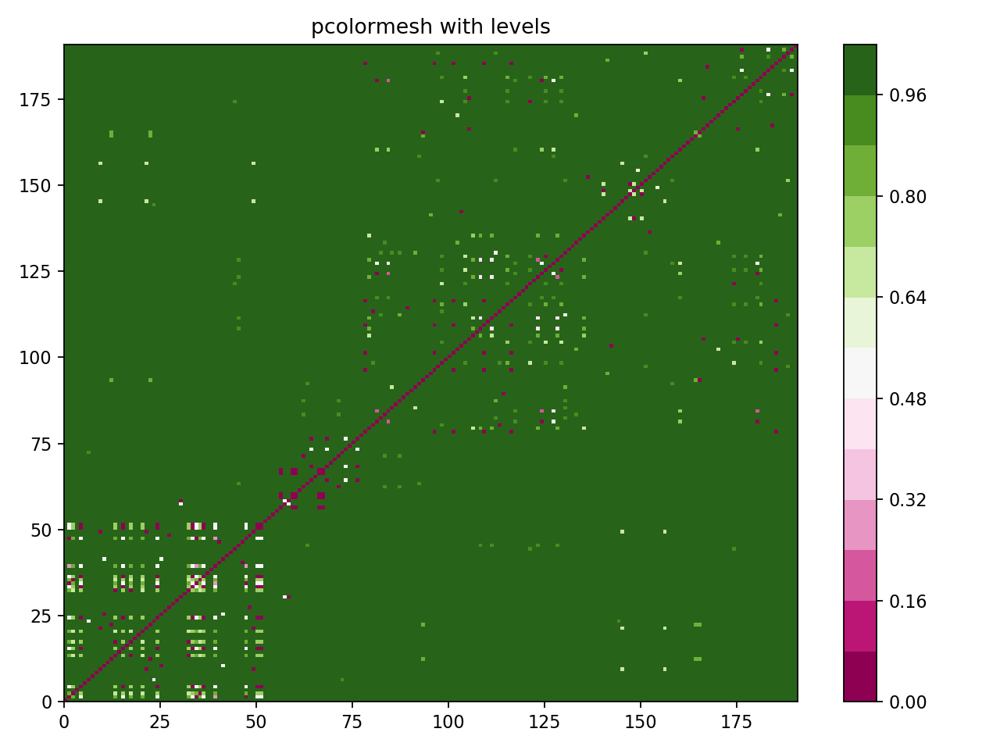

In [224]:
dists_tufano_5gram = get_dists(hists_tufano, canberra_metric, hist_len_5gram_tufano)
drawhist2(sorted_dirs, dists_tufano_5gram, False, lw=0.7)

In [225]:
RESULTS_FOR_HIST_PATH_TUFANO_4GRAM = "/Volumes/Seagate/Alina/result_for_tufano-4gram"

In [226]:
hists_tufano_4gram = []
gram_path = "4gram"

for double_num in tqdm_notebook(sorted_dirs):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_4GRAM + "/" + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_tufano_4gram.append(hist_data1)
    hist_file1.close()

In [227]:
hist_len_4gram_tufano = None

es_path = RESULTS_FOR_HIST_PATH_TUFANO_4GRAM + "/" + "edit_scripts_4grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_4gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_4gram_tufano)

656


In [245]:
hist_len_3gram_tufano = None

es_path = RESULTS_FOR_HIST_PATH_TUFANO_3GRAM + "/" + "edit_scripts_3grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_3gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_3gram_tufano)

607


//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


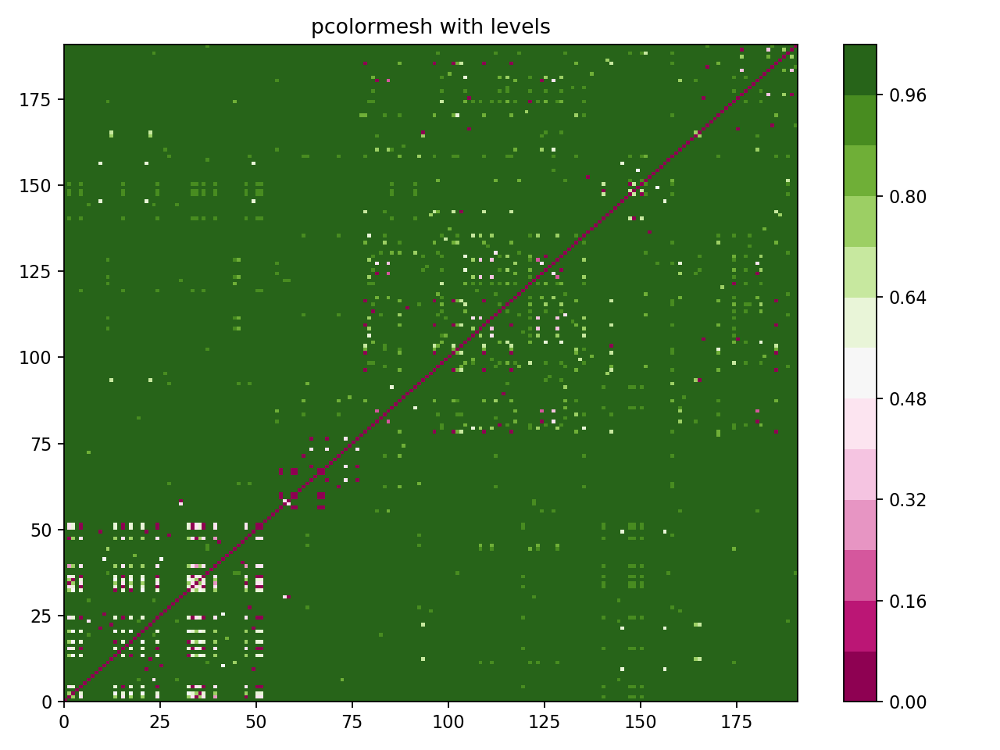

In [228]:
dists_tufano_4gram = get_dists(hists_tufano_4gram, canberra_metric, hist_len_4gram_tufano)
drawhist2(sorted_dirs, dists_tufano_4gram, False, lw=0.7)

In [201]:
dists_tufano = get_dists(hists_tufano, canberra_metric, hist_len_2gram_tufano)

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


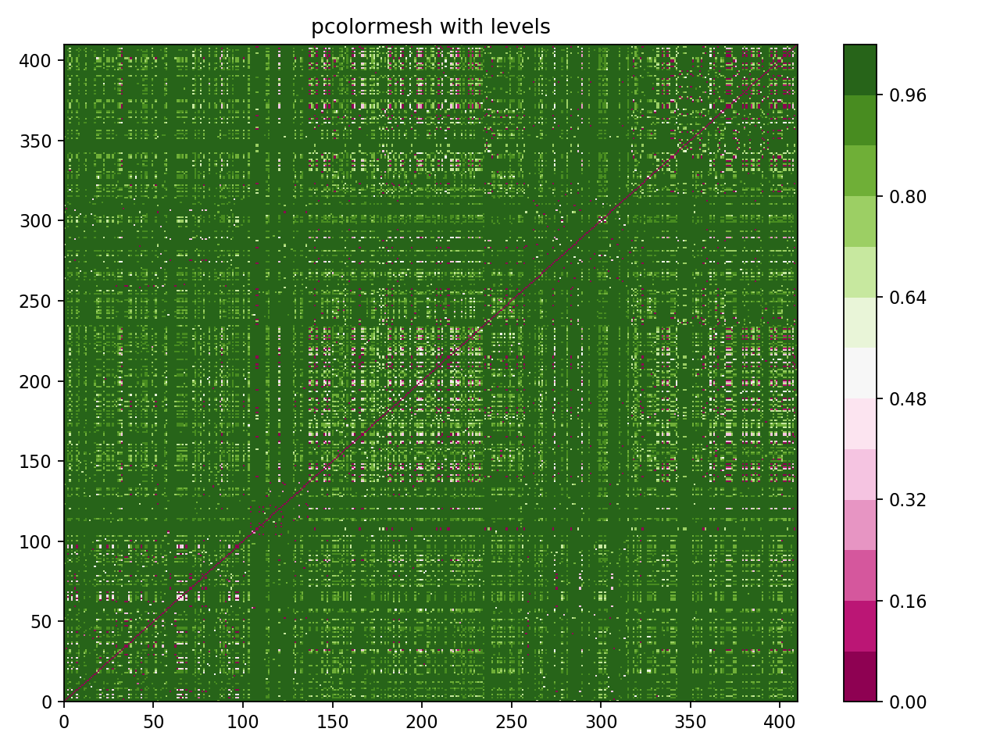

In [202]:
drawhist2(sorted_dirs, dists_tufano, False, lw=0.7)

In [442]:
label_to_changes = collections.defaultdict(list)
from_change_to_labels = collections.defaultdict(list)

# TODO: delete 'unclear' group

In [443]:
TUFANO_DATASET_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoDataset"

In [444]:
for double_num in tqdm_notebook(sorted_dirs):
    change_id = double_num.split(" ")[0]
    label_file = open(TUFANO_DATASET_PATH + "/" + change_id + "/" + "label.txt")
    labels = label_file.read().split(",")
    
    for label in labels:
        if label != "" and label != 'unclear':
            label_to_changes[label].append(change_id)
            from_change_to_labels[change_id].append(label)

In [445]:
print("NUM CLASSES:", len(label_to_changes))

NUM CLASSES: 54


In [446]:
label_to_changes

defaultdict(list,
            {'Add braces to if statement': ['1',
              '392',
              '395',
              '409',
              '426',
              '441',
              '468'],
             'Forbid overriding: add final to method': ['2', '45', '466'],
             'Remove statement': ['3',
              '9',
              '16',
              '35',
              '41',
              '53',
              '56',
              '59',
              '61',
              '65',
              '69',
              '80',
              '92',
              '93',
              '97',
              '110',
              '111',
              '118',
              '121',
              '123',
              '125',
              '132',
              '133',
              '135',
              '137',
              '138',
              '149',
              '167',
              '193',
              '197',
              '200',
              '203',
              '210',
              '211',
              

In [447]:
ids_per_label = []
lines_poses = []
cur_sum = 0
all_labels = []

In [448]:
for label in label_to_changes:
    all_labels.append(label)
    for change in label_to_changes[label]:
        ids_per_label.append(change)
        cur_sum += 1
    lines_poses.append(cur_sum)

In [449]:
for i in range(len(ids_per_label)):
    print("On index", i, ids_per_label[i])

On index 0 1
On index 1 392
On index 2 395
On index 3 409
On index 4 426
On index 5 441
On index 6 468
On index 7 2
On index 8 45
On index 9 466
On index 10 3
On index 11 9
On index 12 16
On index 13 35
On index 14 41
On index 15 53
On index 16 56
On index 17 59
On index 18 61
On index 19 65
On index 20 69
On index 21 80
On index 22 92
On index 23 93
On index 24 97
On index 25 110
On index 26 111
On index 27 118
On index 28 121
On index 29 123
On index 30 125
On index 31 132
On index 32 133
On index 33 135
On index 34 137
On index 35 138
On index 36 149
On index 37 167
On index 38 193
On index 39 197
On index 40 200
On index 41 203
On index 42 210
On index 43 211
On index 44 214
On index 45 224
On index 46 227
On index 47 231
On index 48 234
On index 49 235
On index 50 239
On index 51 241
On index 52 249
On index 53 250
On index 54 251
On index 55 260
On index 56 261
On index 57 273
On index 58 274
On index 59 275
On index 60 289
On index 61 292
On index 62 295
On index 63 296
On index

In [450]:
for i in range(len(lines_poses)):
    if i == 0:
        print("From 0 to", lines_poses[i], "is", all_labels[i])
    else:
        print("From", lines_poses[i - 1], "to", lines_poses[i], all_labels[i])

From 0 to 7 is Add braces to if statement
From 7 to 10 Forbid overriding: add final to method
From 10 to 114 Remove statement
From 114 to 132 Remove parameter from the method invocation
From 132 to 138 Abstract an existing method using the abstract keyword
From 138 to 139 Move synchronized keyword from method signature to code block or vice versa
From 139 to 146 Merge variable definition & initialization
From 146 to 166 Remove invoked method
From 166 to 177 Add parameter in the method/constructor invocation
From 177 to 207 Add/Remove parameter
From 207 to 214 Remove condition
From 214 to 219 Move existing statements out of try block
From 219 to 223 Remove redundant initialization
From 223 to 225 Add/Remove synchronized keyword from variable
From 225 to 228 Add/Remove this qualifier
From 228 to 232 Add statement
From 232 to 234 Remove thrown exception
From 234 to 236 Rename variable
From 236 to 242 Replace fully qualified name with import or vice versa
From 242 to 251 Change return type

In [451]:
hists_per_label = []
gram_path = "3gram"

for double_num in tqdm_notebook(ids_per_label):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_3GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_per_label.append(hist_data1)
    hist_file1.close()

In [19]:
from scipy.interpolate import make_interp_spline, BSpline
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from scipy import optimize
%matplotlib inline

def knn_dists(dists, k, visualize=True, smooth_points=50, for_spline=(8, 4), need_4d=False):
    knn_dists = []
    
    for row in tqdm_notebook(dists):
        sorted_row = sorted(row)
        knn_dist = sorted_row[k - 1]
        knn_dists.append(knn_dist)
        
    sorted_knn_dists = np.array(sorted(knn_dists))
    sorted_unique_knn_dists = np.array(sorted(list(dict.fromkeys(knn_dists))))
    
    if visualize:
        xs = np.array([i for i in range(len(knn_dists))])
        plt.plot(xs, sorted_knn_dists)
        plt.show()
        
        without_zeros = [x for x in sorted_knn_dists if x != 0]
        xs = np.array([i for i in range(len(without_zeros))])
        plt.plot(xs, without_zeros)
        plt.show()
        
        xs = np.array([i for i in range(len(sorted_unique_knn_dists))])
        plt.plot(xs, sorted_unique_knn_dists)
        plt.show()

        xnew = np.linspace(xs.min(), xs.max(), smooth_points) 
        spl = make_interp_spline(xs, sorted_unique_knn_dists, k=3)  # type: BSpline
        smooth = spl(xnew)
        plt.plot(xnew, smooth)
        plt.show()
        
        #xx = xnew
        #yy = smooth
        #final_array_of_eps = sorted_unique_knn_dists
        
        # BAD
        #xx = np.array([i for i in range(len(knn_dists))])
        #yy = sorted_knn_dists
        #final_array_of_eps = sorted_knn_dists
        
        yy = np.array([elem for elem in sorted_knn_dists if elem != 0 and elem != 1])
        xx = np.array([i for i in range(len(yy))])
        final_array_of_eps = yy
        

        y_spl = UnivariateSpline(xx, yy, s=for_spline[0], k=for_spline[1])
        plt.semilogy(xx, yy, 'ro', label = 'data')
        x_range = np.linspace(xx[0], xx[-1], 1000)
        plt.semilogy(x_range, y_spl(x_range))
        plt.show()
        
        y_spl_2d = y_spl.derivative(n=2)
        plt.plot(x_range, y_spl_2d(x_range))
        plt.show()
        
        y_spl_3d = y_spl.derivative(n=3)
        plt.plot(x_range, y_spl_3d(x_range))
        plt.show()
        
        sol = optimize.root(y_spl_3d, [0, 0], method='hybr')
        root = sol.x[0]
        print(root)
        
        print("Eps =", final_array_of_eps[int(root)])
        
        if need_4d:
            y_spl_4d = y_spl.derivative(n=4)
            plt.plot(x_range, y_spl_4d(x_range))
            plt.show()
            
            sol = optimize.root(y_spl_4d, [0, 0], method='hybr')
            root = sol.x[0]
            print(root)
        
            print("Eps =", final_array_of_eps[int(root)])

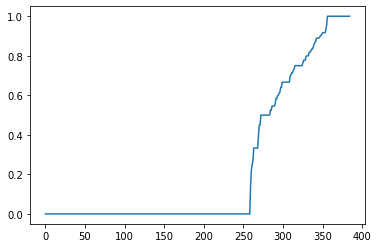

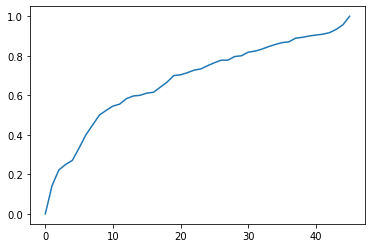

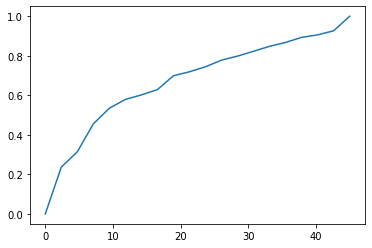

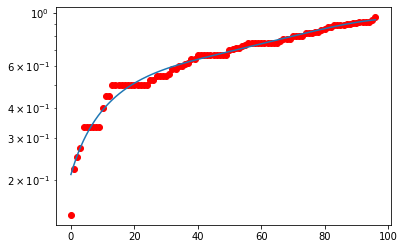

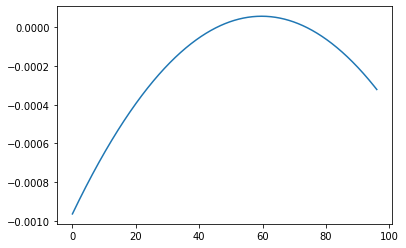

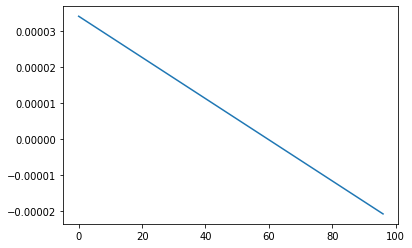

59.67272544740309
Eps = 0.75


In [1137]:
knn_dists(dists_per_label, 2, smooth_points=20)

In [40]:
def knn_dists_with_eps_line(dists, k, eps, title, eps2=None, fm1=0, fm2=0, label1=None, label2=None):
    if label1 == None:
        label1 = "best eps (Fm = " + str(fm1) + ")"
    if label2 == None:
        label2 = "eps, first way (Fm = " + str(fm2) + ")"
    
    
    knn_dists = []
    
    for row in tqdm_notebook(dists):
        sorted_row = sorted(row)
        knn_dist = sorted_row[k - 1]
        knn_dists.append(knn_dist)
        
    sorted_knn_dists = np.array(sorted(knn_dists))
    sorted_unique_knn_dists = np.array(sorted(list(dict.fromkeys(knn_dists))))
    
    xs = np.array([i for i in range(len(knn_dists))])
    plt.plot(xs, sorted_knn_dists)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(eps, 0, len(knn_dists), colors='green', linestyles='dashed', label=label1)
    
    if eps2 is not None:
        plt.hlines(eps2, 0, len(knn_dists), colors='orange', linestyles='dashed', label=label2)
    
    plt.legend()
    plt.title(title)
    plt.show()
    
    
    
    without_zeros = [x for x in sorted_knn_dists if x != 0]
    xs = np.array([i for i in range(len(without_zeros))])
    plt.plot(xs, without_zeros)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(eps, 0, len(without_zeros), colors='green', linestyles='dashed', label=label1)
    
    if eps2 is not None:
        plt.hlines(eps2, 0, len(without_zeros), colors='orange', linestyles='dashed', label=label2)
    plt.show()
    
    

    xs = np.array([i for i in range(len(sorted_unique_knn_dists))])
    plt.plot(xs, sorted_unique_knn_dists)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(eps, 0, len(sorted_unique_knn_dists), colors='green', linestyles='dashed', label=label1)
    
    if eps2 is not None:
        plt.hlines(eps2, 0, len(sorted_unique_knn_dists), colors='orange', linestyles='dashed', label=label2)
    plt.show()
    
    
    
    
    
        

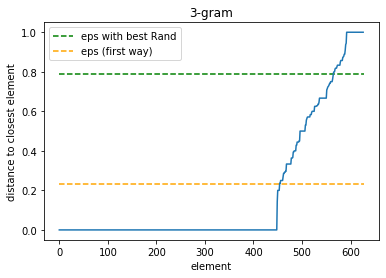

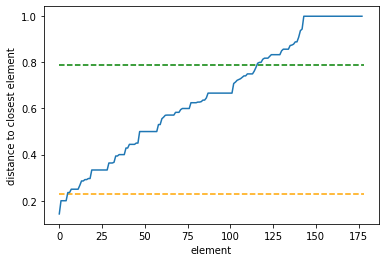

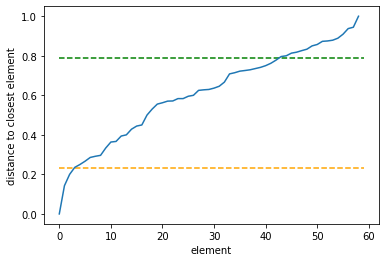

In [455]:
knn_dists_with_eps_line(dists_unique_2gram, 2, 0.79, "3-gram", eps2=0.23)

In [1127]:
def check_why_null(dists, k):
    knn_dists = []
    MINUS_INF = -100.0
    
    i = 0
    
    num_same = 0
    all_null = 0
    
    for row in dists:
        copy_row = row.copy()
        copy_row[i] = MINUS_INF
        sorted_row = sorted(copy_row)
        knn_dist = sorted_row[k - 1]
        if knn_dist == 0:
            all_null += 1
            print(i, np.argsort(copy_row)[k - 1], "It's", ids_per_label[i], ids_per_label[np.argsort(copy_row)[k - 1]])
            if ids_per_label[i] == ids_per_label[np.argsort(copy_row)[k - 1]]:
                num_same += 1
            
        
        knn_dists.append(knn_dist)
        
        i += 1
        
    sorted_knn_dists = np.array(sorted(knn_dists))
    
    print(num_same, all_null, len(dists))
        

In [1128]:
check_why_null(dists_per_label, 2)

2 4 It's 395 426
4 2 It's 426 395
5 289 It's 441 441
6 2 It's 468 395
7 8 It's 2 45
8 7 It's 45 2
9 7 It's 466 2
10 32 It's 3 133
11 22 It's 9 92
13 22 It's 35 92
15 215 It's 53 136
16 208 It's 56 56
17 22 It's 59 92
19 33 It's 65 135
22 35 It's 92 138
23 32 It's 93 133
24 22 It's 97 92
26 31 It's 111 132
30 281 It's 125 125
31 26 It's 132 111
32 23 It's 133 93
33 19 It's 135 65
34 22 It's 137 92
35 22 It's 138 92
37 265 It's 167 188
39 41 It's 197 203
41 110 It's 203 624
42 117 It's 210 126
43 103 It's 211 590
44 110 It's 214 624
45 97 It's 224 561
48 110 It's 234 624
49 153 It's 235 178
50 153 It's 239 178
51 153 It's 241 178
56 43 It's 261 211
58 110 It's 274 624
59 307 It's 275 275
60 43 It's 289 211
62 83 It's 295 430
63 110 It's 296 624
65 110 It's 314 624
66 153 It's 317 178
67 153 It's 328 178
68 153 It's 334 178
69 43 It's 335 211
71 110 It's 346 624
73 43 It's 348 211
75 110 It's 352 624
76 97 It's 366 561
78 173 It's 375 375
83 62 It's 430 295
85 87 It's 448 461
86 365 It's 

In [22]:
def choose_eps(dists, k, print_vals=False):
    max_ratio = 0
    ans_eps = 0
    ans_j = 0
    
    knn_dists = []
    
    for row in tqdm_notebook(dists):
        sorted_row = sorted(row)
        knn_dist = sorted_row[k - 1]
        knn_dists.append(knn_dist)
        
    sorted_knn_dists = np.array(sorted(knn_dists))
    sorted_unique_knn_dists = np.array(sorted(list(dict.fromkeys(knn_dists))))
    
    for j in tqdm_notebook(range(len(sorted_knn_dists) - 1)):
        if sorted_knn_dists[j] != 0 and sorted_knn_dists[j + 1] / sorted_knn_dists[j] > max_ratio:
            max_ratio = sorted_knn_dists[j + 1] / sorted_knn_dists[j]
            ans_eps = sorted_knn_dists[j]
            ans_j = j
            
    if print_vals:
        print(sorted_knn_dists)
            
    xs = np.array([i for i in range(len(knn_dists))])
    plt.plot(xs, sorted_knn_dists)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(ans_eps, 0, len(knn_dists), colors='green', linestyles='dashed')
    plt.vlines(ans_j, 0, 1, colors='orange', linestyles='dashed')
    plt.show()
    
    xs = np.array([i for i in range(len(sorted_unique_knn_dists))])
    plt.plot(xs, sorted_unique_knn_dists)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(ans_eps, 0, len(sorted_unique_knn_dists), colors='green', linestyles='dashed')
    #plt.vlines(ans_j, 0, 1, colors='orange', linestyles='dashed')
    plt.show()
    
    return ans_eps, ans_j, max_ratio

In [167]:
def choose_eps_difference(dists, k, print_vals=False):
    max_ratio = 0
    ans_eps = 0
    ans_j = 0
    
    knn_dists = []
    
    for row in tqdm_notebook(dists):
        sorted_row = sorted(row)
        knn_dist = sorted_row[k - 1]
        knn_dists.append(knn_dist)
        
    sorted_knn_dists = np.array(sorted(knn_dists))
    sorted_unique_knn_dists = np.array(sorted(list(dict.fromkeys(knn_dists))))
    
    for j in tqdm_notebook(range(len(sorted_knn_dists) - 1)):
        if sorted_knn_dists[j + 1] - sorted_knn_dists[j] > max_ratio:
            max_ratio = sorted_knn_dists[j + 1] - sorted_knn_dists[j]
            ans_eps = sorted_knn_dists[j]
            ans_j = j
            
    if print_vals:
        print(sorted_knn_dists)
            
    xs = np.array([i for i in range(len(knn_dists))])
    plt.plot(xs, sorted_knn_dists)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(ans_eps, 0, len(knn_dists), colors='green', linestyles='dashed')
    plt.vlines(ans_j, 0, 1, colors='orange', linestyles='dashed')
    plt.show()
    
    xs = np.array([i for i in range(len(sorted_unique_knn_dists))])
    plt.plot(xs, sorted_unique_knn_dists)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(ans_eps, 0, len(sorted_unique_knn_dists), colors='green', linestyles='dashed')
    #plt.vlines(ans_j, 0, 1, colors='orange', linestyles='dashed')
    plt.show()
    
    return ans_eps, ans_j, max_ratio

In [452]:
def intersection_of_lists(lst1, lst2): 
    lst3 = [value for value in lst1 if value in lst2] 
    return lst3 

In [957]:
def print_clustering_results_tufano(clustering, dists, label_to_changes, 
                                    from_change_to_labels, ids_per_label, 
                                    to_print=True):
    clusters = collections.defaultdict(list)
    clusters_to_ids = collections.defaultdict(list)
    outliers = []
    num_changes = len(clustering.labels_)
    
    for i in range(len(clustering.labels_)):
        label = clustering.labels_[i]
        change = ids_per_label[i]
        if label == -1:
            outliers.append(change)
        else:
            clusters[label].append(change)
            clusters_to_ids[label].append(i)
            
            
    cohesion = 0
    separation = 0
    g1 = 0
    MAX_DIST = np.array(dists).max()
    for i in range(len(clusters_to_ids)):
        coef = 0
        for xi in range(len(clusters_to_ids[i])):
            for yi in range(len(clusters_to_ids[i])):
                if xi < yi:
                    x = clusters_to_ids[i][xi]
                    y = clusters_to_ids[i][yi]
                    coef += MAX_DIST - dists[x][y]
                    
        cohesion += (1 / len(clusters_to_ids[i])) * coef
        coef_for_sep = len(clusters_to_ids[i]) / np.sqrt(coef)
        coef = 1 / coef
        
        summ = 0
        for j in range(len(clusters_to_ids)):
            if i == j:
                continue
                
            for xi in range(len(clusters_to_ids[i])):
                for yi in range(len(clusters_to_ids[j])):
                    x = clusters_to_ids[i][xi]
                    y = clusters_to_ids[j][yi]
                    summ += MAX_DIST - dists[x][y]
        
        g1 += coef * summ
        separation += coef_for_sep * summ
        
        
    #final_init_labels = dict()
        
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    
    for i in range(len(clustering.labels_)):
        change_i = ids_per_label[i]
        init_label_i = from_change_to_labels[change_i]
        after_label_i = clustering.labels_[i]
        
        for j in range(len(clustering.labels_)):
            change_j = ids_per_label[j]
            init_label_j = from_change_to_labels[change_j]
            after_label_j = clustering.labels_[j]
            
            if i >= j:
                continue
            
            '''
            if (init_label_i == init_label_j) != len(intersection_of_lists(init_label_i, init_label_j)) > 0:
                print(init_label_i)
                print(init_label_j)
                print("Intersection", intersection_of_lists(init_label_i, init_label_j))
                print(init_label_i == init_label_j)
                print("\n")
            '''
            
            if len(intersection_of_lists(init_label_i, init_label_j)) > 0:
                if after_label_i == after_label_j:
                    tp += 1
                elif len(init_label_i) == 1 and len(init_label_j) == 1:
                    fp += 1
            else:
                if after_label_i == after_label_j:
                    tn += 1
                else:
                    fn += 1
                    
                    
    
    confusion_mtx = []
    for i in range(len(clusters_to_ids)):
        mtx_row = collections.defaultdict(int)
        
        for change_i in clusters_to_ids[i]:
            change = ids_per_label[change_i]
            init_labels = from_change_to_labels[change]
            # TODO: maybe change this calculation of initial labels 
            for init_lbl in init_labels[:1]:
                mtx_row[init_lbl] += 1
        
        confusion_mtx.append(mtx_row)
        #print(mtx_row)
        
    ENTROPY = 0
    PURITY = 0
    entropies = []
    purities = []
    Fs = collections.defaultdict(list)
    for i in range(len(clusters_to_ids)):
        entropy = 0
        purity = 0
        
        for init_lbl in label_to_changes:
            pij = confusion_mtx[i][init_lbl] / len(clusters_to_ids[i])
            precision = pij
            recall = confusion_mtx[i][init_lbl] / len(label_to_changes[init_lbl])
            
            if pij != 0:
                entropy += - pij * np.log2(pij)
            purity = max(purity, pij)
            
            fij = 0
            if precision != 0 or recall != 0:
                fij = (2 * precision * recall) / (precision + recall)
            Fs[init_lbl].append(fij)
        
        ENTROPY += entropy * len(clusters_to_ids[i]) / num_changes
        entropies.append(round(entropy, 3))
        
        PURITY += purity * len(clusters_to_ids[i]) / num_changes
        purities.append(round(purity, 3))
        
    Fmeasure = 0
    for init_lbl in label_to_changes:
        Fmeasure += max(Fs[init_lbl]) * len(label_to_changes[init_lbl]) / num_changes
            
    
    rand = round(100 * (tp + fn) / (tp + tn + fp + fn), 3)
    outl_percent = round(100 * len(outliers) / num_changes, 3)
    
    
    if (to_print):
        print("CLUSTERS:\n")

        for i in range(len(clusters)):
            for change in clusters[i]:
                print(change, from_change_to_labels[change])
            print("\n")
        print("Number of clusters:", len(clusters))
        print("Number of outliers:", str(len(outliers)) + "/" + str(num_changes), "(" + str(outl_percent) + "%)")
        
        print()
        print("Cohesion =", str(cohesion))
        print("Separation =", str(separation))
        print("G1 =", str(g1))
        
        print()
        print("Entropy =", str(round(ENTROPY, 6)))
        print("Purity =", str(round(PURITY, 6)))
        pairs = [(entropies[i], purities[i]) for i in range(len(entropies))]
        print("(entropy, purity):", pairs)
        print("F-measure =", round(Fmeasure, 6))
        
        print()
        print("Rand =", str(rand) + "%")
            
    
    return rand
    
    

In [958]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.797, min_samples=2, metric='precomputed').fit(dists_per_label)
print_clustering_results_tufano(tufano_clustering, dists_per_label,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing metho

90.211

In [1103]:
check_why_null(dists_per_label, 2)

2 4 It's 395 426
4 2 It's 426 395
5 289 It's 441 441
6 2 It's 468 395
7 8 It's 2 45
8 7 It's 45 2
9 7 It's 466 2
10 32 It's 3 133
11 22 It's 9 92
13 22 It's 35 92
15 215 It's 53 136
16 208 It's 56 56
17 22 It's 59 92
19 33 It's 65 135
22 35 It's 92 138
23 32 It's 93 133
24 22 It's 97 92
26 31 It's 111 132
30 281 It's 125 125
31 26 It's 132 111
32 23 It's 133 93
33 19 It's 135 65
34 22 It's 137 92
35 22 It's 138 92
37 265 It's 167 188
39 41 It's 197 203
41 110 It's 203 624
42 117 It's 210 126
43 103 It's 211 590
44 110 It's 214 624
45 97 It's 224 561
48 110 It's 234 624
49 153 It's 235 178
50 153 It's 239 178
51 153 It's 241 178
56 43 It's 261 211
58 110 It's 274 624
59 307 It's 275 275
60 43 It's 289 211
62 83 It's 295 430
63 110 It's 296 624
65 110 It's 314 624
66 153 It's 317 178
67 153 It's 328 178
68 153 It's 334 178
69 43 It's 335 211
71 110 It's 346 624
73 43 It's 348 211
75 110 It's 352 624
76 97 It's 366 561
78 173 It's 375 375
83 62 It's 430 295
85 87 It's 448 461
86 365 It's 

<IPython.core.display.Javascript object>


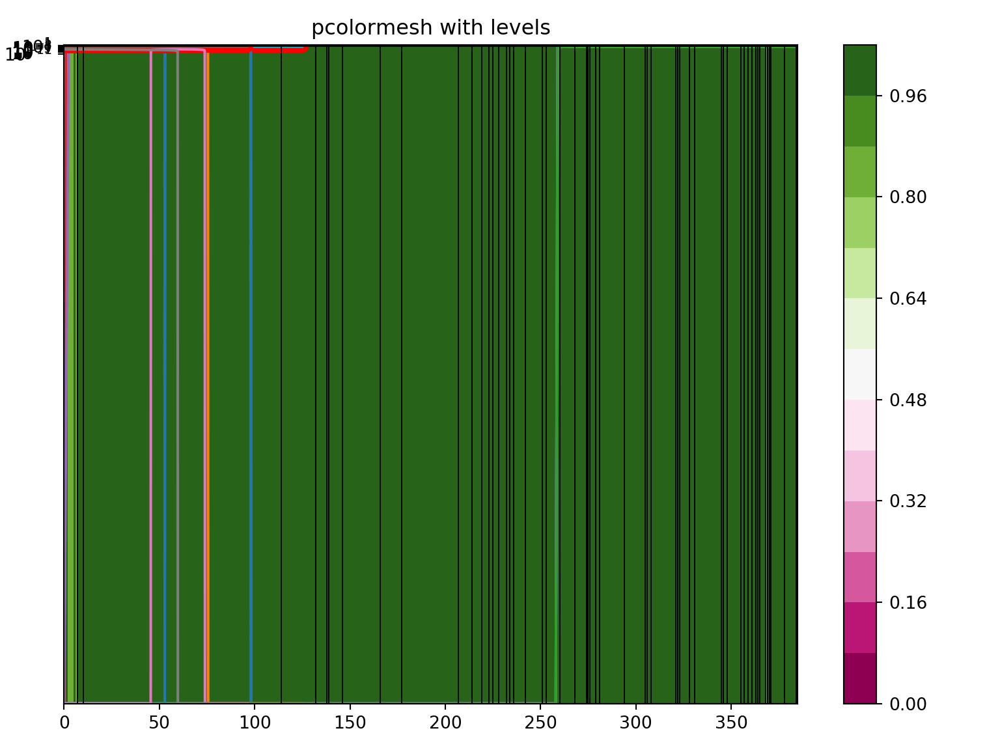

In [1124]:
dists_per_label = get_dists(hists_per_label, canberra_metric, hist_len_3gram_tufano)
drawhist2(ids_per_label, dists_per_label, False, lw=0.7, provided_lines_pos=lines_poses)

OUTDATED

"Remove statement" is close to "Move existing statements in try block"
"Abstract an existing method using the abstract keyword" is close to "Remove statement" (because when we make method
abstract, we delete all method body)

Check 22 and 133/134
      (92 and 30/38)
      
Check 100 and 384
      (573)
573 has a strange label "Move existing statements in try block", but is not related to it

Check 384 and 50
      (573 and 239)

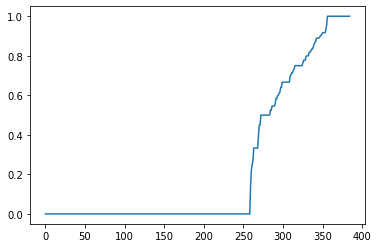

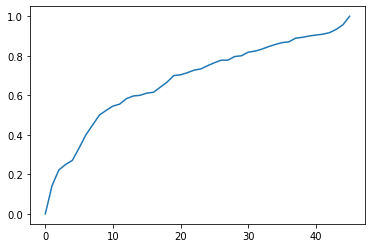

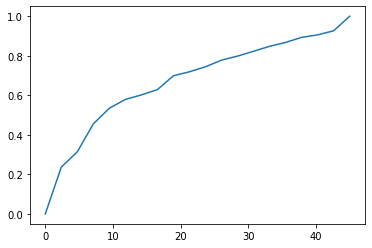

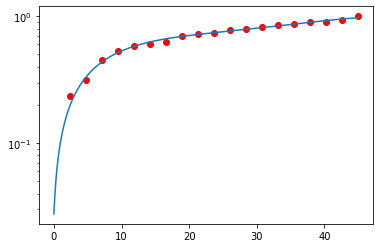

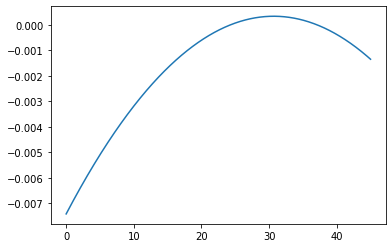

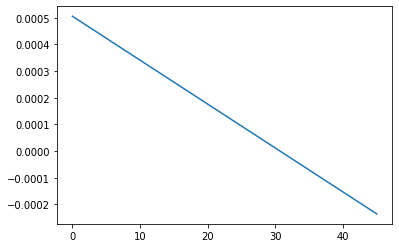

30.689217877115457
Eps = 0.8181818181818182


In [867]:
# Удаление одинаковых значений + Сглаживание 

knn_dists(dists_per_label, 2, smooth_points=20)

In [1005]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.8181, min_samples=2, metric='precomputed').fit(dists_per_label)
print_clustering_results_tufano(tufano_clustering, dists_per_label,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword'

87.696

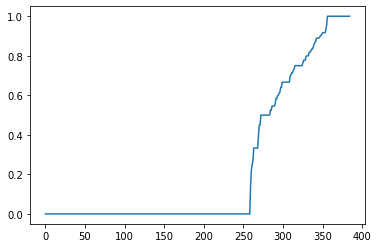

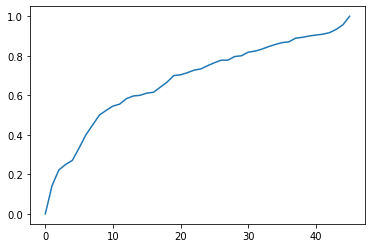

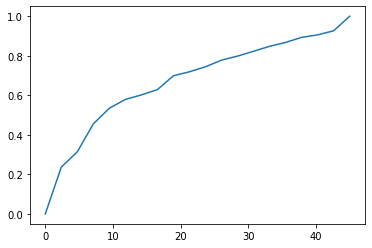

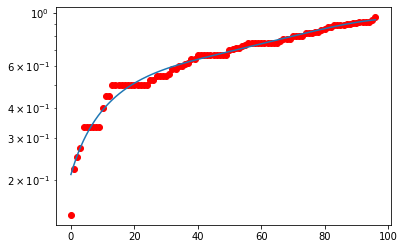

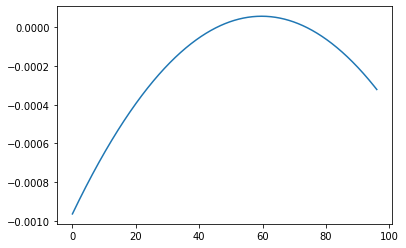

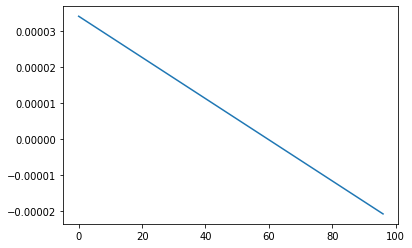

59.67272544740309
Eps = 0.75


In [1006]:
knn_dists(dists_per_label, 2, smooth_points=20)

In [1007]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.75, min_samples=2, metric='precomputed').fit(dists_per_label)
print_clustering_results_tufano(tufano_clustering, dists_per_label, 
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing metho

90.066

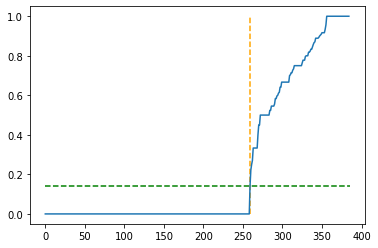

0.14285714285714285
259
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


56 ['Remove condition', 'Remove statement']
56 ['Remove condition', 'Remove statement']


65 ['Remove statement']
135 ['Rem

84.15

In [1019]:
eps, j = choose_eps(dists_per_label, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_per_label)
print_clustering_results_tufano(tufano_clustering, dists_per_label,
                                label_to_changes, from_change_to_labels, ids_per_label)

In [748]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_per_label)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.797
Best rand: 90.211


In [975]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.797, min_samples=2, metric='precomputed').fit(dists_per_label)
print_clustering_results_tufano(tufano_clustering, dists_per_label,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing metho

90.211

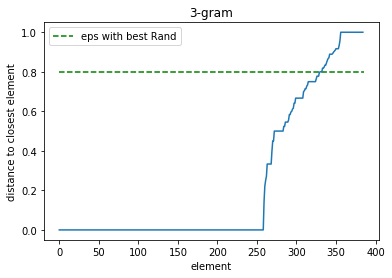

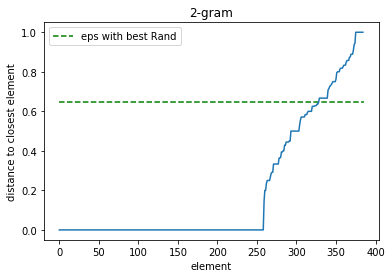

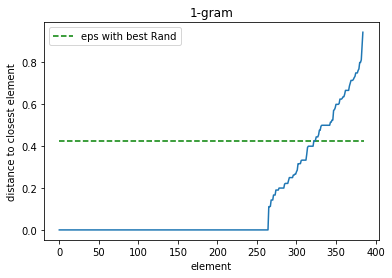

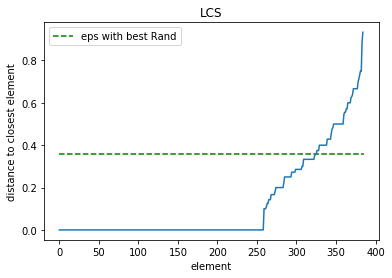

In [1023]:
knn_dists_with_eps_line(dists_per_label, 2, 0.797, "3-gram")
knn_dists_with_eps_line(dists_per_label_2gram, 2, 0.646, "2-gram")
knn_dists_with_eps_line(dists_per_label_1gram, 2, 0.425, "1-gram")
knn_dists_with_eps_line(dists_for_lcs, 2, 0.358, "LCS")

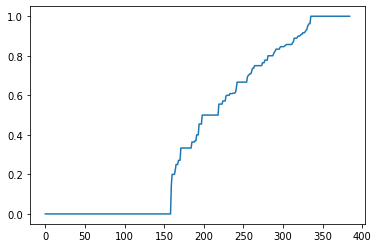

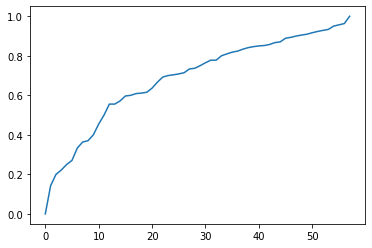

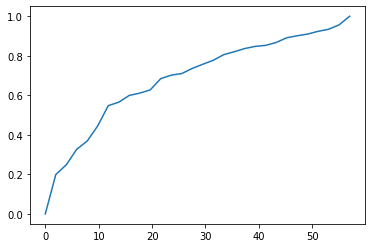

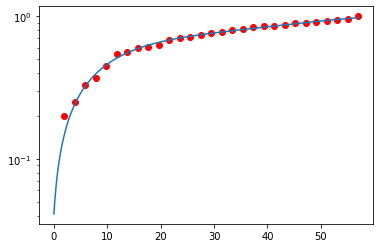

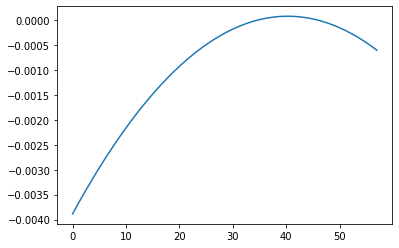

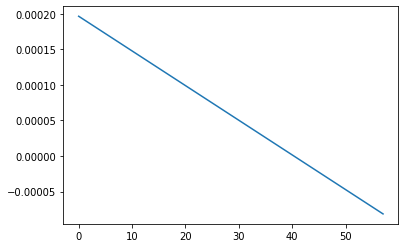

40.292781317275534
Eps = 0.85


In [868]:
knn_dists(dists_per_label, 3, smooth_points=30)

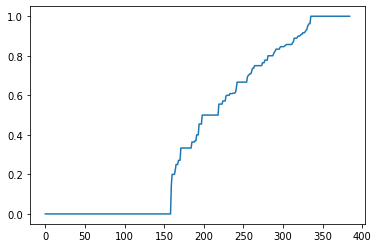

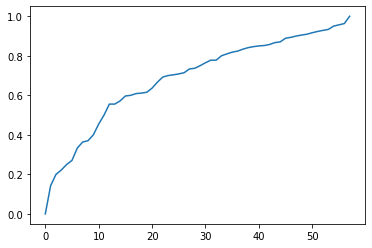

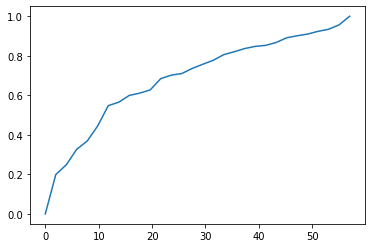

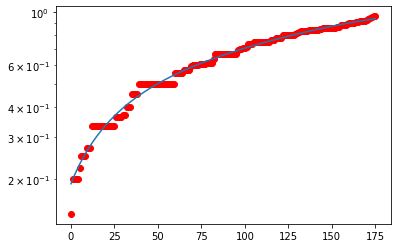

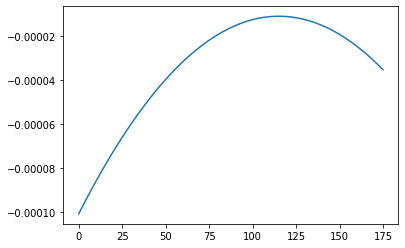

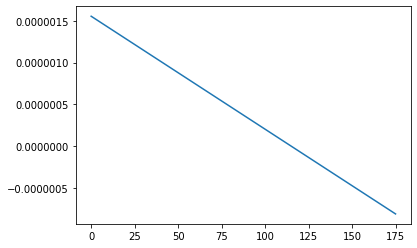

115.09618136306693
Eps = 0.7647058823529411


In [881]:
knn_dists(dists_per_label, 3, smooth_points=30)

In [727]:
# min_samples=3

max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=3, metric='precomputed').fit(dists_per_label)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.797
Best rand: 86.674


In [964]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.797, min_samples=3, metric='precomputed').fit(dists_per_label)
print_clustering_results_tufano(tufano_clustering, dists_per_label, 
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing metho

86.638

In [751]:
# min_samples=1

max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=1, metric='precomputed').fit(dists_per_label)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.455
Best rand: 93.335


In [251]:
RESULTS_FOR_HIST_PATH_TUFANO_2GRAM = "/Volumes/Seagate/Alina/result_for_tufano-2gram"

In [252]:
hist_len_2gram_tufano = None

es_path = RESULTS_FOR_HIST_PATH_TUFANO_2GRAM + "/" + "edit_scripts_2grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_2gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_2gram_tufano)

482


In [441]:
hist_len_example = None

es_path = RESULTS_FOR_HIST_PATH_TUFANO_2GRAM + "/" + "edit_scripts_2grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_example = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_example)

482


In [460]:
hists_per_label_2gram = []

gram_path = "2gram"

for double_num in tqdm_notebook(ids_per_label):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_2GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_per_label_2gram.append(hist_data1)
    hist_file1.close()

<IPython.core.display.Javascript object>


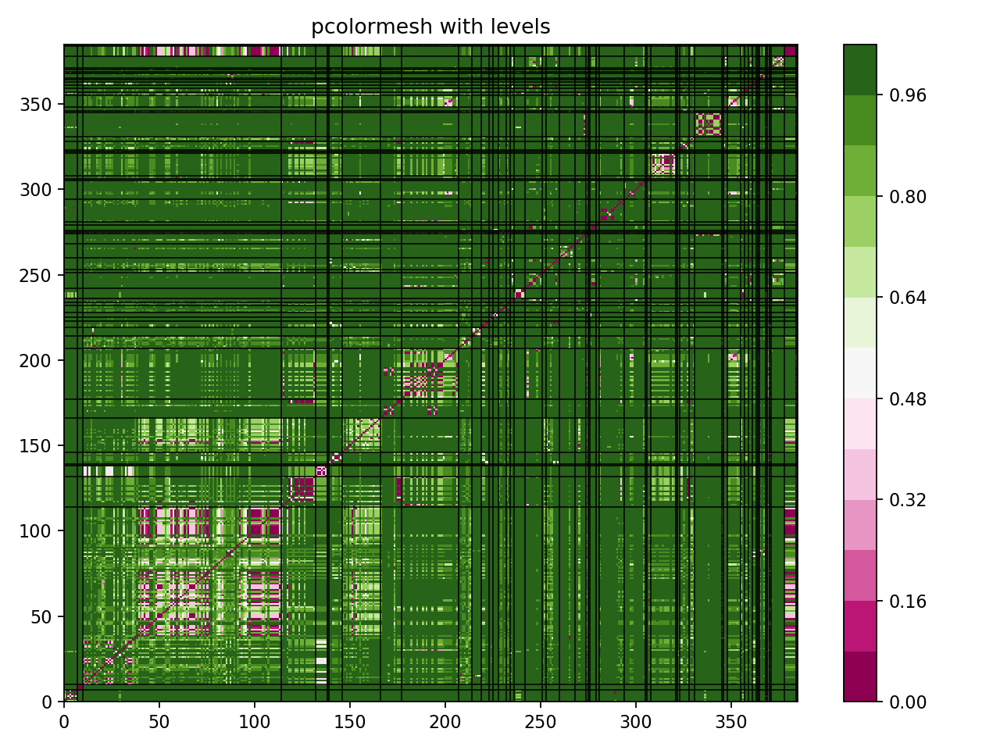

In [461]:
dists_per_label_2gram = get_dists(hists_per_label_2gram, canberra_metric, hist_len_2gram_tufano)
drawhist2(ids_per_label, dists_per_label_2gram, False, lw=0.7, provided_lines_pos=lines_poses)

OUTDATED

Check 302 and 306 ("Change parameter type")
     (339 and 429)
     
В одном примере меняется примитивный тип (int на long), в другом — класс + добавляется ещё один аргумент (поэтому оно ещё и в "Add/Remove parameter") + меняется выражение.

Ещё причина того, что эл-ты одного кластера не близки, — название кластера "Add/Remove parameter".
     

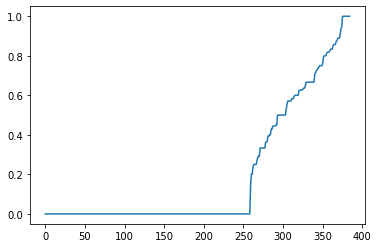

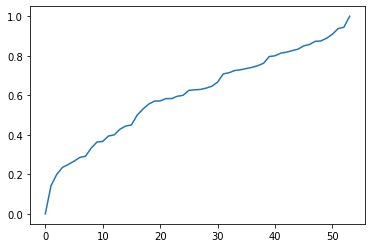

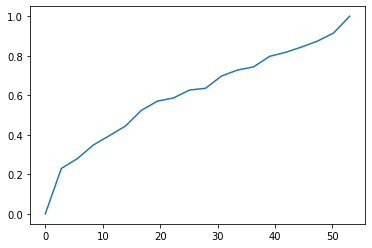

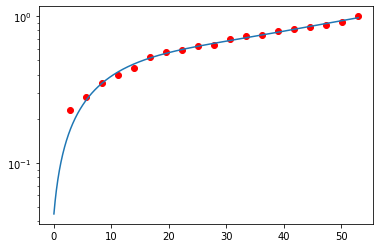

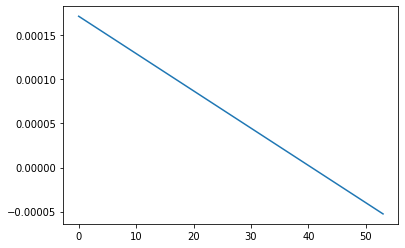

40.56225256152679
Eps = 0.8


In [861]:
knn_dists(dists_per_label_2gram, 2, smooth_points=20)

In [965]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.8, min_samples=2, metric='precomputed').fit(dists_per_label_2gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_2gram, 
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
118 ['Remove statement']
123 ['Remove statement']
57 ['Replace fully qualified name with import or vice versa']
73 ['Replace fully qualified name with import or vice versa']
182 ['Replace fully qualified name with import or vice versa']
195 ['Replace fully qualified name with import or vice versa']
389 ['Replace fully qualified name with import or vice versa']
420 ['Replace fully qualified name with import or vice versa']
206 ['Invoke overridden method instead of inherited one']
541 ['Class is not static anymore. Add object instance to invoke its methods']
464 ['Class becomes static. Delete object instance to invoke its methods']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add brac

68.825

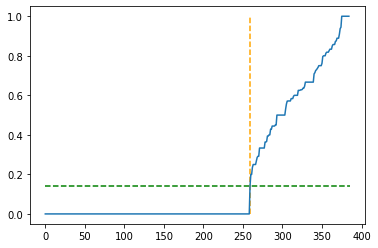

0.14285714285714285
259
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


56 ['Remove condition', 'Remove statement']
56 ['Remove condition', 'Remove statement']


65 ['Remove statement']
135 ['Rem

84.291

In [1020]:
eps, j = choose_eps(dists_per_label_2gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_per_label_2gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_2gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

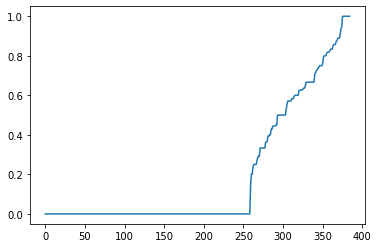

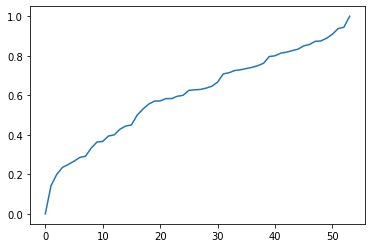

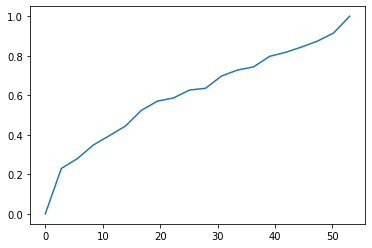

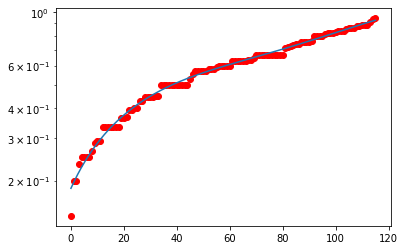

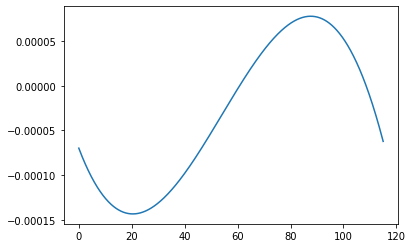

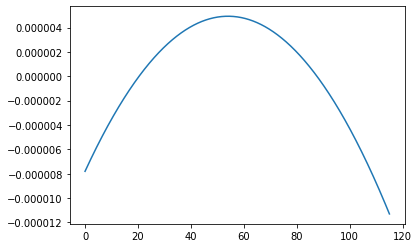

20.411226517604103
Eps = 0.36363636363636365


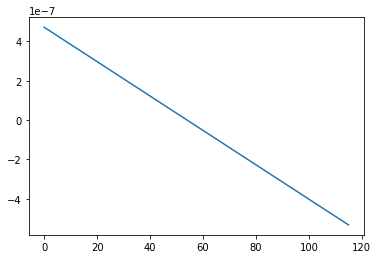

54.015941175018234
Eps = 0.5833333333333334


In [894]:
knn_dists(dists_per_label_2gram, 2, smooth_points=20, for_spline=(10, 5), need_4d=True)

In [967]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.3636, min_samples=2, metric='precomputed').fit(dists_per_label_2gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_2gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition', 'Remove statement']
56 ['Remove condition', 'Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remov

86.536

In [968]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.58333, min_samples=2, metric='precomputed').fit(dists_per_label_2gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_2gram, 
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 [

89.791

In [462]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_per_label_2gram)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.646
Best rand: 90.919


In [998]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.646, min_samples=2, metric='precomputed').fit(dists_per_label_2gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_2gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing metho

90.894

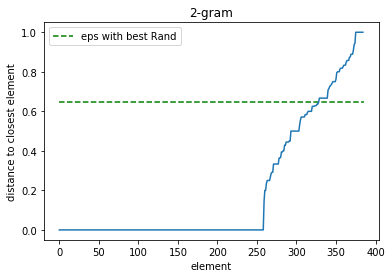

In [999]:
knn_dists_with_eps_line(dists_per_label_2gram, 2, 0.646, "2-gram")

In [247]:
RESULTS_FOR_HIST_PATH_TUFANO_1GRAM = "/Volumes/Seagate/Alina/result_for_tufano-1gram"

In [248]:
hist_len_1gram_tufano = None

es_path = RESULTS_FOR_HIST_PATH_TUFANO_1GRAM + "/" + "edit_scripts_1grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_1gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_1gram_tufano)

244


In [464]:
hists_per_label_1gram = []

gram_path = "1gram"

for double_num in tqdm_notebook(ids_per_label):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_1GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_per_label_1gram.append(hist_data1)
    hist_file1.close()

<IPython.core.display.Javascript object>


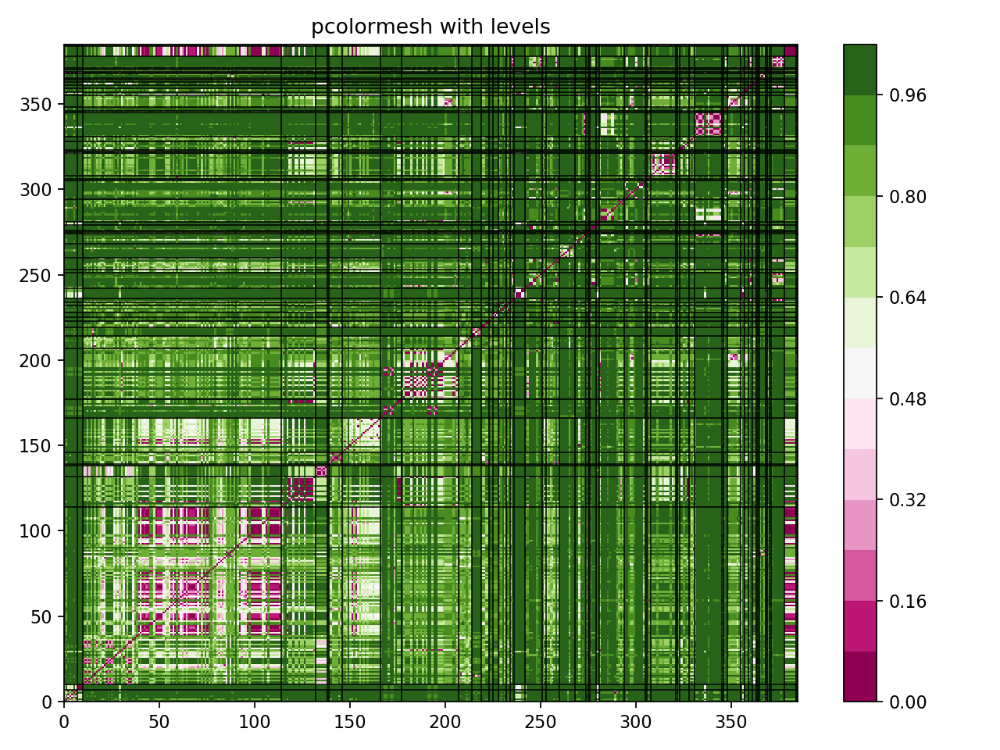

In [465]:
dists_per_label_1gram = get_dists(hists_per_label_1gram, canberra_metric, hist_len_1gram_tufano)
drawhist2(ids_per_label, dists_per_label_1gram, False, lw=0.7, provided_lines_pos=lines_poses)

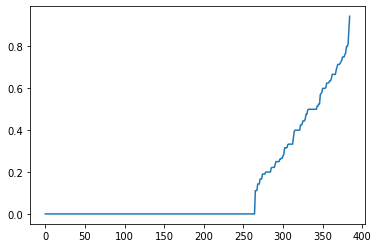

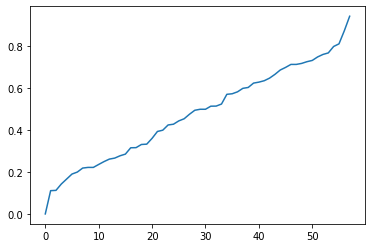

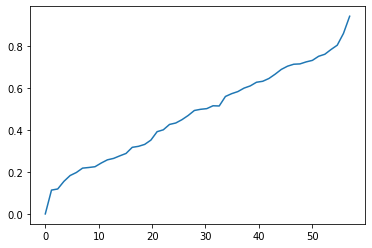

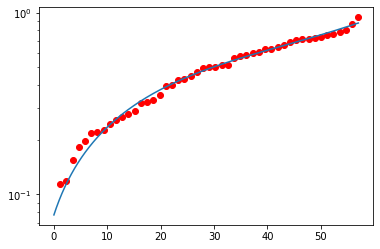

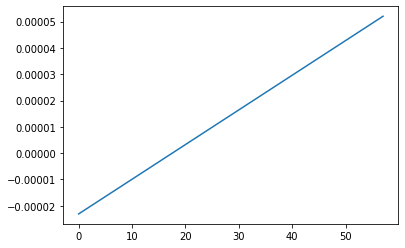

17.53641841458234
Eps = 0.31666666666666665


In [863]:
# Удаление одинаковых значений + сглаживание

knn_dists(dists_per_label_1gram, 2)

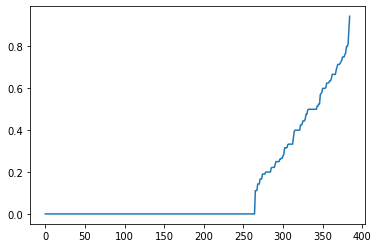

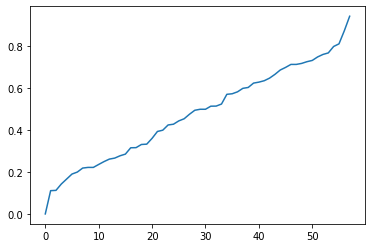

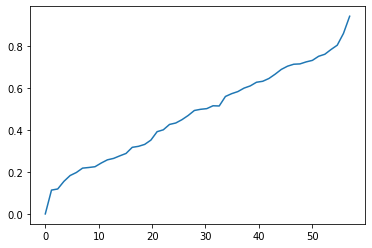

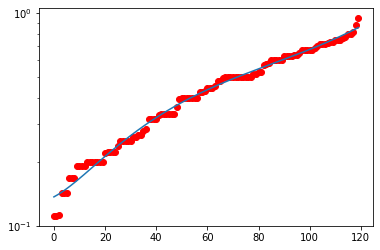

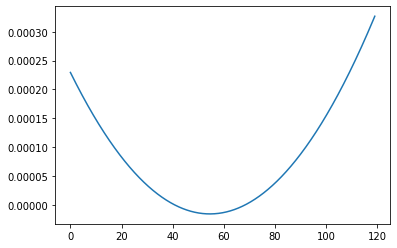

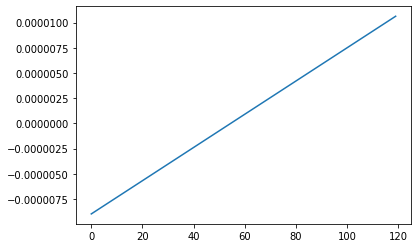

54.53516784934711
Eps = 0.4


In [1008]:
knn_dists(dists_per_label_1gram, 2)

In [1009]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.4, min_samples=2, metric='precomputed').fit(dists_per_label_1gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_1gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method 

91.191

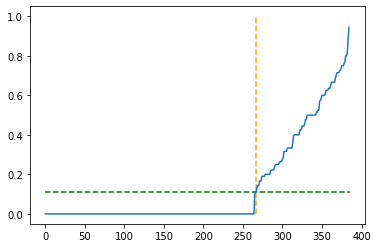

0.1125
267
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


56 ['Remove condition', 'Remove statement']
56 ['Remove condition', 'Remove statement']


65 ['Remove statement']
135 ['Remove statement

85.41

In [1021]:
eps, j = choose_eps(dists_per_label_1gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_per_label_1gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_1gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

In [466]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_per_label_1gram)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.425
Best rand: 91.324


In [1002]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.425, min_samples=2, metric='precomputed').fit(dists_per_label_1gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_1gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method 

91.3

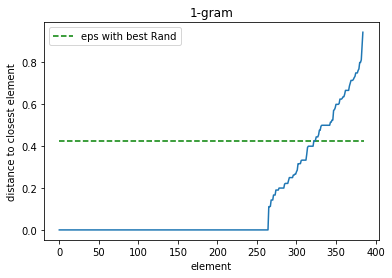

In [1001]:
knn_dists_with_eps_line(dists_per_label_1gram, 2, 0.425, "1-gram")

In [96]:
MAIN_ELEM = '84'
IND = np.where(np.array(ids_per_label) == MAIN_ELEM)[0][0]
IND

NameError: name 'ids_per_label' is not defined

In [1390]:
from_change_to_labels[MAIN_ELEM]

['Remove statement', 'Move existing statements in try block']

In [1391]:
dists_array = dists_per_label.copy()
#dists_array = dists_per_label_2gram.copy()
#dists_array = dists_per_label_1gram.copy()
#dists_array = dists_for_lcs.copy()

ids_per_label_np = np.array(ids_per_label)
inds = np.where(np.array(dists_array[IND]) != 1.0)[0]
ids_per_label_np[inds]

for i in range(len(ids_per_label_np[inds])):
    elem = ids_per_label_np[inds][i]
    dist = dists_array[IND][inds[i]]
    if elem != MAIN_ELEM and len(intersection(from_change_to_labels[MAIN_ELEM], from_change_to_labels[elem])) > 0:
        print(from_change_to_labels[elem], dist)

['Remove statement'] 0.9230769230769231
['Remove statement'] 0.0
['Remove statement'] 0.0
['Remove statement'] 0.5
['Remove statement'] 0.3333333333333333
['Remove statement'] 0.0
['Remove statement'] 0.0
['Remove statement'] 0.5
['Remove statement'] 0.5
['Remove statement'] 0.5
['Remove statement'] 0.8333333333333334
['Remove statement'] 0.8333333333333334
['Remove statement'] 0.3333333333333333
['Remove statement'] 0.7222222222222222
['Remove statement'] 0.0
['Remove statement'] 0.3333333333333333
['Remove statement'] 0.8888888888888888
['Remove statement'] 0.3333333333333333
['Remove statement'] 0.0
['Remove statement'] 0.0
['Remove statement'] 0.5
['Remove statement'] 0.5
['Remove statement'] 0.5
['Remove statement'] 0.3333333333333333
['Remove statement'] 0.0
['Remove statement'] 0.3333333333333333
['Remove statement'] 0.0
['Remove statement', 'Add parameter in the method/constructor invocation'] 0.9
['Remove statement'] 0.9
['Remove statement'] 0.6666666666666666
['Remove stateme

In [1374]:
len(label_to_changes['Move existing statements in try block'])

6

In [ ]:
#625 625 ['Remove statement', 'Move existing statements in try block']

84 84
172 172
205 205
431 431

In [ ]:
hists_per_label_1gram hist_len_1gram_tufano
hists_per_label_2gram hist_len_2gram_tufano
hists_per_label hist_len_3gram_tufano

In [1114]:
print(hist_len_1gram_tufano)
print(hist_len_2gram_tufano)
print(hist_len_3gram_tufano)
print(len(hists_per_label_1gram))
print(len(hists_per_label_2gram))
print(len(hists_per_label))

244
482
607
385
385
385


In [1117]:
concat_hists = []

num_changes = len(hists_per_label_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_per_label_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_per_label_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_tufano, amount))
        
    for gram_ind, amount in hists_per_label[i]:
        concat_hist.append((gram_ind + hist_len_1gram_tufano + hist_len_2gram_tufano, amount))
    
    concat_hists.append(concat_hist)


In [1118]:
concat_hists

[[(20, 1),
  (28, 1),
  (34, 1),
  (39, 1),
  (43, 2),
  (272, 1),
  (319, 1),
  (442, 1),
  (583, 1),
  (626, 1),
  (781, 1),
  (1085, 1),
  (1134, 1),
  (1173, 1)],
 [(4, 1),
  (5, 1),
  (43, 1),
  (79, 1),
  (108, 1),
  (563, 1),
  (564, 1),
  (616, 1),
  (667, 1),
  (1054, 1),
  (1193, 1),
  (1208, 1)],
 [(20, 1),
  (28, 1),
  (39, 1),
  (43, 1),
  (272, 1),
  (319, 1),
  (374, 1),
  (781, 1),
  (870, 1)],
 [(20, 1),
  (28, 1),
  (38, 1),
  (43, 1),
  (85, 1),
  (272, 1),
  (319, 1),
  (553, 1),
  (610, 1),
  (781, 1),
  (1001, 1),
  (1281, 1)],
 [(20, 1),
  (28, 1),
  (39, 1),
  (43, 1),
  (272, 1),
  (319, 1),
  (374, 1),
  (781, 1),
  (870, 1)],
 [(4, 1), (34, 1), (43, 1), (442, 1), (511, 1), (1106, 1)],
 [(20, 1),
  (28, 1),
  (39, 1),
  (43, 1),
  (272, 1),
  (319, 1),
  (374, 1),
  (781, 1),
  (870, 1)],
 [(20, 1), (28, 1), (77, 1), (365, 1), (390, 1), (863, 1)],
 [(20, 1), (28, 1), (77, 1), (365, 1), (390, 1), (863, 1)],
 [(20, 1), (28, 1), (77, 1), (365, 1), (390, 1), (863,

In [1119]:
concat_hists_len = hist_len_1gram_tufano + hist_len_2gram_tufano + hist_len_3gram_tufano

<IPython.core.display.Javascript object>


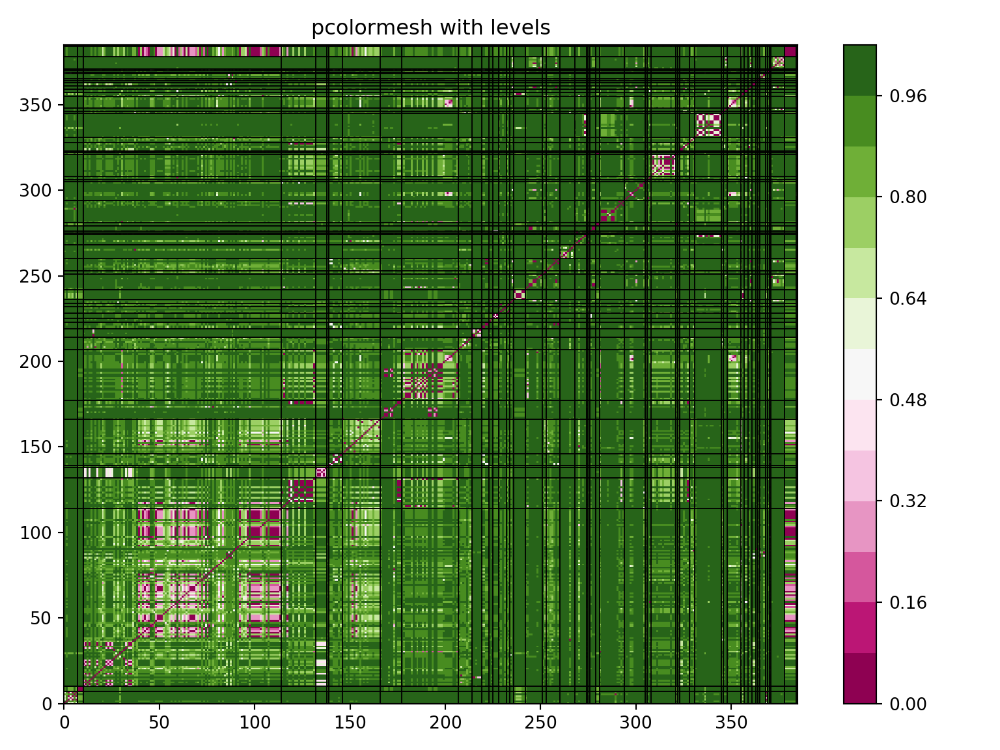

In [1120]:
dists_per_label_all_gram = get_dists(concat_hists, canberra_metric, concat_hists_len)
drawhist2(ids_per_label, dists_per_label_all_gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [1122]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_per_label_all_gram)
    rand = print_clustering_results_tufano(tufano_clustering,
                                           dists_per_label_all_gram,
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.636
Best rand: 90.77


In [1131]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.636, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_per_label_all_gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_all_gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword'

90.77

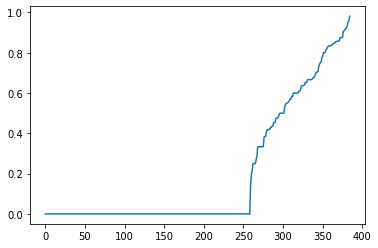

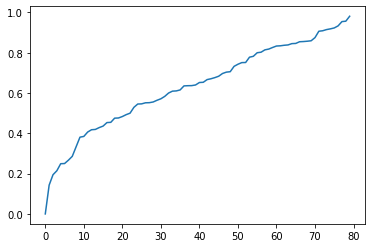

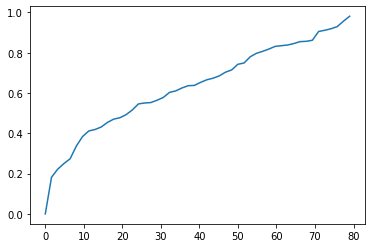

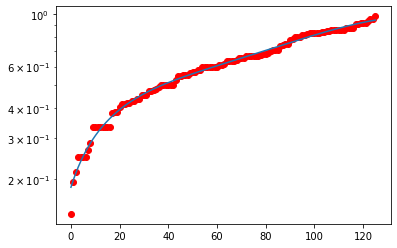

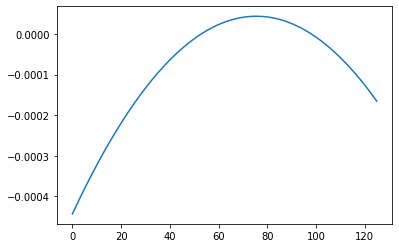

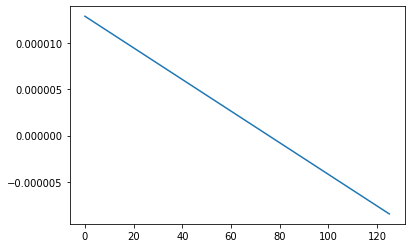

75.50425612500132
Eps = 0.6666666666666666


In [1138]:
knn_dists(dists_per_label_all_gram, 2)

In [1139]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6666666666666666, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_per_label_all_gram)
print_clustering_results_tufano(tufano_clustering, dists_per_label_all_gram,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword'

89.046

<IPython.core.display.Javascript object>


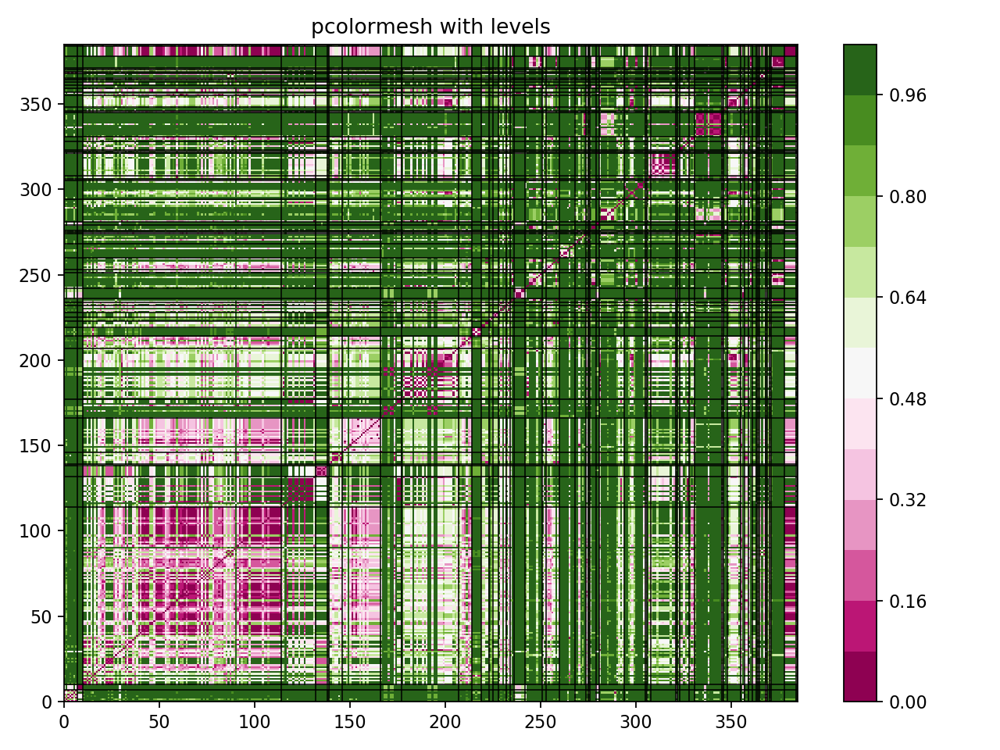

In [489]:
# Just researching the Pearson correlation distance

dists_per_label_1gram_pearson = get_dists(hists_per_label_1gram, pearsons_correlation, hist_len_1gram_tufano)
drawhist2(ids_per_label, dists_per_label_1gram_pearson, False, lw=0.7, provided_lines_pos=lines_poses)

In [512]:
cur_dists = np.array(dists_per_label_1gram_pearson)

print(np.argmax(cur_dists))
print(np.max(cur_dists))

print(2149 // cur_dists.shape[1])
print(2149 % cur_dists.shape[1])
print(cur_dists[5][224])
print(hists_per_label_1gram[5])
print(hists_per_label_1gram[224])

2149
1.0000230782200972
5
224
1.0000230782200972
[(4, 1), (34, 1), (43, 1)]
[(0, 1), (8, 1), (14, 1), (36, 1), (65, 1), (92, 1), (105, 1), (117, 1), (135, 1), (147, 1), (186, 1), (198, 1), (206, 1), (207, 1), (218, 1)]


In [523]:
h1 = [(0, 1), (8, 1), (14, 1), (36, 1), (65, 1), (92, 1), (105, 1), 
      (117, 1), (135, 1), (147, 1), (186, 1), (198, 1), (206, 1), 
      (207, 1), (218, 1), (298, 1), (301, 1)]

'''
h2 = [(1, 1), (9, 1), (15, 1), (37, 1), (66, 1), (93, 1), (106, 1), 
      (118, 1), (136, 1), (148, 1), (188, 1), (199, 1), (209, 1), 
      (210, 1), (219, 1)]
'''

h2 = [(1, 1)]

pearsons_correlation(h1, h2, hist_len_1gram_tufano)

1.0000375477663686

In [524]:
max_rand = 0
best_eps = -1

MAX_EPS = np.max(np.array(dists_per_label_1gram_pearson))

for eps in tqdm_notebook(np.arange(0.001, MAX_EPS, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_per_label_1gram_pearson)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.113
Best rand: 90.078


<IPython.core.display.Javascript object>


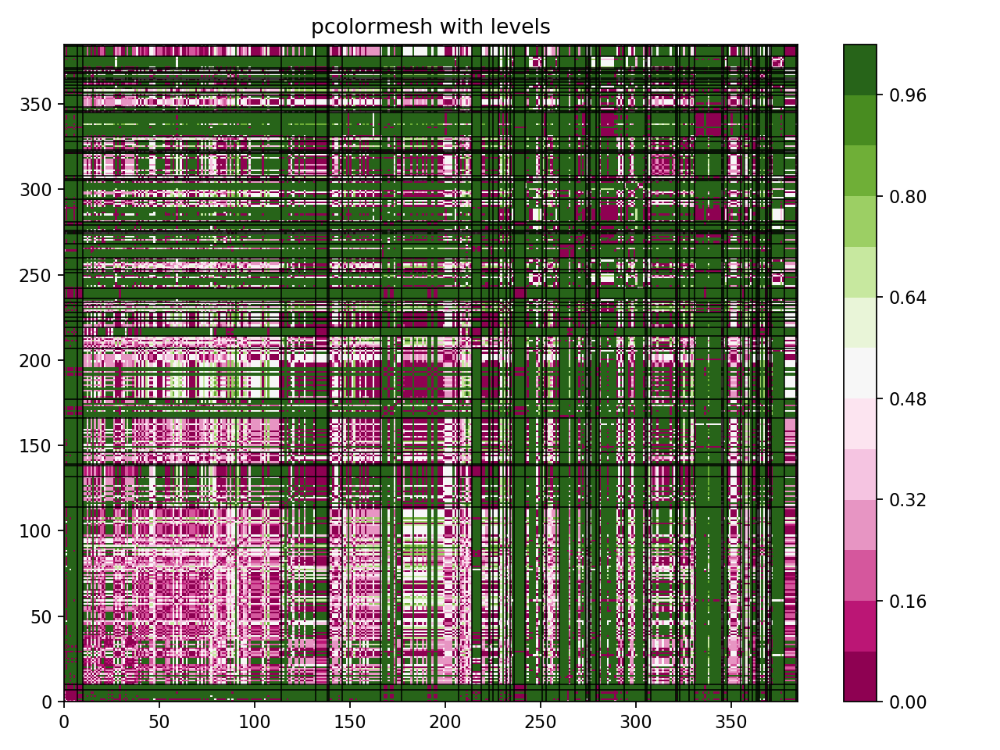

In [525]:
# Just trying to run with Jaccard distance

dists_per_label_1gram_jaccard = get_dists(hists_per_label_1gram, jaccard_metric, hist_len_1gram_tufano)
drawhist2(ids_per_label, dists_per_label_1gram_jaccard, False, lw=0.7, provided_lines_pos=lines_poses)

In [526]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_per_label_1gram_jaccard)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.001
Best rand: 15.172


<IPython.core.display.Javascript object>


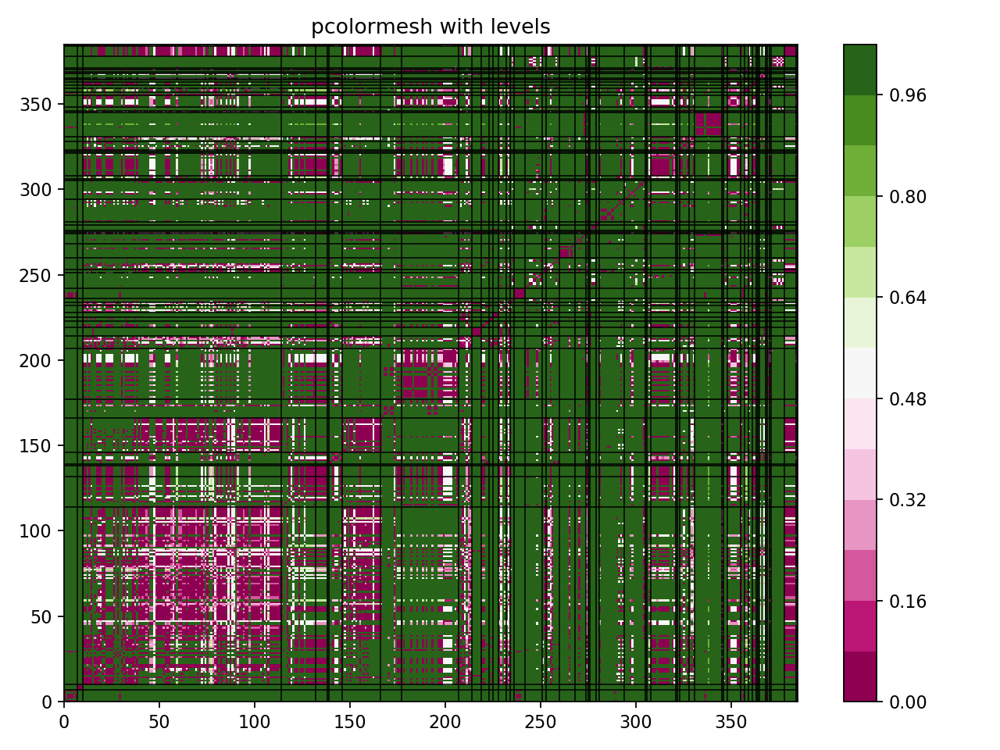

In [528]:
dists_per_label_2gram_jaccard = get_dists(hists_per_label_2gram, jaccard_metric, hist_len_2gram_tufano)
drawhist2(ids_per_label, dists_per_label_2gram_jaccard, False, lw=0.7, provided_lines_pos=lines_poses)

In [529]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_per_label_2gram_jaccard)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.001
Best rand: 47.964


<IPython.core.display.Javascript object>


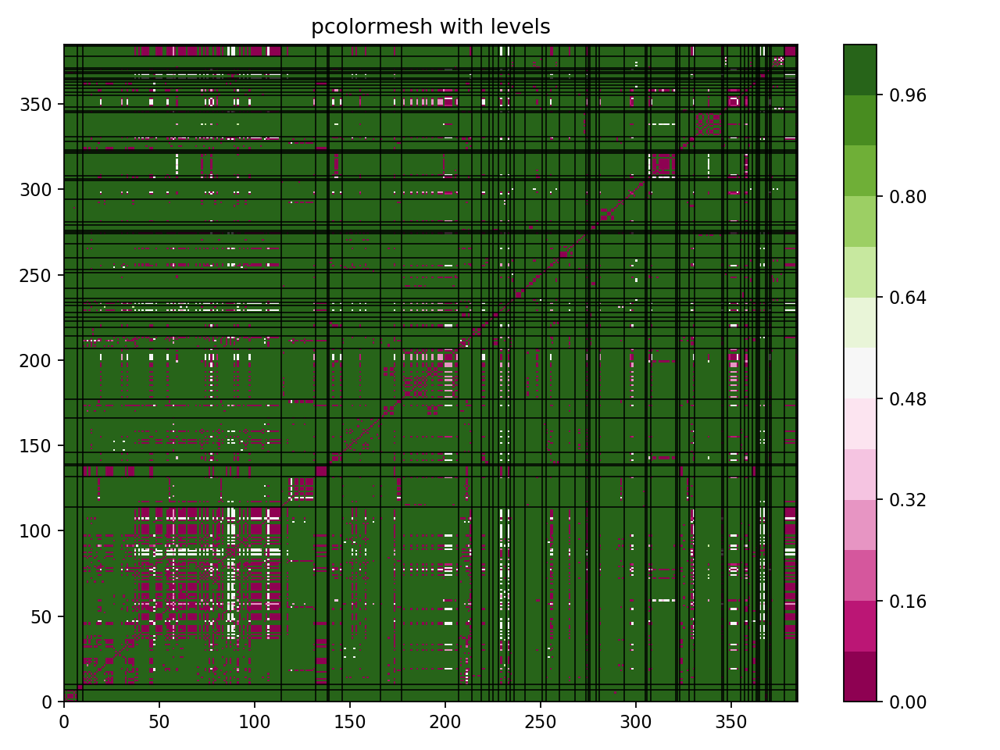

In [531]:
dists_per_label_3gram_jaccard = get_dists(hists_per_label, jaccard_metric, hist_len_3gram_tufano)
drawhist2(ids_per_label, dists_per_label_3gram_jaccard, False, lw=0.7, provided_lines_pos=lines_poses)

In [532]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_per_label_3gram_jaccard)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.001
Best rand: 65.687


In [126]:
def lcs(X, Y): 
    # find the length of the strings 
    m = len(X) 
    n = len(Y) 
  
    # declaring the array for storing the dp values 
    L = [[None]*(n + 1) for i in range(m + 1)] 
  
    """Following steps build L[m + 1][n + 1] in bottom up fashion 
    Note: L[i][j] contains length of LCS of X[0..i-1] 
    and Y[0..j-1]"""
    for i in range(m + 1): 
        for j in range(n + 1): 
            if i == 0 or j == 0 : 
                L[i][j] = 0
            elif X[i-1] == Y[j-1]: 
                L[i][j] = L[i-1][j-1]+1
            else: 
                L[i][j] = max(L[i-1][j], L[i][j-1]) 
  
    # L[m][n] contains the length of LCS of X[0..n-1] & Y[0..m-1] 
    return L[m][n] 

In [438]:
TUFANO_ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoActions"

In [474]:
edit_scripts = []

for double_num in tqdm_notebook(ids_per_label):
    actions_file = open(TUFANO_ACTIONS_PATH + "/" + double_num + "/" + double_num + "/" + "sampleChange1")
    edit_script = actions_file.read().split("\n")
    edit_script = [elem for elem in edit_script if elem != '']
    
    edit_scripts.append(edit_script)
    actions_file.close()


In [480]:
dists_for_lcs = []

for es1 in edit_scripts:
    cur_dists = []
    for es2 in edit_scripts:
        cur_lcs = lcs(es1, es2)
        dist = 1 - cur_lcs / max(len(es1), len(es2))
        cur_dists.append(dist)
    dists_for_lcs.append(cur_dists)

<IPython.core.display.Javascript object>


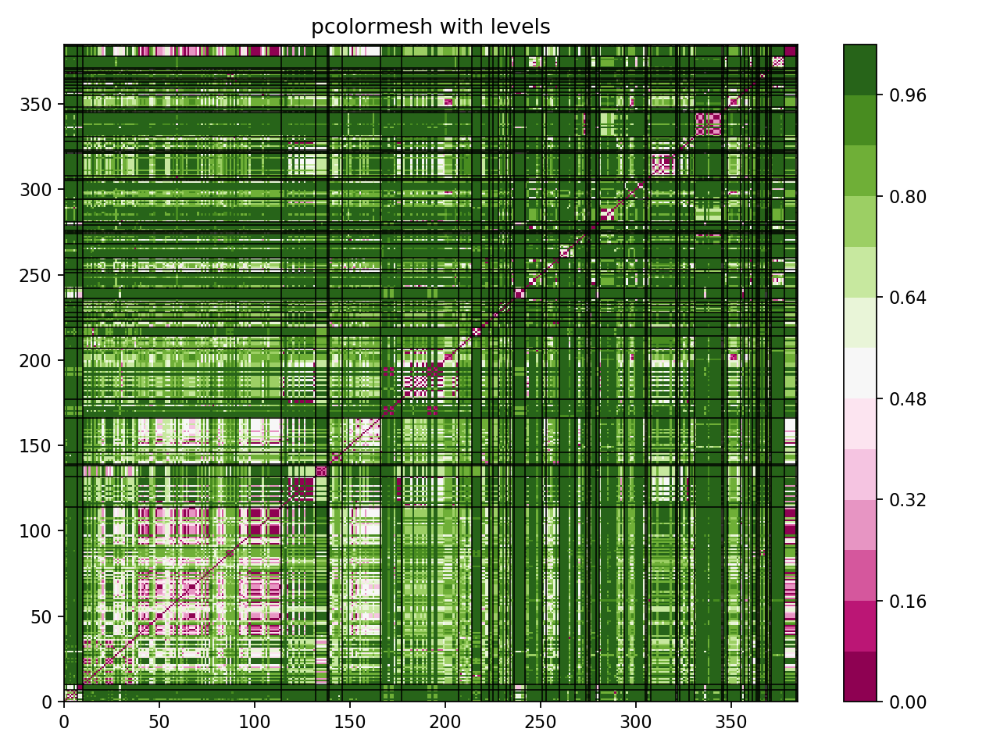

In [481]:
drawhist2(ids_per_label, dists_for_lcs, False, lw=0.7, provided_lines_pos=lines_poses)

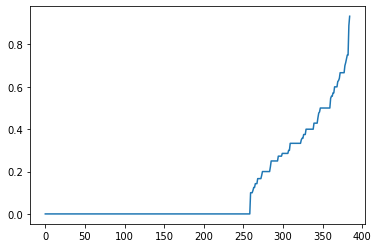

In [735]:
knn_dists(dists_for_lcs, 2)

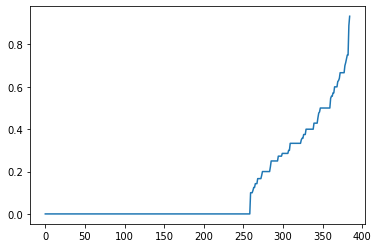

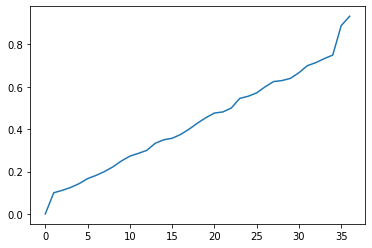

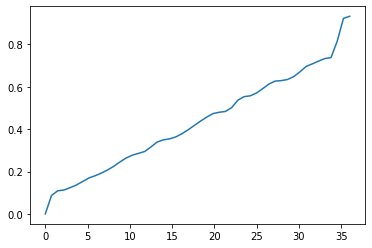

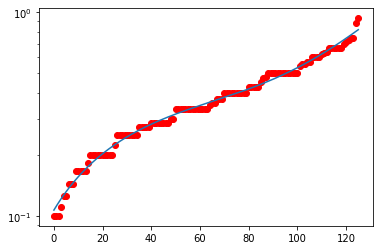

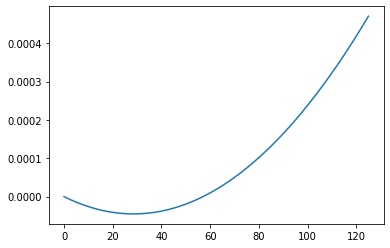

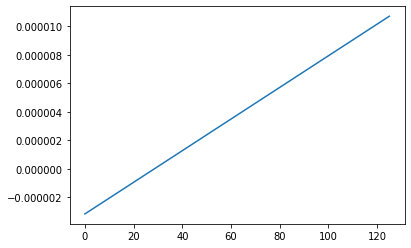

28.535303072261776
Eps = 0.25


In [885]:
knn_dists(dists_for_lcs, 2)

In [972]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.25, min_samples=2, metric='precomputed').fit(dists_for_lcs)
print_clustering_results_tufano(tufano_clustering, dists_for_lcs,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition', 'Remove statement']
56 ['Remove condition', 'Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']
445 ['Move

87.946

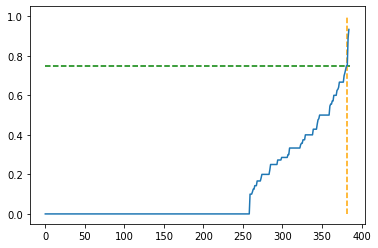

0.75
382
CLUSTERS:

1 ['Add braces to if statement']
392 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
441 ['Add braces to if statement', 'Replace invoked method']
468 ['Add braces to if statement', 'Remove finally from try/catch']
2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
3 ['Remove statement']
9 ['Remove statement']
16 ['Remove statement']
35 ['Remove statement']
41 ['Remove statement']
53 ['Remove statement']
56 ['Remove condition', 'Remove statement']
59 ['Remove statement']
61 ['Remove statement']
65 ['Remove statement']
69 ['Remove statement']
80 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
111 ['Remove statement']
118 ['Remove statement']
121 ['Remove statement']
123 ['Remove statement']
125 ['Replace invoked method', 'Remov

19.147

In [1022]:
eps, j = choose_eps(dists_for_lcs, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_for_lcs)
print_clustering_results_tufano(tufano_clustering, dists_for_lcs,
                                label_to_changes, from_change_to_labels, ids_per_label)

In [758]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_for_lcs)
    rand = print_clustering_results_tufano(tufano_clustering, 
                                           label_to_changes, 
                                           from_change_to_labels, 
                                           ids_per_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.358
Best rand: 90.009


In [1004]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.358, min_samples=2, metric='precomputed').fit(dists_for_lcs)
print_clustering_results_tufano(tufano_clustering, dists_for_lcs,
                                label_to_changes, from_change_to_labels, ids_per_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement', 'Remove finally from try/catch']
468 ['Add braces to if statement', 'Remove finally from try/catch']


441 ['Add braces to if statement', 'Replace invoked method']
441 ['Add braces to if statement', 'Replace invoked method']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
57 ['Replace fully qualified name with import or vice versa']
73 ['Replace fully qualified name with import or vice versa']
182 ['Replace fully qualified name with import or vice versa']
195 ['Replace fully qualified name with import or vice versa']
389 ['Replace fully qualified name with import or vice versa']
420 ['Replace fully qualified name with import or vice versa']
119 ['Broad method visibility']
286 ['Broad method visibility']
194 ['Narrow method visibility']
541 ['Class i

90.009

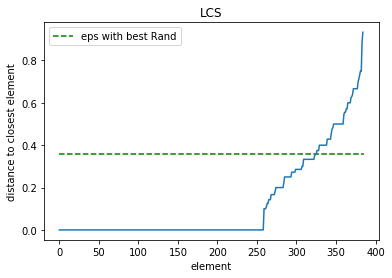

In [1003]:
knn_dists_with_eps_line(dists_for_lcs, 2, 0.358, "LCS")

# The same Tufano dataset, but each change has only 1 label

In [1419]:
TUFANO_DATASET_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoDataset"

unique_label_to_changes = collections.defaultdict(list)
from_change_to_unique_label = collections.defaultdict(list)

num_multiple = 0

for double_num in tqdm_notebook(sorted_dirs):
    change_id = double_num.split(" ")[0]
    label_file = open(TUFANO_DATASET_PATH + "/" + change_id + "/" + "label.txt")
    labels = label_file.read().split(",")
    label = ""
    
    #if 'Remove finally from try/catch' in labels:
    #    print(double_num, labels)
    
    if len(labels) > 1:
        num_multiple += 1
        final_label_file = open(TUFANO_DATASET_PATH + "/" + change_id + "/" + "final_label.txt")
        final_label = final_label_file.read()
        label = final_label
        #print(double_num, final_label)
    else:
        label = labels[0]
    
    #print(double_num, label)
        
    if label != "" and label != 'unclear':
        unique_label_to_changes[label].append(change_id)
        from_change_to_unique_label[change_id].append(label)
    
    label_file.close()
    
print(num_multiple)


38


In [1404]:
print("NUM CLASSES:", len(unique_label_to_changes))

NUM CLASSES: 51


In [1405]:
print("NUM CLASSES:", len(label_to_changes))

NUM CLASSES: 54


In [ ]:
#sorted(unique_label_to_changes.keys())[]

In [1410]:
for lbl in label_to_changes.keys():
    if lbl not in unique_label_to_changes:
        print(lbl)

Change parameters order in method invocation
Rename parameter
Remove finally from try/catch


In [1416]:
ids_per_unique_label = []
unique_lines_poses = []
cur_sum = 0
all_unique_labels = []

for label in unique_label_to_changes:
    all_unique_labels.append(label)
    for change in unique_label_to_changes[label]:
        ids_per_unique_label.append(change)
        cur_sum += 1
    unique_lines_poses.append(cur_sum)

In [1417]:
for i in range(len(ids_per_unique_label)):
    print("On index", i, ids_per_unique_label[i])

On index 0 1
On index 1 392
On index 2 395
On index 3 409
On index 4 426
On index 5 441
On index 6 468
On index 7 2
On index 8 45
On index 9 466
On index 10 3
On index 11 9
On index 12 16
On index 13 35
On index 14 41
On index 15 53
On index 16 59
On index 17 61
On index 18 65
On index 19 69
On index 20 80
On index 21 92
On index 22 93
On index 23 97
On index 24 110
On index 25 111
On index 26 118
On index 27 121
On index 28 123
On index 29 125
On index 30 132
On index 31 133
On index 32 135
On index 33 137
On index 34 138
On index 35 149
On index 36 167
On index 37 193
On index 38 197
On index 39 200
On index 40 203
On index 41 210
On index 42 211
On index 43 214
On index 44 224
On index 45 227
On index 46 231
On index 47 234
On index 48 235
On index 49 239
On index 50 241
On index 51 249
On index 52 250
On index 53 251
On index 54 260
On index 55 261
On index 56 273
On index 57 274
On index 58 275
On index 59 289
On index 60 292
On index 61 295
On index 62 296
On index 63 305
On inde

In [1418]:
len(ids_per_unique_label)

347

In [1421]:
for i in range(len(unique_lines_poses)):
    if i == 0:
        print("From 0 to", unique_lines_poses[i], all_unique_labels[i])
    else:
        print("From", unique_lines_poses[i - 1], "to", unique_lines_poses[i], all_unique_labels[i])

From 0 to 7 Add braces to if statement
From 7 to 10 Forbid overriding: add final to method
From 10 to 105 Remove statement
From 105 to 123 Remove parameter from the method invocation
From 123 to 129 Abstract an existing method using the abstract keyword
From 129 to 130 Move synchronized keyword from method signature to code block or vice versa
From 130 to 137 Merge variable definition & initialization
From 137 to 157 Remove invoked method
From 157 to 178 Add/Remove parameter
From 178 to 185 Remove condition
From 185 to 190 Move existing statements out of try block
From 190 to 194 Remove redundant initialization
From 194 to 196 Add/Remove synchronized keyword from variable
From 196 to 199 Add/Remove this qualifier
From 199 to 200 Remove thrown exception
From 200 to 202 Rename variable
From 202 to 208 Replace fully qualified name with import or vice versa
From 208 to 214 Change return type
From 214 to 216 Change method invocation as result of a move method
From 216 to 220 Replace stateme

In [604]:
def print_clustering_results_tufano_unique_old(clustering, dists, unique_label_to_changes, 
                                    from_change_to_unique_label, ids_per_unique_label, 
                                    without_outliers,
                                    to_print=True):
    clusters = collections.defaultdict(list)
    clusters_to_ids = collections.defaultdict(list)
    outliers = []
    num_changes = len(clustering.labels_)
    
    for i in range(len(clustering.labels_)):
        label = clustering.labels_[i]
        change = ids_per_unique_label[i]
        if label == -1:
            outliers.append(change)
        else:
            clusters[label].append(change)
            clusters_to_ids[label].append(i)
            
    #num_inliers = num_changes - len(outliers)        
            
    cohesion = 0
    separation = 0
    g1 = 0
    MAX_DIST = np.array(dists).max()
    for i in range(len(clusters_to_ids)):
        coef = 0
        for xi in range(len(clusters_to_ids[i])):
            for yi in range(len(clusters_to_ids[i])):
                if xi < yi:
                    x = clusters_to_ids[i][xi]
                    y = clusters_to_ids[i][yi]
                    coef += MAX_DIST - dists[x][y]
                    
        cohesion += (1 / len(clusters_to_ids[i])) * coef
        coef_for_sep = len(clusters_to_ids[i]) / np.sqrt(coef)
        coef = 1 / coef
        
        summ = 0
        for j in range(len(clusters_to_ids)):
            if i == j:
                continue
                
            for xi in range(len(clusters_to_ids[i])):
                for yi in range(len(clusters_to_ids[j])):
                    x = clusters_to_ids[i][xi]
                    y = clusters_to_ids[j][yi]
                    summ += MAX_DIST - dists[x][y]
        
        g1 += coef * summ
        separation += coef_for_sep * summ
        
        
    #final_init_labels = dict()
        
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    
    for i in range(len(clustering.labels_)):
        change_i = ids_per_unique_label[i]
        init_label_i = from_change_to_unique_label[change_i][0]
        after_label_i = clustering.labels_[i]
        
        for j in range(len(clustering.labels_)):
            change_j = ids_per_unique_label[j]
            init_label_j = from_change_to_unique_label[change_j][0]
            after_label_j = clustering.labels_[j]
            
            if i >= j:
                continue
                
            if (without_outliers and (after_label_i == -1 or after_label_j == -1)):
                continue
            
            if init_label_i == init_label_j:
                if after_label_i == after_label_j:
                    tp += 1
                else:
                    fp += 1
            else:
                if after_label_i == after_label_j:
                    tn += 1
                else:
                    fn += 1
                    
                    
    
    confusion_mtx = []
    for i in range(len(clusters_to_ids)):
        mtx_row = collections.defaultdict(int)
        
        for change_i in clusters_to_ids[i]:
            change = ids_per_unique_label[change_i]
            init_label = from_change_to_unique_label[change][0]
            mtx_row[init_label] += 1
        
        confusion_mtx.append(mtx_row)
        
    ENTROPY = 0
    PURITY = 0
    entropies = []
    purities = []
    Fs = collections.defaultdict(list)
    for i in range(len(clusters_to_ids)):
        entropy = 0
        purity = 0
        
        for init_lbl in unique_label_to_changes:
            pij = confusion_mtx[i][init_lbl] / len(clusters_to_ids[i])
            precision = pij
            recall = confusion_mtx[i][init_lbl] / len(unique_label_to_changes[init_lbl])
            
            if pij != 0:
                entropy += - pij * np.log2(pij)
            purity = max(purity, pij)
            
            fij = 0
            if precision != 0 or recall != 0:
                fij = (2 * precision * recall) / (precision + recall)
            Fs[init_lbl].append(fij)
        
        ENTROPY += entropy * len(clusters_to_ids[i]) / num_changes
        entropies.append(round(entropy, 3))
        
        PURITY += purity * len(clusters_to_ids[i]) / num_changes
        purities.append(round(purity, 3))
        
    Fmeasure = 0
    for init_lbl in unique_label_to_changes:
        Fmeasure += max(Fs[init_lbl]) * len(unique_label_to_changes[init_lbl]) / num_changes
            
    
    rand = round(100 * (tp + fn) / (tp + tn + fp + fn), 3)
    jaccard_rand = round(100 * tp / (tp + tn + fp), 3)
    outl_percent = round(100 * len(outliers) / num_changes, 3)
    
    
    if (to_print):
        print("CLUSTERS:\n")

        for i in range(len(clusters)):
            for change in clusters[i]:
                print(change, from_change_to_unique_label[change])
            print("\n")
        print("Number of clusters:", len(clusters))
        print("Number of outliers:", str(len(outliers)) + "/" + str(num_changes), "(" + str(outl_percent) + "%)")
        
        print()
        print("Cohesion =", str(cohesion))
        print("Separation =", str(separation))
        print("G1 =", str(g1))
        
        print()
        print("Entropy =", str(round(ENTROPY, 6)))
        print("Purity =", str(round(PURITY, 6)))
        pairs = [(entropies[i], purities[i]) for i in range(len(entropies))]
        print("(entropy, purity):", pairs)
        print("F-measure =", round(Fmeasure, 6))
        
        print()
        print("Rand =", str(rand) + "%")
        print("Jaccard Index =", str(jaccard_rand) + "%")
            
    
    return rand, Fmeasure
    
    

In [129]:
def print_clustering_results_tufano_unique(clustering, dists, unique_label_to_changes, 
                                    from_change_to_unique_label, ids_per_unique_label, 
                                    without_outliers,
                                    to_print=True):
    clusters = collections.defaultdict(list)
    clusters_to_ids = collections.defaultdict(list)
    outliers = []
    num_changes = len(clustering.labels_)
    
    for i in range(len(clustering.labels_)):
        label = clustering.labels_[i]
        change = ids_per_unique_label[i]
        if label == -1:
            outliers.append(change)
        else:
            clusters[label].append(change)
            clusters_to_ids[label].append(i)
    
    # For Agglomerative
    clusters_list = list(clusters_to_ids.keys())
    for label in clusters_list:
        if len(clusters_to_ids[label]) == 1:
            outliers.append(clusters[label][0])
            clustering.labels_[clusters_to_ids[label][0]] = -1
            clusters_to_ids.pop(label, None)
            clusters.pop(label, None)
            
    num_inliers = num_changes - len(outliers)   
            
    cohesion = 0
    separation = 0
    g1 = 0
    MAX_DIST = np.array(dists).max()
    #print("MAX_DIST", MAX_DIST)
    for i in clusters_to_ids.keys():
        coef = 0
        #print("!!!", len(clusters_to_ids[i]))
        for xi in range(len(clusters_to_ids[i])):
            for yi in range(len(clusters_to_ids[i])):
                if xi < yi:
                    x = clusters_to_ids[i][xi]
                    y = clusters_to_ids[i][yi]
                    #print("dists[x][y]", dists[x][y])
                    coef += MAX_DIST - dists[x][y]
                    
        cohesion += (1 / len(clusters_to_ids[i])) * coef
        coef_for_sep = len(clusters_to_ids[i]) / np.sqrt(coef)
        coef = 1 / coef
        
        summ = 0
        for j in clusters_to_ids.keys():
            if i == j:
                continue
                
            for xi in range(len(clusters_to_ids[i])):
                for yi in range(len(clusters_to_ids[j])):
                    x = clusters_to_ids[i][xi]
                    y = clusters_to_ids[j][yi]
                    summ += MAX_DIST - dists[x][y]
        
        g1 += coef * summ
        separation += coef_for_sep * summ
        
        
    #final_init_labels = dict()
        
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    
    for i in range(len(clustering.labels_)):
        change_i = ids_per_unique_label[i]
        init_label_i = from_change_to_unique_label[change_i][0]
        after_label_i = clustering.labels_[i]
        
        for j in range(len(clustering.labels_)):
            change_j = ids_per_unique_label[j]
            init_label_j = from_change_to_unique_label[change_j][0]
            after_label_j = clustering.labels_[j]
            
            if i >= j:
                continue
                
            if (without_outliers and (after_label_i == -1 or after_label_j == -1)):
                continue
            
            if init_label_i == init_label_j:
                if after_label_i == after_label_j:
                    tp += 1
                else:
                    fp += 1
            else:
                if after_label_i == after_label_j:
                    tn += 1
                else:
                    fn += 1
                    
                    
    
    confusion_mtx = []
    for i in clusters_to_ids.keys():
        mtx_row = collections.defaultdict(int)
        
        for change_i in clusters_to_ids[i]:
            change = ids_per_unique_label[change_i]
            init_label = from_change_to_unique_label[change][0]
            mtx_row[init_label] += 1
        
        confusion_mtx.append(mtx_row)
        
    ENTROPY = 0
    PURITY = 0
    entropies = []
    purities = []
    Fs = collections.defaultdict(list)
    for i in range(len(clusters_to_ids.keys())):
        entropy = 0
        purity = 0
        
        clustering_label = list(clusters_to_ids.keys())[i]
        
        for init_lbl in unique_label_to_changes:
            pij = confusion_mtx[i][init_lbl] / len(clusters_to_ids[clustering_label])
            precision = pij
            recall = confusion_mtx[i][init_lbl] / len(unique_label_to_changes[init_lbl])
            
            if pij != 0:
                entropy += - pij * np.log2(pij)
            purity = max(purity, pij)
            
            fij = 0
            if precision != 0 or recall != 0:
                fij = (2 * precision * recall) / (precision + recall)
            Fs[init_lbl].append(fij)
        
        ENTROPY += entropy * len(clusters_to_ids[clustering_label]) / num_inliers
        entropies.append(round(entropy, 3))
        
        PURITY += purity * len(clusters_to_ids[clustering_label]) / num_inliers
        purities.append(round(purity, 3))
        
    Fmeasure = 0
    for init_lbl in unique_label_to_changes:
        Fmeasure += max(Fs[init_lbl]) * len(unique_label_to_changes[init_lbl]) / num_changes
            
    
    rand = round(100 * (tp + fn) / (tp + tn + fp + fn), 3)
    jaccard_index = round(100 * tp / (tp + tn + fp), 3)
    outl_percent = round(100 * len(outliers) / num_changes, 3)
    
    
    if (to_print):
        print("CLUSTERS:\n")

        for i in clusters.keys():
            for change in clusters[i]:
                print(change, from_change_to_unique_label[change])
            print("\n")
        print("Number of clusters:", len(clusters))
        print("Number of outliers:", str(len(outliers)) + "/" + str(num_changes), "(" + str(outl_percent) + "%)")
        
        print()
        print("Cohesion =", str(cohesion))
        print("Separation =", str(separation))
        print("G1 =", str(g1))
        
        print()
        print("Entropy =", str(round(ENTROPY, 6)))
        print("Purity =", str(round(PURITY, 6)))
        pairs = [(entropies[i], purities[i]) for i in range(len(entropies))]
        print("(entropy, purity):", pairs)
        print("F-measure =", round(Fmeasure, 6))
        
        print()
        print("Rand =", str(rand) + "%")
        print("Jaccard Rand =", str(jaccard_index) + "%")       
    
    return rand, Fmeasure
    
    

In [130]:
hists_unique_3gram = []
gram_path = "3gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_3GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_3gram.append(hist_data1)
    hist_file1.close()

NameError: name 'RESULTS_FOR_HIST_PATH_TUFANO_3GRAM' is not defined

<IPython.core.display.Javascript object>


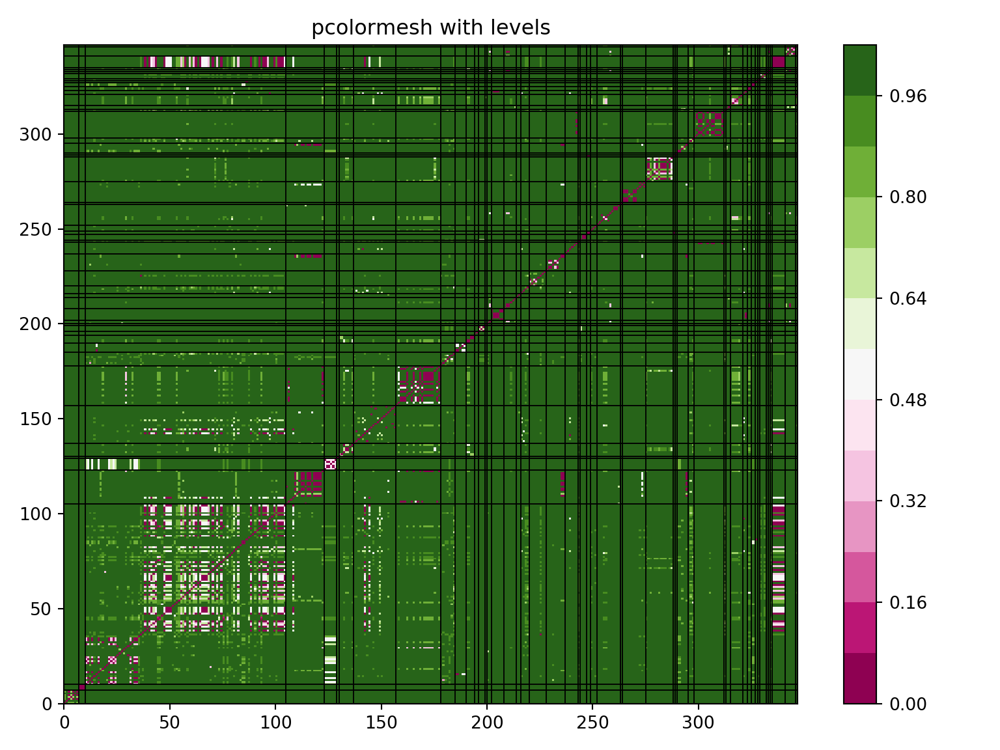

In [1427]:
dists_unique_3gram = get_dists(hists_unique_3gram, canberra_metric, hist_len_3gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_3gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [1433]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_3gram)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_3gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.797
Best rand: 86.828


In [1568]:
all_dists = np.unique(np.array(dists_unique_3gram).flatten())

max_rand = 0
best_eps = -1

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_3gram)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_3gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.7962962962962963
Best rand: 86.828


In [1567]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.7962962962962963, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_3gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove condition']
190 ['Add parameter 

86.828

In [1447]:
eps, j = choose_eps(dists_unique_3gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_unique_3gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

0.14285714285714285
197
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
274 ['Remove statement']
296 ['Remove statement']
314 ['Remove statement']
346 ['Remove stateme

75.633

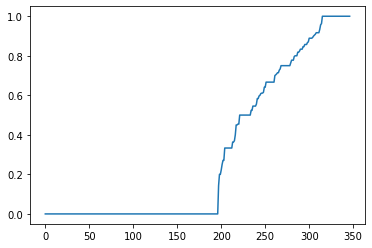

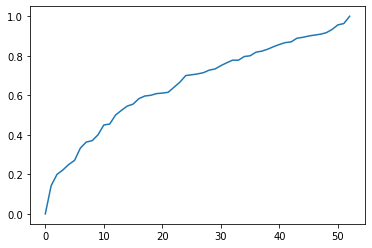

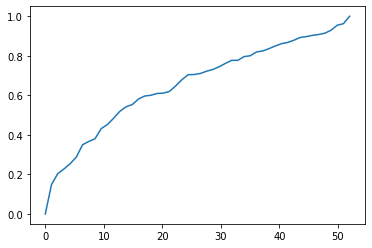

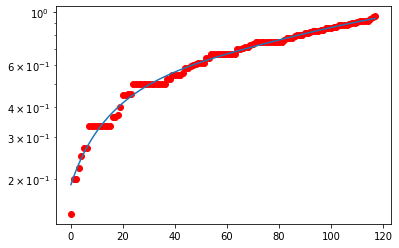

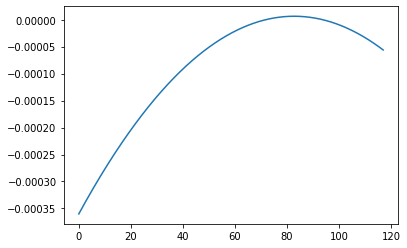

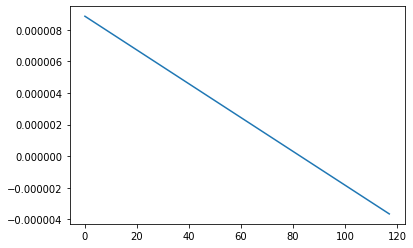

82.80310575219283
Eps = 0.7647058823529411


In [1452]:
knn_dists(dists_unique_3gram, 2)

In [1453]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.7647058823529411, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_3gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statem

86.472

In [1435]:
hists_unique_2gram = []
gram_path = "2gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_2GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_2gram.append(hist_data1)
    hist_file1.close()

<IPython.core.display.Javascript object>


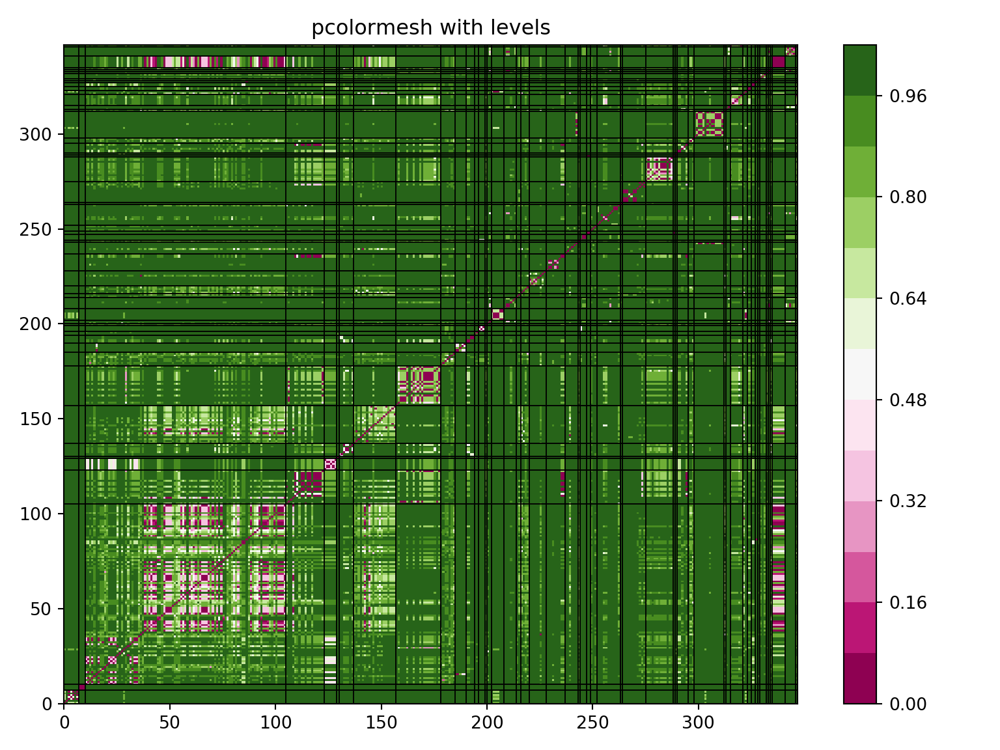

In [1436]:
dists_unique_2gram = get_dists(hists_unique_2gram, canberra_metric, hist_len_2gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_2gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [1437]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_2gram)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_2gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.646
Best rand: 87.593


In [1569]:
all_dists = np.unique(np.array(dists_unique_2gram).flatten())

max_rand = 0
best_eps = -1

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_2gram)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_2gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.6458333333333333
Best rand: 87.593


In [1570]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6458333333333333, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_2gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_2gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statem

87.593

In [1448]:
eps, j = choose_eps(dists_unique_2gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_unique_2gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_2gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

0.14285714285714285
197
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
211 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
261 ['Remove statement']
274 ['Remove statement']
289 ['Remove stateme

75.733

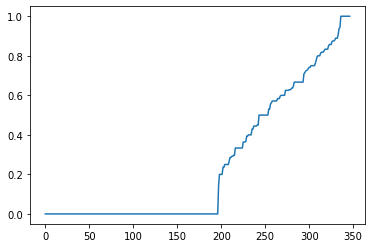

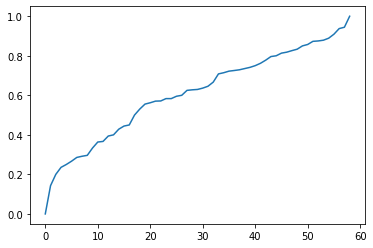

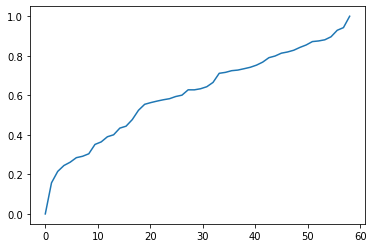

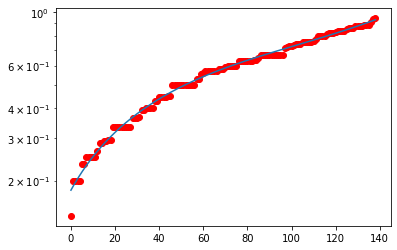

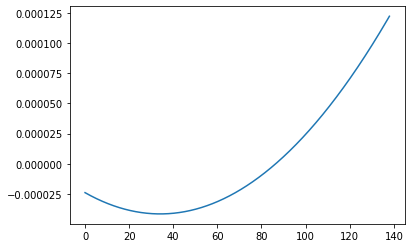

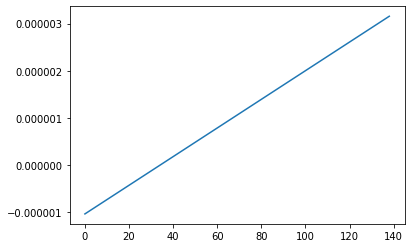

34.08711719070545
Eps = 0.4


In [1454]:
knn_dists(dists_unique_2gram, 2)

In [1455]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.4, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_2gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_2gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
337 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


125 ['Remove statement']
623 ['Remove parameter from the method invocation']
27 ['Add/Remove parameter']
49 ['Add/Remove parameter']
72 ['Add/Rem

82.244

In [1439]:
hists_unique_1gram = []
gram_path = "1gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_FOR_HIST_PATH_TUFANO_1GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_1gram.append(hist_data1)
    hist_file1.close()

In [ ]:
dists_unique_1gram = get_dists(hists_unique_1gram, canberra_metric, hist_len_1gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_1gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [1441]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_1gram)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_1gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.425
Best rand: 87.561


In [1565]:
all_dists = np.unique(np.array(dists_unique_1gram).flatten())

max_rand = 0
best_eps = -1

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_1gram)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_1gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.425
Best rand: 87.561


In [1446]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.425, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_1gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_1gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
41 ['Remove statement']
56 ['Remove condition'

87.561

In [1449]:
eps, j = choose_eps(dists_unique_1gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_unique_1gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_1gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

0.08333333333333333
203
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


125 ['Remove statement']
623 ['Remove parameter from the method invocation']
49 ['Add/Remove parameter']
72 ['Add/Remove parameter']
113 ['Add/Remove parameter']
144 ['Add/Remove parameter']
189 ['Add/Remove parameter']
212 ['Add/Remove paramete

76.91

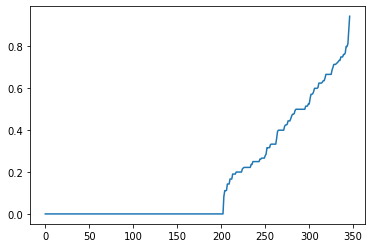

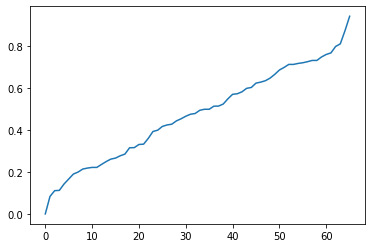

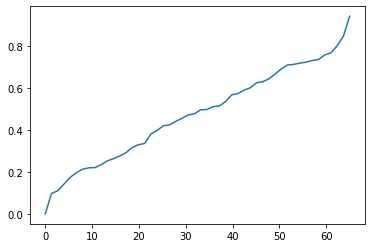

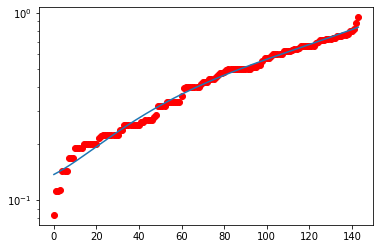

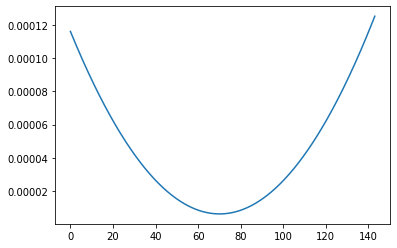

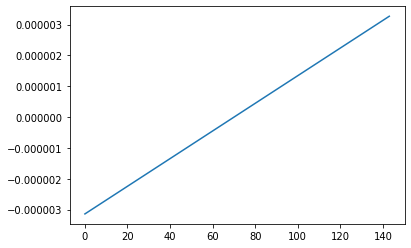

70.07283214091731
Eps = 0.425


In [1456]:
knn_dists(dists_unique_1gram, 2)

In [1457]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.425, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_1gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_1gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
41 ['Remove statement']
56 ['Remove condition'

87.561

In [1458]:
concat_hists_unique = []

num_changes = len(hists_unique_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_unique_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_unique_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_tufano, amount))
        
    for gram_ind, amount in hists_unique_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_tufano + hist_len_2gram_tufano, amount))
    
    concat_hists_unique.append(concat_hist)


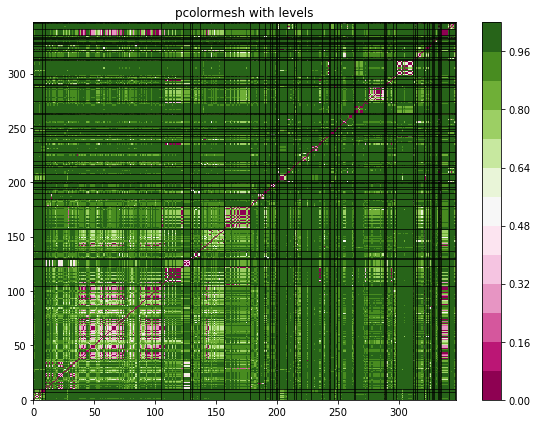

In [1460]:
dists_unique_all_gram = get_dists(concat_hists_unique, canberra_metric, concat_hists_len)
drawhist2(ids_per_unique_label, dists_unique_all_gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [1571]:
all_dists = np.unique(np.array(dists_unique_all_gram).flatten())

max_rand = 0
best_eps = -1

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_all_gram)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_all_gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.6367647058823529
Best rand: 87.257


In [1572]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6367647058823529, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_all_gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_all_gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove

87.257

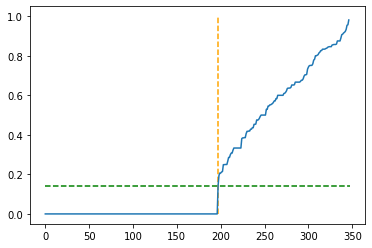

0.14285714285714285
197
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
274 ['Remove statement']
296 ['Remove statement']
314 ['Remove statement']
346 ['Remove stateme

75.633

In [1463]:
eps, j = choose_eps(dists_unique_all_gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_unique_all_gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_all_gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

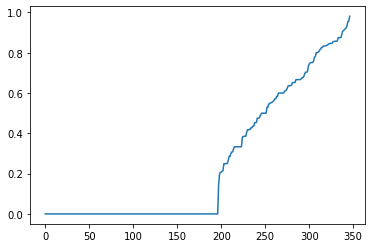

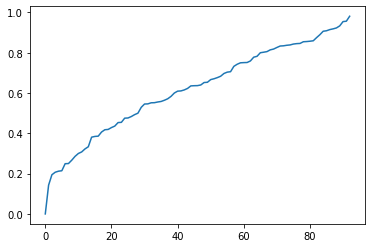

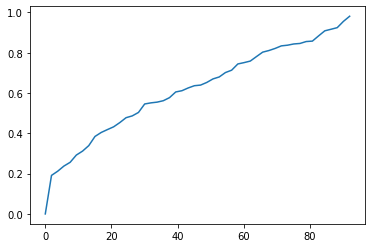

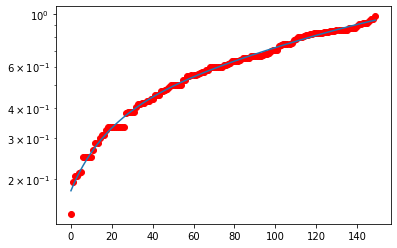

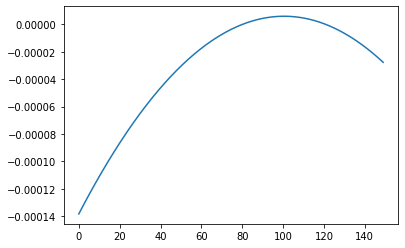

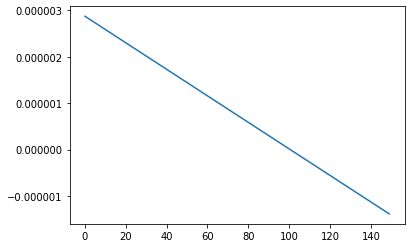

100.48916724263928
Eps = 0.7037037037037037


In [1480]:
knn_dists(dists_unique_all_gram, 2)

In [1471]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.7037037037037037, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_all_gram)
print_clustering_results_tufano(tufano_clustering, dists_unique_all_gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
448 ['Remove statement']
461 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstra

77.748

In [ ]:
print("kk")

In [ ]:
knn_dists(dists_unique_all_gram, 2, for_spline=(2, 3))

In [1464]:
edit_scripts_for_unique = []

for double_num in tqdm_notebook(ids_per_unique_label):
    actions_file = open(TUFANO_ACTIONS_PATH + "/" + double_num + "/" + double_num + "/" + "sampleChange1")
    edit_script = actions_file.read().split("\n")
    edit_script = [elem for elem in edit_script if elem != '']
    
    edit_scripts_for_unique.append(edit_script)
    actions_file.close()


In [1466]:
dists_for_lcs_unique = []

for es1 in edit_scripts_for_unique:
    cur_dists = []
    for es2 in edit_scripts_for_unique:
        cur_lcs = lcs(es1, es2)
        dist = 1 - cur_lcs / max(len(es1), len(es2))
        cur_dists.append(dist)
    dists_for_lcs_unique.append(cur_dists)

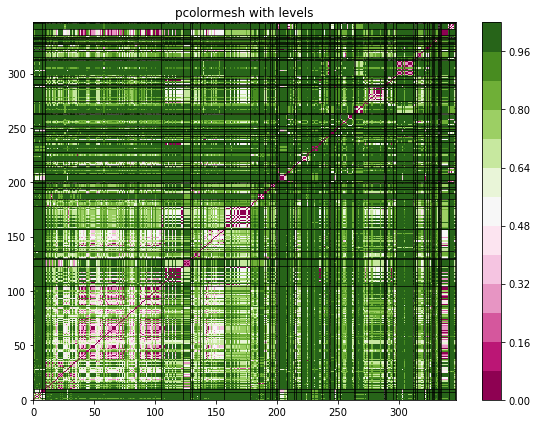

In [1467]:
drawhist2(ids_per_unique_label, dists_for_lcs_unique, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [1468]:
max_rand = 0
best_eps = -1

for eps in tqdm_notebook(np.arange(0.001, 1.0, 0.001)):
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_for_lcs_unique)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_for_lcs_unique,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.358
Best rand: 86.362


In [1469]:
# Eps is strange above (too small)

tufano_clustering = sklearn.cluster.DBSCAN(eps=0.358, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_lcs_unique)
print_clustering_results_tufano(tufano_clustering, dists_for_lcs_unique,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
57 ['Replace fully qualified name with import or vice versa']
73 ['Replace fully qualified name with import or vice versa']
182 ['Replace fully qualified name with import or vice versa']
195 ['Replace fully qualified name with import or vice versa']
389 ['Replace fully qualified name with import or vice versa']
420 ['Replace fully qualified name with import or vice versa']
119 ['Broad method visibility']
286 ['Broad method visibility']
194 ['Narrow method visibility']
541 ['Class is not static anymore. Add object instance to invoke its methods']
464 ['Class becomes static. Delete object instance to invoke its methods']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove 

86.362

In [1575]:
all_dists = np.unique(np.array(dists_for_lcs_unique).flatten())

max_rand = 0
best_eps = -1

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_for_lcs_unique)
    rand = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_for_lcs_unique,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False)
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_rand)


Best eps: 0.3571428571428571
Best rand: 86.362


In [1577]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.3571428571428571, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_lcs_unique)
print_clustering_results_tufano(tufano_clustering, dists_for_lcs_unique,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
57 ['Replace fully qualified name with import or vice versa']
73 ['Replace fully qualified name with import or vice versa']
182 ['Replace fully qualified name with import or vice versa']
195 ['Replace fully qualified name with import or vice versa']
389 ['Replace fully qualified name with import or vice versa']
420 ['Replace fully qualified name with import or vice versa']
119 ['Broad method visibility']
286 ['Broad method visibility']
194 ['Narrow method visibility']
541 ['Class is not static anymore. Add object instance to invoke its methods']
464 ['Class becomes static. Delete object instance to invoke its methods']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove 

86.362

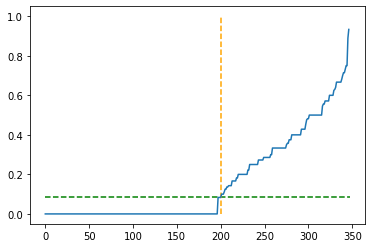

0.08333333333333337
200
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
274 ['Remove statement']
296 ['Remove statement']
314 ['Remove statement']
346 ['Remove stateme

76.449

In [1481]:
eps, j = choose_eps(dists_for_lcs_unique, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_for_lcs_unique)
print_clustering_results_tufano(tufano_clustering, dists_for_lcs_unique,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

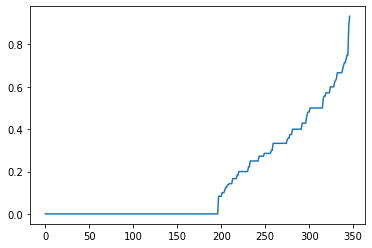

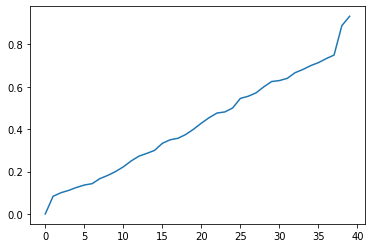

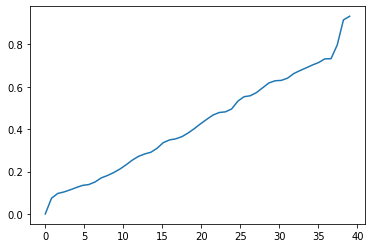

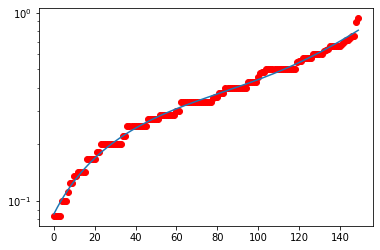

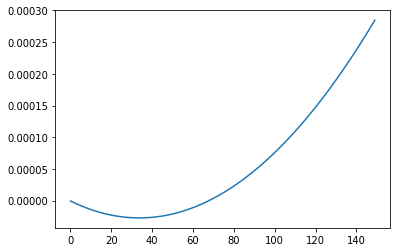

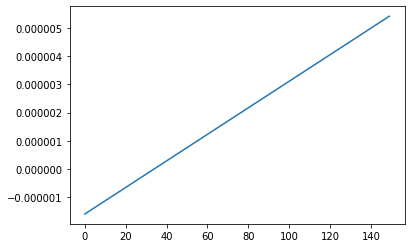

33.738749385546186
Eps = 0.19999999999999996


In [1482]:
knn_dists(dists_for_lcs_unique, 2)

In [1483]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.19999999999999996, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_lcs_unique)
print_clustering_results_tufano(tufano_clustering, dists_for_lcs_unique,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']
445 ['Move existing statements out of try block']
474 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
121 ['Remove statement']
197 ['Remove statement']
203 ['Remove statement']
211 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
261 ['Remove statement

81.656

# All labeled Tufano Dataset

In [51]:
RESULTS_ALL_LABELED_TUFANO = "/Volumes/Seagate/Alina/result_for_all_labeled_tufano"

In [52]:
all_dirs = [os.fsdecode(el) for el in os.listdir(RESULTS_ALL_LABELED_TUFANO) 
               if os.path.isdir(RESULTS_ALL_LABELED_TUFANO + "/" + os.fsdecode(el))]
all_dirs = sorted(all_dirs, key=lambda s: int(s.split(" ")[0])) 
len(all_dirs)

632

In [53]:
TUFANO_DATASET_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoDataset"

unique_label_to_changes = collections.defaultdict(list)
from_change_to_unique_label = collections.defaultdict(list)

num_multiple = 0

for double_num in tqdm_notebook(all_dirs):
    change_id = double_num.split(" ")[0]
    label_file = open(TUFANO_DATASET_PATH + "/" + change_id + "/" + "label.txt")
    labels = label_file.read().split(",")
    label = ""
        
    if len(labels) > 1:
        num_multiple += 1
        final_label_file = open(TUFANO_DATASET_PATH + "/" + change_id + "/" + "final_label.txt")
        final_label = final_label_file.read()
        label = final_label
        final_label_file.close()
        #if not os.path.exists(TUFANO_DATASET_PATH + "/" + change_id + "/" + "final_label.txt"):
        #    print(double_num)
    else:
        label = labels[0]
    
    #print(double_num, label)
        
    if label != "" and label != 'unclear':
        unique_label_to_changes[label].append(change_id)
        from_change_to_unique_label[change_id].append(label)
    
    label_file.close()
    
print(num_multiple)


42


In [74]:
#Maybe change labels:
# 84 84
# 172 172
# 205 205
# 431 431

In [54]:
print(len(from_change_to_unique_label))
print("NUM CLASSES:", len(unique_label_to_changes))

627
NUM CLASSES: 58


In [76]:
sorted(list(unique_label_to_changes))

['Abstract an existing method using the abstract keyword',
 'Add Condition',
 'Add braces to if statement',
 'Add invoked method',
 'Add null check',
 'Add parameter & remove variable from method body',
 'Add parameter in the method/constructor invocation',
 'Add statement',
 'Add try block',
 'Add/Remove operand from condition',
 'Add/Remove parameter',
 'Add/Remove synchronized keyword from method',
 'Add/Remove synchronized keyword from variable',
 'Add/Remove this qualifier',
 'Broad method visibility',
 'Change comparison operator (e.g. >) in condition',
 'Change exception type in catch clause',
 'Change method invocation as result of a move method',
 'Change method return value',
 'Change operands order in if condition',
 'Change parameter type',
 'Change parameter value of invoked method',
 'Change parameters order in method invocation',
 'Change qualified name in response to a move class refactoring',
 'Change return type',
 'Change type of a variable',
 'Class becomes static. 

In [55]:
ids_per_unique_label = []
unique_lines_poses = []
cur_sum = 0
all_unique_labels = []

for label in unique_label_to_changes:
    all_unique_labels.append(label)
    for change in unique_label_to_changes[label]:
        ids_per_unique_label.append(change)
        cur_sum += 1
    unique_lines_poses.append(cur_sum)

In [330]:
for i in range(len(ids_per_unique_label)):
    print("On index", i, ids_per_unique_label[i])

On index 0 1
On index 1 392
On index 2 395
On index 3 409
On index 4 426
On index 5 441
On index 6 468
On index 7 2
On index 8 45
On index 9 466
On index 10 3
On index 11 9
On index 12 16
On index 13 35
On index 14 41
On index 15 53
On index 16 59
On index 17 61
On index 18 65
On index 19 69
On index 20 80
On index 21 92
On index 22 93
On index 23 97
On index 24 110
On index 25 111
On index 26 118
On index 27 121
On index 28 123
On index 29 125
On index 30 132
On index 31 133
On index 32 135
On index 33 137
On index 34 138
On index 35 149
On index 36 167
On index 37 193
On index 38 197
On index 39 200
On index 40 203
On index 41 210
On index 42 211
On index 43 214
On index 44 224
On index 45 227
On index 46 231
On index 47 234
On index 48 235
On index 49 239
On index 50 241
On index 51 249
On index 52 250
On index 53 251
On index 54 260
On index 55 261
On index 56 273
On index 57 274
On index 58 275
On index 59 289
On index 60 292
On index 61 295
On index 62 296
On index 63 305
On inde

In [331]:
for i in range(len(unique_lines_poses)):
    if i == 0:
        print("From 0 to", unique_lines_poses[i], all_unique_labels[i])
    else:
        print("From", unique_lines_poses[i - 1], "to", unique_lines_poses[i], all_unique_labels[i])

From 0 to 7 Add braces to if statement
From 7 to 10 Forbid overriding: add final to method
From 10 to 105 Remove statement
From 105 to 164 Remove parameter from the method invocation
From 164 to 208 Change parameter type
From 208 to 214 Abstract an existing method using the abstract keyword
From 214 to 215 Move synchronized keyword from method signature to code block or vice versa
From 215 to 222 Merge variable definition & initialization
From 222 to 244 Class is not static anymore. Add object instance to invoke its methods
From 244 to 265 Broad method visibility
From 265 to 286 Remove invoked method
From 286 to 292 Change method return value
From 292 to 317 Add/Remove parameter
From 317 to 324 Remove condition
From 324 to 330 Move existing statements out of try block
From 330 to 366 Add parameter in the method/constructor invocation
From 366 to 370 Remove redundant initialization
From 370 to 375 Rename variable
From 375 to 377 Add/Remove synchronized keyword from variable
From 377 to 

In [56]:
def find_eps_with_brute_force(dists):
    all_dists = np.unique(np.array(dists).flatten())

    max_rand = 0
    best_eps = -1
    max_fm = 0


    for eps in tqdm_notebook(all_dists):
        if eps == 0.0:
            continue
        tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                                   min_samples=2, 
                                                   metric='precomputed').fit(dists)
        rand, fm = print_clustering_results_tufano_unique(tufano_clustering, 
                                               dists,
                                               unique_label_to_changes, 
                                               from_change_to_unique_label, 
                                               ids_per_unique_label,
                                               to_print=False, 
                                               without_outliers=True)

        if max_fm < fm:
            max_fm = fm
            best_eps = eps

    print("Best eps:", best_eps)
    print("Best F-measure:", max_fm)

In [57]:
hists_unique_4gram = []
gram_path = "4gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_ALL_LABELED_TUFANO + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_4gram.append(hist_data1)
    hist_file1.close()

In [58]:
hist_len_4gram_tufano = None

es_path = RESULTS_ALL_LABELED_TUFANO + "/" + "edit_scripts_4grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_4gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_4gram_tufano)

741


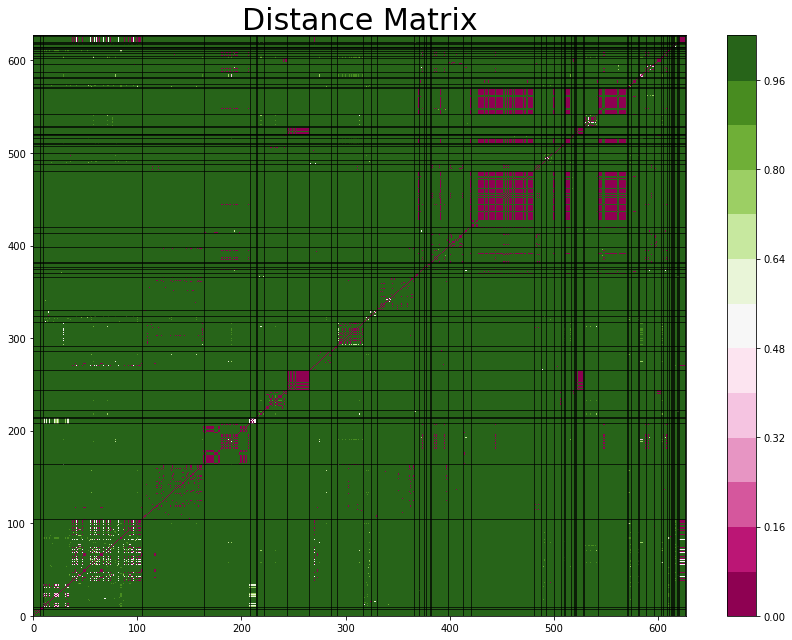

In [351]:
dists_unique_4gram = get_dists(hists_unique_4gram, canberra_metric, hist_len_4gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_4gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [352]:
find_eps_with_brute_force(dists_unique_4gram)


Best eps: 0.8888888888888888
Best F-measure: 0.4496020437453937


In [354]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.8888888888888888, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_4gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_4gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
436 ['Remove statement']
56 ['Remove condition']
190 ['Add parameter in the met

(93.008, 0.4496020437453937)

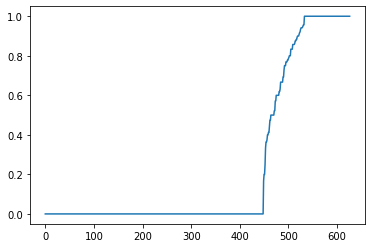

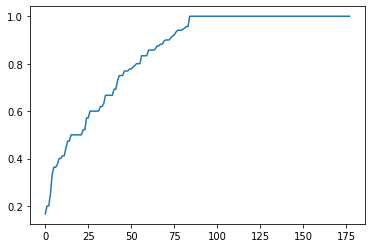

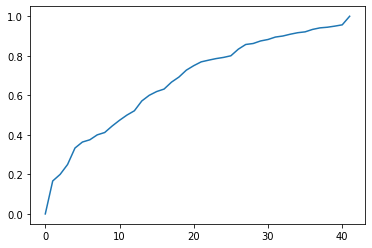

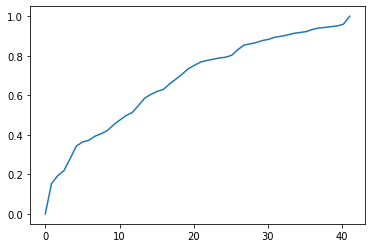

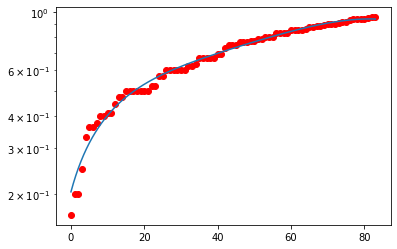

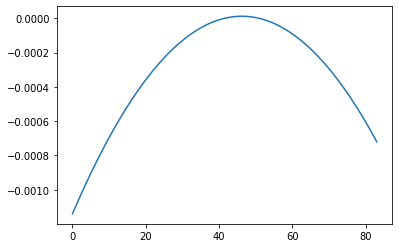

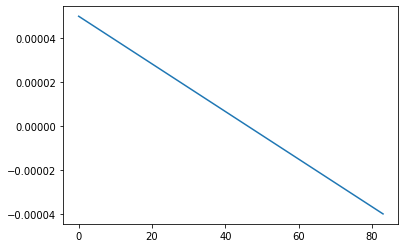

46.18379604763595
Eps = 0.7692307692307693


In [307]:
knn_dists(dists_unique_4gram, 2)

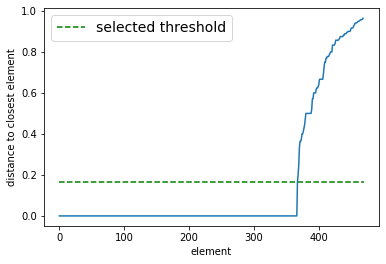

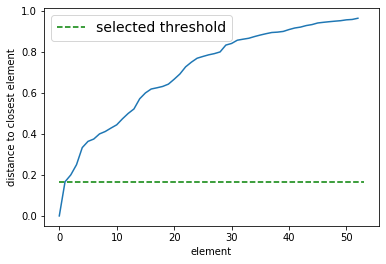

0.16666666666666663


(0.16666666666666663, 0.16666666666666663)

In [603]:
choose_threshold(dists_unique_4gram)

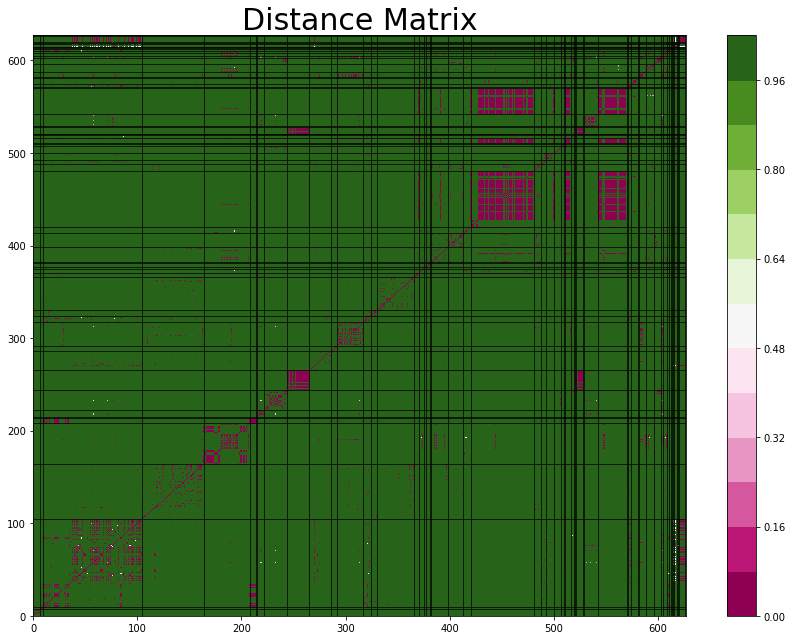

In [356]:
dists_unique_4gram_jaccard = get_dists(hists_unique_4gram, jaccard_metric, hist_len_4gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_4gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [357]:
find_eps_with_brute_force(dists_unique_4gram_jaccard)


Best eps: 0.16666666666666663
Best F-measure: 0.43077276687278765


In [358]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.16666666666666663, #0.001 the same
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_4gram_jaccard)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_4gram_jaccard,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
16 ['Remove statement']
35 ['Remove statement']
41 ['Remove statement']
59 ['Remove statement']
61 ['Remove statement']
65 ['Remove statement']
69 ['Remove statement']
80 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
125 ['Remove statement']
133 ['Remove statement']
135 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
149 ['Remove statement']
167 ['Remove statement']
197 ['Remove statement']
200 ['Remove statement']
203 ['Remove statement']
211 ['Remove statement']
214 ['Remove statement']
224 ['Remove statement']
227 ['Remove statement']
231 ['Remove statement']
234 ['Remove statement']
250 ['R

(88.555, 0.43077276687278765)

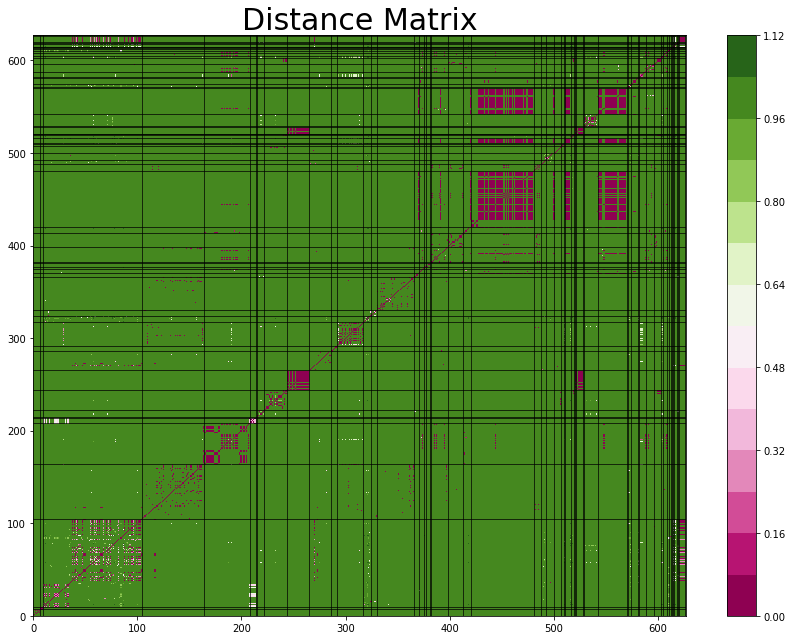

In [359]:
dists_unique_4gram_pearson = get_dists(hists_unique_4gram, pearsons_correlation_mean, hist_len_4gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_4gram_pearson, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [224]:
find_eps_with_brute_force(dists_unique_4gram_pearson)


Best eps: 0.42421118841937067
Best F-measure: 0.4416582295488631


In [360]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.42421118841937067, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_4gram_pearson)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_4gram_pearson,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']
445 ['Move existing statements out of try block']
474 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
337 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


125 ['Remove statement']
623 ['Remove paramet

(93.626, 0.4416582295488631)

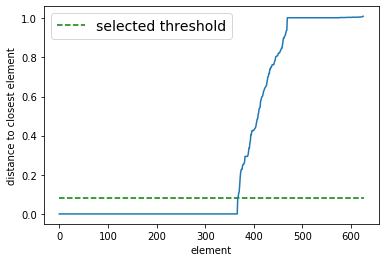

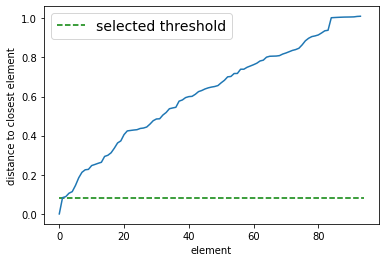

0.08312174775582248


(0.08312174775582248, 0.08312174775582248)

In [604]:
choose_threshold(dists_unique_4gram_pearson)

In [59]:
hists_unique_3gram = []
gram_path = "3gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_ALL_LABELED_TUFANO + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_3gram.append(hist_data1)
    hist_file1.close()

In [60]:
hist_len_3gram_tufano = None

es_path = RESULTS_ALL_LABELED_TUFANO + "/" + "edit_scripts_3grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_3gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_3gram_tufano)

666


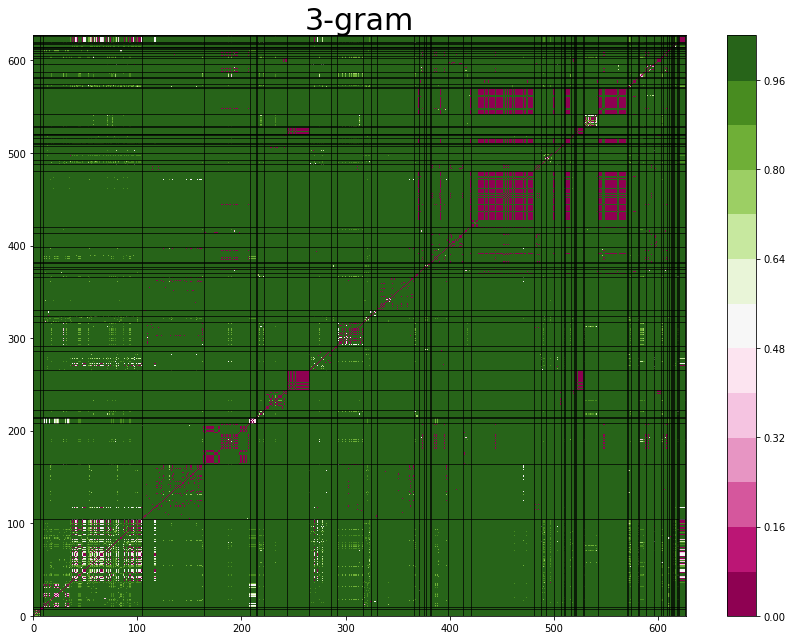

In [338]:
dists_unique_3gram = get_dists(hists_unique_3gram, canberra_metric, hist_len_3gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_3gram, False, lw=0.7, provided_lines_pos=unique_lines_poses, 
          title="3-gram")

In [187]:
find_eps_with_brute_force(dists_unique_3gram)


Best eps: 0.7777777777777778
Best F-measure: 0.4600161453366225


In [362]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.7777777777777778, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_3gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statem

(92.962, 0.4600161453366225)

In [243]:
all_dists = np.unique(np.array(dists_unique_3gram).flatten())

max_rand = 0
best_eps = -1
max_fm = 0

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_3gram)
    rand, fm = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_3gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False, without_outliers=True)
    
    if max_rand < rand:
        max_rand = rand
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_fm)


Best eps: 0.45454545454545453
Best rand: 0


In [363]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.45454545454545453, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_3gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
337 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


125 ['Remove statement']
623 ['Remove parameter from the method invocation']
49 ['Add/Remove parameter']
72 ['Add/Remove parameter']
113 ['Add/Re

(93.635, 0.43609251345683114)

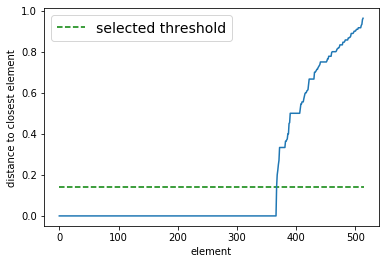

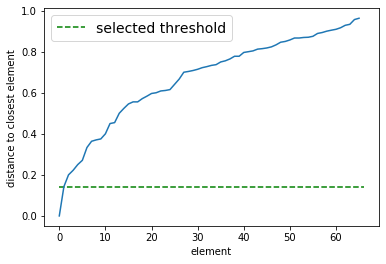

0.1428571428571428


(0.1428571428571428, 0.1428571428571428)

In [605]:
choose_threshold(dists_unique_3gram)

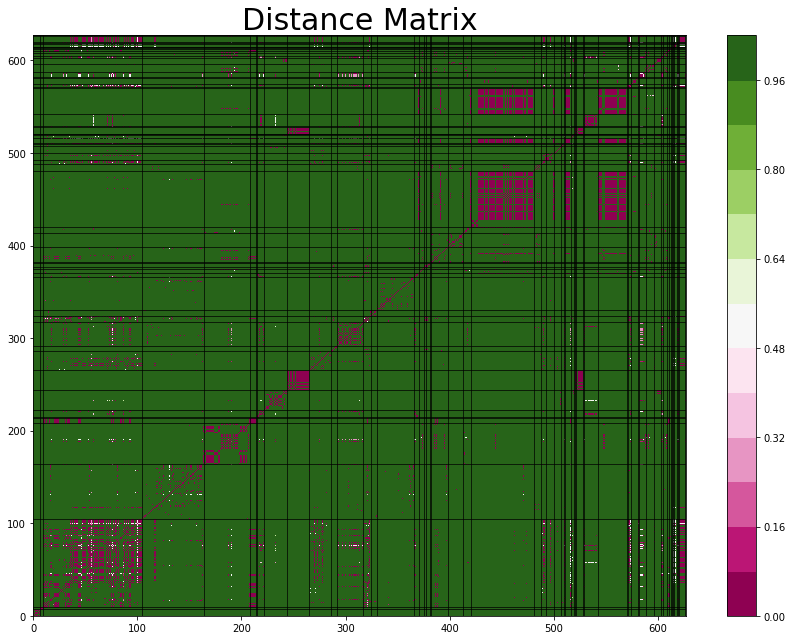

In [364]:
dists_unique_3gram_jaccard = get_dists(hists_unique_3gram, jaccard_metric, hist_len_3gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_3gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [189]:
find_eps_with_brute_force(dists_unique_3gram_jaccard)


Best eps: 0.04166666666666663
Best F-measure: 0.41873456293295125


In [365]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.04166666666666663, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_3gram_jaccard)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_3gram_jaccard,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
16 ['Remove statement']
35 ['Remove statement']
41 ['Remove statement']
59 ['Remove statement']
61 ['Remove statement']
65 ['Remove statement']
69 ['Remove statement']
80 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
111 ['Remove statement']
121 ['Remove statement']
125 ['Remove statement']
132 ['Remove statement']
133 ['Remove statement']
135 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
149 ['Remove statement']
167 ['Remove statement']
193 ['Remove statement']
197 ['Remove statement']
200 ['Remove statement']
203 ['Remove s

(83.235, 0.41873456293295125)

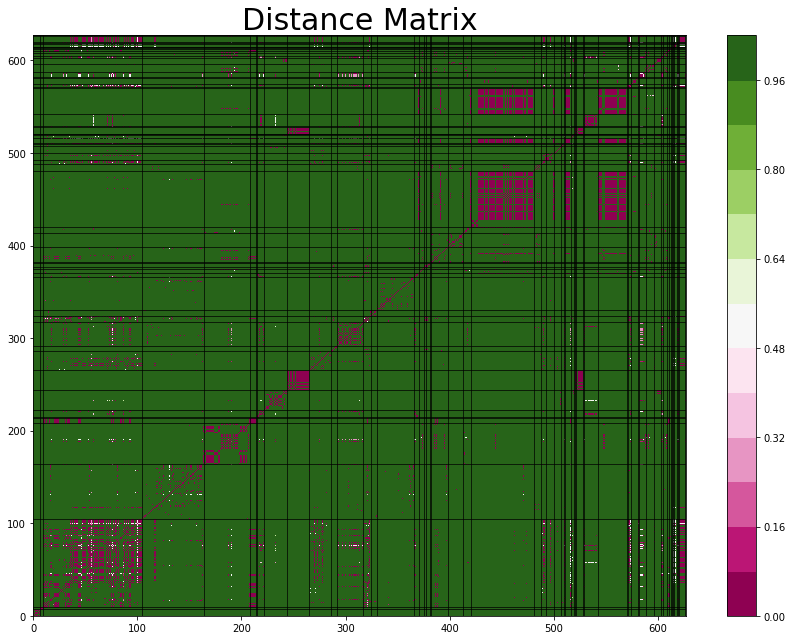

In [366]:
dists_unique_3gram_pearson = get_dists(hists_unique_3gram, pearsons_correlation_mean, hist_len_3gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_3gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [227]:
find_eps_with_brute_force(dists_unique_3gram_pearson)


Best eps: 0.31285324138863135
Best F-measure: 0.4546509676640339


In [367]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.31285324138863135, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_3gram_pearson)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_3gram_pearson,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
337 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


125 ['Remove statement']
623 ['Remove parameter from the method invocation']
27 ['Add/Remove parameter']
49 ['Add/Remove parameter']
72 ['Add/Rem

(93.491, 0.4546509676640339)

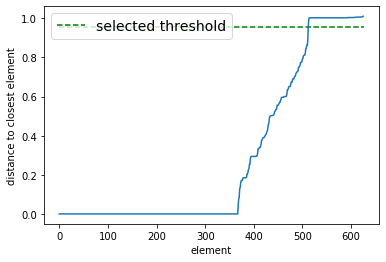

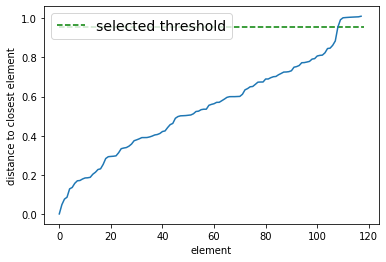

0.9551487351272367


(0.9551487351272367, 0.07071852087430253)

In [606]:
choose_threshold(dists_unique_3gram_pearson)

In [61]:
hists_unique_2gram = []
gram_path = "2gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_ALL_LABELED_TUFANO + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_2gram.append(hist_data1)
    hist_file1.close()

In [62]:
hist_len_2gram_tufano = None

es_path = RESULTS_ALL_LABELED_TUFANO + "/" + "edit_scripts_2grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_2gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_2gram_tufano)

523


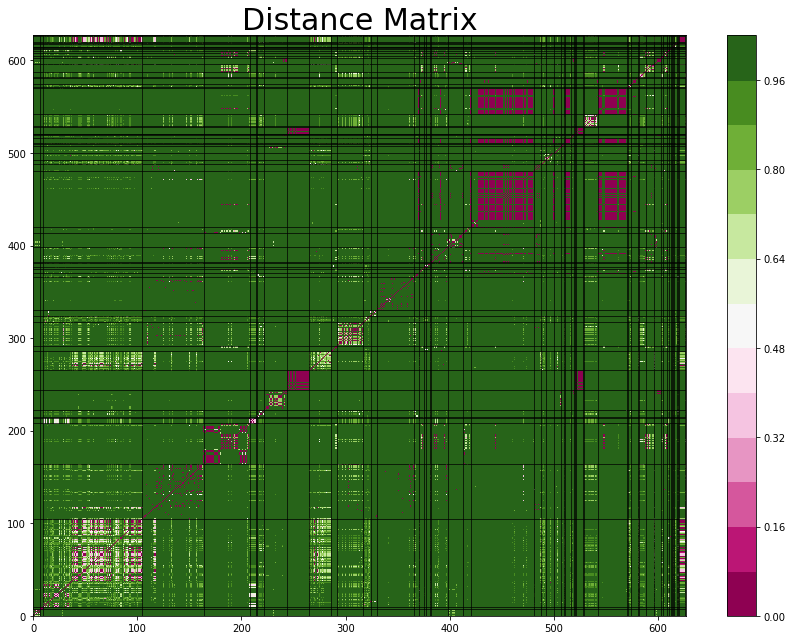

In [373]:
dists_unique_2gram = get_dists(hists_unique_2gram, canberra_metric, hist_len_2gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_2gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [197]:
find_eps_with_brute_force(dists_unique_2gram)


Best eps: 0.6458333333333333
Best F-measure: 0.4652034967698903


In [374]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6458333333333333, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_2gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_2gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statem

(93.313, 0.4652034967698903)

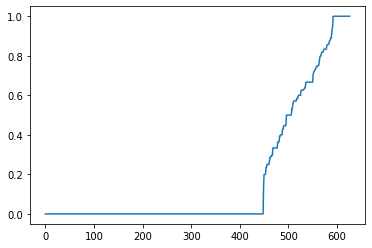

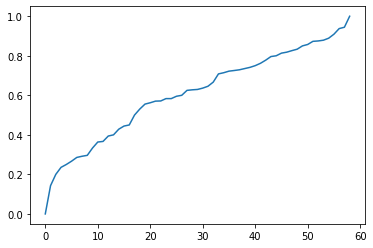

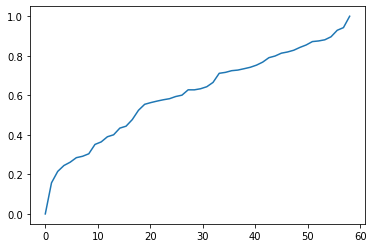

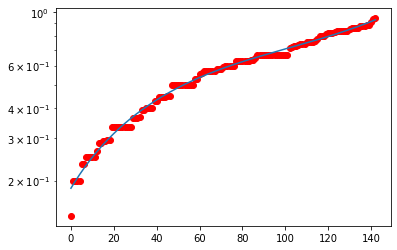

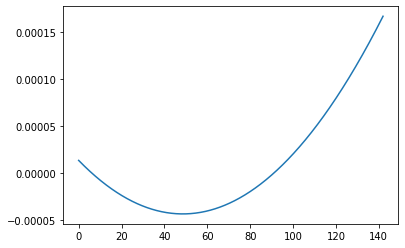

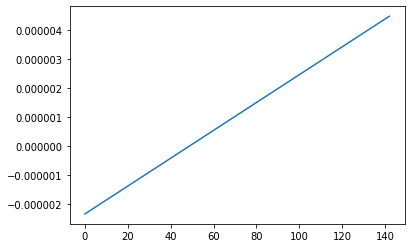

48.59860046003895
Eps = 0.5


In [295]:
knn_dists(dists_unique_2gram, 2)

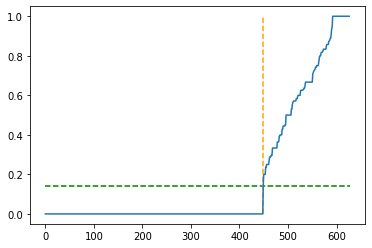

0.14285714285714285
449
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
211 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
261 ['Remove statement']
274 ['Remove statement']
289 ['Remove stateme

(93.425, 0.41517340066582037)

In [459]:
eps, j = choose_eps(dists_unique_2gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_unique_2gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_2gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

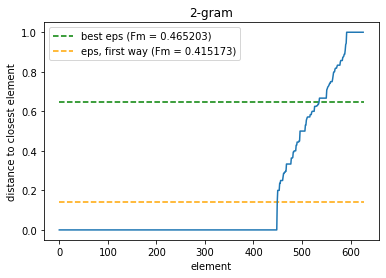

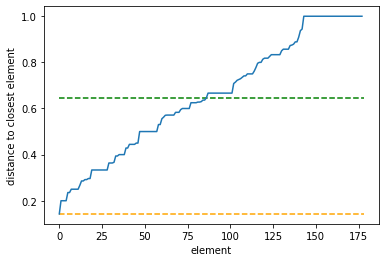

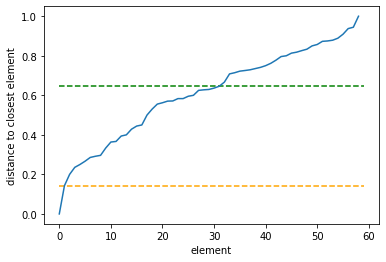

In [464]:
knn_dists_with_eps_line(dists_unique_2gram, 2, 0.6458333333333333, "2-gram", eps2=0.14285714285714285, fm1=0.465203, fm2=0.415173)

In [ ]:
#hohohoh

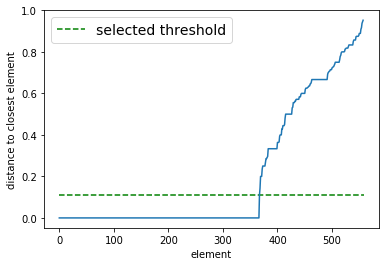

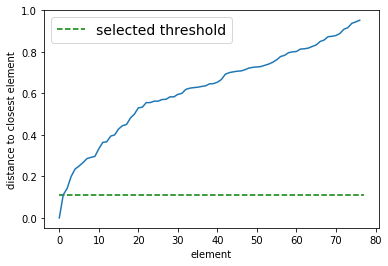

0.11111111111111116


(0.11111111111111116, 0.11111111111111116)

In [607]:
choose_threshold(dists_unique_2gram)

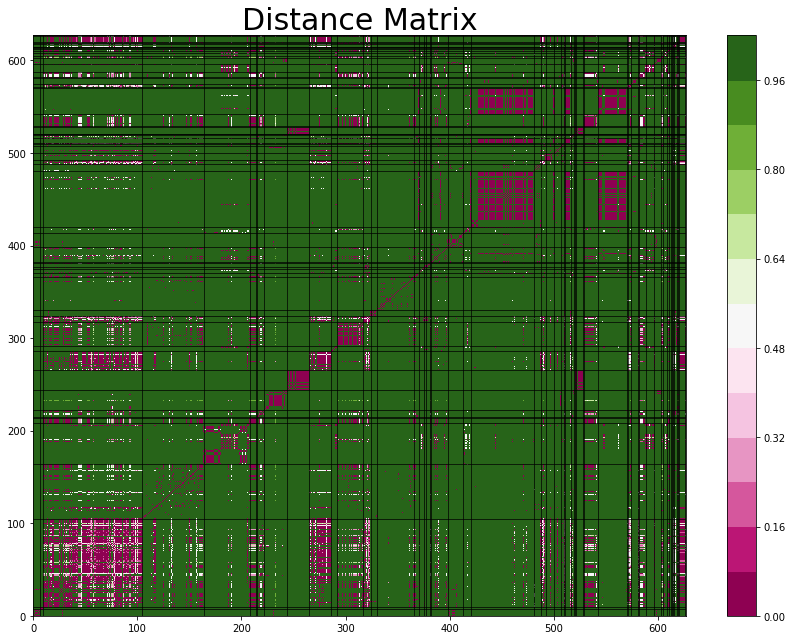

In [379]:
dists_unique_2gram_jaccard = get_dists(hists_unique_2gram, jaccard_metric, hist_len_2gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_2gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [199]:
find_eps_with_brute_force(dists_unique_2gram_jaccard)


Best eps: 0.06944444444444453
Best F-measure: 0.37085735465198766


In [380]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.06944444444444453, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_2gram_jaccard)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_2gram_jaccard,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
441 ['Add braces to if statement']
468 ['Add braces to if statement']
118 ['Remove statement']
123 ['Remove statement']
13 ['Class is not static anymore. Add object instance to invoke its methods']
541 ['Class is not static anymore. Add object instance to invoke its methods']
57 ['Replace fully qualified name with import or vice versa']
73 ['Replace fully qualified name with import or vice versa']
182 ['Replace fully qualified name with import or vice versa']
195 ['Replace fully qualified name with import or vice versa']
389 ['Replace fully qualified name with import or vice versa']
420 ['Replace fully qualified name with import or vice versa']
206 ['Invoke overridden method instead of inherited one']
464 ['Class becomes static. Delete object instance to invoke its methods']


2 ['Forbid overriding: add final to method']
45 ['Forbid overri

(72.753, 0.37085735465198766)

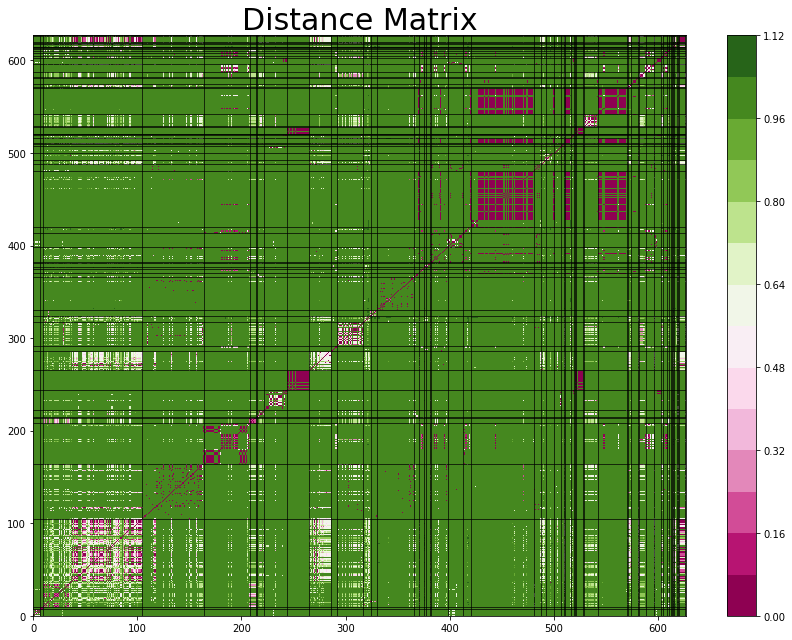

In [381]:
dists_unique_2gram_pearson = get_dists(hists_unique_2gram, pearsons_correlation_mean, hist_len_2gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_2gram_pearson, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [230]:
find_eps_with_brute_force(dists_unique_2gram_pearson)


Best eps: 0.3290073277332797
Best F-measure: 0.4522205509326572


In [382]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.3290073277332797, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_2gram_pearson)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_2gram_pearson,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements

(92.906, 0.4522205509326572)

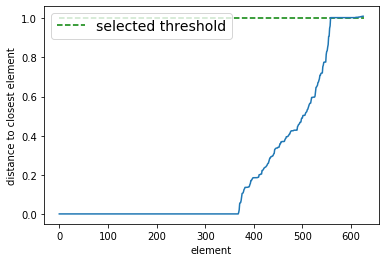

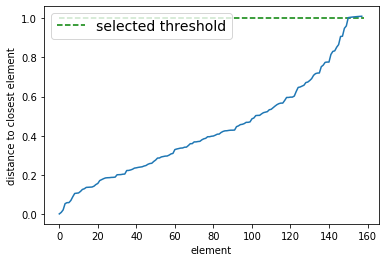

1.003831403563499


(1.003831403563499, 0.04238875775087858)

In [609]:
choose_threshold(dists_unique_2gram_pearson)

In [63]:
hists_unique_1gram = []
gram_path = "1gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_ALL_LABELED_TUFANO + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_1gram.append(hist_data1)
    hist_file1.close()

In [64]:
hist_len_1gram_tufano = None

es_path = RESULTS_ALL_LABELED_TUFANO + "/" + "edit_scripts_1grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_1gram_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_1gram_tufano)

244


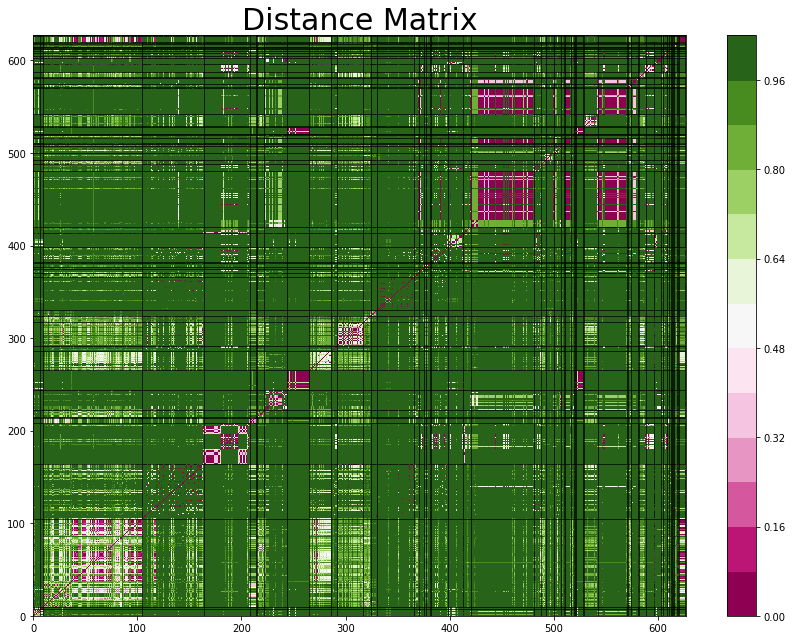

In [377]:
dists_unique_1gram = get_dists(hists_unique_1gram, canberra_metric, hist_len_1gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_1gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [136]:
all_dists = np.unique(np.array(dists_unique_1gram).flatten())

max_rand = 0
best_eps = -1
max_fm = 0

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_1gram)
    rand, fm = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_1gram,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False, without_outliers=True)
    
    if max_fm < fm:
        max_fm = fm
        best_eps = eps

print("Best eps:", best_eps)
print("Best F-measure:", max_fm)


Best eps: 0.4
Best rand: 0.49876118265644037


In [378]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.4, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_1gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_1gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
41 ['Remove statement']
56 ['Remove condition'

(93.072, 0.49876118265644037)

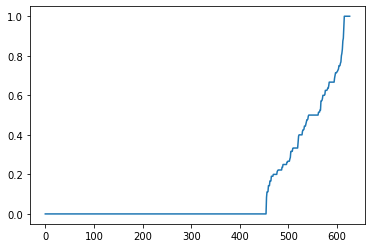

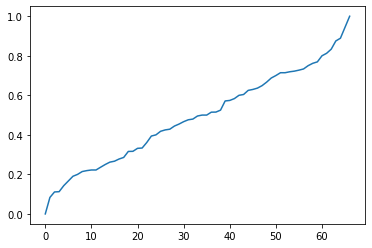

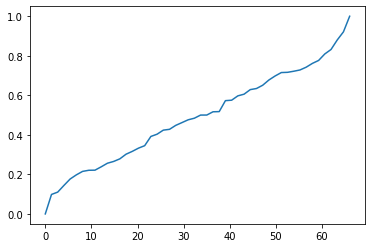

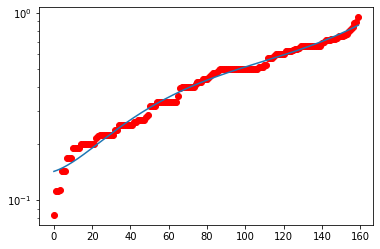

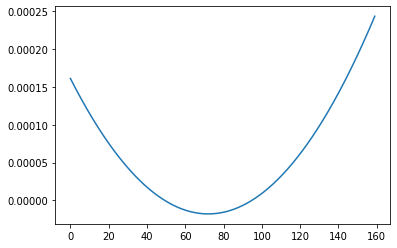

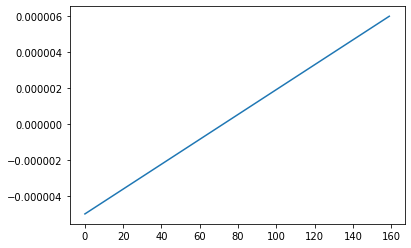

72.0028442697616
Eps = 0.4


In [296]:
knn_dists(dists_unique_1gram, 2)

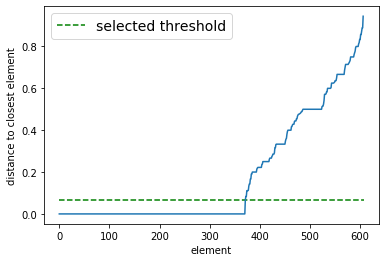

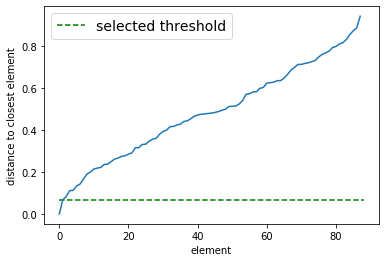

0.06666666666666665


(0.06666666666666665, 0.06666666666666665)

In [610]:
choose_threshold(dists_unique_1gram)

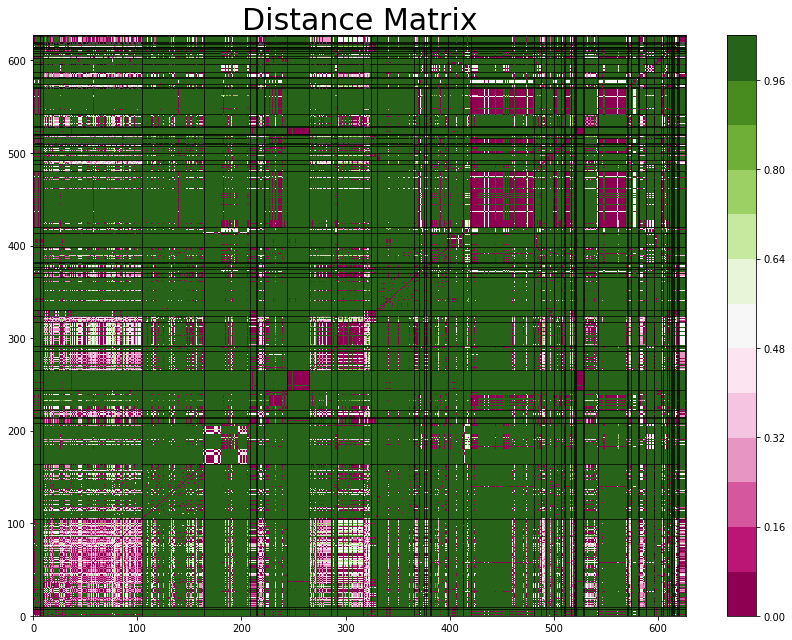

In [383]:
dists_unique_1gram_jaccard = get_dists(hists_unique_1gram, jaccard_metric, hist_len_1gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_1gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [152]:
all_dists = np.unique(np.array(dists_unique_1gram_jaccard).flatten())

max_rand = 0
best_eps = -1
max_fm = 0

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_unique_1gram_jaccard)
    rand, fm = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_unique_1gram_jaccard,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False, without_outliers=True)
    
    if max_fm < fm:
        max_fm = fm
        best_eps = eps

print("Best eps:", best_eps)
print("Best F-measure:", max_fm)


Best eps: 0.33333333333333337
Best F-measure: 0.15561176005222463


In [384]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.33333333333333337, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_1gram_jaccard)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_1gram_jaccard,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
392 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
441 ['Add braces to if statement']
468 ['Add braces to if statement']
2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
3 ['Remove statement']
9 ['Remove statement']
16 ['Remove statement']
35 ['Remove statement']
41 ['Remove statement']
53 ['Remove statement']
59 ['Remove statement']
61 ['Remove statement']
65 ['Remove statement']
69 ['Remove statement']
80 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
111 ['Remove statement']
118 ['Remove statement']
121 ['Remove statement']
123 ['Remove statement']
125 ['Remove statement']
132 ['Remove statement']
133 ['Remove statement']
135 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']

(19.34, 0.15561176005222463)

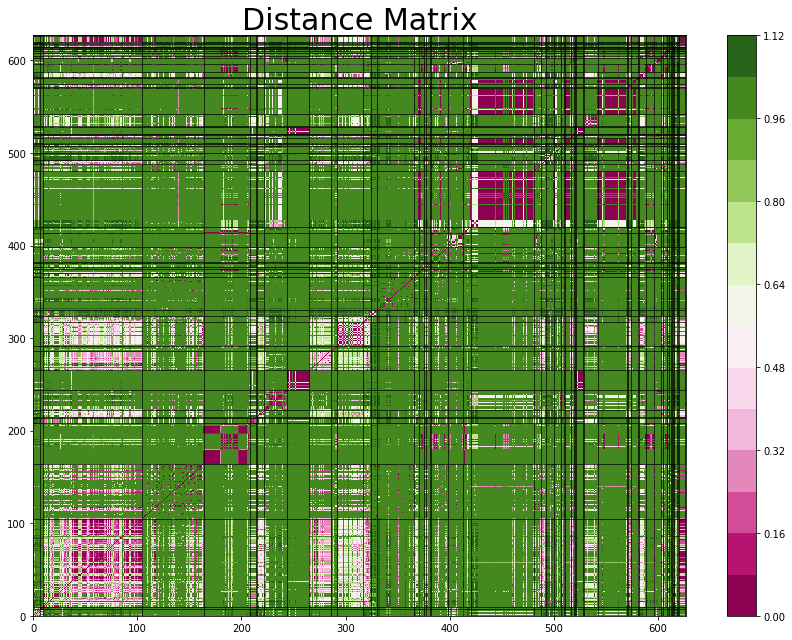

In [385]:
dists_unique_1gram_pearson = get_dists(hists_unique_1gram, pearsons_correlation_mean, hist_len_1gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_1gram_pearson, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [234]:
find_eps_with_brute_force(dists_unique_1gram_pearson)


Best eps: 0.12170208964048324
Best F-measure: 0.47959836882089896


In [386]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.12170208964048324, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_1gram_pearson)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_1gram_pearson,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']
149 ['Remove statement']
224 ['Remove statement']
227 ['Remove statement']
251 ['Remove statement']
347 ['Remove statement']
349 ['Remove statement']
366 ['Remove statement']
375 ['Remove statement']
490 ['Remove stat

(92.645, 0.47959836882089896)

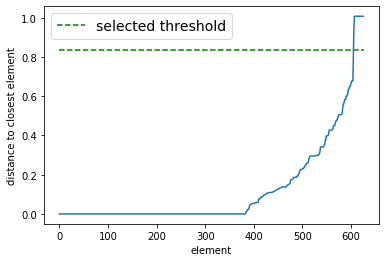

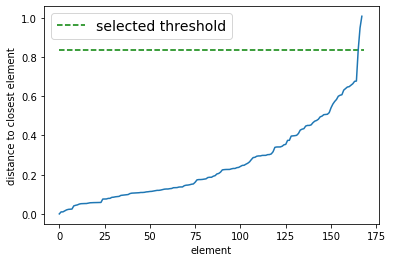

0.8375375809900482


(0.8375375809900482, 0.1598751429033728)

In [612]:
choose_threshold(dists_unique_1gram_pearson)

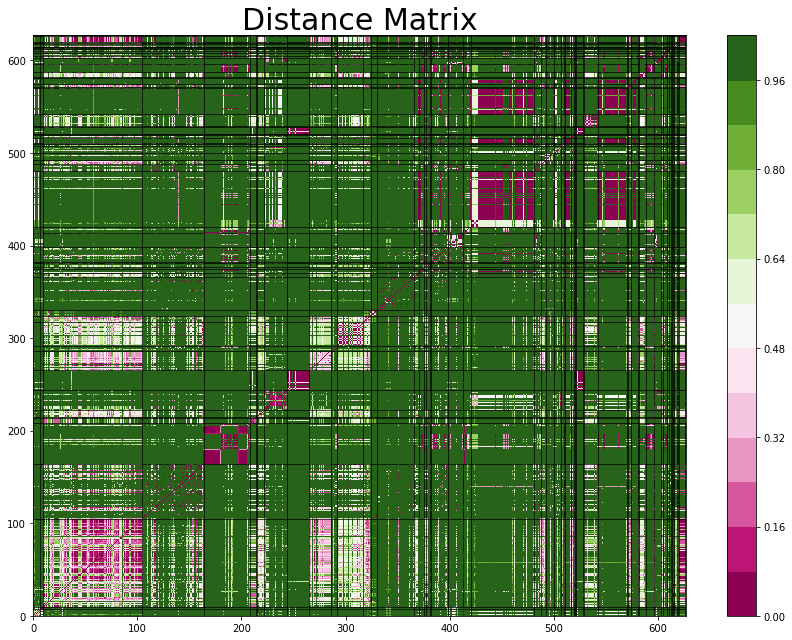

In [387]:
dists_unique_1gram_cos = get_dists(hists_unique_1gram, cos_distance, hist_len_1gram_tufano)
drawhist2(ids_per_unique_label, dists_unique_1gram_cos, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [111]:
find_eps_with_brute_force(dists_unique_1gram_cos)


Best eps: 0.1105008200066786
Best F-measure: 0.4817391818915477


In [388]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.1105008200066786, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_1gram_cos)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_1gram_cos,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']
149 ['Remove statement']
224 ['Remove statement']
227 ['Remove statement']
251 ['Remove statement']
347 ['Remove statement']
349 ['Remove statement']
366 ['Remove statement']
375 ['Remove statement']
490 ['Remove statement']
561 ['Remove statement']


(92.825, 0.4817391818915477)

In [605]:
TUFANO_ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoActions"

In [606]:
edit_scripts_for_unique = []

for double_num in tqdm_notebook(ids_per_unique_label):
    actions_file = open(TUFANO_ACTIONS_PATH + "/" + double_num + "/" + double_num + "/" + "sampleChange1")
    edit_script = actions_file.read().split("\n")
    edit_script = [elem for elem in edit_script if elem != '']
    
    edit_scripts_for_unique.append(edit_script)
    actions_file.close()


In [607]:
dists_for_lcs_unique = []

for es1 in tqdm_notebook(edit_scripts_for_unique):
    cur_dists = []
    for es2 in edit_scripts_for_unique:
        cur_lcs = lcs(es1, es2)
        dist = 1 - cur_lcs / max(len(es1), len(es2))
        cur_dists.append(dist)
    dists_for_lcs_unique.append(cur_dists)

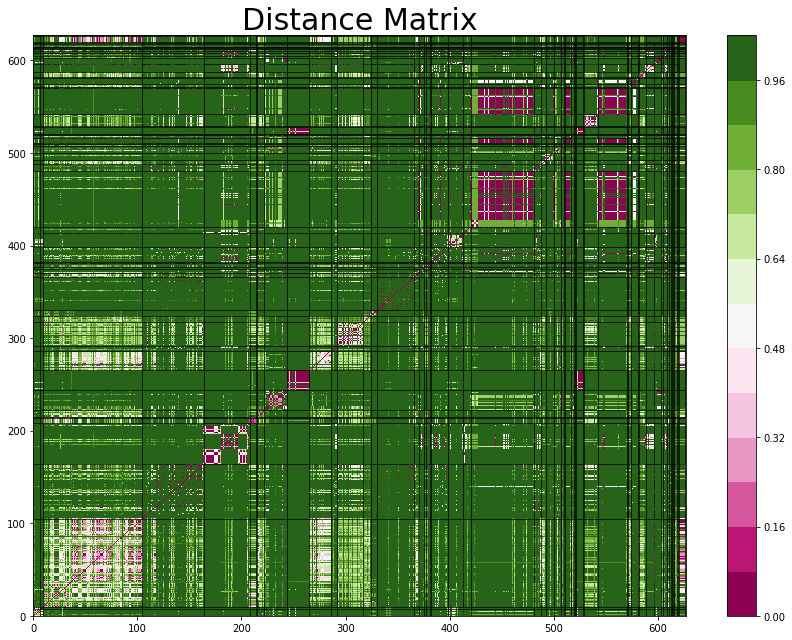

In [392]:
drawhist2(ids_per_unique_label, dists_for_lcs_unique, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [148]:
all_dists = np.unique(np.array(dists_for_lcs_unique).flatten())

max_rand = 0
best_eps = -1
max_fm = 0

for eps in tqdm_notebook(all_dists):
    if eps == 0.0:
        continue
    tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                               min_samples=2, 
                                               metric='precomputed').fit(dists_for_lcs_unique)
    rand, fm = print_clustering_results_tufano_unique(tufano_clustering, 
                                           dists_for_lcs_unique,
                                           unique_label_to_changes, 
                                           from_change_to_unique_label, 
                                           ids_per_unique_label,
                                          to_print=False, without_outliers=True)
    
    if max_fm < fm:
        max_fm = fm
        best_eps = eps

print("Best eps:", best_eps)
print("Best rand:", max_fm)


Best eps: 0.375
Best rand: 0.4674776988373744


In [608]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.375, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_lcs_unique)
print_clustering_results_tufano_unique(tufano_clustering, dists_for_lcs_unique,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
541 ['Class is not static anymore. Add object instance to invoke its methods']
119 ['Broad method visibility']
286 ['Broad method visibility']
57 ['Replace fully qualified name with import or vice versa']
73 ['Replace fully qualified name with import or vice versa']
182 ['Replace fully qualified name with import or vice versa']
195 ['Replace fully qualified name with import or vice versa']
389 ['Replace fully qualified name with import or vice versa']
420 ['Replace fully qualified name with import or vice versa']
194 ['Narrow method visibility']
464 ['Class becomes static. Delete object instance to invoke its methods']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove 

(92.689, 0.4674776988373744)

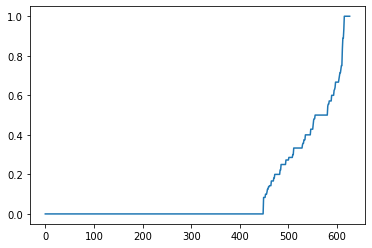

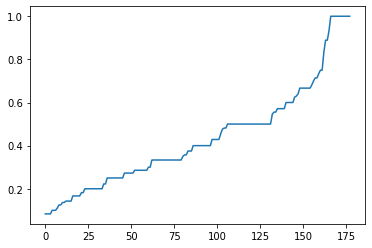

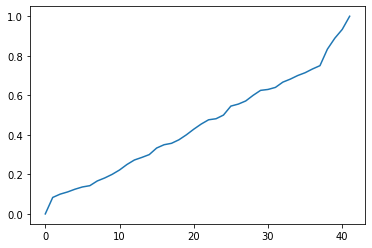

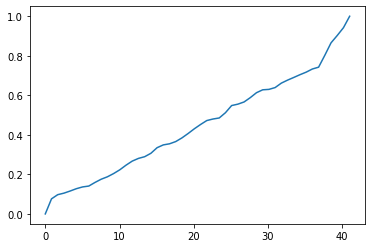

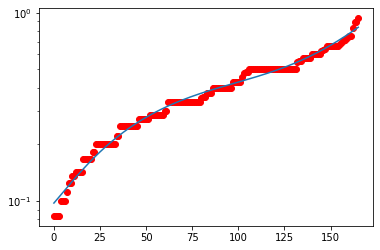

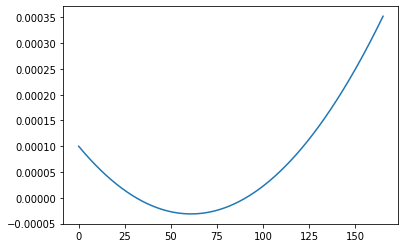

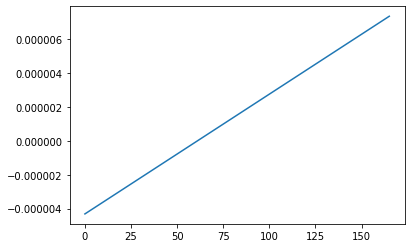

60.904303973086265
Eps = 0.30000000000000004


In [311]:
knn_dists(dists_for_lcs_unique, 2)

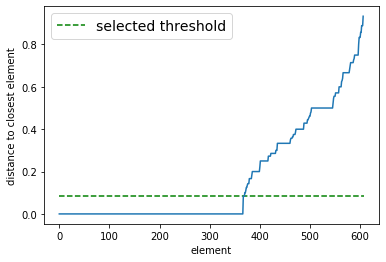

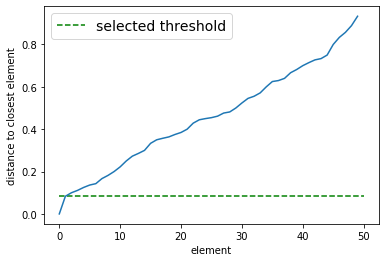

0.08333333333333337


(0.08333333333333337, 0.08333333333333337)

In [613]:
choose_threshold(dists_for_lcs_unique)

In [123]:
TUFANO_ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoActionsWithParents"

In [124]:
edit_scripts_for_unique = []

for double_num in tqdm_notebook(ids_per_unique_label):
    actions_file = open(TUFANO_ACTIONS_PATH + "/" + double_num + "/" + double_num + "/" + "sampleChange1")
    edit_script = actions_file.read().split("\n")
    edit_script = [elem for elem in edit_script if elem != '']
    
    edit_scripts_for_unique.append(edit_script)
    actions_file.close()


In [127]:
dists_for_lcs_unique = []

for es1 in tqdm_notebook(edit_scripts_for_unique):
    cur_dists = []
    for es2 in edit_scripts_for_unique:
        cur_lcs = lcs(es1, es2)
        dist = 1 - cur_lcs / max(len(es1), len(es2))
        cur_dists.append(dist)
    dists_for_lcs_unique.append(cur_dists)

In [131]:
find_eps_with_brute_force(dists_for_lcs_unique)

KeyboardInterrupt: 

In [602]:
dists_for_equals_unique = []

for es1 in tqdm_notebook(edit_scripts_for_unique):
    cur_dists = []
    for es2 in edit_scripts_for_unique:
        if es1 == es2:
            cur_dists.append(0.0)
        else:
            cur_dists.append(1.0)
    dists_for_equals_unique.append(cur_dists)

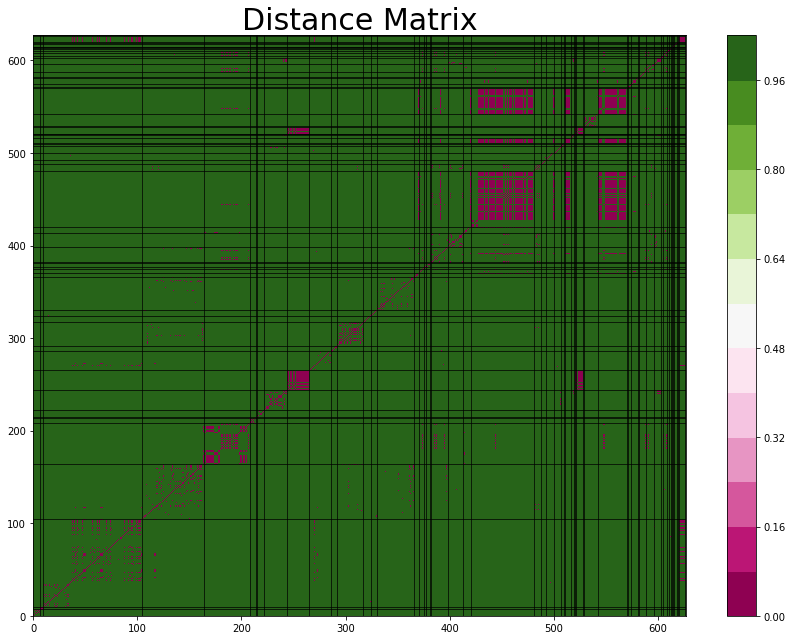

In [395]:
drawhist2(ids_per_unique_label, dists_for_equals_unique, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [396]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.1, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_equals_unique)
print_clustering_results_tufano_unique(tufano_clustering, dists_for_equals_unique,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
274 ['Remove statement']
296 ['Remove statement']
314 ['Remove statement']
346 ['Remove statement']
352 ['Remove statem

(93.389, 0.40334382673098323)

In [603]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.1, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_equals_unique)
print_clustering_results_tufano_unique(tufano_clustering, dists_for_equals_unique,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
274 ['Remove statement']
296 ['Remove statement']
314 ['Remove statement']
346 ['Remove statement']
352 ['Remove statem

(93.518, 0.4036603165548523)

In [65]:
RESULTS_BRUTE_TUFANO_1GRAM = "/Volumes/Seagate/Alina/result_for_tufano-1gram"

hist_len_1gram_brute = None

es_path = RESULTS_BRUTE_TUFANO_1GRAM + "/" + "edit_scripts_1grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_1gram_brute = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_1gram_brute)

244


In [66]:
hists_unique_brute_1gram = []

gram_path = "1gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_BRUTE_TUFANO_1GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_unique_brute_1gram.append(hist_data1)
    hist_file1.close()

In [67]:
RESULTS_BRUTE_TUFANO_2GRAM = "/Volumes/Seagate/Alina/result_for_tufano-2gram"

hist_len_2gram_brute = None

es_path = RESULTS_BRUTE_TUFANO_2GRAM + "/" + "edit_scripts_2grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_2gram_brute = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_2gram_brute)

482


In [68]:
hists_unique_brute_2gram = []

gram_path = "2gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_BRUTE_TUFANO_2GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    
    if os.path.exists(hist_path1):
        hist_file1 = open(hist_path1, "r")
        lines = hist_file1.read().split("\n")
        hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
        hists_unique_brute_2gram.append(hist_data1)
        hist_file1.close()
    else:
        hists_unique_brute_2gram.append([])
        

In [69]:
RESULTS_BRUTE_TUFANO_3GRAM = "/Volumes/Seagate/Alina/result_for_tufano-3gram"

hist_len_3gram_brute = None

es_path = RESULTS_BRUTE_TUFANO_3GRAM + "/" + "edit_scripts_3grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_3gram_brute = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_3gram_brute)

607


In [70]:
hists_unique_brute_3gram = []

gram_path = "3gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_BRUTE_TUFANO_3GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    
    if os.path.exists(hist_path1):
        hist_file1 = open(hist_path1, "r")
        lines = hist_file1.read().split("\n")
        hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
        hists_unique_brute_3gram.append(hist_data1)
        hist_file1.close()
    else:
        hists_unique_brute_3gram.append([])
        

In [71]:
RESULTS_BRUTE_TUFANO_4GRAM = "/Volumes/Seagate/Alina/result_for_tufano-4gram"

hist_len_4gram_brute = None

es_path = RESULTS_BRUTE_TUFANO_4GRAM + "/" + "edit_scripts_4grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_4gram_brute = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_4gram_brute)

656


In [72]:
hists_unique_brute_4gram = []

gram_path = "4gram"

for double_num in tqdm_notebook(ids_per_unique_label):
    hist_path1 = RESULTS_BRUTE_TUFANO_4GRAM + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    
    if os.path.exists(hist_path1):
        hist_file1 = open(hist_path1, "r")
        lines = hist_file1.read().split("\n")
        hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
        hists_unique_brute_4gram.append(hist_data1)
        hist_file1.close()
    else:
        hists_unique_brute_4gram.append([])
        

In [73]:
concat_hists_to_2gram = []

num_changes = len(hists_unique_brute_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_unique_brute_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_unique_brute_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_brute, amount))
        
    #for gram_ind, amount in hists_unique_3gram[i]:
    #    concat_hist.append((gram_ind + hist_len_1gram_tufano + hist_len_2gram_tufano, amount))
    
    concat_hists_to_2gram.append(concat_hist)

In [74]:
concat_hists_to_2gram_len = hist_len_1gram_brute + hist_len_2gram_brute

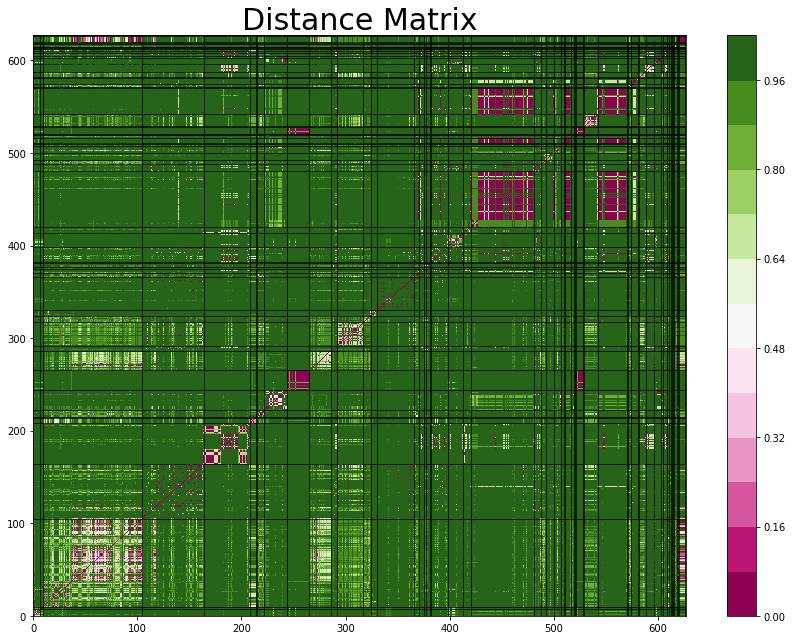

In [77]:
dists_unique_to_2gram = get_dists(concat_hists_to_2gram, canberra_metric, concat_hists_to_2gram_len)
drawhist2(ids_per_unique_label, dists_unique_to_2gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [265]:
find_eps_with_brute_force(dists_unique_to_2gram)


Best eps: 0.4848484848484848
Best F-measure: 0.47181979080579733


In [402]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.4848484848484848, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_to_2gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_to_2gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statemen

(93.599, 0.47181979080579733)

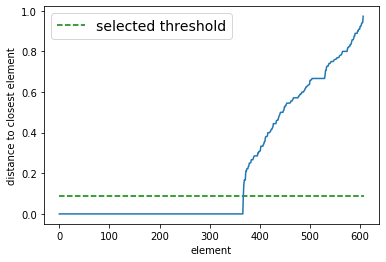

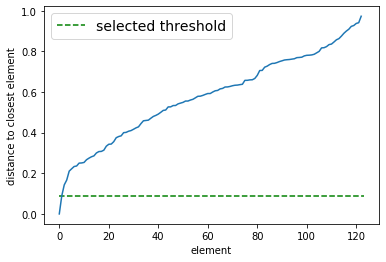

0.0888888888888889


(0.0888888888888889, 0.0888888888888889)

In [614]:
choose_threshold(dists_unique_to_2gram)

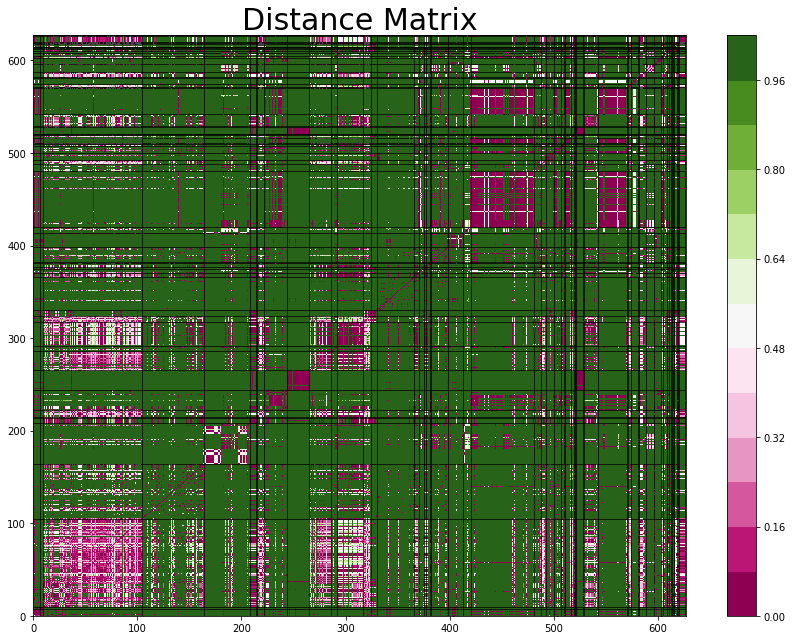

In [403]:
# Rerun!

dists_unique_to_2gram_jaccard = get_dists(concat_hists_to_2gram, jaccard_metric, concat_hists_to_2gram_len)
drawhist2(ids_per_unique_label, dists_unique_to_2gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [404]:
find_eps_with_brute_force(dists_unique_to_2gram_jaccard)


Best eps: 0.33333333333333337
Best F-measure: 0.15561176005222463


In [405]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.33333333333333337, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_to_2gram_jaccard)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_to_2gram_jaccard,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
392 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
441 ['Add braces to if statement']
468 ['Add braces to if statement']
2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
3 ['Remove statement']
9 ['Remove statement']
16 ['Remove statement']
35 ['Remove statement']
41 ['Remove statement']
53 ['Remove statement']
59 ['Remove statement']
61 ['Remove statement']
65 ['Remove statement']
69 ['Remove statement']
80 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
111 ['Remove statement']
118 ['Remove statement']
121 ['Remove statement']
123 ['Remove statement']
125 ['Remove statement']
132 ['Remove statement']
133 ['Remove statement']
135 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']

(19.34, 0.15561176005222463)

In [347]:
concat_hists_to_3gram = []

num_changes = len(hists_unique_brute_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hists_unique_brute_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_unique_brute_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_brute, amount))
        
    for gram_ind, amount in hists_unique_brute_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_brute + hist_len_2gram_brute, amount))
    
    concat_hists_to_3gram.append(concat_hist)

In [348]:
concat_hists_to_3gram_len = hist_len_1gram_brute + hist_len_2gram_brute + hist_len_3gram_brute

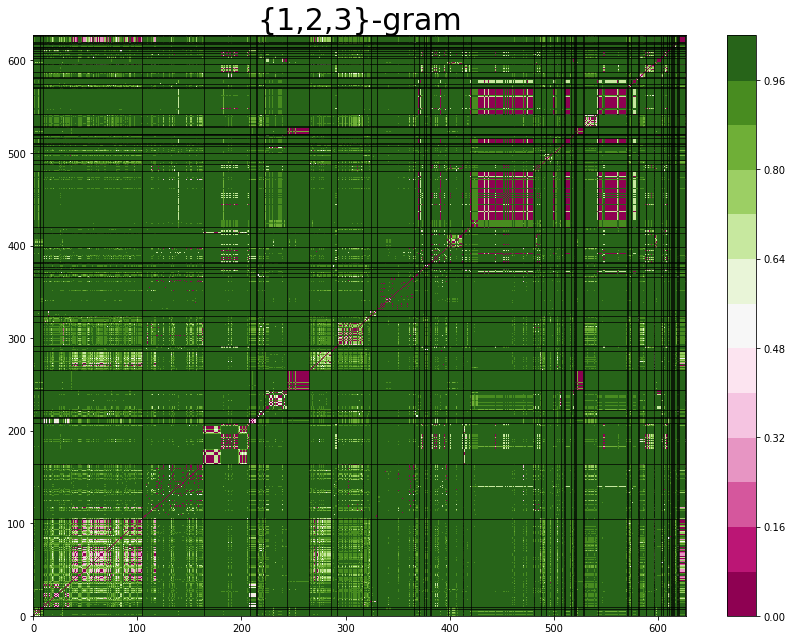

In [350]:
dists_unique_to_3gram = get_dists(concat_hists_to_3gram, canberra_metric, concat_hists_to_3gram_len)
drawhist2(ids_per_unique_label, dists_unique_to_3gram, False, lw=0.7, provided_lines_pos=unique_lines_poses,
         title="{1,2,3}-gram")

In [278]:
find_eps_with_brute_force(dists_unique_to_3gram)


Best eps: 0.6367647058823529
Best F-measure: 0.4730403309065522


In [406]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6367647058823529, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_to_3gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_to_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove

(93.315, 0.4730403309065522)

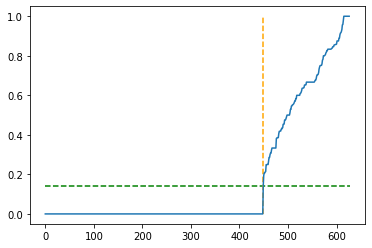

0.14285714285714285
449
CLUSTERS:

395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
93 ['Remove statement']
133 ['Remove statement']


9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
97 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


111 ['Remove statement']
132 ['Remove statement']


167 ['Remove statement']
188 ['Add null check']


197 ['Remove statement']
203 ['Remove statement']
214 ['Remove statement']
234 ['Remove statement']
274 ['Remove statement']
296 ['Remove statement']
314 ['Remove statement']
346 ['Remove stateme

(93.366, 0.40334382673098323)

In [465]:
eps, j = choose_eps(dists_unique_to_3gram, 2)
print(eps)
print(j)

tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, min_samples=2, metric='precomputed').fit(dists_unique_to_3gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_to_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

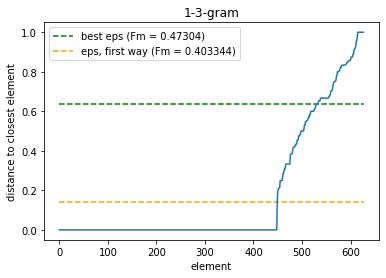

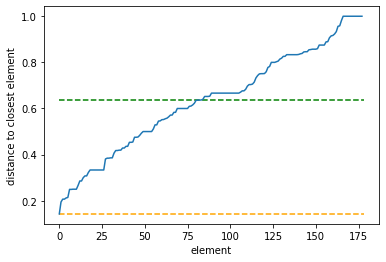

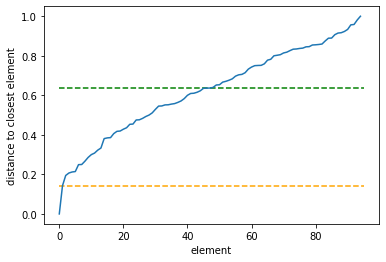

In [466]:
knn_dists_with_eps_line(dists_unique_to_3gram, 2, 0.6367647058823529, "1-3-gram", eps2=0.14285714285714285, fm1=0.47304, fm2=0.403344)


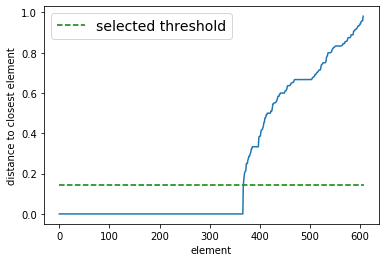

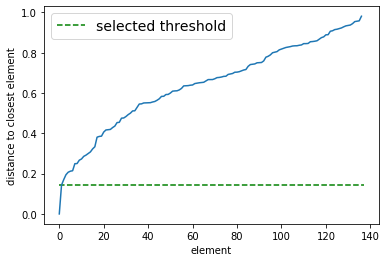

0.1428571428571428


(0.1428571428571428, 0.1428571428571428)

In [615]:
choose_threshold(dists_unique_to_3gram)

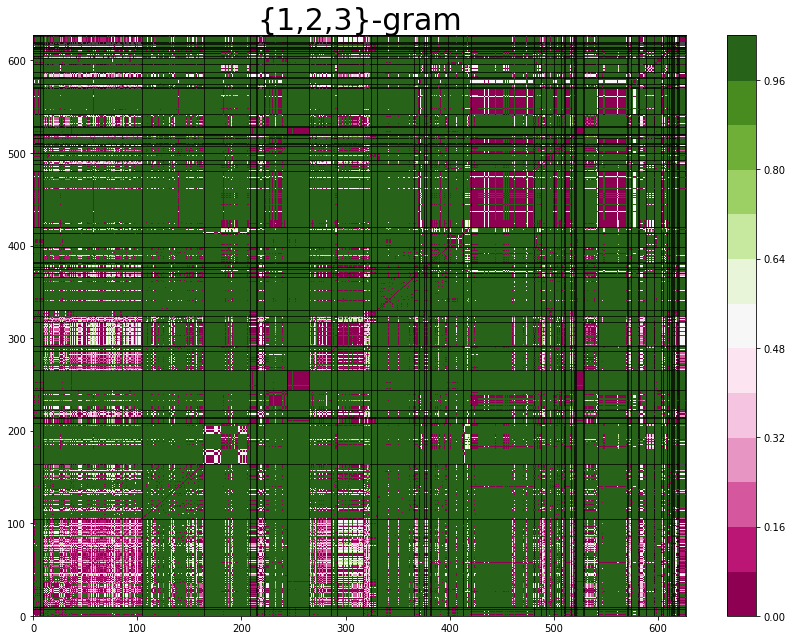

In [435]:
dists_unique_to_3gram_jaccard = get_dists(concat_hists_to_3gram, jaccard_metric, concat_hists_to_3gram_len)
drawhist2(ids_per_unique_label, dists_unique_to_3gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses,
         title="{1,2,3}-gram")

In [436]:
find_eps_with_brute_force(dists_unique_to_3gram_jaccard)


Best eps: 0.33333333333333337
Best F-measure: 0.15561176005222463


In [437]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.33333333333333337, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_to_3gram_jaccard)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_to_3gram_jaccard,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
392 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
441 ['Add braces to if statement']
468 ['Add braces to if statement']
2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
3 ['Remove statement']
9 ['Remove statement']
16 ['Remove statement']
35 ['Remove statement']
41 ['Remove statement']
53 ['Remove statement']
59 ['Remove statement']
61 ['Remove statement']
65 ['Remove statement']
69 ['Remove statement']
80 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
111 ['Remove statement']
118 ['Remove statement']
121 ['Remove statement']
123 ['Remove statement']
125 ['Remove statement']
132 ['Remove statement']
133 ['Remove statement']
135 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']

(19.34, 0.15561176005222463)

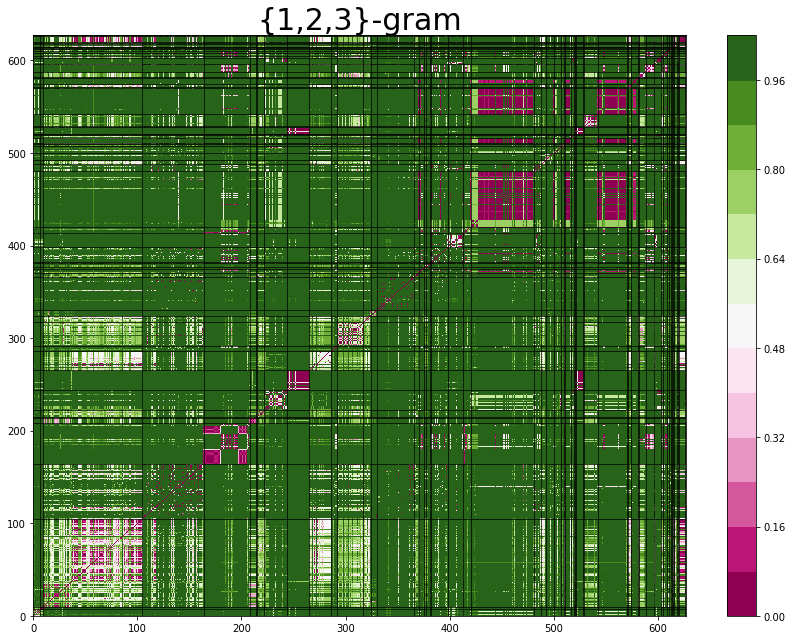

In [438]:
dists_unique_to_3gram_cos = get_dists(concat_hists_to_3gram, cos_distance, concat_hists_to_3gram_len)
drawhist2(ids_per_unique_label, dists_unique_to_3gram_cos, False, lw=0.7, provided_lines_pos=unique_lines_poses,
         title="{1,2,3}-gram")

In [439]:
find_eps_with_brute_force(dists_unique_to_3gram_cos)

KeyboardInterrupt: 

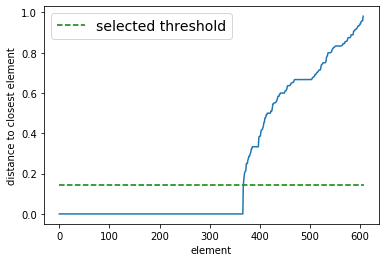

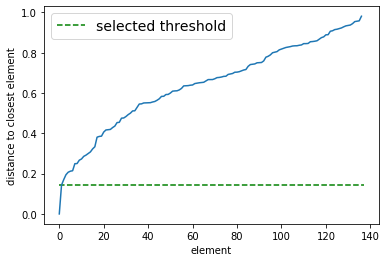

0.1428571428571428


(0.1428571428571428, 0.1428571428571428)

In [616]:
choose_threshold(dists_unique_to_3gram)

In [595]:
concat_hists_to_4gram = []

num_changes = len(hists_unique_brute_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hists_unique_brute_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_unique_brute_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_brute, amount))
        
    for gram_ind, amount in hists_unique_brute_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_brute + hist_len_2gram_brute, amount))
        
    for gram_ind, amount in hists_unique_brute_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_brute + hist_len_2gram_brute + hist_len_3gram_brute, amount))
    
    concat_hists_to_4gram.append(concat_hist)

In [598]:
concat_hists_to_4gram_len = hist_len_1gram_brute + hist_len_2gram_brute + hist_len_3gram_brute + hist_len_4gram_brute

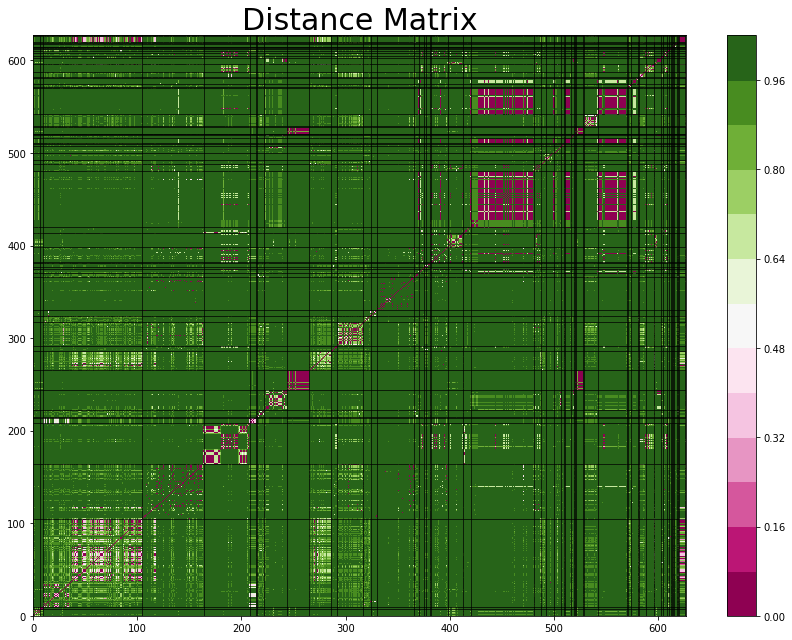

In [599]:
dists_unique_to_4gram = get_dists(concat_hists_to_4gram, canberra_metric, concat_hists_to_4gram_len)
drawhist2(ids_per_unique_label, dists_unique_to_4gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [309]:
find_eps_with_brute_force(dists_unique_to_4gram)


Best eps: 0.6976744186046512
Best F-measure: 0.47486990820439806


In [410]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6976744186046512, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_to_4gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_to_4gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove

(92.3, 0.47486990820439806)

In [601]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6976744186046512, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_to_4gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_to_4gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove

(92.3, 0.47486990820439806)

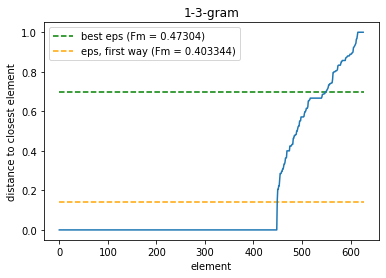

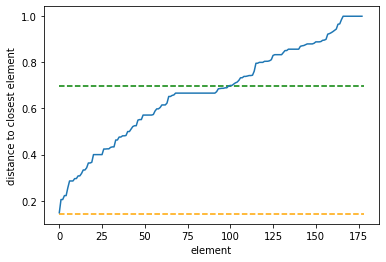

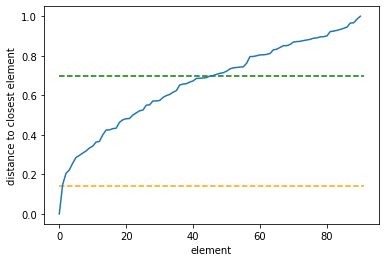

In [467]:
knn_dists_with_eps_line(dists_unique_to_4gram, 2, 0.6976744186046512, "1-3-gram", eps2=0.14285714285714285, fm1=0.47304, fm2=0.403344)


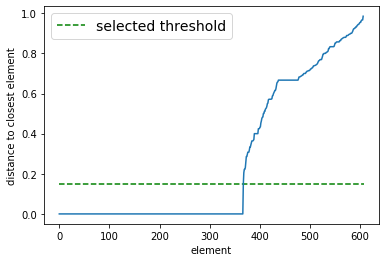

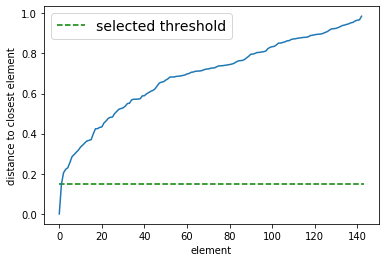

0.14814814814814814


(0.14814814814814814, 0.14814814814814814)

In [617]:
choose_threshold(dists_unique_to_4gram)

In [ ]:
# save point

In [411]:
concat_hists_13gram = []

num_changes = len(hists_unique_brute_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hists_unique_brute_1gram[i]:
        concat_hist.append((gram_ind, amount))
        
    for gram_ind, amount in hists_unique_brute_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_brute, amount))
    
    concat_hists_13gram.append(concat_hist)

In [412]:
concat_hists_13gram_len = hist_len_1gram_brute + hist_len_3gram_brute

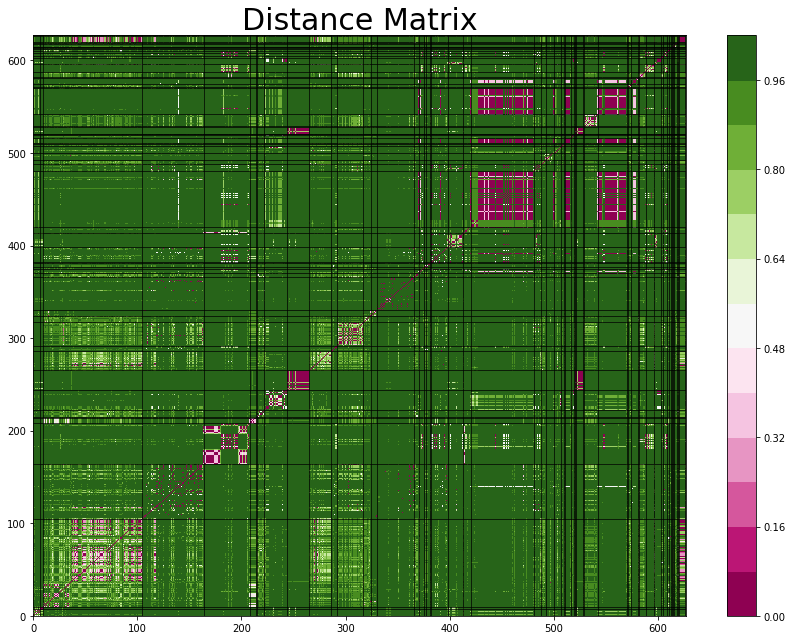

In [413]:
dists_unique_13gram = get_dists(concat_hists_13gram, canberra_metric, concat_hists_13gram_len)
drawhist2(ids_per_unique_label, dists_unique_13gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [284]:
find_eps_with_brute_force(dists_unique_13gram)


Best eps: 0.6194444444444445
Best F-measure: 0.46626959782204136


In [414]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6194444444444445, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_13gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_13gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove

(91.049, 0.46626959782204136)

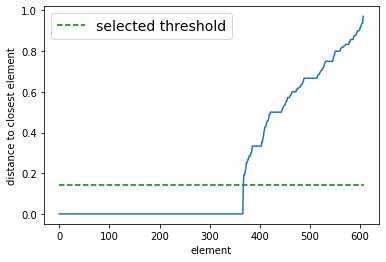

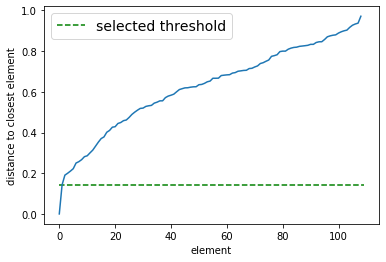

0.1428571428571428


(0.1428571428571428, 0.1428571428571428)

In [619]:
choose_threshold(dists_unique_13gram)

In [78]:
def get_hist_len(results_path, gram):
    hist_len = None

    es_path = results_path + "/" + "edit_scripts_" + gram + "s_mapped.txt"
    es_file = open(es_path, "r")
    es_lines = es_file.read().split("\n")
    hist_len = int(es_lines[-2].split(" ")[0][:-1]) + 1
    es_file.close()

    print(hist_len)
    
    return hist_len

In [79]:
hist_parents_len_1gram = get_hist_len("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "1gram")
hist_parents_len_2gram = get_hist_len("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "2gram")
hist_parents_len_3gram = get_hist_len("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "3gram")
hist_parents_len_4gram = get_hist_len("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "4gram")
hist_parents_len_5gram = get_hist_len("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "5gram")
#hist_parents_len_6gram = get_hist_len("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "6gram")
concat_hists_parents_to_2gram_len = hist_parents_len_1gram + hist_parents_len_2gram
concat_hists_parents_to_3gram_len = hist_parents_len_1gram + hist_parents_len_2gram + hist_parents_len_3gram
concat_hists_parents_to_4gram_len = hist_parents_len_1gram + hist_parents_len_2gram + hist_parents_len_3gram + hist_parents_len_4gram


336
616
733
733
669


In [80]:
def load_hists(hists_path, gram_path):
    hists = []

    for double_num in tqdm_notebook(ids_per_unique_label):
        hist_path1 = hists_path + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"

        if os.path.exists(hist_path1):
            hist_file1 = open(hist_path1, "r")
            lines = hist_file1.read().split("\n")
            hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
            hists.append(hist_data1)
            hist_file1.close()
        else:
            hists.append([])
            
    return hists

In [81]:
hist_parents_1gram = load_hists("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "1gram")
hist_parents_2gram = load_hists("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "2gram")
hist_parents_3gram = load_hists("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "3gram")
hist_parents_4gram = load_hists("/Volumes/Seagate/Alina/result_for_all_labeled_tufano_with_parents", "4gram")

In [82]:
concat_hists_parents_4gram = []

num_changes = len(hist_parents_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hist_parents_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hist_parents_2gram[i]:
        concat_hist.append((gram_ind + hist_parents_len_1gram, amount))
        
    for gram_ind, amount in hist_parents_3gram[i]:
        concat_hist.append((gram_ind + hist_parents_len_1gram + hist_parents_len_2gram, amount))
        
    for gram_ind, amount in hist_parents_4gram[i]:
        concat_hist.append((gram_ind + hist_parents_len_1gram + hist_parents_len_2gram + hist_parents_len_3gram, amount))
    
    concat_hists_parents_4gram.append(concat_hist)

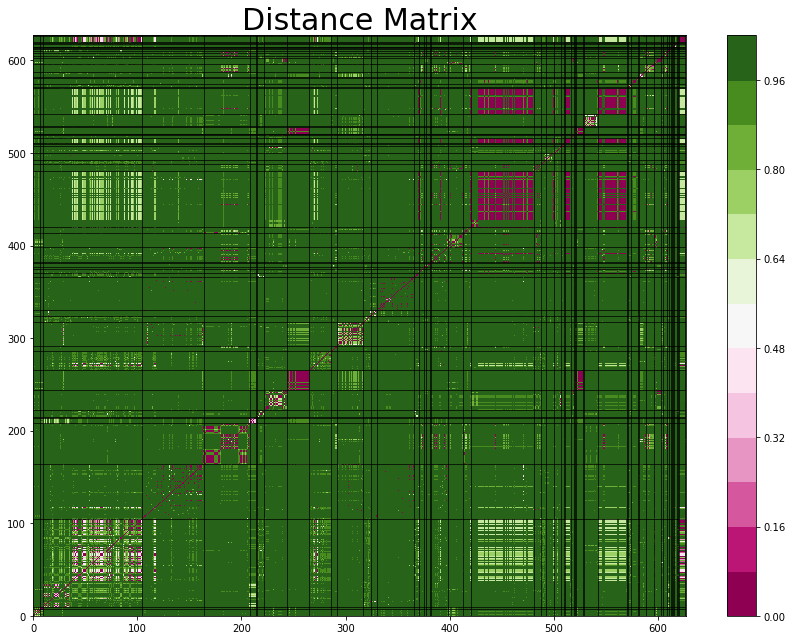

In [85]:
dists_unique_parents_to_4gram = get_dists(concat_hists_parents_4gram, canberra_metric, concat_hists_parents_to_4gram_len)
drawhist2(ids_per_unique_label, dists_unique_parents_to_4gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [84]:
find_eps_with_brute_force(dists_unique_parents_to_4gram)

NameError: name 'print_clustering_results_tufano_unique' is not defined

In [423]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6976744186046512, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_parents_to_4gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_parents_to_4gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove

(93.628, 0.4808482759024868)

Find spanning tree...


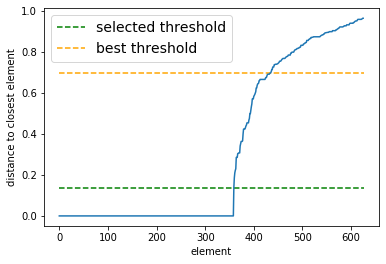

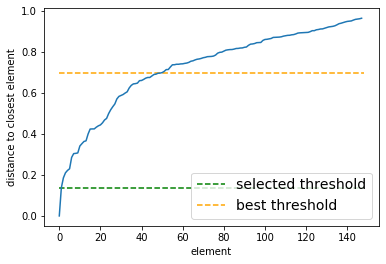

0.13793103448275867


(0.13793103448275867, 0.13793103448275867)

In [90]:
choose_threshold(dists_unique_parents_to_4gram, draw_eps=0.6976744186046512)

In [122]:
dists_unique_parents_to_4gram_jaccard = get_dists(concat_hists_parents_4gram, jaccard_metric, concat_hists_parents_to_4gram_len)
find_eps_with_brute_force(dists_unique_parents_to_4gram_jaccard)
#drawhist2(ids_per_unique_label, dists_unique_parents_to_4gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

NameError: name 'print_clustering_results_tufano_unique' is not defined

In [91]:
concat_hists_parents_3gram = []

num_changes = len(hist_parents_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hist_parents_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hist_parents_2gram[i]:
        concat_hist.append((gram_ind + hist_parents_len_1gram, amount))
        
    for gram_ind, amount in hist_parents_3gram[i]:
        concat_hist.append((gram_ind + hist_parents_len_1gram + hist_parents_len_2gram, amount))
            
    concat_hists_parents_3gram.append(concat_hist)

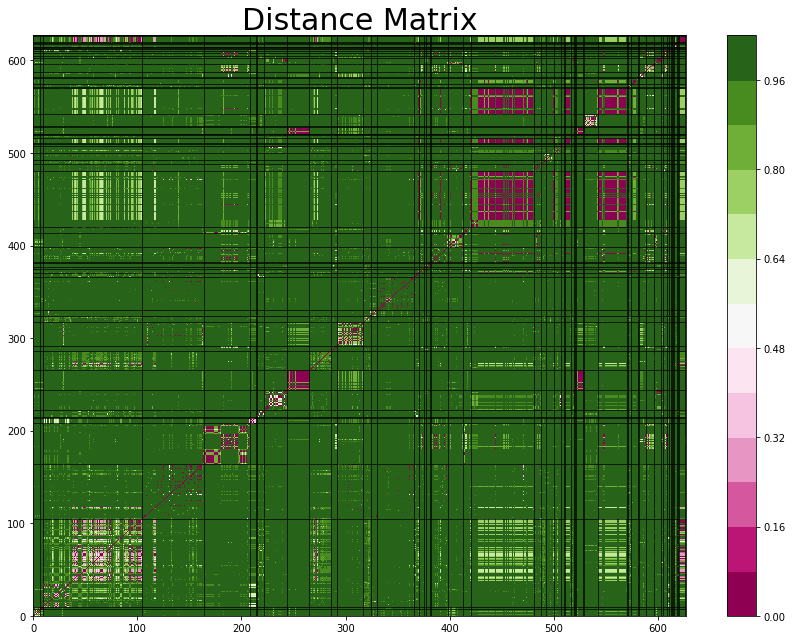

In [92]:
dists_unique_parents_to_3gram = get_dists(concat_hists_parents_3gram, canberra_metric, concat_hists_parents_to_3gram_len)
drawhist2(ids_per_unique_label, dists_unique_parents_to_3gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [52]:
find_eps_with_brute_force(dists_unique_parents_to_3gram)


Best eps: 0.6363636363636364
Best F-measure: 0.4827662409783466


In [426]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6363636363636364, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_parents_to_3gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_parents_to_3gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']
6 ['Abstract an existing method using the abstract keyword']
30 ['Abstract an existing method using the abstract keyword']
38 ['Abstract an existing method using the abstract keyword']
48 ['Abstract an existing method using the abstract keyword']
90 ['Abstract an existing method using the abstract keyword']
95 ['Abstract an existing method using the abstract keyword']


16 ['Remove statement']
56 ['Remove

(93.699, 0.4827662409783466)

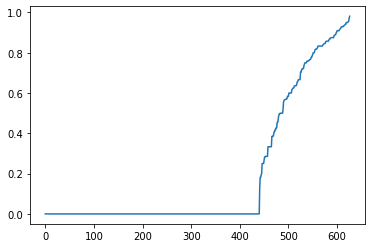

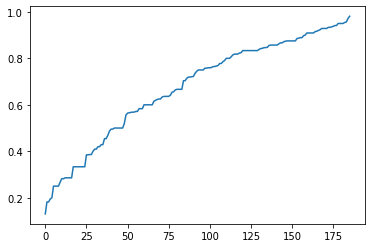

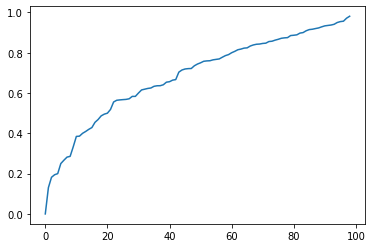

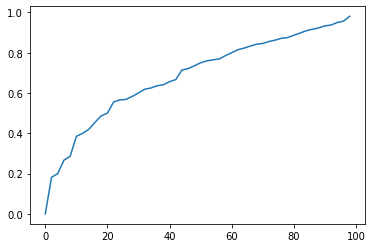

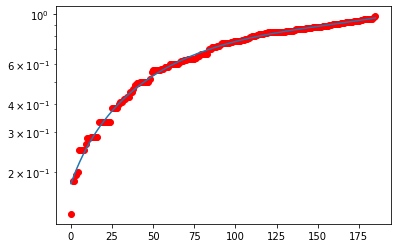

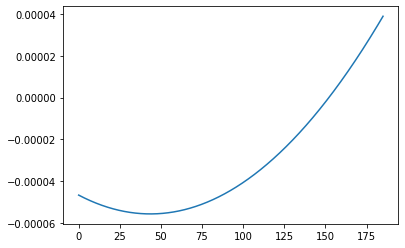

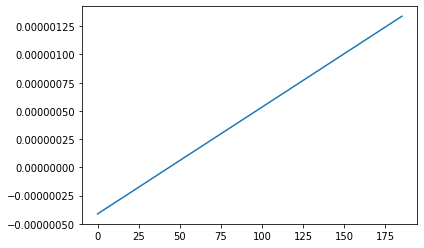

43.61781616878496
Eps = 0.5


In [64]:
knn_dists(dists_unique_parents_to_3gram, 2)

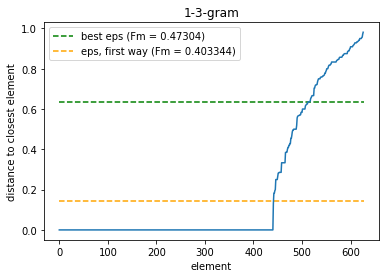

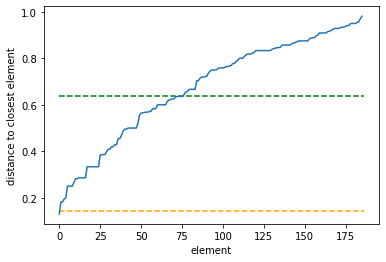

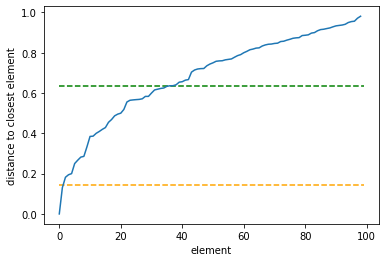

In [468]:
knn_dists_with_eps_line(dists_unique_parents_to_3gram, 2, 0.6363636363636364, "1-3-gram", eps2=0.14285714285714285, fm1=0.47304, fm2=0.403344)


Find spanning tree...


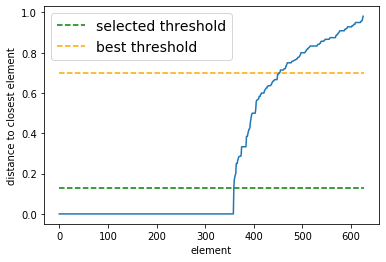

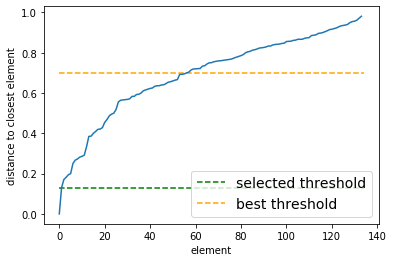

0.13043478260869568


(0.13043478260869568, 0.13043478260869568)

In [93]:
choose_threshold(dists_unique_parents_to_3gram, draw_eps=0.6976744186046512)

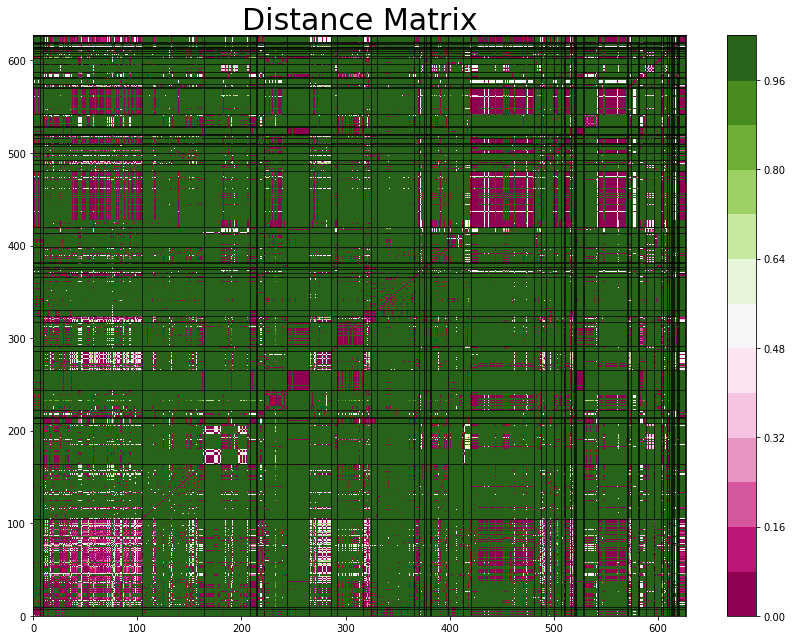

In [440]:
dists_unique_parents_to_3gram_jaccard = get_dists(concat_hists_parents_3gram, jaccard_metric, concat_hists_parents_to_3gram_len)
drawhist2(ids_per_unique_label, dists_unique_parents_to_3gram_jaccard, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [441]:
find_eps_with_brute_force(dists_unique_parents_to_3gram_jaccard)


Best eps: 0.33333333333333337
Best F-measure: 0.11026472375203145


In [442]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.33333333333333337, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_parents_to_3gram_jaccard)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_parents_to_3gram_jaccard,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
392 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
441 ['Add braces to if statement']
468 ['Add braces to if statement']
2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']
3 ['Remove statement']
9 ['Remove statement']
16 ['Remove statement']
35 ['Remove statement']
41 ['Remove statement']
53 ['Remove statement']
59 ['Remove statement']
61 ['Remove statement']
65 ['Remove statement']
69 ['Remove statement']
80 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
111 ['Remove statement']
118 ['Remove statement']
121 ['Remove statement']
123 ['Remove statement']
125 ['Remove statement']
132 ['Remove statement']
133 ['Remove statement']
135 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']

(5.908, 0.11026472375203145)

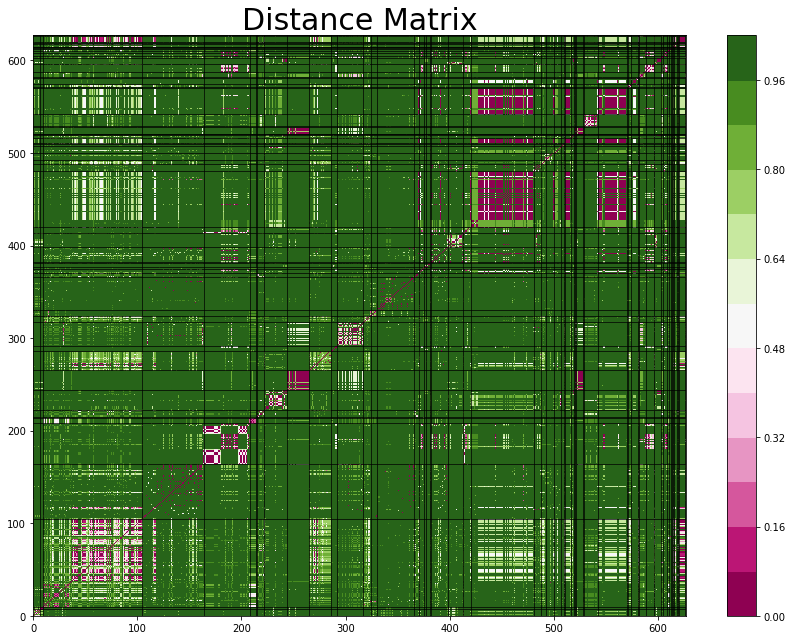

In [427]:
dists_unique_parents_to_3gram_cos = get_dists(concat_hists_parents_3gram, cos_distance, concat_hists_parents_to_3gram_len)
drawhist2(ids_per_unique_label, dists_unique_parents_to_3gram_cos, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [121]:
find_eps_with_brute_force(dists_unique_parents_to_3gram_cos)


Best eps: 0.35402480650006074
Best F-measure: 0.46605449459062115


In [428]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.35402480650006074, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_parents_to_3gram_cos)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_parents_to_3gram_cos,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']
445 ['Move existing statements out of try block']
474 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
197 ['Remove statement']
203 ['Remove statement']
210 ['Remove statement']
211 ['Remove sta

(93.214, 0.46605449459062115)

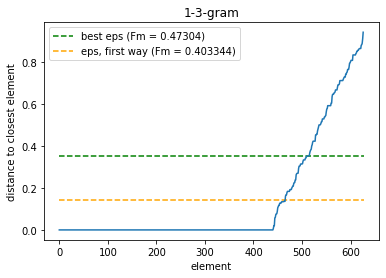

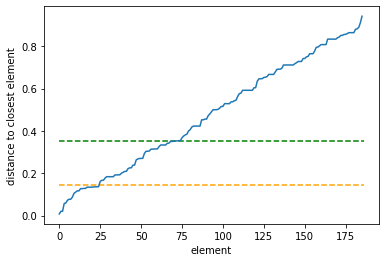

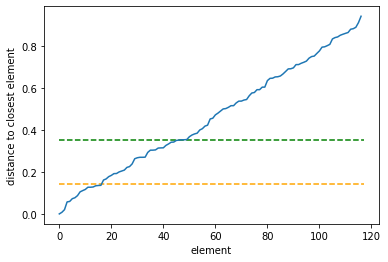

In [469]:
knn_dists_with_eps_line(dists_unique_parents_to_3gram_cos, 2, 0.35402480650006074, "1-3-gram", eps2=0.14285714285714285, fm1=0.47304, fm2=0.403344)


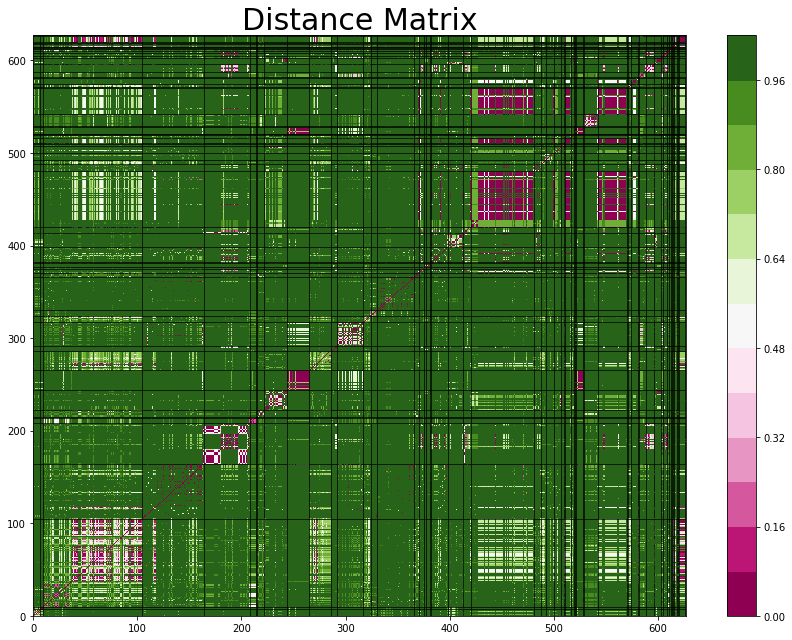

In [443]:
dists_unique_parents_to_3gram_pearson = get_dists(concat_hists_parents_3gram, pearsons_correlation, concat_hists_parents_to_3gram_len)
drawhist2(ids_per_unique_label, dists_unique_parents_to_3gram_pearson, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [444]:
find_eps_with_brute_force(dists_unique_parents_to_3gram_pearson)


Best eps: 0.35447341083398587
Best F-measure: 0.46605449459062115


In [ ]:
# remember

In [445]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.35447341083398587, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_parents_to_3gram_pearson)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_parents_to_3gram_pearson,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']
445 ['Move existing statements out of try block']
474 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
197 ['Remove statement']
203 ['Remove statement']
210 ['Remove statement']
211 ['Remove sta

(93.214, 0.46605449459062115)

In [94]:
concat_hists_parents_2gram = []

num_changes = len(hist_parents_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hist_parents_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hist_parents_2gram[i]:
        concat_hist.append((gram_ind + hist_parents_len_1gram, amount))
                    
    concat_hists_parents_2gram.append(concat_hist)

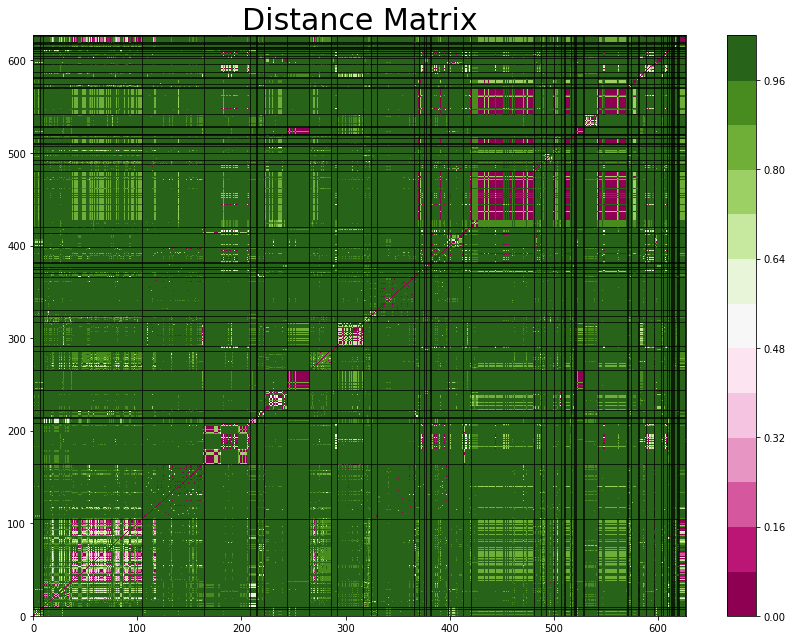

In [95]:
dists_unique_parents_to_2gram = get_dists(concat_hists_parents_2gram, canberra_metric, concat_hists_parents_to_2gram_len)
drawhist2(ids_per_unique_label, dists_unique_parents_to_2gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [431]:
find_eps_with_brute_force(dists_unique_parents_to_2gram)


Best eps: 0.5714285714285714
Best F-measure: 0.4883741853903013


In [432]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.5714285714285714, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_parents_to_2gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_parents_to_2gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
409 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']
445 ['Move existing statements out of try block']
474 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
111 ['Remove statement']
121 ['Remove statement']
132 ['

(93.501, 0.4883741853903013)

Find spanning tree...


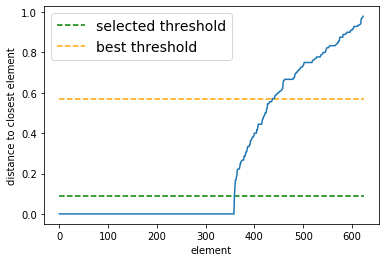

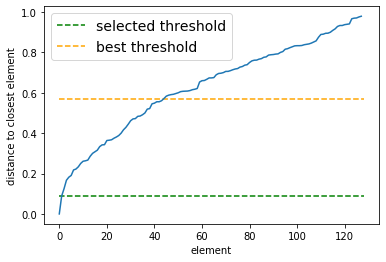

0.0888888888888889


(0.0888888888888889, 0.0888888888888889)

In [96]:
choose_threshold(dists_unique_parents_to_2gram, draw_eps=0.5714285714285714)

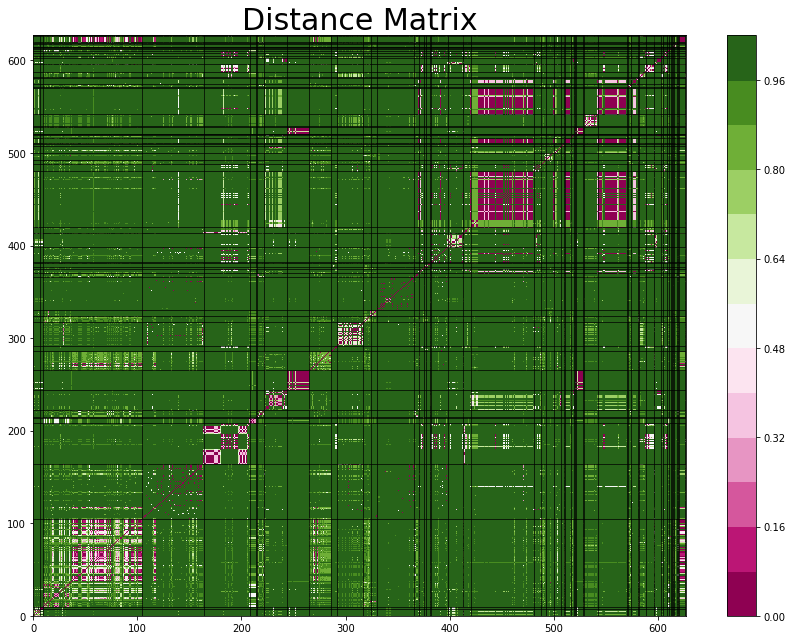

In [97]:
dists_unique_parents_1gram = get_dists(hist_parents_1gram, canberra_metric, hist_parents_len_1gram)
drawhist2(ids_per_unique_label, dists_unique_parents_1gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

In [46]:
find_eps_with_brute_force(dists_unique_parents_1gram)


Best eps: 0.42857142857142855
Best F-measure: 0.49976354654798766


In [434]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.42857142857142855, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_unique_parents_1gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_unique_parents_1gram,
                                unique_label_to_changes, from_change_to_unique_label, ids_per_unique_label,
                                      without_outliers=True)

CLUSTERS:

1 ['Add braces to if statement']
395 ['Add braces to if statement']
426 ['Add braces to if statement']
468 ['Add braces to if statement']


2 ['Forbid overriding: add final to method']
45 ['Forbid overriding: add final to method']
466 ['Forbid overriding: add final to method']


3 ['Remove statement']
9 ['Remove statement']
35 ['Remove statement']
59 ['Remove statement']
92 ['Remove statement']
93 ['Remove statement']
97 ['Remove statement']
110 ['Remove statement']
133 ['Remove statement']
137 ['Remove statement']
138 ['Remove statement']


16 ['Remove statement']
56 ['Remove condition']


53 ['Remove statement']
24 ['Move existing statements out of try block']
136 ['Move existing statements out of try block']
445 ['Move existing statements out of try block']
474 ['Move existing statements out of try block']


65 ['Remove statement']
135 ['Remove statement']


69 ['Remove statement']
111 ['Remove statement']
121 ['Remove statement']
132 ['Remove statement']
149 ['Remove sta

(93.544, 0.49976354654798766)

Find spanning tree...


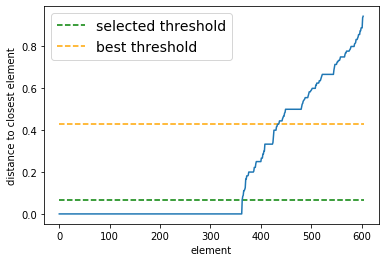

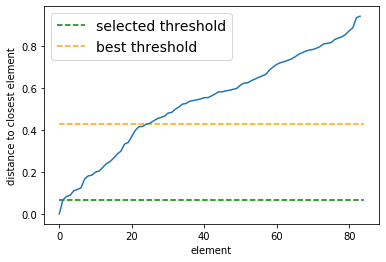

0.06666666666666665


(0.06666666666666665, 0.06666666666666665)

In [98]:
choose_threshold(dists_unique_parents_1gram, draw_eps=0.42857142857142855)

In [132]:
dists_unique_parents_1gram_jaccard = get_dists(hist_parents_1gram, jaccard_metric, hist_parents_len_1gram)
find_eps_with_brute_force(dists_unique_parents_1gram_jaccard)
#drawhist2(ids_per_unique_label, dists_unique_parents_1gram, False, lw=0.7, provided_lines_pos=unique_lines_poses)

KeyboardInterrupt: 

# Full Tufano Dataset

In [1484]:
RESULTS_FOR_HIST_PATH_FULL_TUFANO_3GRAM = "/Volumes/Seagate/Alina/result_for_full_tufano-3gram"

In [1485]:
sorted_dirs_full = [os.fsdecode(el) for el in os.listdir(RESULTS_FOR_HIST_PATH_FULL_TUFANO_3GRAM) 
               if os.path.isdir(RESULTS_FOR_HIST_PATH_FULL_TUFANO_3GRAM + "/" + os.fsdecode(el))]
sorted_dirs_full = sorted(sorted_dirs_full, key=lambda s: int(s.split(" ")[0])) 

In [1487]:
len(sorted_dirs_full)

21206

In [1489]:
hists_full_tufano_3gram = []

gram_path = "3gram"

for double_num in tqdm_notebook(sorted_dirs_full):
    hist_path1 = RESULTS_FOR_HIST_PATH_FULL_TUFANO_3GRAM + "/" + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
    hist_file1 = open(hist_path1, "r")
    lines = hist_file1.read().split("\n")
    hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
    hists_full_tufano_3gram.append(hist_data1)
    hist_file1.close()

In [1495]:
hists_full_tufano_3gram[667]

[(28, 1),
 (45, 1),
 (52, 1),
 (83, 1),
 (99, 1),
 (462, 1),
 (4311, 1),
 (5093, 1),
 (7658, 1),
 (8698, 1)]

In [1490]:
hist_len_3gram_full_tufano = None

es_path = RESULTS_FOR_HIST_PATH_FULL_TUFANO_3GRAM + "/" + "edit_scripts_3grams_mapped.txt"
es_file = open(es_path, "r")
es_lines = es_file.read().split("\n")
hist_len_3gram_full_tufano = int(es_lines[-2].split(" ")[0][:-1]) + 1
es_file.close()

print(hist_len_3gram_full_tufano)

13215


In [1496]:
dists_full_tufano_3gram = get_dists(hists_full_tufano_3gram, canberra_metric, hist_len_3gram_full_tufano)


In [1498]:
PATH_FOR_METRICS = "/Volumes/Seagate/Alina/calculated_dists_full_tufano_3gram.txt"
#os.makedirs(PATH_FOR_METRICS)

metrics_file = open(PATH_FOR_METRICS, "w")
for i in tqdm_notebook(dists_full_tufano_3gram):
    for j in i:
        metrics_file.write(str(j) + " ")
    metrics_file.write("\n")
metrics_file.close()

In [302]:
# Getting metrics
PATH_FOR_METRICS = "/Volumes/Seagate/Alina/calculated_dists_full_tufano_3gram.txt"

metrics_file = open(PATH_FOR_METRICS, "r")

metrics = []

content = metrics_file.read()
lines = [line for line in content.split("\n") if line != ""]

for line in tqdm_notebook(lines):
    values = [float(x) for x in line.split(" ") if x != ""]
    metrics.append(values)

metrics_file.close()

In [303]:
print(len(metrics))
print(len(metrics[0]))

21206
21206


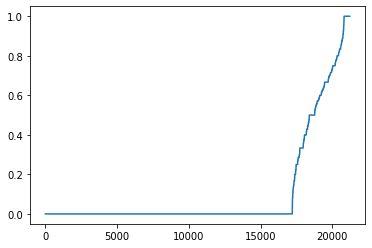

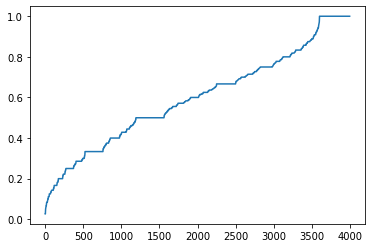

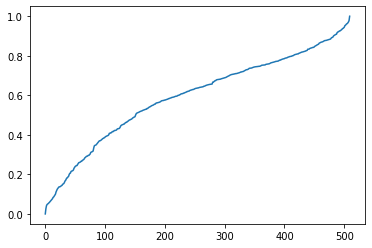

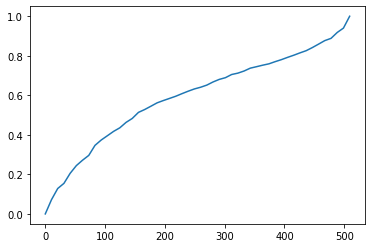

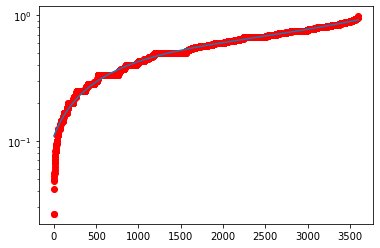

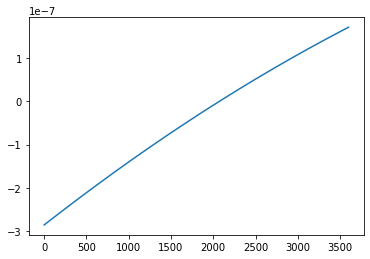

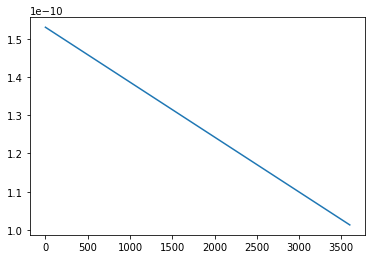

10659.40011645178


IndexError: index 10659 is out of bounds for axis 0 with size 3601

In [306]:
knn_dists(metrics, 2)

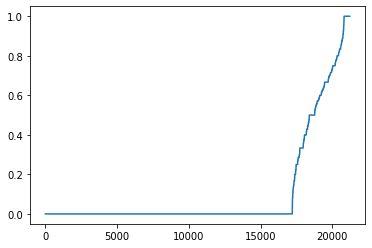

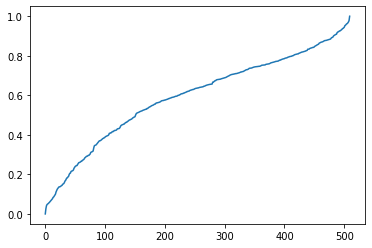

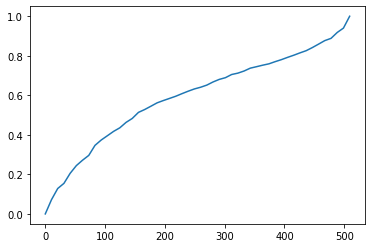

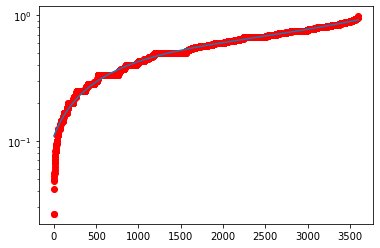

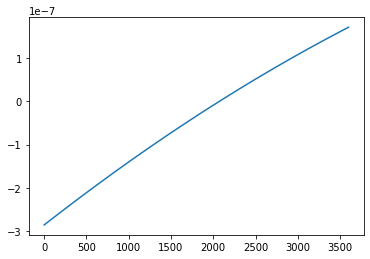

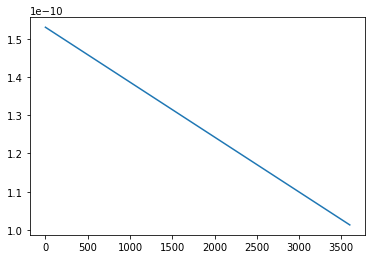

10659.40011645178


IndexError: index 10659 is out of bounds for axis 0 with size 3601

In [1501]:
knn_dists(dists_full_tufano_3gram, 2)

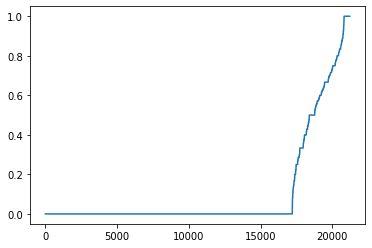

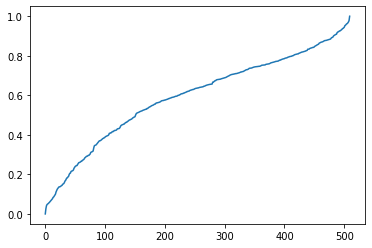

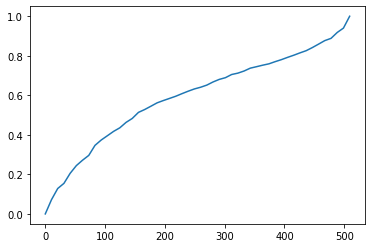

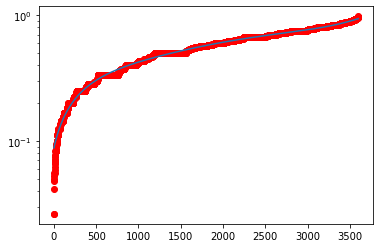

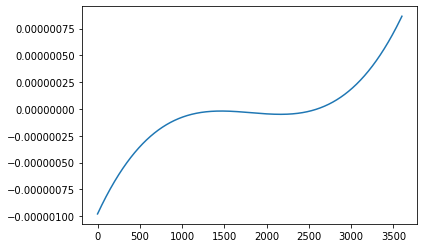

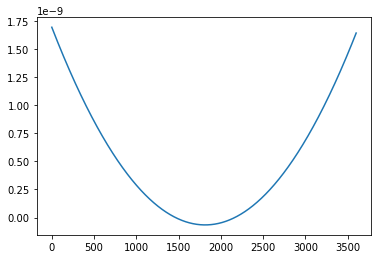

1463.1995141398259
Eps = 0.5


In [1502]:
knn_dists(dists_full_tufano_3gram, 2, for_spline=(10, 5))

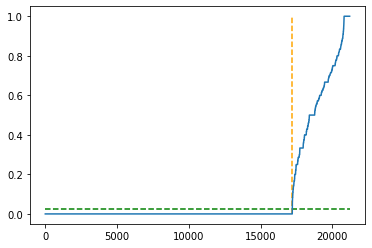

0.02631578947368421


In [1585]:
eps, j = choose_eps(dists_full_tufano_3gram_np, 2)
print(eps)

In [1507]:
dists_full_tufano_3gram_np = np.array(dists_full_tufano_3gram)

In [1562]:
%reset_selective -f "^dists_full_tufano_3gram$"

In [1508]:
dists_full_tufano_3gram_np[:5, :5]

array([[0.        , 0.87777778, 0.88888889, 1.        , 1.        ],
       [0.87777778, 0.        , 0.96031746, 1.        , 1.        ],
       [0.88888889, 0.96031746, 0.        , 1.        , 1.        ],
       [1.        , 1.        , 1.        , 0.        , 1.        ],
       [1.        , 1.        , 1.        , 1.        , 0.        ]])

In [1524]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.65, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_full_tufano_3gram_np)

In [1525]:
print(len(tufano_clustering.labels_))
print(tufano_clustering.labels_[:10])

21206
[ 0  0  0  1  2 -1  3  4  0  5]


In [1539]:
file_labels = open("/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/full_tufano_labels_3gram.txt", "w")

for lbl in tufano_clustering.labels_:
    file_labels.write(str(lbl) + " ")
    
file_labels.close()

In [1526]:
clusters_for_full = collections.defaultdict(list)

In [1527]:
for i in range(len(tufano_clustering.labels_)):
    clr = tufano_clustering.labels_[i]
    clusters_for_full[clr].append(sorted_dirs_full[i])

In [1529]:
sorted_clusters_for_full = sorted(clusters_for_full, 
                                  key=lambda clr: len(clusters_for_full[clr]), 
                                  reverse=True)

In [1531]:
sorted_clusters_for_full

[0,
 -1,
 16,
 54,
 136,
 4,
 62,
 72,
 6,
 13,
 21,
 141,
 2,
 48,
 70,
 1,
 26,
 177,
 97,
 71,
 22,
 28,
 167,
 108,
 675,
 171,
 23,
 444,
 38,
 119,
 27,
 32,
 823,
 24,
 89,
 290,
 455,
 66,
 14,
 643,
 237,
 304,
 8,
 12,
 20,
 60,
 34,
 37,
 94,
 51,
 33,
 843,
 210,
 222,
 86,
 92,
 116,
 175,
 332,
 85,
 170,
 3,
 69,
 118,
 152,
 161,
 115,
 124,
 888,
 79,
 488,
 105,
 287,
 214,
 394,
 759,
 65,
 78,
 179,
 373,
 10,
 57,
 160,
 162,
 676,
 102,
 334,
 538,
 197,
 630,
 779,
 390,
 740,
 211,
 337,
 43,
 151,
 188,
 228,
 536,
 860,
 103,
 209,
 621,
 52,
 110,
 121,
 437,
 633,
 306,
 694,
 755,
 17,
 111,
 855,
 18,
 35,
 42,
 183,
 231,
 398,
 664,
 699,
 819,
 841,
 11,
 84,
 106,
 113,
 114,
 144,
 155,
 157,
 190,
 193,
 310,
 445,
 449,
 677,
 763,
 49,
 73,
 200,
 201,
 205,
 324,
 357,
 760,
 766,
 36,
 63,
 182,
 218,
 240,
 276,
 291,
 344,
 352,
 369,
 397,
 426,
 640,
 820,
 41,
 127,
 131,
 139,
 256,
 333,
 371,
 385,
 439,
 456,
 462,
 641,
 847,
 916,
 933

In [1561]:
print("NUM CLUSTERS:", len(sorted_clusters_for_full), '\n')
lens = []

more_than_10 = 0

for clr in sorted_clusters_for_full:
    if clr == -1:
        print("Outliers")
    else:
        lens.append(len(clusters_for_full[clr]))
    
    if len(clusters_for_full[clr]) >= 10:
        more_than_10 += 1
    
    print("Cluster size:", len(clusters_for_full[clr]))
    print(clusters_for_full[clr][:10])
    print()
    
print(more_than_10)

NUM CLUSTERS: 1240 

Cluster size: 6069
['1 1', '2 2', '3 3', '9 9', '12 12', '18 18', '20 20', '23 23', '28 28', '30 30']

Outliers
Cluster size: 1765
['6 6', '11 11', '24 24', '38 38', '52 52', '53 53', '66 66', '70 70', '71 71', '78 78']

Cluster size: 1482
['27 27', '31 31', '55 55', '67 67', '74 74', '85 85', '144 144', '162 162', '195 195', '259 259']

Cluster size: 799
['134 134', '167 167', '184 184', '187 187', '264 264', '270 270', '319 319', '323 323', '332 332', '343 343']

Cluster size: 541
['439 439', '468 468', '1024 1024', '2114 2114', '2266 2266', '2420 2420', '2657 2657', '2995 2995', '3096 3096', '3260 3260']

Cluster size: 273
['8 8', '228 228', '287 287', '434 434', '457 457', '489 489', '563 563', '607 607', '651 651', '656 656']

Cluster size: 256
['158 158', '283 283', '391 391', '553 553', '577 577', '675 675', '794 794', '1033 1033', '1050 1050', '1321 1321']

Cluster size: 251
['181 181', '2276 2276', '2775 2775', '3056 3056', '3233 3233', '3249 3249', '4153 

['4283 4283', '4528 4528', '4793 4793']

Cluster size: 3
['4299 4299', '5403 5403', '7414 7414']

Cluster size: 3
['4307 4307', '5400 5400', '6475 6475']

Cluster size: 3
['4356 4356', '5105 5105', '7230 7230']

Cluster size: 3
['4407 4407', '13884 13884', '18340 18340']

Cluster size: 3
['4416 4416', '7244 7244', '11909 11909']

Cluster size: 3
['4427 4427', '5786 5786', '9507 9507']

Cluster size: 3
['4546 4546', '4965 4965', '6353 6353']

Cluster size: 3
['4606 4606', '4921 4921', '8831 8831']

Cluster size: 3
['4619 4619', '5548 5548', '6379 6379']

Cluster size: 3
['4652 4652', '5373 5373', '5963 5963']

Cluster size: 3
['4676 4676', '5388 5388', '6139 6139']

Cluster size: 3
['4758 4758', '5731 5731', '6525 6525']

Cluster size: 3
['4824 4824', '14697 14697', '19153 19153']

Cluster size: 3
['4876 4876', '6387 6387', '6945 6945']

Cluster size: 3
['4903 4903', '13441 13441', '17897 17897']

Cluster size: 3
['4968 4968', '15497 15497', '19953 19953']

Cluster size: 3
['5102 5102',


Cluster size: 2
['14748 14748', '19204 19204']

Cluster size: 2
['14776 14776', '19232 19232']

Cluster size: 2
['14797 14797', '19253 19253']

Cluster size: 2
['14802 14802', '19258 19258']

Cluster size: 2
['14807 14807', '19263 19263']

Cluster size: 2
['14820 14820', '19276 19276']

Cluster size: 2
['14821 14821', '19277 19277']

Cluster size: 2
['14839 14839', '19295 19295']

Cluster size: 2
['14841 14841', '19297 19297']

Cluster size: 2
['14854 14854', '19310 19310']

Cluster size: 2
['14856 14856', '19312 19312']

Cluster size: 2
['14857 14857', '19313 19313']

Cluster size: 2
['14885 14885', '19341 19341']

Cluster size: 2
['14916 14916', '19372 19372']

Cluster size: 2
['14936 14936', '19392 19392']

Cluster size: 2
['14943 14943', '19399 19399']

Cluster size: 2
['14946 14946', '19402 19402']

Cluster size: 2
['14949 14949', '19405 19405']

Cluster size: 2
['14954 14954', '19410 19410']

Cluster size: 2
['14965 14965', '19421 19421']

Cluster size: 2
['14971 14971', '19427 

In [ ]:
# uiuiuiui

In [1586]:
file_clusters = open("/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/full_tufano_clusters_3gram.txt", "w")

file_clusters.write("NUM CLUSTERS: " + str(len(sorted_clusters_for_full)) + '\n\n')

num_cluster = 1

for clr in sorted_clusters_for_full:
    file_clusters.write(str(num_cluster) + "\n")
    num_cluster += 1
    
    if clr == -1:
        file_clusters.write("Outliers\n")
    file_clusters.write("Cluster size: " + str(len(clusters_for_full[clr])) + "\n")
    file_clusters.write(str(clusters_for_full[clr]) + "\n")
    file_clusters.write("\n")
    
file_clusters.close()

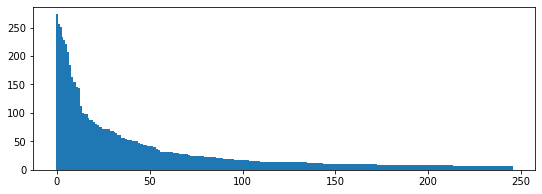

In [1554]:
lens = np.array(lens)

fig, ax = plt.subplots(1, 1, figsize=(9, 3))
ax.bar(range(len(lens[4:250])), lens[4:250], align="center", width=1)

ax.format_coord = format_coord
plt.show()

### Edit scripts length distribution

In [71]:
ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoActionsFull"

In [72]:
sorted_elems = [os.fsdecode(el) for el in os.listdir(ACTIONS_PATH) 
               if os.path.isdir(ACTIONS_PATH + "/" + os.fsdecode(el))]
sorted_elems = sorted(sorted_elems, key=lambda s: int(s.split(" ")[0])) 
len(sorted_elems)

21206

In [74]:
action_lens = []

for elem in tqdm_notebook(sorted_elems):
    actions_file = open(ACTIONS_PATH + "/" + elem + "/" + elem + "/sampleChange1")
    content = actions_file.read()
    script = content.split("\n")
    script = [modif for modif in script if modif != ""]
    
    action_lens.append(len(script))
    
    #print(content)
    #print(len(script), "\n\n")
    
    actions_file.close()
    
action_lens = np.array(action_lens)
sorted_action_lens = sorted(action_lens)
sorted_action_lens = np.array(sorted_action_lens)

In [36]:
import matplotlib.pyplot as plt
%matplotlib inline

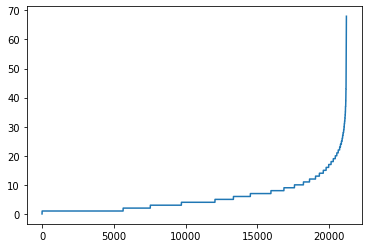

In [39]:
plt.plot(range(len(action_lens)), sorted_action_lens)

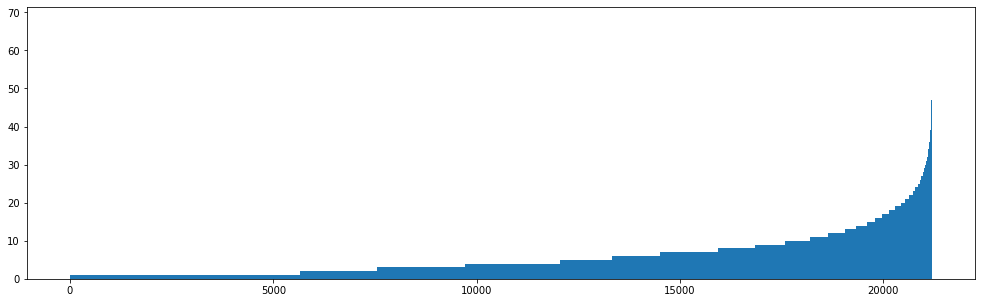

In [56]:
plt.figure(figsize=(17, 5))
plt.bar(range(len(sorted_action_lens)), sorted_action_lens, align="center", width=1)
plt.show()

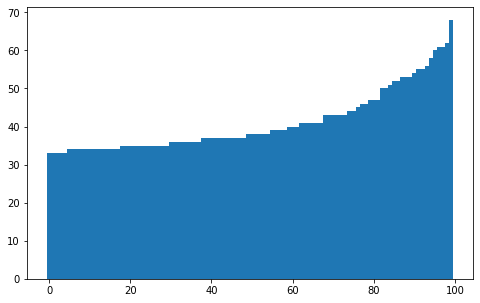

In [52]:
plt.figure(figsize=(8, 5))
plt.bar(range(len(sorted_action_lens[-100:])), sorted_action_lens[-100:], align="center", width=1)
plt.show()

In [75]:
sorted_action_lens.mean()

5.678487220597944

In [25]:
file_labels = open("/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/full_tufano_labels_3gram.txt", "r")

content = file_labels.read()
lbls = [int(x) for x in content.split(" ") if x != ""]
    
file_labels.close()

In [26]:
len(lbls)

21206

In [27]:
lbls[:10]

[0, 0, 0, 1, 2, -1, 3, 4, 0, 5]

In [29]:
outliers_lens = []
inliers_lens = []
more_than10 = 0

In [57]:
for i in range(len(lbls)):
    if lbls[i] == -1:
        outliers_lens.append(action_lens[i])
    else:
        inliers_lens.append(action_lens[i])

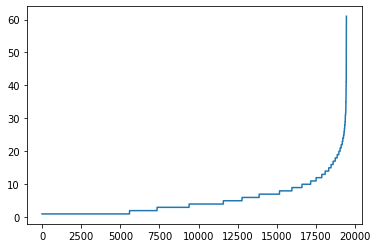

In [59]:
plt.plot(range(len(inliers_lens)), sorted(inliers_lens))
plt.show()

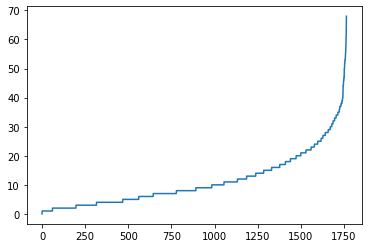

In [60]:
plt.plot(range(len(outliers_lens)), sorted(outliers_lens))
plt.show()

### For labeled Tufano

In [43]:
LABELED_ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoActions"

In [44]:
elems = [os.fsdecode(el) for el in os.listdir(LABELED_ACTIONS_PATH) 
               if os.path.isdir(LABELED_ACTIONS_PATH + "/" + os.fsdecode(el))]
elems = sorted(elems, key=lambda s: int(s.split(" ")[0])) 
len(elems)

632

In [45]:
action_lens = []

for elem in tqdm_notebook(elems):
    actions_file = open(LABELED_ACTIONS_PATH + "/" + elem + "/" + elem + "/sampleChange1")
    content = actions_file.read()
    script = content.split("\n")
    script = [modif for modif in script if modif != ""]
    
    action_lens.append(len(script))
    
    actions_file.close()
    
action_lens = np.array(action_lens)
sorted_action_lens = np.array(sorted(action_lens))

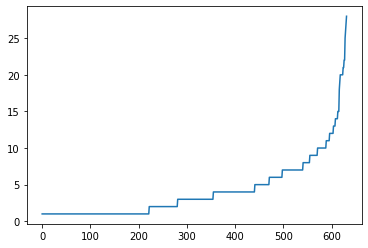

In [69]:
plt.plot(range(len(action_lens)), sorted_action_lens)
plt.show()

In [70]:
sorted_action_lens.mean()

4.1835443037974684

In [46]:
np.median(sorted_action_lens)

3.0

### For Lase Dataset

In [47]:
ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/LaseActions"

In [48]:
elems = [os.fsdecode(el) for el in os.listdir(ACTIONS_PATH) 
               if os.path.isdir(ACTIONS_PATH + "/" + os.fsdecode(el))]
elems = sorted(elems, key=lambda s: int(s.split(" ")[0])) 
len(elems)

149

In [49]:
action_lens = []

for elem in tqdm_notebook(elems):
    actions_file = open(ACTIONS_PATH + "/" + elem + "/" + elem + "/sampleChange1")
    content = actions_file.read()
    script = content.split("\n")
    script = [modif for modif in script if modif != ""]
    
    action_lens.append(len(script))
    
    actions_file.close()
    
action_lens = np.array(action_lens)
sorted_action_lens = np.array(sorted(action_lens))

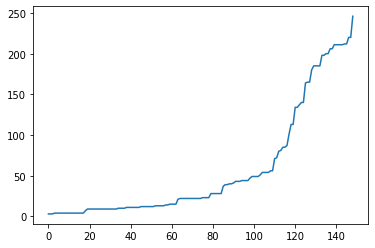

In [128]:
plt.plot(range(len(action_lens)), sorted_action_lens)
plt.show()

In [129]:
sorted_action_lens.mean()

57.79194630872483

In [50]:
np.median(sorted_action_lens)

22.0

### For raw Tufano Dataset

In [117]:
ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/RawTufanoActions24k"
DATASET_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/RawTufanoDataset24k"

In [118]:
elems = [os.fsdecode(el) for el in os.listdir(ACTIONS_PATH) 
               if os.path.isdir(ACTIONS_PATH + "/" + os.fsdecode(el))]
elems = sorted(elems, key=lambda s: int(s.split(" ")[0])) 
len(elems)

24590

In [119]:
action_lens = []

from_repos = collections.defaultdict(int)

for elem in tqdm_notebook(elems):
    actions_file = open(ACTIONS_PATH + "/" + elem + "/" + elem + "/sampleChange1")
    content = actions_file.read()
    script = content.split("\n")
    script = [modif for modif in script if modif != ""]
    
    src_file = open(DATASET_PATH + "/" + elem + "/source.java")
    src = src_file.read().split("/")[-4]
    
    if len(script) == 0:
        from_repos[src] += 1
        continue
    
    action_lens.append(len(script))
    
    actions_file.close()
    src_file.close()
    
action_lens = np.array(action_lens)
sorted_action_lens = np.array(sorted(action_lens))

print(from_repos)


defaultdict(<class 'int'>, {'android 2': 609, 'google 2': 640, 'ovirt 2': 593})


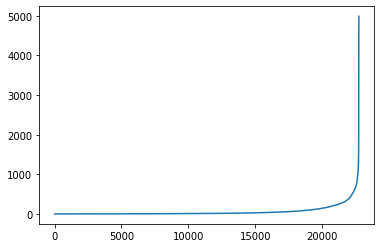

In [120]:
plt.plot(range(len(action_lens)), sorted_action_lens)
plt.show()

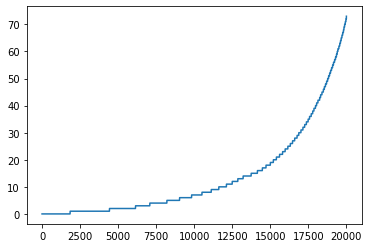

In [74]:
plt.plot(range(len(action_lens[:20000])), sorted_action_lens[:20000])
plt.show()

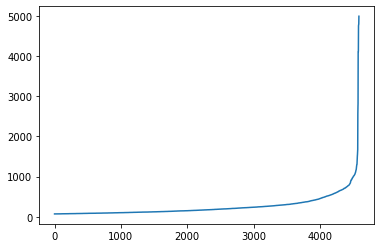

In [75]:
plt.plot(range(len(action_lens[20000:])), sorted_action_lens[20000:])
plt.show()

In [76]:
action_lens.max()

4989

In [77]:
sorted_action_lens.mean()

59.809109394062624

In [121]:
np.median(sorted_action_lens)

14.0

In [78]:
distrib = [0 for i in range(5000)]

for elem in action_lens:
    distrib[elem] += 1

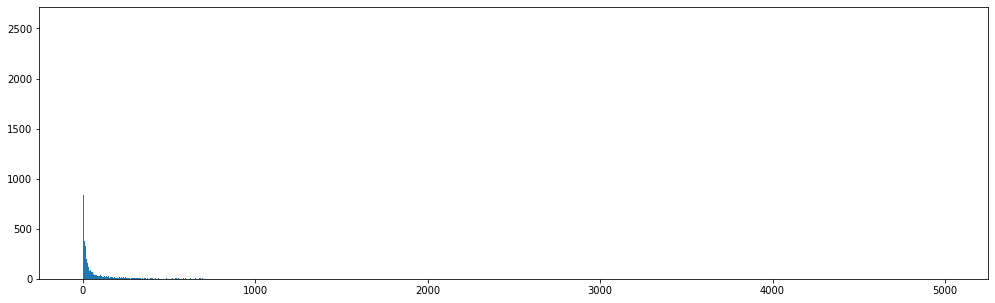

In [79]:
plt.figure(figsize=(17, 5))
plt.bar(range(len(distrib)), distrib, align="center", width=1)
plt.show()

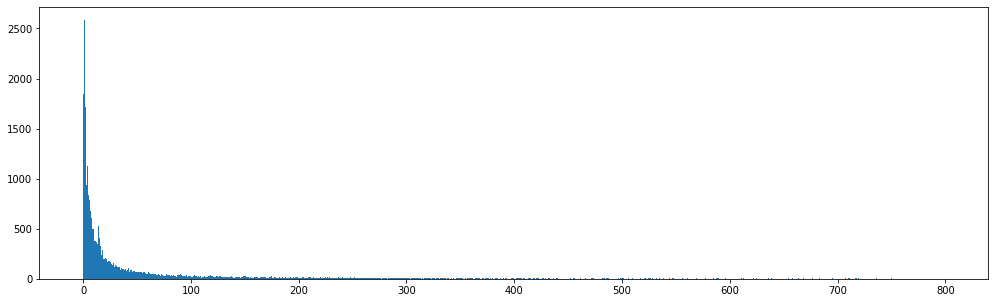

In [80]:
plt.figure(figsize=(17, 5))
plt.bar(range(len(distrib[:800])), distrib[:800], align="center", width=1)
plt.show()

In [81]:
distrib[0]

1842

# LASE Dataset

In [99]:
RESULTS_LASE = "/Volumes/Seagate/Alina/result_for_lase_treat-false"

In [100]:
all_dirs = [os.fsdecode(el) for el in os.listdir(RESULTS_LASE) 
               if os.path.isdir(RESULTS_LASE + "/" + os.fsdecode(el))]
all_dirs = sorted(all_dirs, key=lambda s: int(s.split(" ")[0])) 
len(all_dirs)

149

In [101]:
LASE_DATASET_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/LaseDataset"

label_to_changes = collections.defaultdict(list)
from_change_to_label = collections.defaultdict(list)

for double_num in tqdm_notebook(all_dirs):
    change_id = double_num.split(" ")[0]
    label_file = open(LASE_DATASET_PATH + "/" + change_id + "/" + "label")
    label = int(label_file.read())
    
    label_to_changes[label].append(change_id)
    from_change_to_label[change_id].append(label)

    label_file.close()
    

In [102]:
print(len(from_change_to_label))
print("NUM CLASSES:", len(label_to_changes))

149
NUM CLASSES: 24


In [106]:
ids_per_label = []
lines_poses = []
cur_sum = 0
all_labels = []

for label in label_to_changes:
    all_labels.append(label)
    for change in label_to_changes[label]:
        ids_per_label.append(change)
        cur_sum += 1
    lines_poses.append(cur_sum)

In [140]:
for i in range(len(ids_per_label)):
    print("On index", i, ids_per_label[i])

On index 0 1
On index 1 2
On index 2 3
On index 3 4
On index 4 5
On index 5 6
On index 6 7
On index 7 8
On index 8 9
On index 9 10
On index 10 11
On index 11 12
On index 12 13
On index 13 14
On index 14 15
On index 15 16
On index 16 17
On index 17 18
On index 18 19
On index 19 20
On index 20 21
On index 21 22
On index 22 23
On index 23 24
On index 24 25
On index 25 26
On index 26 27
On index 27 28
On index 28 29
On index 29 30
On index 30 31
On index 31 32
On index 32 33
On index 33 34
On index 34 35
On index 35 36
On index 36 37
On index 37 38
On index 38 39
On index 39 40
On index 40 41
On index 41 42
On index 42 43
On index 43 44
On index 44 45
On index 45 46
On index 46 47
On index 47 48
On index 48 49
On index 49 50
On index 50 51
On index 51 52
On index 52 53
On index 53 54
On index 54 55
On index 55 56
On index 56 57
On index 57 58
On index 58 59
On index 59 60
On index 60 61
On index 61 62
On index 62 63
On index 63 64
On index 64 65
On index 65 66
On index 66 67
On index 67 68

In [141]:
for i in range(len(lines_poses)):
    if i == 0:
        print("From 0 to", lines_poses[i], all_labels[i])
    else:
        print("From", lines_poses[i - 1], "to", lines_poses[i], all_labels[i])

From 0 to 4 1
From 4 to 20 2
From 20 to 24 3
From 24 to 30 4
From 30 to 42 5
From 42 to 45 6
From 45 to 52 7
From 52 to 56 8
From 56 to 60 9
From 60 to 63 10
From 63 to 66 11
From 66 to 75 12
From 75 to 81 13
From 81 to 84 14
From 84 to 87 15
From 87 to 96 16
From 96 to 100 17
From 100 to 105 18
From 105 to 111 19
From 111 to 116 20
From 116 to 126 21
From 126 to 129 22
From 129 to 134 23
From 134 to 149 24


In [103]:
def find_eps_with_brute_force_universal(dists, label_to_changes, from_change_to_label, 
                                        ids_per_label, agglomerative=False, linkage='single'):
    all_dists = np.unique(np.array(dists).flatten())

    max_rand = 0
    best_eps = -1
    max_fm = 0


    for eps in tqdm_notebook(all_dists):
        if eps == 0.0:
            continue
            
        if agglomerative is True:
            tufano_clustering = sklearn.cluster.AgglomerativeClustering(n_clusters=None,
                                                            affinity='precomputed', 
                                                            linkage=linkage, 
                                                            compute_full_tree=True,
                                                            distance_threshold=eps).fit(dists)
        else:
            tufano_clustering = sklearn.cluster.DBSCAN(eps=eps, 
                                                   min_samples=2, 
                                                   metric='precomputed').fit(dists)
        
        rand, fm = print_clustering_results_tufano_unique(tufano_clustering, 
                                               dists,
                                               label_to_changes, 
                                               from_change_to_label, 
                                               ids_per_label,
                                               to_print=False, 
                                               without_outliers=True)

        if max_fm < fm:
            max_fm = fm
            best_eps = eps

    print("Best eps:", best_eps)
    print("Best F-measure:", max_fm)

In [107]:
def get_lase_hists(hists_path, gram_path):
    hists = []

    for double_num in tqdm_notebook(ids_per_label):
        hist_path1 = hists_path + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
        
        if os.path.exists(hist_path1):
            hist_file1 = open(hist_path1, "r")
            lines = hist_file1.read().split("\n")
            hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
            hists.append(hist_data1)
            hist_file1.close()
        else:
            hists.append([])
        
    return hists

def get_lase_hists_len(hists_path, gram_path):
    hists_len = None
    
    es_path = hists_path + "/" + "edit_scripts_" + gram_path + "s_mapped.txt"
    es_file = open(es_path, "r")
    es_lines = es_file.read().split("\n")
    hists_len = int(es_lines[-2].split(" ")[0][:-1]) + 1
    es_file.close()

    print(hists_len)
    
    return hists_len

In [108]:
hists_lase_1gram = get_lase_hists(RESULTS_LASE, "1gram")
hists_lase_2gram = get_lase_hists(RESULTS_LASE, "2gram")
hists_lase_3gram = get_lase_hists(RESULTS_LASE, "3gram")
hists_lase_4gram = get_lase_hists(RESULTS_LASE, "4gram")
hists_lase_5gram = get_lase_hists(RESULTS_LASE, "5gram")
hists_lase_6gram = get_lase_hists(RESULTS_LASE, "6gram")
hists_lase_7gram = get_lase_hists(RESULTS_LASE, "7gram")
hists_lase_8gram = get_lase_hists(RESULTS_LASE, "8gram")

In [109]:
hists_lase_9gram = get_lase_hists(RESULTS_LASE, "9gram")
hists_lase_10gram = get_lase_hists(RESULTS_LASE, "10gram")

In [110]:
hist_len_1gram_lase = get_lase_hists_len(RESULTS_LASE, "1gram")
hist_len_2gram_lase = get_lase_hists_len(RESULTS_LASE, "2gram")
hist_len_3gram_lase = get_lase_hists_len(RESULTS_LASE, "3gram")
hist_len_4gram_lase = get_lase_hists_len(RESULTS_LASE, "4gram")
hist_len_5gram_lase = get_lase_hists_len(RESULTS_LASE, "5gram")
hist_len_6gram_lase = get_lase_hists_len(RESULTS_LASE, "6gram")
hist_len_7gram_lase = get_lase_hists_len(RESULTS_LASE, "7gram")
hist_len_8gram_lase = get_lase_hists_len(RESULTS_LASE, "8gram")

409
1199
1726
2009
2167
2258
2313
2342


In [471]:
hist_len_9gram_lase = get_lase_hists_len(RESULTS_LASE, "9gram")
hist_len_10gram_lase = get_lase_hists_len(RESULTS_LASE, "10gram")

2358
2370


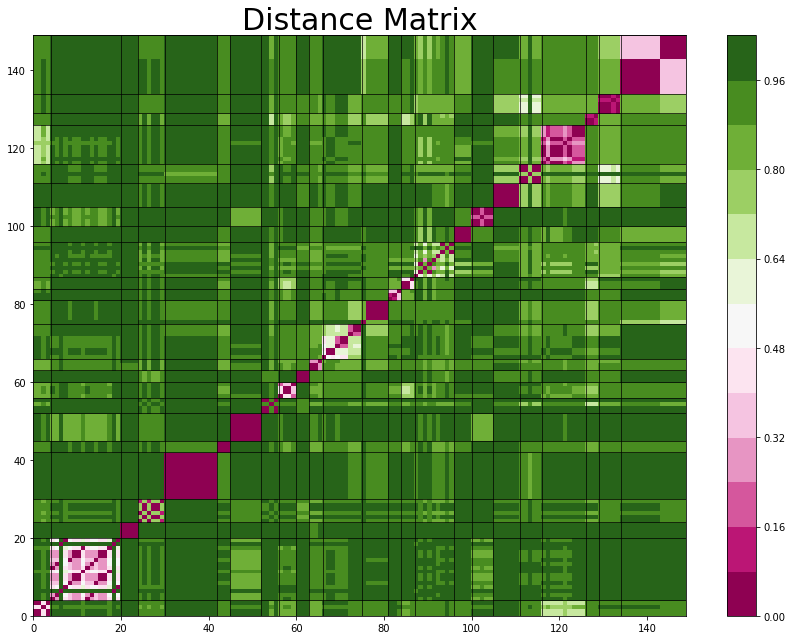

In [111]:
dists_lase_1gram = get_dists(hists_lase_1gram, canberra_metric, hist_len_1gram_lase)
drawhist2(ids_per_label, dists_lase_1gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [149]:
find_eps_with_brute_force_universal(dists_lase_1gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.6005464480874317
Best F-measure: 0.9328815852305783


In [635]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.6005464480874317, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_1gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_1gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]


73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
93 [16]


89 [16]
91 [16]


90 [16]
92 [16]
94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127

(99.282, 0.9328815852305783)

In [533]:
find_eps_with_brute_force_universal(dists_lase_1gram, label_to_changes, 
                                    from_change_to_label, ids_per_label, 
                                    agglomerative=True)


Best eps: 0.6078431372549019
Best F-measure: 0.9328815852305783


In [537]:
tufano_clustering = sklearn.cluster.AgglomerativeClustering(n_clusters=None,
                                                            affinity='precomputed', 
                                                            linkage='single', 
                                                            compute_full_tree=True,
                                                            distance_threshold=0.6078431372549019).fit(dists_lase_1gram)

print_clustering_results_tufano_unique(tufano_clustering, dists_lase_1gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]


73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
93 [16]


89 [16]
91 [16]


90 [16]
92 [16]
94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127

(99.282, 0.9328815852305783)

In [539]:
find_eps_with_brute_force_universal(dists_lase_1gram, label_to_changes, 
                                    from_change_to_label, ids_per_label, 
                                    agglomerative=True, linkage='complete')


Best eps: 0.6538517398907009
Best F-measure: 0.9328815852305783


In [540]:
tufano_clustering = sklearn.cluster.AgglomerativeClustering(n_clusters=None,
                                                            affinity='precomputed', 
                                                            linkage='complete', 
                                                            compute_full_tree=True,
                                                            distance_threshold=0.6538517398907009).fit(dists_lase_1gram)

print_clustering_results_tufano_unique(tufano_clustering, dists_lase_1gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]


73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
93 [16]


89 [16]
91 [16]


90 [16]
92 [16]
94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127

(99.282, 0.9328815852305783)

In [621]:
find_eps_with_brute_force_universal(dists_lase_1gram, label_to_changes, 
                                    from_change_to_label, ids_per_label, 
                                    agglomerative=True, linkage='average')


Best eps: 0.6851851851851851
Best F-measure: 0.9218450453349781


In [622]:
tufano_clustering = sklearn.cluster.AgglomerativeClustering(n_clusters=None,
                                                            affinity='precomputed', 
                                                            linkage='average', 
                                                            compute_full_tree=True,
                                                            distance_threshold=0.6851851851851851).fit(dists_lase_1gram)

print_clustering_results_tufano_unique(tufano_clustering, dists_lase_1gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


55 [8]
127 [22]
128 [22]
129 [22]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
93 [16]


89 [16]
91 [16]


90 [16]
92 [16]
94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]
130 [23]
131 [23]
132 [23]
133 [23]
134 [23]


117 [21]
118 [21

(99.216, 0.9218450453349781)

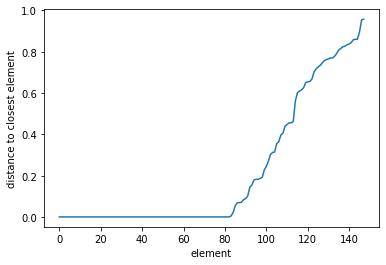

0.5601851851851851


In [558]:
from scipy.sparse import csr_matrix
from scipy.sparse.csgraph import minimum_spanning_tree

X = np.array(dists_lase_1gram)
MAX_X = max(X.max(), 1.0)
X = MAX_X - X
X = -X
X = csr_matrix(X)

Tcsr = minimum_spanning_tree(X)
Tcsr.toarray()

#print(X)
#print(Tcsr.toarray())

graph_dists = Tcsr.toarray()[Tcsr.toarray() != 0]
sorted_graph_dists = MAX_X + np.sort(graph_dists)
#print(sorted_graph_dists)

xs = np.array([i for i in range(len(sorted_graph_dists))])
plt.plot(xs, sorted_graph_dists)
plt.xlabel("element")
plt.ylabel("distance to closest element")
#plt.hlines(ans_eps, 0, len(knn_dists), colors='green', linestyles='dashed')
#plt.vlines(ans_j, 0, 1, colors='orange', linestyles='dashed')
plt.show()

max_gap = 0.0
ans_i = -1

for i in range(1, len(sorted_graph_dists)):
    gap = sorted_graph_dists[i] - sorted_graph_dists[i - 1]
    if gap > max_gap:
        max_gap = gap
        ans_i = i
        
print(sorted_graph_dists[ans_i])

In [89]:
def choose_threshold(dists, print_vals=False, draw_eps=None):
    X = np.array(dists)
    MAX_X = max(X.max(), 1.0)
    X = MAX_X - X
    X = -X
    X = csr_matrix(X)
    
    print("Find spanning tree...")

    Tcsr = minimum_spanning_tree(X)
    Tcsr.toarray()

    graph_dists = Tcsr.toarray()[Tcsr.toarray() != 0]
    sorted_graph_dists = MAX_X + np.sort(graph_dists)

    max_gap = 0.0
    ans_i = -1

    for i in tqdm_notebook(range(1, len(sorted_graph_dists))):
        gap = sorted_graph_dists[i] - sorted_graph_dists[i - 1]
        if gap > max_gap:
            max_gap = gap
            ans_i = i
            
    threshold = sorted_graph_dists[ans_i]
    
    if print_vals:
        print(sorted_graph_dists)
    
    xs = np.array([i for i in range(len(sorted_graph_dists))])
    plt.plot(xs, sorted_graph_dists)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(threshold, 0, len(sorted_graph_dists), colors='green', linestyles='dashed', label="selected threshold")
    
    if draw_eps != None:
        plt.hlines(draw_eps, 0, len(sorted_graph_dists), colors='orange', linestyles='dashed', label="best threshold")
    
    plt.legend(fontsize=14)
    plt.show()
    
    
    uniques = np.array(list(dict.fromkeys(sorted_graph_dists)))
    xs = np.array([i for i in range(len(uniques))])
    plt.plot(xs, uniques)
    plt.xlabel("element")
    plt.ylabel("distance to closest element")
    plt.hlines(threshold, 0, len(uniques), colors='green', linestyles='dashed', label="selected threshold")
    
    if draw_eps != None:
        plt.hlines(draw_eps, 0, len(uniques), colors='orange', linestyles='dashed', label="best threshold")
    
    plt.legend(fontsize=14)
    plt.show()
    
    print(threshold)
    
    return threshold, max_gap

Find spanning tree...


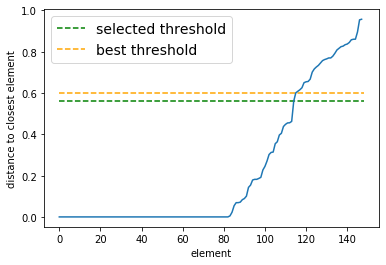

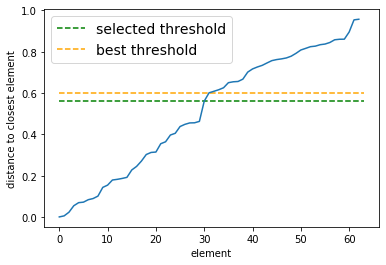

0.5601851851851851


(0.5601851851851851, 0.09796296296296292)

In [112]:
choose_threshold(dists_lase_1gram, draw_eps=0.6005464480874317)

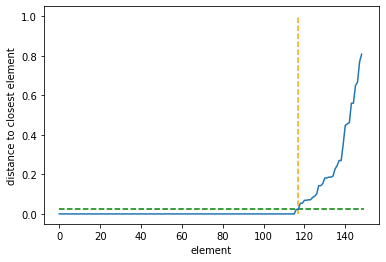

(0.022727272727272728, 117)

In [551]:
choose_eps(dists_lase_1gram, 2)

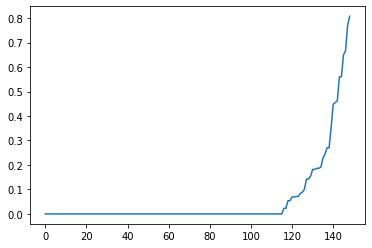

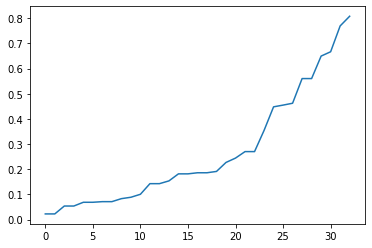

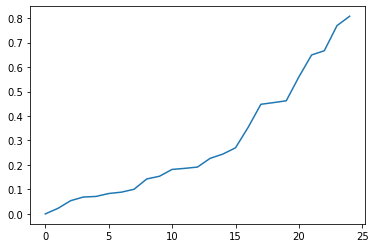

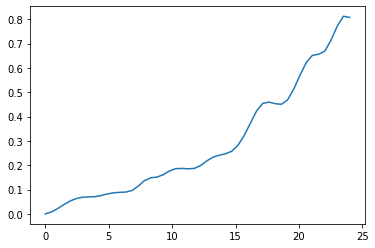

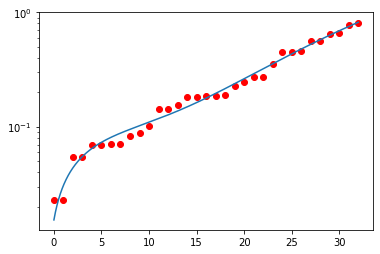

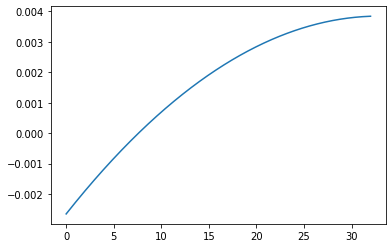

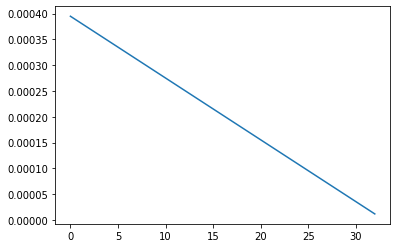

32.96419441537629
Eps = 0.8076923076923077


In [546]:
knn_dists(dists_lase_1gram, 2)

In [547]:
tufano_clustering = sklearn.cluster.AgglomerativeClustering(n_clusters=None,
                                                            affinity='precomputed', 
                                                            linkage='single', 
                                                            compute_full_tree=True,
                                                            distance_threshold=0.5).fit(dists_lase_1gram)

print_clustering_results_tufano_unique(tufano_clustering, dists_lase_1gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]


73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


89 [16]
91 [16]


90 [16]
92 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127 [22]
128 [22]
1

(99.34, 0.9176753149907511)

In [ ]:
# markmark find_eps_with_brute_force_universal(dists,

In [183]:
concat_hists_to_2gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
            
    concat_hists_to_2gram_lase.append(concat_hist)

concat_hists_len_to_2gram_lase = hist_len_1gram_lase + hist_len_2gram_lase

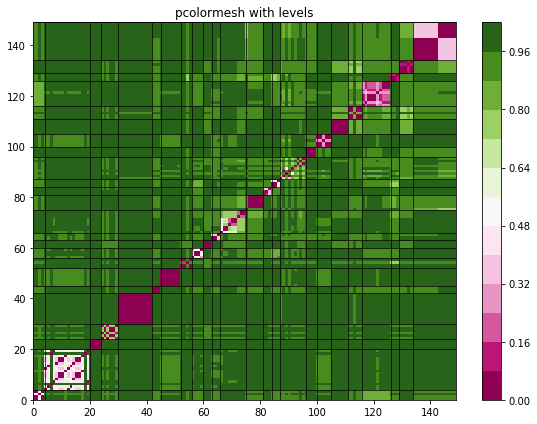

In [184]:
dists_lase_to_2gram = get_dists(concat_hists_to_2gram_lase, canberra_metric, concat_hists_len_to_2gram_lase)
drawhist2(ids_per_label, dists_lase_to_2gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [186]:
find_eps_with_brute_force_universal(dists_lase_to_2gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.7260536398467433
Best F-measure: 0.94496212214333


In [187]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.7260536398467433, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_2gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_2gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
91 [16]
93 [16]


90 [16]
92 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127 [

(99.454, 0.94496212214333)

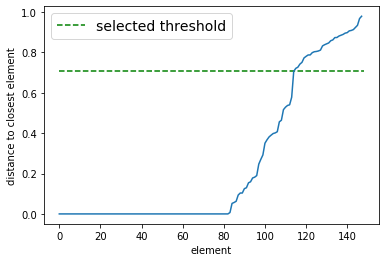

0.7058823529411765


0.7058823529411765

In [577]:
choose_threshold(dists_lase_to_2gram)

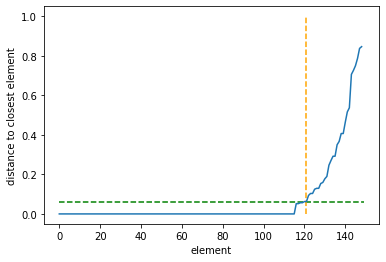

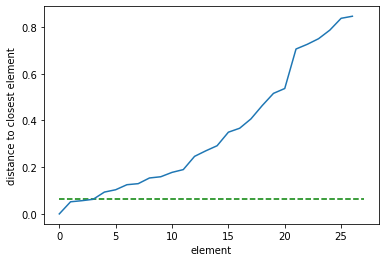

(0.0625, 121, 1.4953271028037383)

In [629]:
choose_eps(dists_lase_to_2gram, 2)

In [188]:
concat_hists_to_3gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
            
    concat_hists_to_3gram_lase.append(concat_hist)

concat_hists_len_to_3gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase

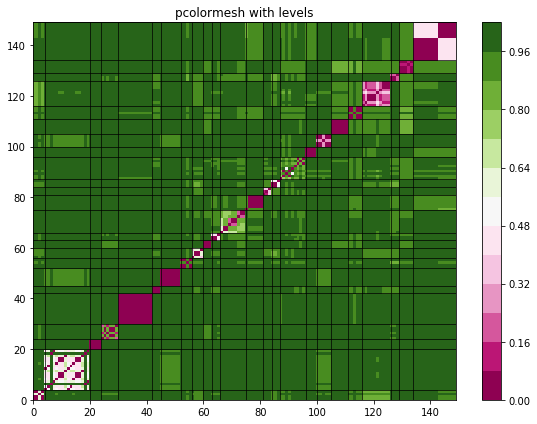

In [189]:
dists_lase_to_3gram = get_dists(concat_hists_to_3gram_lase, canberra_metric, concat_hists_len_to_3gram_lase)
drawhist2(ids_per_label, dists_lase_to_3gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [190]:
find_eps_with_brute_force_universal(dists_lase_to_3gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.8196920781666545
Best F-measure: 0.9551374847759344


In [191]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.8196920781666545, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_3gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_3gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
91 [16]
93 [16]


90 [16]
92 [16]
94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [

(99.395, 0.9551374847759344)

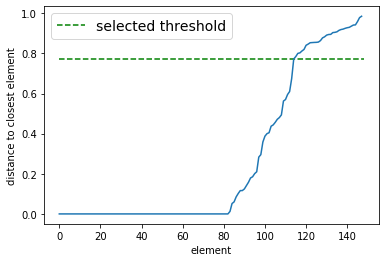

0.7721518987341772


0.7721518987341772

In [578]:
choose_threshold(dists_lase_to_3gram)

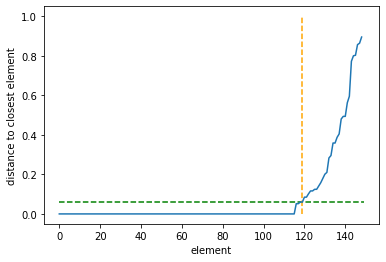

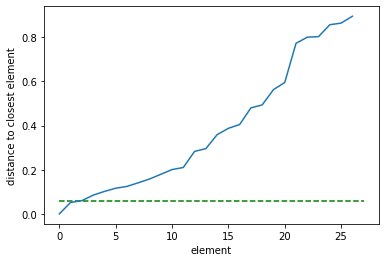

(0.06, 119, 1.4124293785310735)

In [630]:
choose_eps(dists_lase_to_3gram, 2)

In [135]:
concat_hists_to_4gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
        
    for gram_ind, amount in hists_lase_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase, amount))
            
    concat_hists_to_4gram_lase.append(concat_hist)

concat_hists_len_to_4gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase

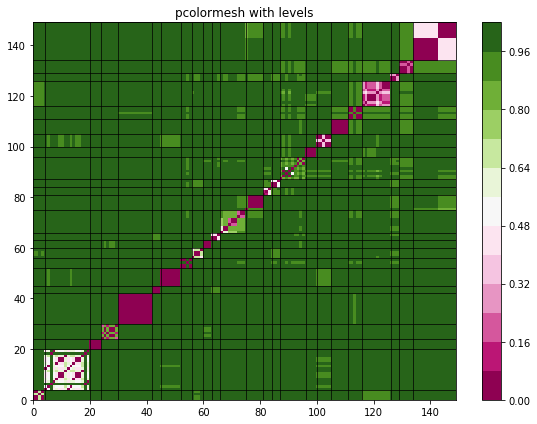

In [199]:
dists_lase_to_4gram = get_dists(concat_hists_to_4gram_lase, canberra_metric, concat_hists_len_to_4gram_lase)
drawhist2(ids_per_label, dists_lase_to_4gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [200]:
find_eps_with_brute_force_universal(dists_lase_to_4gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.8485817036400695
Best F-measure: 0.9551374847759344


In [201]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.8485817036400695, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_4gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_4gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
91 [16]
93 [16]


90 [16]
92 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111

(99.358, 0.9551374847759344)

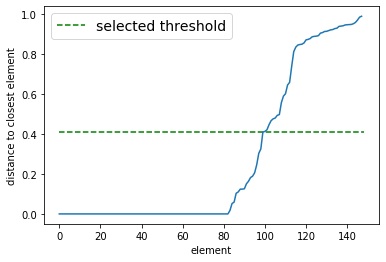

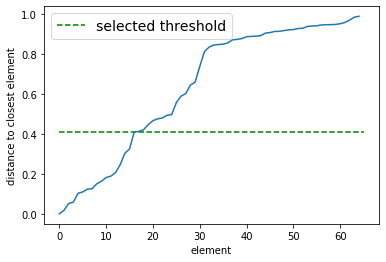

0.40936392914653785


(0.40936392914653785, 0.08445684969400391)

In [589]:
choose_threshold(dists_lase_to_4gram)

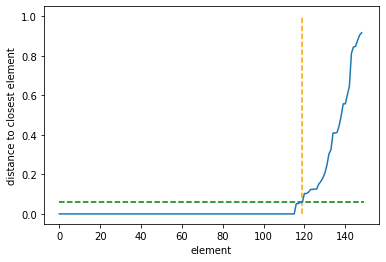

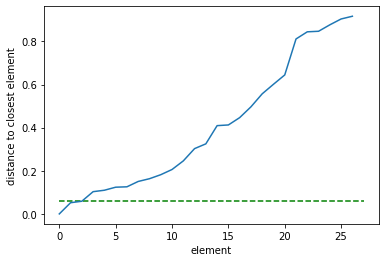

(0.058823529411764705, 119, 1.753968253968254)

In [631]:
choose_eps(dists_lase_to_4gram, 2)

In [202]:
concat_hists_to_5gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
        
    for gram_ind, amount in hists_lase_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase, amount))
        
    for gram_ind, amount in hists_lase_5gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase, 
                            amount))
            
    concat_hists_to_5gram_lase.append(concat_hist)

concat_hists_len_to_5gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase + hist_len_5gram_lase


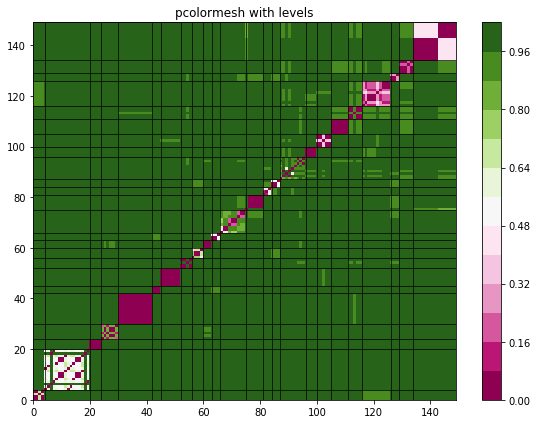

In [203]:
dists_lase_to_5gram = get_dists(concat_hists_to_5gram_lase, canberra_metric, concat_hists_len_to_5gram_lase)
drawhist2(ids_per_label, dists_lase_to_5gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [204]:
find_eps_with_brute_force_universal(dists_lase_to_5gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.8913857677902621
Best F-measure: 0.9748161874392403


In [205]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.8913857677902621, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_5gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_5gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
90 [16]
91 [16]
92 [16]
93 [16]
94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19

(99.547, 0.9748161874392403)

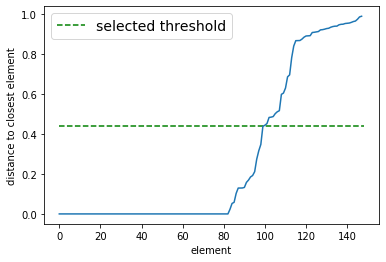

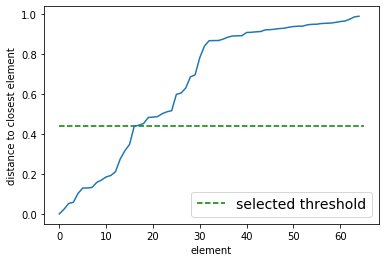

0.43878952531884385


(0.43878952531884385, 0.09081335499630483)

In [590]:
choose_threshold(dists_lase_to_5gram)

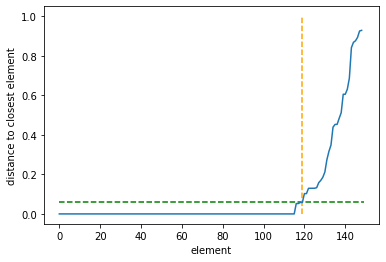

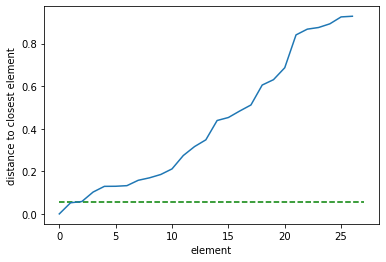

(0.05813953488372093, 119, 1.7667673716012087)

In [632]:
choose_eps(dists_lase_to_5gram, 2)

In [113]:
concat_hists_to_6gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
        
    for gram_ind, amount in hists_lase_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase, amount))
        
    for gram_ind, amount in hists_lase_5gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_6gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase + hist_len_5gram_lase, 
                            amount))
            
    concat_hists_to_6gram_lase.append(concat_hist)

concat_hists_len_to_6gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase


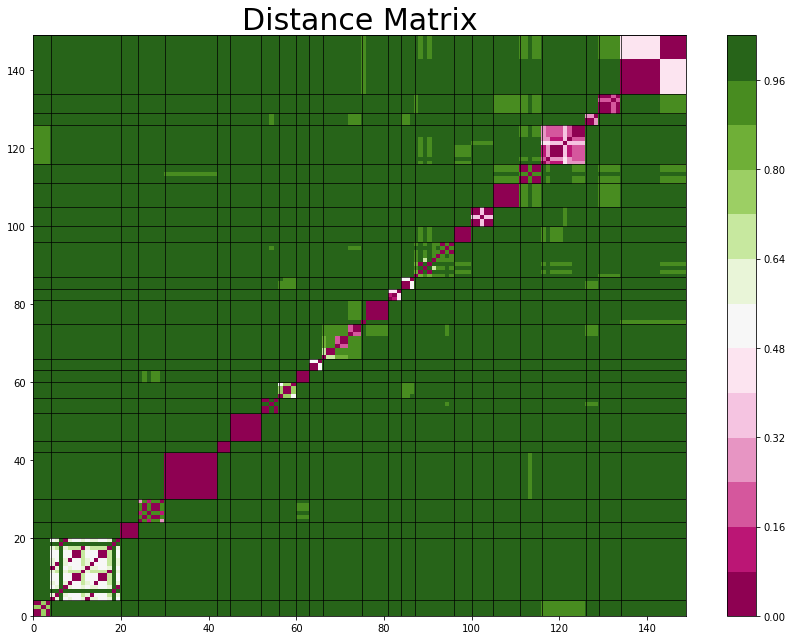

In [114]:
dists_lase_to_6gram = get_dists(concat_hists_to_6gram_lase, canberra_metric, concat_hists_len_to_6gram_lase)
drawhist2(ids_per_label, dists_lase_to_6gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [214]:
find_eps_with_brute_force_universal(dists_lase_to_6gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.9069182389937107
Best F-measure: 0.9783692865312261


In [636]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.9069182389937107, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_6gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_6gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
90 [16]
91 [16]
92 [16]
93 [16]
94 [16]
95 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]

(99.553, 0.9783692865312261)

Find spanning tree...


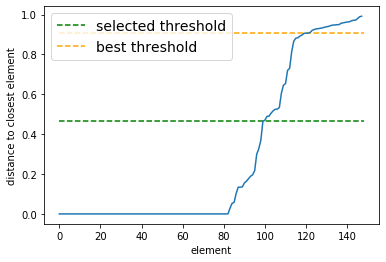

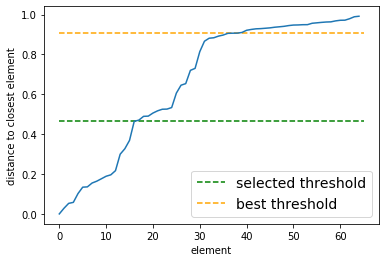

0.4643247462919593


(0.4643247462919593, 0.09538267429311875)

In [116]:
choose_threshold(dists_lase_to_6gram, draw_eps=0.9069182389937107)

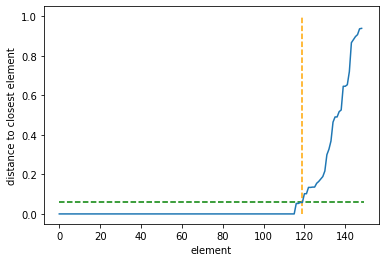

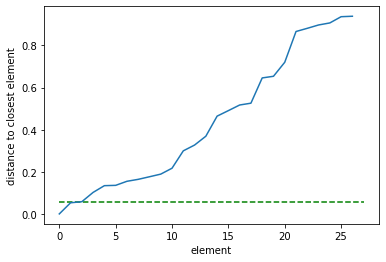

(0.057971014492753624, 119, 1.7627737226277371)

In [633]:
choose_eps(dists_lase_to_6gram, 2)

In [216]:
concat_hists_to_7gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
        
    for gram_ind, amount in hists_lase_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase, amount))
        
    for gram_ind, amount in hists_lase_5gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + 
                            hist_len_3gram_lase + hist_len_4gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_6gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase + hist_len_5gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_7gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase, 
                            amount))
            
    concat_hists_to_7gram_lase.append(concat_hist)

concat_hists_len_to_7gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase 
concat_hists_len_to_7gram_lase += hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase
concat_hists_len_to_7gram_lase += hist_len_7gram_lase


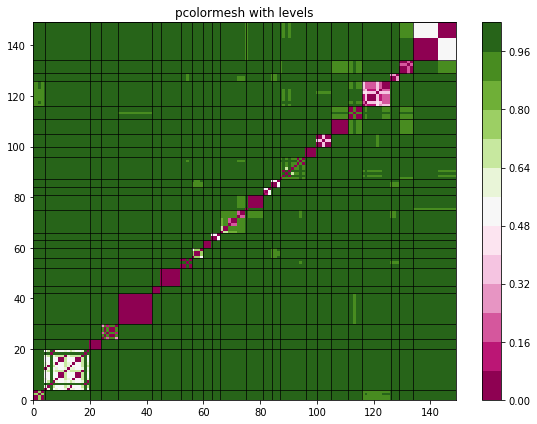

In [217]:
dists_lase_to_7gram = get_dists(concat_hists_to_7gram_lase, canberra_metric, concat_hists_len_to_7gram_lase)
drawhist2(ids_per_label, dists_lase_to_7gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [218]:
find_eps_with_brute_force_universal(dists_lase_to_7gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.9210300429184549
Best F-measure: 0.9783692865312261


In [219]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.9210300429184549, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_7gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_7gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
90 [16]
91 [16]
92 [16]
93 [16]
94 [16]
95 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]

(99.553, 0.9783692865312261)

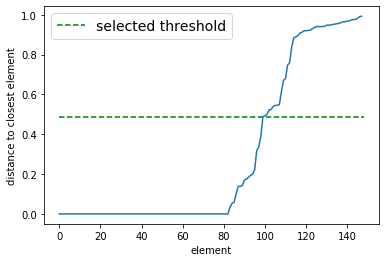

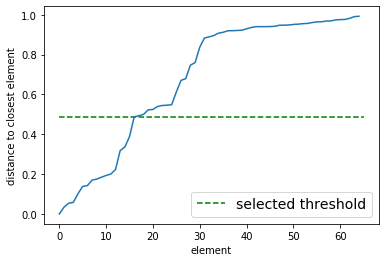

0.4875316549977655


(0.4875316549977655, 0.09927727738168579)

In [592]:
choose_threshold(dists_lase_to_7gram)

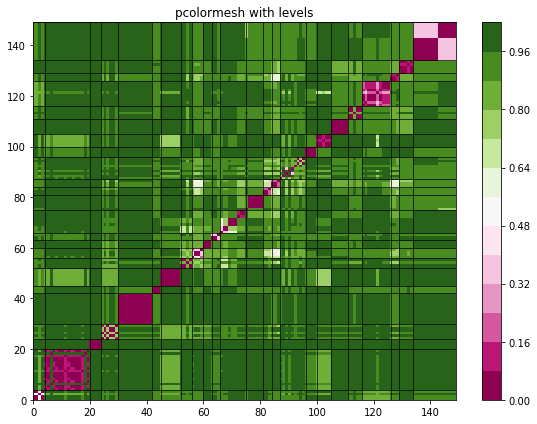

In [224]:
dists_lase_to_7gram_cos = get_dists(concat_hists_to_7gram_lase, cos_distance, concat_hists_len_to_7gram_lase)
drawhist2(ids_per_label, dists_lase_to_7gram_cos, False, lw=0.7, provided_lines_pos=lines_poses)

In [225]:
find_eps_with_brute_force_universal(dists_lase_to_7gram_cos, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.37802222749799774
Best F-measure: 0.8957194185382102


In [226]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.37802222749799774, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_7gram_cos)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_7gram_cos,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]


70 [12]
71 [12]
72 [12]


73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


89 [16]
91 [16]


90 [16]
92 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127 [22]
128 [22]
129 [

(99.241, 0.8957194185382102)

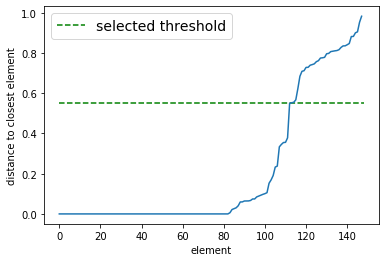

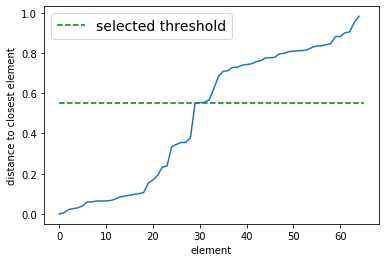

0.5494198303329769


(0.5494198303329769, 0.17139760283497918)

In [596]:
choose_threshold(dists_lase_to_7gram_cos)

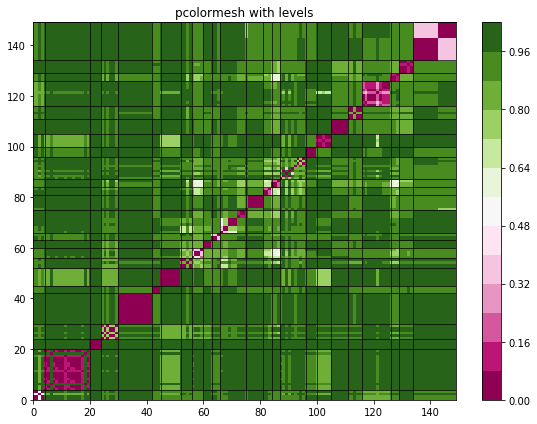

In [228]:
dists_lase_to_7gram_pearson = get_dists(concat_hists_to_7gram_lase, pearsons_correlation, concat_hists_len_to_7gram_lase)
drawhist2(ids_per_label, dists_lase_to_7gram_pearson, False, lw=0.7, provided_lines_pos=lines_poses)

In [229]:
find_eps_with_brute_force_universal(dists_lase_to_7gram_pearson, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.37806467073373706
Best F-measure: 0.8957194185382102


In [230]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.37806467073373706, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_7gram_pearson)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_7gram_pearson,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]


70 [12]
71 [12]
72 [12]


73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


89 [16]
91 [16]


90 [16]
92 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127 [22]
128 [22]
129 [

(99.241, 0.8957194185382102)

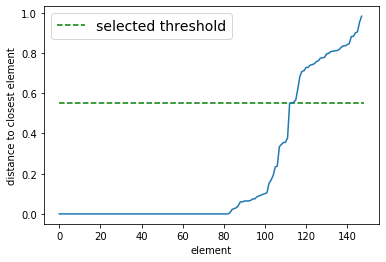

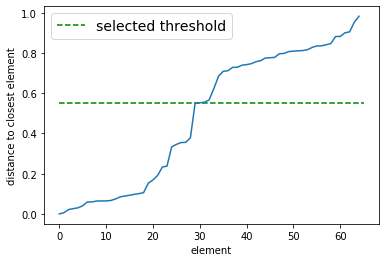

0.5494686626982972


(0.5494686626982972, 0.17140399196456013)

In [597]:
choose_threshold(dists_lase_to_7gram_pearson)

In [220]:
concat_hists_to_8gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
        
    for gram_ind, amount in hists_lase_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase, amount))
        
    for gram_ind, amount in hists_lase_5gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + 
                            hist_len_3gram_lase + hist_len_4gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_6gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase + hist_len_5gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_7gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_8gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase + hist_len_7gram_lase, 
                            amount))
            
    concat_hists_to_8gram_lase.append(concat_hist)

concat_hists_len_to_8gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase 
concat_hists_len_to_8gram_lase += hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase
concat_hists_len_to_8gram_lase += hist_len_7gram_lase + hist_len_8gram_lase


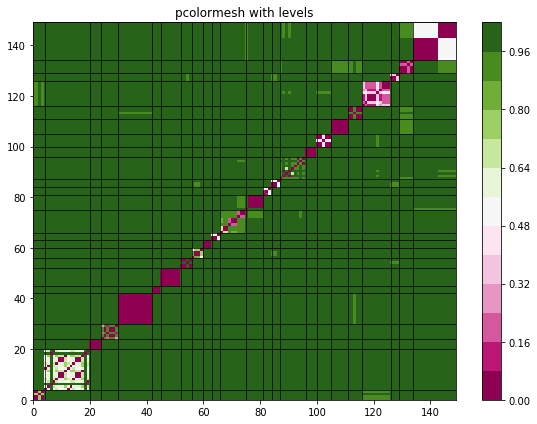

In [221]:
dists_lase_to_8gram = get_dists(concat_hists_to_8gram_lase, canberra_metric, concat_hists_len_to_8gram_lase)
drawhist2(ids_per_label, dists_lase_to_8gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [222]:
find_eps_with_brute_force_universal(dists_lase_to_8gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.9294117647058824
Best F-measure: 0.9708189509607563


In [223]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.9294117647058824, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_8gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_8gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
91 [16]
93 [16]
94 [16]
95 [16]
96 [16]


90 [16]
92 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [1

(99.422, 0.9708189509607563)

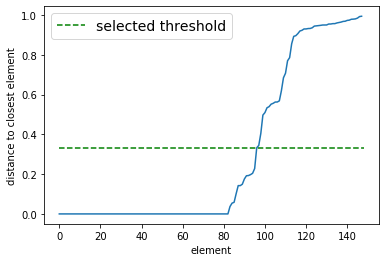

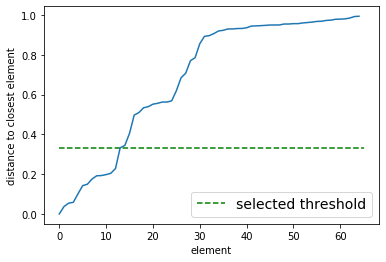

0.33226390467769784


(0.33226390467769784, 0.10432492510143865)

In [599]:
choose_threshold(dists_lase_to_8gram)

In [472]:
concat_hists_to_9gram_lase = []

num_changes = len(hists_lase_1gram)
8
for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
        
    for gram_ind, amount in hists_lase_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase, amount))
        
    for gram_ind, amount in hists_lase_5gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + 
                            hist_len_3gram_lase + hist_len_4gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_6gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase + hist_len_5gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_7gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_8gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase + hist_len_7gram_lase, 
                            amount))
    
    for gram_ind, amount in hists_lase_9gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase + 
                            hist_len_7gram_lase + hist_len_8gram_lase, 
                            amount))
            
    concat_hists_to_9gram_lase.append(concat_hist)

concat_hists_len_to_9gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase 
concat_hists_len_to_9gram_lase += hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase
concat_hists_len_to_9gram_lase += hist_len_7gram_lase + hist_len_8gram_lase + hist_len_9gram_lase


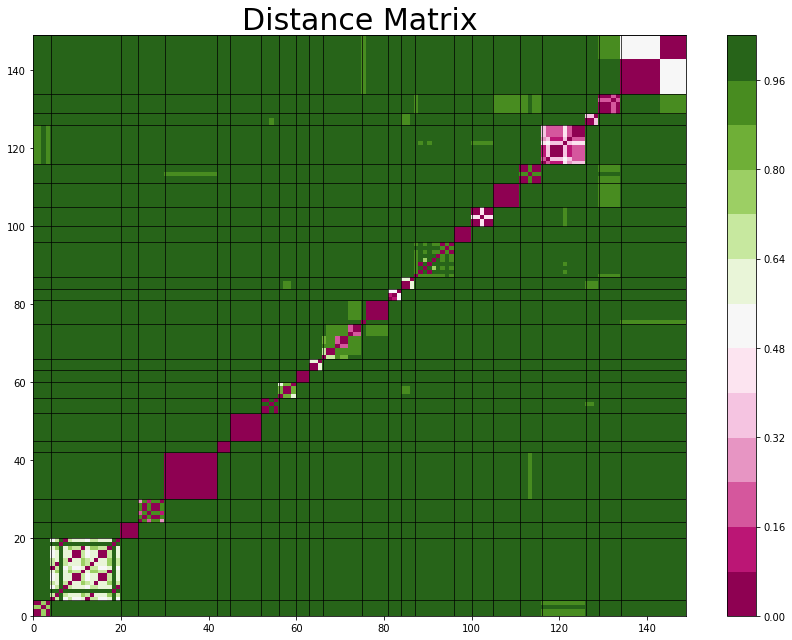

In [473]:
dists_lase_to_9gram = get_dists(concat_hists_to_9gram_lase, canberra_metric, concat_hists_len_to_9gram_lase)
drawhist2(ids_per_label, dists_lase_to_9gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [474]:
find_eps_with_brute_force_universal(dists_lase_to_9gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.9367088607594937
Best F-measure: 0.9708189509607563


In [475]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.9367088607594937, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_9gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_9gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
91 [16]
93 [16]
94 [16]
95 [16]
96 [16]


90 [16]
92 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [1

(99.422, 0.9708189509607563)

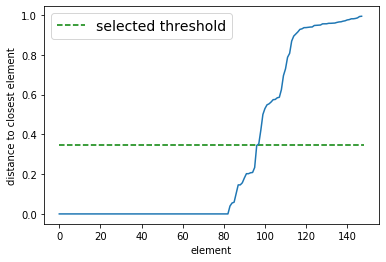

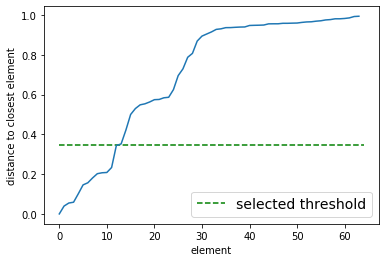

0.3441493930905696


(0.3441493930905696, 0.1108342167290357)

In [600]:
choose_threshold(dists_lase_to_9gram)

In [476]:
concat_hists_to_10gram_lase = []

num_changes = len(hists_lase_1gram)

for i in range(num_changes):
    concat_hist = []
    
    for gram_ind, amount in hists_lase_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_lase_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase, amount))
        
    for gram_ind, amount in hists_lase_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase, amount))
        
    for gram_ind, amount in hists_lase_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase, amount))
        
    for gram_ind, amount in hists_lase_5gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + hist_len_2gram_lase + 
                            hist_len_3gram_lase + hist_len_4gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_6gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + hist_len_4gram_lase + hist_len_5gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_7gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_8gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase + hist_len_7gram_lase, 
                            amount))
    
    for gram_ind, amount in hists_lase_9gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase + 
                            hist_len_7gram_lase + hist_len_8gram_lase, 
                            amount))
        
    for gram_ind, amount in hists_lase_10gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_lase + 
                            hist_len_2gram_lase + hist_len_3gram_lase + 
                            hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase + 
                            hist_len_7gram_lase + hist_len_8gram_lase + hist_len_9gram_lase, 
                            amount))
            
    concat_hists_to_10gram_lase.append(concat_hist)

concat_hists_len_to_10gram_lase = hist_len_1gram_lase + hist_len_2gram_lase + hist_len_3gram_lase 
concat_hists_len_to_10gram_lase += hist_len_4gram_lase + hist_len_5gram_lase + hist_len_6gram_lase
concat_hists_len_to_10gram_lase += hist_len_7gram_lase + hist_len_8gram_lase + hist_len_9gram_lase + hist_len_10gram_lase


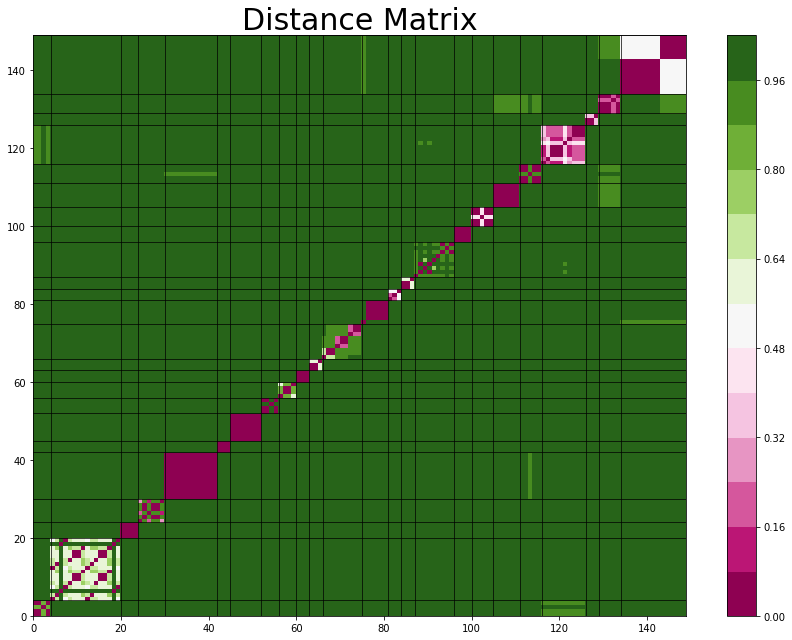

In [477]:
dists_lase_to_10gram = get_dists(concat_hists_to_10gram_lase, canberra_metric, concat_hists_len_to_10gram_lase)
drawhist2(ids_per_label, dists_lase_to_10gram, False, lw=0.7, provided_lines_pos=lines_poses)

In [478]:
find_eps_with_brute_force_universal(dists_lase_to_10gram, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.9368169398907104
Best F-measure: 0.9551374847759344


In [479]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.9368169398907104, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_lase_to_10gram)
print_clustering_results_tufano_unique(tufano_clustering, dists_lase_to_10gram,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
26 [4]
27 [4]
28 [4]
29 [4]
30 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]
73 [12]
74 [12]
75 [12]


76 [13]
135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]
144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
91 [16]
93 [16]


90 [16]
92 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111

(99.358, 0.9551374847759344)

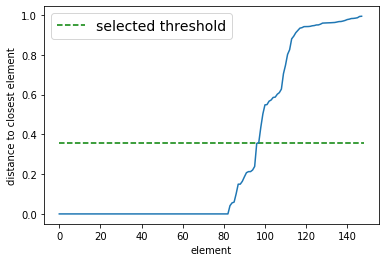

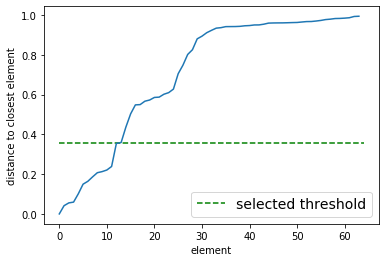

0.3543718052192628


(0.3543718052192628, 0.11576048190205734)

In [601]:
choose_threshold(dists_lase_to_10gram)

In [151]:
LASE_ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/LaseActions"

In [152]:
edit_scripts_lase = []

for double_num in tqdm_notebook(ids_per_label):
    actions_file = open(LASE_ACTIONS_PATH + "/" + double_num + "/" + double_num + "/" + "sampleChange1")
    edit_script = actions_file.read().split("\n")
    edit_script = [elem for elem in edit_script if elem != '']
    
    edit_scripts_lase.append(edit_script)
    actions_file.close()


In [156]:
dists_for_lcs_lase = []

for es1 in tqdm_notebook(edit_scripts_lase):
    cur_dists = []
    for es2 in edit_scripts_lase:
        cur_lcs = lcs(es1, es2)
        dist = 1 - cur_lcs / max(len(es1), len(es2))
        cur_dists.append(dist)
    dists_for_lcs_lase.append(cur_dists)

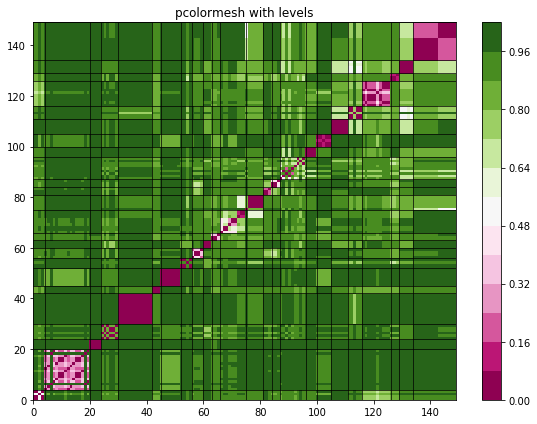

In [158]:
drawhist2(ids_per_label, dists_for_lcs_lase, False, lw=0.7, provided_lines_pos=lines_poses)

In [159]:
find_eps_with_brute_force_universal(dists_for_lcs_lase, label_to_changes, from_change_to_label, ids_per_label)


Best eps: 0.5238095238095238
Best F-measure: 0.9259120447039908


In [181]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.5238095238095238, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_lcs_lase)
print_clustering_results_tufano_unique(tufano_clustering, dists_for_lcs_lase,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
3 [1]
4 [1]


5 [2]
6 [2]
8 [2]
9 [2]
10 [2]
11 [2]
12 [2]
13 [2]
14 [2]
15 [2]
16 [2]
17 [2]
18 [2]
20 [2]


7 [2]
19 [2]


21 [3]
22 [3]
23 [3]
24 [3]


25 [4]
27 [4]
30 [4]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
47 [7]
48 [7]
49 [7]
50 [7]
51 [7]
52 [7]


53 [8]
54 [8]
56 [8]


57 [9]
58 [9]
59 [9]
60 [9]


61 [10]
62 [10]
63 [10]


64 [11]
65 [11]
66 [11]


67 [12]
68 [12]
69 [12]
70 [12]
71 [12]
72 [12]


73 [12]
74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


82 [14]
83 [14]
84 [14]


85 [15]
86 [15]
87 [15]


88 [16]
89 [16]
91 [16]


90 [16]
92 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
103 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


117 [21]
118 [21]
119 [21]
120 [21]
121 [21]
122 [21]
123 [21]
124 [21]
125 [21]
126 [21]


127 [22]
12

(99.31, 0.9259120447039908)

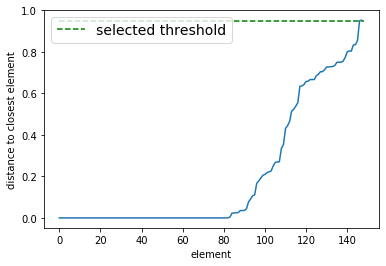

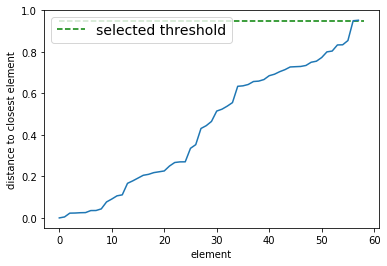

0.95


(0.95, 0.09545454545454546)

In [602]:
choose_threshold(dists_for_lcs_lase)

In [175]:
dists_for_equals_lase = []

for es1 in tqdm_notebook(edit_scripts_lase):
    cur_dists = []
    for es2 in edit_scripts_lase:
        if es1 == es2:
            cur_dists.append(0.0)
        else:
            cur_dists.append(1.0)
    dists_for_equals_lase.append(cur_dists)

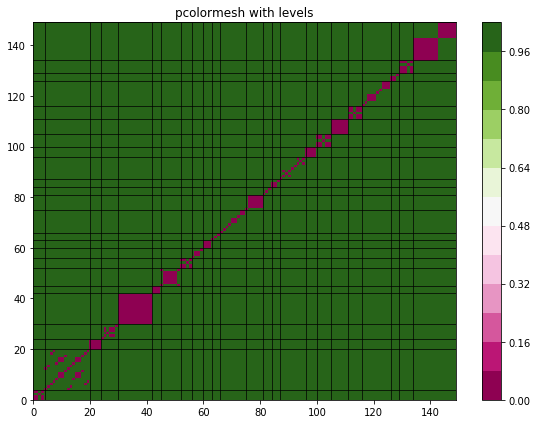

In [176]:
drawhist2(ids_per_label, dists_for_equals_lase, False, lw=0.7, provided_lines_pos=lines_poses)

In [637]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.1, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_for_equals_lase)
print_clustering_results_tufano_unique(tufano_clustering, dists_for_equals_lase,
                                label_to_changes, from_change_to_label, ids_per_label,
                                      without_outliers=True)

CLUSTERS:

1 [1]
2 [1]
4 [1]


5 [2]
13 [2]


6 [2]
14 [2]


7 [2]
19 [2]


8 [2]
20 [2]


9 [2]
15 [2]


10 [2]
11 [2]
16 [2]
17 [2]


12 [2]
18 [2]


21 [3]
22 [3]
23 [3]
24 [3]


26 [4]
28 [4]
29 [4]


31 [5]
32 [5]
33 [5]
34 [5]
35 [5]
36 [5]
37 [5]
38 [5]
39 [5]
40 [5]
41 [5]
42 [5]


43 [6]
44 [6]
45 [6]


46 [7]
52 [7]


47 [7]
48 [7]
49 [7]
50 [7]
51 [7]


53 [8]
54 [8]
56 [8]


58 [9]
59 [9]


61 [10]
62 [10]
63 [10]


71 [12]
72 [12]


74 [12]
75 [12]


77 [13]
78 [13]
79 [13]
80 [13]
81 [13]


85 [15]
86 [15]


89 [16]
91 [16]


94 [16]
96 [16]


97 [17]
98 [17]
99 [17]
100 [17]


101 [18]
102 [18]
104 [18]
105 [18]


106 [19]
107 [19]
108 [19]
109 [19]
110 [19]
111 [19]


112 [20]
113 [20]
115 [20]
116 [20]


119 [21]
120 [21]
121 [21]


124 [21]
125 [21]
126 [21]


127 [22]
128 [22]


130 [23]
131 [23]
132 [23]
134 [23]


135 [24]
136 [24]
137 [24]
138 [24]
139 [24]
140 [24]
141 [24]
142 [24]
143 [24]


144 [24]
145 [24]
146 [24]
147 [24]
148 [24]
149 [24]


Number of clus

(97.166, 0.696348059099737)

# Raw Tufano

In [4]:
RESULTS_RAW_TUFANO = "/Volumes/Seagate/Alina/result_for_raw_tufano24k"
ACTIONS_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/RawTufanoActions24k"
DATASET_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/RawTufanoDataset24k"

In [5]:
elems = [os.fsdecode(el) for el in os.listdir(ACTIONS_PATH) 
               if os.path.isdir(ACTIONS_PATH + "/" + os.fsdecode(el))]
elems = sorted(elems, key=lambda s: int(s.split(" ")[0])) 
len(elems)

24590

In [ ]:
es_lens = []

In [6]:
valid_elems = []

for elem in tqdm_notebook(elems):
    actions_file = open(ACTIONS_PATH + "/" + elem + "/" + elem + "/sampleChange1")
    content = actions_file.read()
    script = content.split("\n")
    script = [modif for modif in script if modif != ""]
    
    if len(script) == 0:
        continue
        
    valid_elems.append(elem)
    #es_lens.append()
    
    actions_file.close()


In [7]:
print(len(valid_elems))
valid_elems[:5]

22748


['1', '2', '3', '4', '5']

In [8]:
def get_raw_hists(hists_path, gram_path):
    hists = []

    for double_num in tqdm_notebook(valid_elems):
        hist_path1 = hists_path + "/" + double_num + " " + double_num + "/" + gram_path + "/sampleChange1" + "_hist.txt"
        
        if os.path.exists(hist_path1):
            hist_file1 = open(hist_path1, "r")
            lines = hist_file1.read().split("\n")
            hist_data1 = [(int(line.split(" ")[0]), int(line.split(" ")[1])) for line in lines if line != '']
            hists.append(hist_data1)
            hist_file1.close()
        else:
            hists.append([])
            
    return hists

def get_raw_hists_len(hists_path, gram_path):
    hists_len = None
    
    es_path = hists_path + "/" + "edit_scripts_" + gram_path + "s_mapped.txt"
    es_file = open(es_path, "r")
    es_lines = es_file.read().split("\n")
    hists_len = int(es_lines[-2].split(" ")[0][:-1]) + 1
    es_file.close()

    print(hists_len)
    
    return hists_len

In [10]:
hists_raw_1gram = get_raw_hists(RESULTS_RAW_TUFANO, "1gram")
hists_raw_2gram = get_raw_hists(RESULTS_RAW_TUFANO, "2gram")
hists_raw_3gram = get_raw_hists(RESULTS_RAW_TUFANO, "3gram")
hists_raw_4gram = get_raw_hists(RESULTS_RAW_TUFANO, "4gram")
#hists_raw_5gram = get_raw_hists(RESULTS_RAW_TUFANO, "5gram")

In [11]:
hist_len_1gram_raw = get_raw_hists_len(RESULTS_RAW_TUFANO, "1gram")
hist_len_2gram_raw = get_raw_hists_len(RESULTS_RAW_TUFANO, "2gram")
hist_len_3gram_raw = get_raw_hists_len(RESULTS_RAW_TUFANO, "3gram")
hist_len_4gram_raw = get_raw_hists_len(RESULTS_RAW_TUFANO, "4gram")
hist_len_5gram_raw = get_raw_hists_len(RESULTS_RAW_TUFANO, "5gram")

3155
44835
156521
318809
479465


In [139]:
concat_hists_to_3gram_raw = []

num_changes = len(hists_raw_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hists_raw_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_raw_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw, amount))
        
    for gram_ind, amount in hists_raw_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw + hist_len_2gram_raw, amount))
        
    concat_hists_to_3gram_raw.append(concat_hist)

concat_hists_len_to_3gram_raw = hist_len_1gram_raw + hist_len_2gram_raw + hist_len_3gram_raw


In [12]:
concat_hists_to_4gram_raw = []

num_changes = len(hists_raw_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hists_raw_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_raw_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw, amount))
        
    for gram_ind, amount in hists_raw_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw + hist_len_2gram_raw, amount))
        
    for gram_ind, amount in hists_raw_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw + hist_len_2gram_raw + hist_len_3gram_raw, amount))
                    
    concat_hists_to_4gram_raw.append(concat_hist)

concat_hists_len_to_4gram_raw = hist_len_1gram_raw + hist_len_2gram_raw + hist_len_3gram_raw
concat_hists_len_to_4gram_raw += hist_len_4gram_raw


In [91]:
concat_hists_to_5gram_raw = []

num_changes = len(hists_raw_1gram)

for i in tqdm_notebook(range(num_changes)):
    concat_hist = []
    
    for gram_ind, amount in hists_raw_1gram[i]:
        concat_hist.append((gram_ind, amount))
    
    for gram_ind, amount in hists_raw_2gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw, amount))
        
    for gram_ind, amount in hists_raw_3gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw + hist_len_2gram_raw, amount))
        
    for gram_ind, amount in hists_raw_4gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw + hist_len_2gram_raw + hist_len_3gram_raw, amount))
        
    for gram_ind, amount in hists_raw_5gram[i]:
        concat_hist.append((gram_ind + hist_len_1gram_raw + 
                            hist_len_2gram_raw + hist_len_3gram_raw + hist_len_4gram_raw, 
                            amount))
            
    concat_hists_to_5gram_raw.append(concat_hist)

concat_hists_len_to_5gram_raw = hist_len_1gram_raw + hist_len_2gram_raw + hist_len_3gram_raw
concat_hists_len_to_5gram_raw += hist_len_4gram_raw + hist_len_5gram_raw


In [92]:
concat_hists_to_5gram_raw_np = np.array(concat_hists_to_5gram_raw)

In [ ]:
dists_raw_to_5gram = get_dists_optimized(concat_hists_to_5gram_raw_np, 
                                         canberra_metric_optimized, concat_hists_len_to_5gram_raw)

In [13]:
concat_hists_to_4gram_raw = np.array(concat_hists_to_4gram_raw)

In [14]:
dists_raw_to_4gram = get_dists_optimized(concat_hists_to_4gram_raw, 
                                         canberra_metric_optimized, concat_hists_len_to_4gram_raw)

In [140]:
concat_hists_to_3gram_raw = np.array(concat_hists_to_3gram_raw)

In [150]:
dists_raw_to_3gram = get_dists_optimized(concat_hists_to_3gram_raw, 
                                         canberra_metric_optimized, concat_hists_len_to_3gram_raw)

In [262]:
dists_raw_to_1gram = get_dists_optimized(hists_raw_1gram, 
                                         canberra_metric_optimized, hist_len_1gram_raw)

In [97]:
print(dists_raw_to_5gram[-1][-50:])

[1.         0.66666667 1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.        ]


In [151]:
PATH_FOR_METRICS = "/Volumes/Seagate/Alina/calculated_dists_raw_tufano_3gram.txt"
#os.makedirs(PATH_FOR_METRICS)

metrics_file = open(PATH_FOR_METRICS, "w")

for i in tqdm_notebook(dists_raw_to_3gram):
    for j in i:
        metrics_file.write(str(j) + " ")
    metrics_file.write("\n")

metrics_file.close()

In [153]:
PATH_FOR_METRICS = "/Volumes/Seagate/Alina/compressed_calculated_dists_raw_tufano_3gram.txt"
#os.makedirs(PATH_FOR_METRICS)

metrics_file = open(PATH_FOR_METRICS, "w")

n = len(dists_raw_to_3gram)

for i in tqdm_notebook(range(n)):
    for j in range(n):
        if i <= j:
            break
        metrics_file.write(str(dists_raw_to_3gram[i][j]) + " ")
    metrics_file.write("\n")

metrics_file.close()

In [101]:
dists_raw_to_5gram_np = np.array(dists_raw_to_5gram)

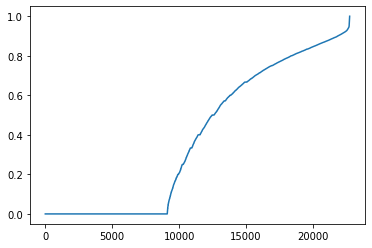

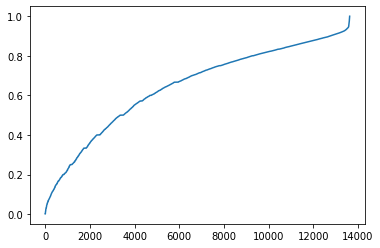

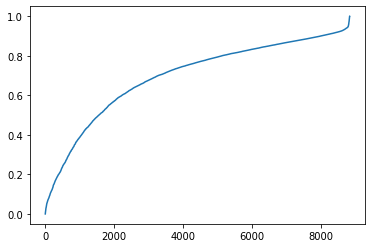

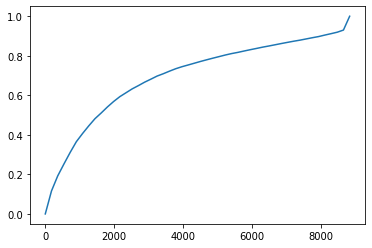

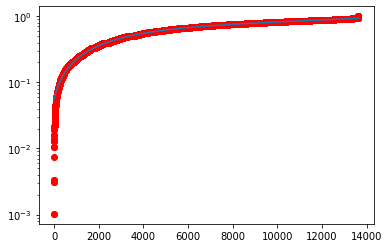

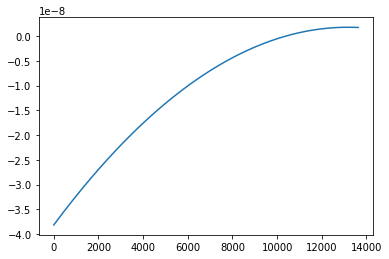

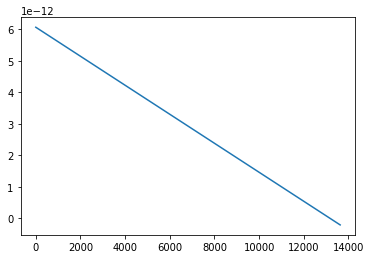

13178.234301281378
Eps = 0.9162332545311267


In [104]:
knn_dists(dists_raw_to_5gram_np, 2)

In [17]:
dists_raw_to_4gram_np = np.array(dists_raw_to_4gram)

In [154]:
dists_raw_to_3gram_np = np.array(dists_raw_to_3gram)

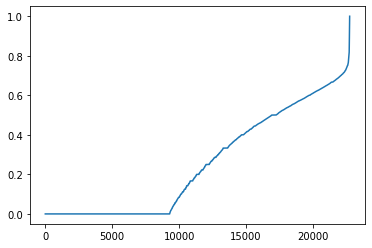

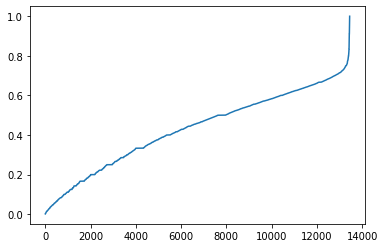

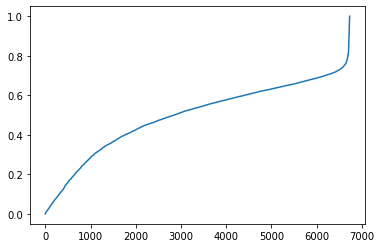

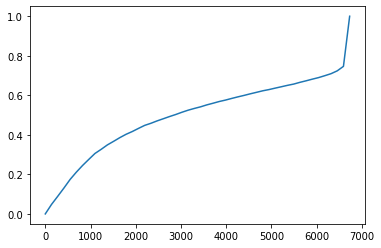

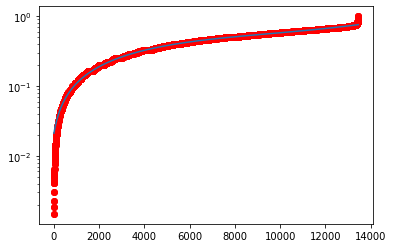

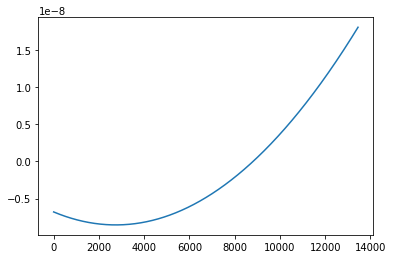

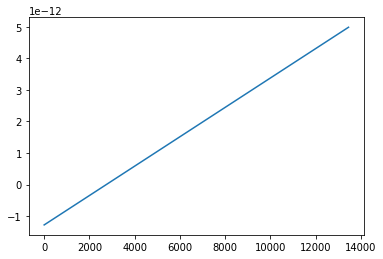

2743.2251034097435
Eps = 0.25


In [264]:
knn_dists(dists_raw_to_1gram, 2)

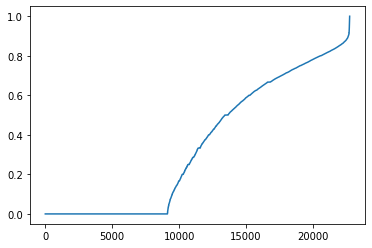

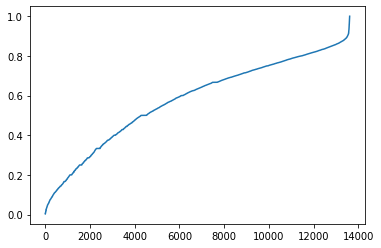

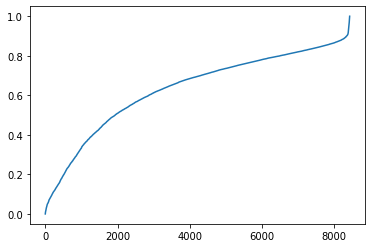

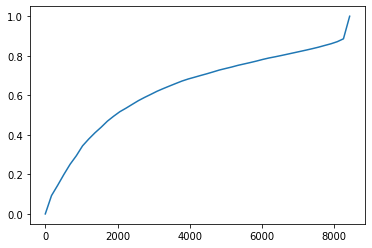

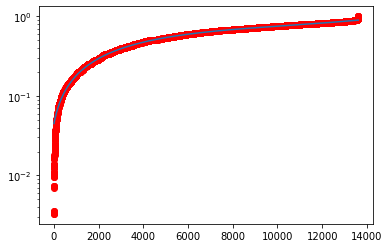

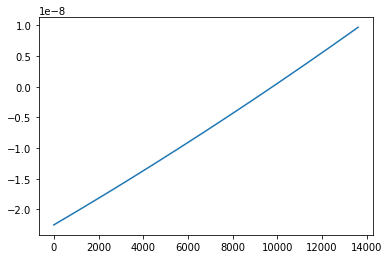

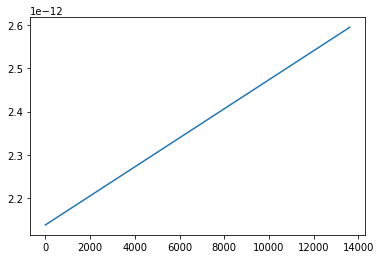

-63713.07878822282


IndexError: index -63713 is out of bounds for axis 0 with size 13616

In [155]:
knn_dists(dists_raw_to_3gram_np, 2)

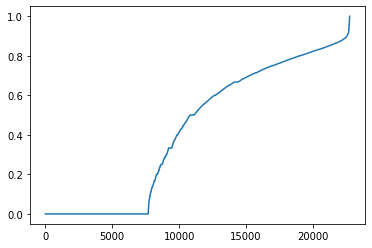

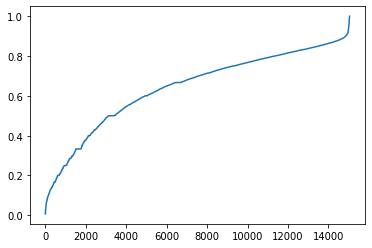

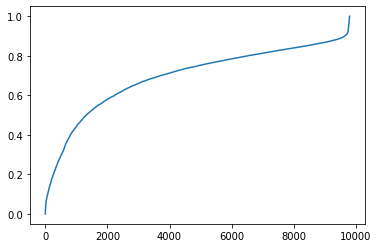

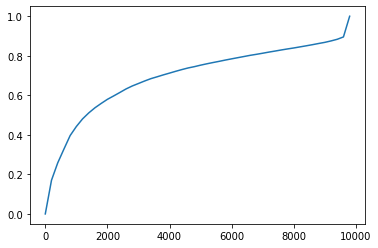

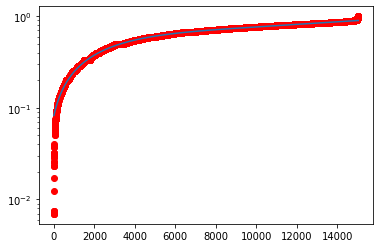

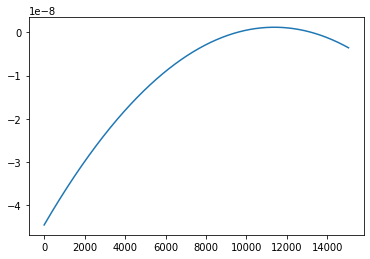

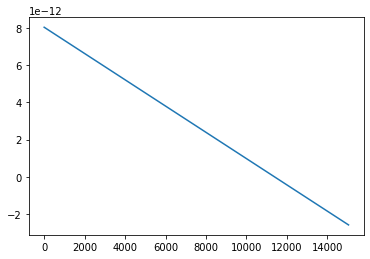

11376.605592469441
Eps = 0.8007751937984495


In [215]:
knn_dists(dists_raw_to_3gram_np, 3)

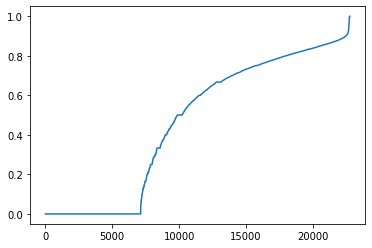

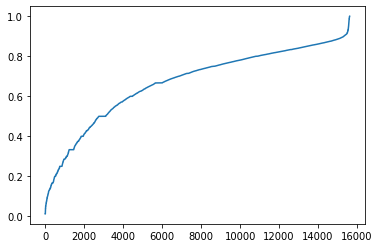

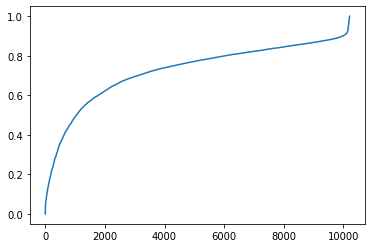

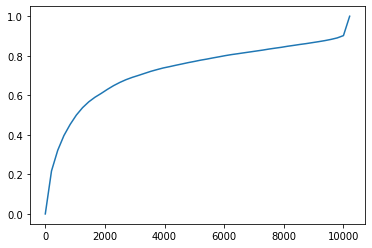

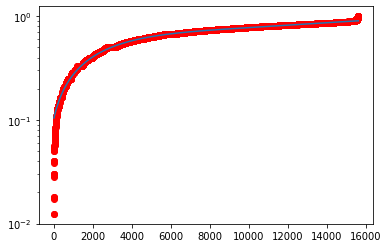

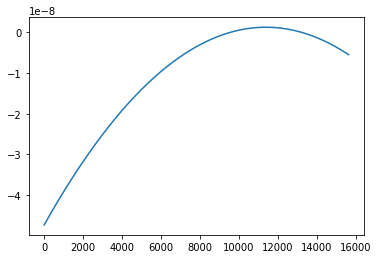

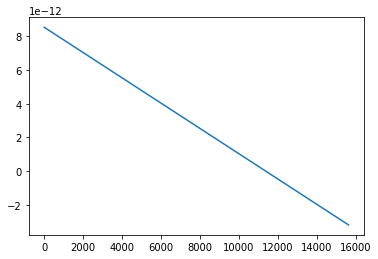

11379.042572201655
Eps = 0.8102981029810299


In [216]:
knn_dists(dists_raw_to_3gram_np, 4)

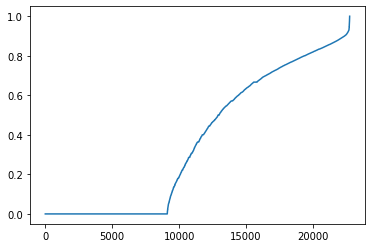

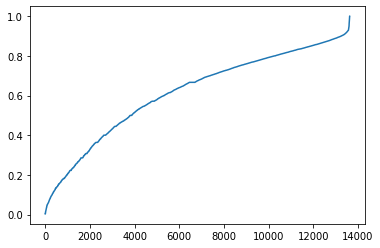

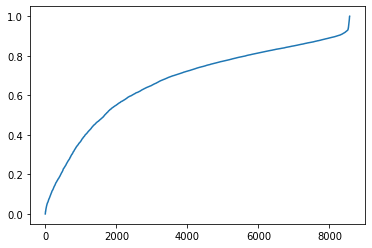

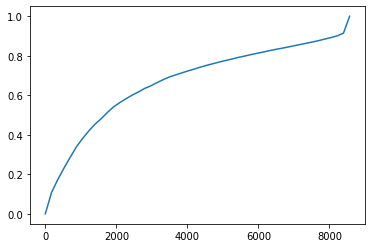

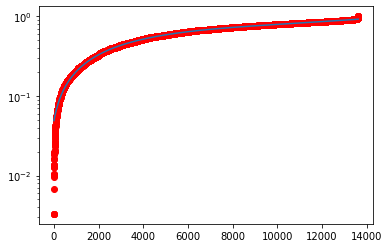

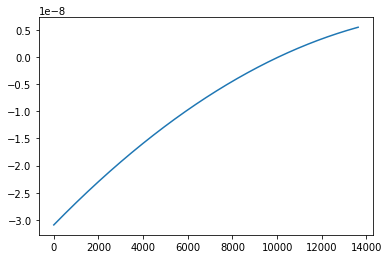

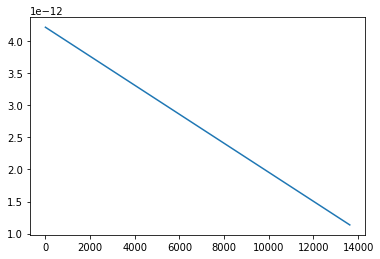

18648.874044472665


IndexError: index 18648 is out of bounds for axis 0 with size 13630

In [20]:
knn_dists(dists_raw_to_4gram_np, 2)

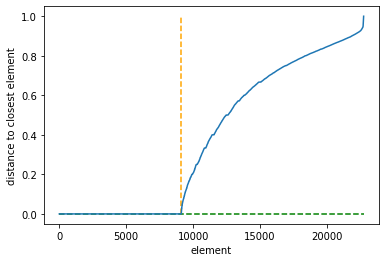

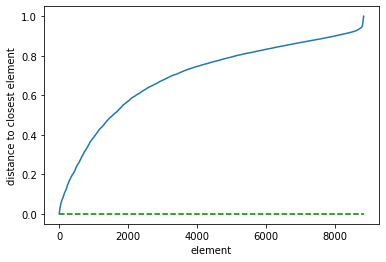

(0.001023185884755608, 9116, 3.0647802865995755)

In [106]:
choose_eps(dists_raw_to_5gram_np, 2)

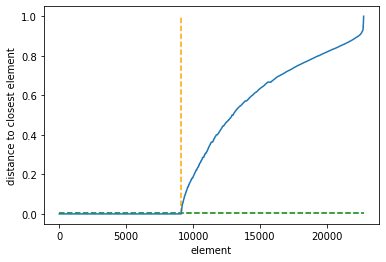

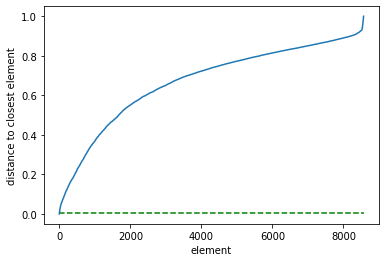

(0.003304794581500488, 9120, 2.07211983251898)

In [23]:
choose_eps(dists_raw_to_4gram_np, 2)

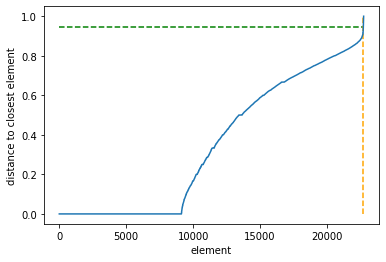

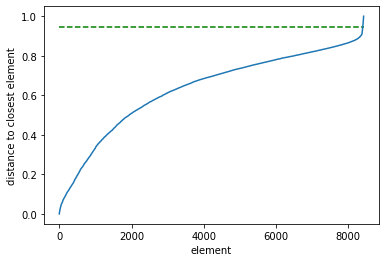

(0.9444444444444444, 22722, 0.006375227686703067)

In [168]:
choose_eps_difference(dists_raw_to_3gram_np, 2)

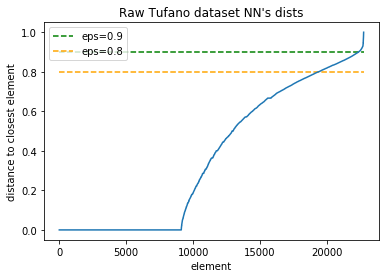

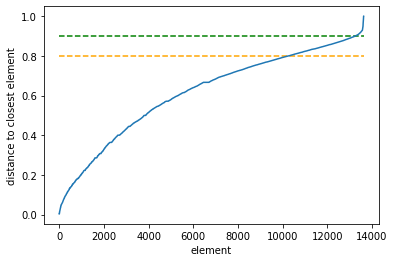

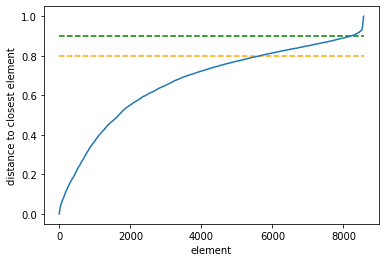

In [42]:
knn_dists_with_eps_line(dists_raw_to_4gram_np, 2, 0.9, 
                        title="Raw Tufano dataset NN's dists", eps2=0.8, label1="eps=0.9", label2="eps=0.8")

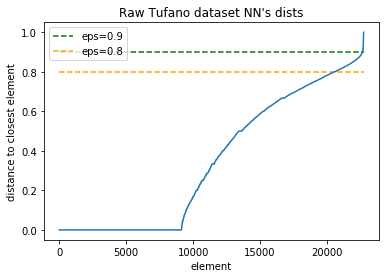

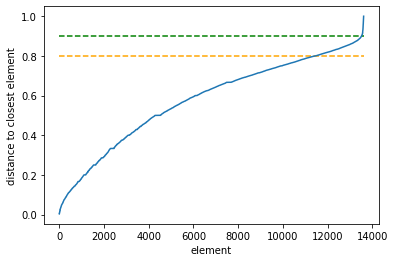

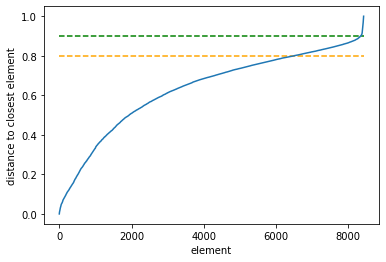

In [157]:
knn_dists_with_eps_line(dists_raw_to_3gram_np, 2, 0.9, 
                        title="Raw Tufano dataset NN's dists", eps2=0.8, label1="eps=0.9", label2="eps=0.8")

In [297]:
import random

sub_n = 5000

sample = random.sample(range(0, len(valid_elems)), sub_n)
sample_dists = np.zeros((sub_n, sub_n))

for i in tqdm_notebook(range(len(sample))):
    for j in range(len(sample)):
        sample_dists[i][j] = dists_raw_to_3gram_np[sample[i]][sample[j]]

Find spanning tree...


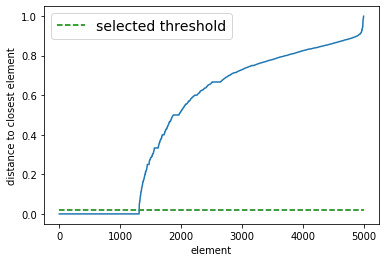

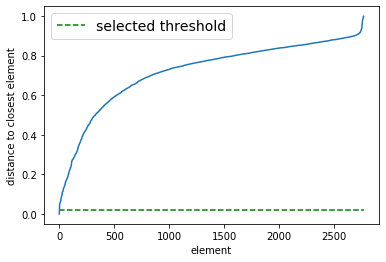

0.020678642112225143


(0.020678642112225143, 0.020678642112225143)

In [298]:
choose_threshold(sample_dists)

In [534]:
tufano_clustering = sklearn.cluster.DBSCAN(eps=0.8, 
                                           min_samples=2, 
                                           metric='precomputed').fit(dists_raw_to_3gram_np)

In [293]:
agglomerative_clustering = sklearn.cluster.AgglomerativeClustering(n_clusters=None,
                                                            affinity='precomputed', 
                                                            linkage="average", 
                                                            compute_full_tree=True,
                                                            distance_threshold=0.6).fit(dists_raw_to_3gram_np)
                                                                                       
                                                                                

In [535]:
print(len(tufano_clustering.labels_))
print(tufano_clustering.labels_[:10])

22748
[ 0  0 -1  0  0 -1  0  0 -1 -1]


In [254]:
file_labels = open("/Volumes/Seagate/Alina/raw_tufano_labels_to3gram-0.6.txt", "w")

for lbl in tufano_clustering.labels_:
    file_labels.write(str(lbl) + " ")
    
file_labels.close()

In [536]:
clusters = collections.defaultdict(list)
to_label = collections.defaultdict(str)

for i in range(len(tufano_clustering.labels_)):
    clr = tufano_clustering.labels_[i]
    clusters[clr].append(i)
    to_label[i] = clr

In [537]:
print(len(clusters))
print(len(clusters[-1]) / len(valid_elems) * 100)

611
9.41181642342184


In [538]:
sorted_clusters_for_raw = sorted(clusters, 
                                  key=lambda clr: len(clusters[clr]), 
                                  reverse=True)

In [539]:
sorted_clusters_for_raw

[0,
 -1,
 62,
 112,
 270,
 81,
 9,
 83,
 554,
 604,
 332,
 361,
 474,
 174,
 413,
 579,
 183,
 565,
 420,
 19,
 49,
 75,
 222,
 298,
 349,
 379,
 383,
 426,
 461,
 6,
 155,
 171,
 300,
 337,
 353,
 354,
 538,
 2,
 5,
 7,
 12,
 22,
 65,
 184,
 217,
 231,
 257,
 281,
 314,
 335,
 378,
 424,
 449,
 531,
 544,
 605,
 20,
 32,
 53,
 73,
 97,
 105,
 133,
 181,
 203,
 204,
 250,
 274,
 282,
 288,
 315,
 327,
 330,
 370,
 372,
 406,
 437,
 468,
 490,
 498,
 562,
 590,
 599,
 600,
 10,
 21,
 29,
 52,
 59,
 64,
 69,
 79,
 85,
 86,
 88,
 94,
 95,
 96,
 100,
 109,
 113,
 131,
 136,
 137,
 147,
 150,
 157,
 161,
 162,
 167,
 206,
 209,
 213,
 214,
 229,
 235,
 238,
 243,
 244,
 249,
 272,
 324,
 339,
 342,
 385,
 403,
 405,
 453,
 456,
 479,
 486,
 487,
 504,
 520,
 526,
 527,
 532,
 558,
 561,
 572,
 587,
 607,
 3,
 4,
 14,
 31,
 39,
 40,
 41,
 44,
 46,
 48,
 51,
 67,
 77,
 80,
 89,
 93,
 103,
 108,
 115,
 118,
 121,
 123,
 132,
 145,
 149,
 152,
 159,
 177,
 180,
 187,
 202,
 208,
 212,
 215,
 22

In [540]:
print("NUM CLUSTERS:", len(sorted_clusters_for_raw), '\n')
lens = []

more_than_10 = 0

for clr in sorted_clusters_for_raw:
    if clr == -1:
        print("Outliers")
    else:
        lens.append(len(clusters[clr]))
    
    if len(clusters[clr]) >= 10:
        more_than_10 += 1
    
    print("Cluster size:", len(clusters[clr]))
    print("Cluster label:", clr)
    
    subs = []
    for ind in clusters[clr][:10]:
        subs.append(valid_elems[ind])
    print(subs)
    print()
    
print(more_than_10)

NUM CLUSTERS: 611 

Cluster size: 18720
Cluster label: 0
['1', '2', '4', '5', '7', '8', '11', '13', '14', '15']

Outliers
Cluster size: 2141
Cluster label: -1
['3', '6', '9', '10', '25', '27', '28', '29', '50', '72']

Cluster size: 21
Cluster label: 62
['1274', '2750', '4715', '6418', '6501', '9944', '10627', '16253', '16781', '19210']

Cluster size: 20
Cluster label: 112
['2437', '2492', '9860', '11894', '11915', '11916', '11994', '11999', '12005', '12023']

Cluster size: 19
Cluster label: 270
['7324', '7349', '7360', '7366', '7460', '7487', '7516', '7531', '7548', '7561']

Cluster size: 16
Cluster label: 81
['1797', '1835', '1854', '1899', '1916', '1917', '1982', '5779', '7320', '7392']

Cluster size: 14
Cluster label: 9
['262', '325', '1789', '1821', '1857', '1994', '5631', '5640', '7322', '7401']

Cluster size: 14
Cluster label: 83
['1824', '1829', '1869', '1888', '1967', '1988', '5699', '5721', '5747', '7368']

Cluster size: 13
Cluster label: 554
['21187', '21188', '21189', '21190

['3605', '3645']

Cluster size: 2
Cluster label: 160
['3638', '3642']

Cluster size: 2
Cluster label: 163
['3722', '3930']

Cluster size: 2
Cluster label: 164
['3732', '3736']

Cluster size: 2
Cluster label: 165
['3884', '3885']

Cluster size: 2
Cluster label: 166
['3919', '3929']

Cluster size: 2
Cluster label: 168
['4041', '4044']

Cluster size: 2
Cluster label: 169
['4049', '4053']

Cluster size: 2
Cluster label: 170
['4081', '5577']

Cluster size: 2
Cluster label: 172
['4085', '5580']

Cluster size: 2
Cluster label: 173
['4154', '4163']

Cluster size: 2
Cluster label: 175
['4265', '4270']

Cluster size: 2
Cluster label: 176
['4394', '4395']

Cluster size: 2
Cluster label: 178
['4466', '4467']

Cluster size: 2
Cluster label: 179
['4506', '22227']

Cluster size: 2
Cluster label: 182
['4598', '4599']

Cluster size: 2
Cluster label: 185
['4642', '4647']

Cluster size: 2
Cluster label: 186
['4649', '4665']

Cluster size: 2
Cluster label: 188
['4669', '5364']

Cluster size: 2
Cluster lab

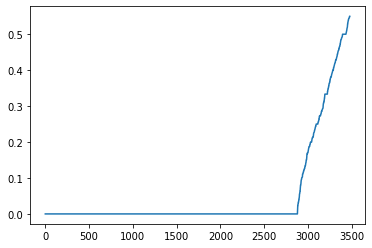

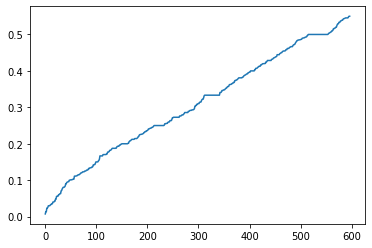

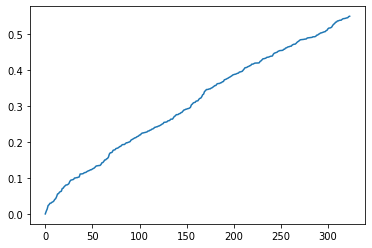

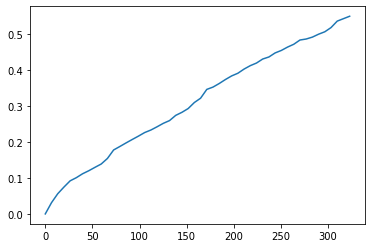

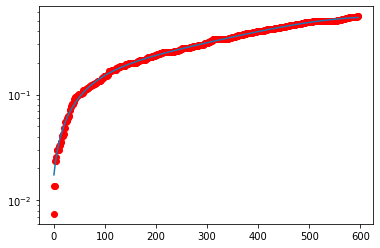

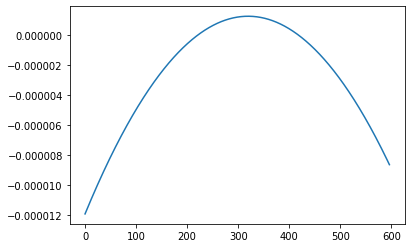

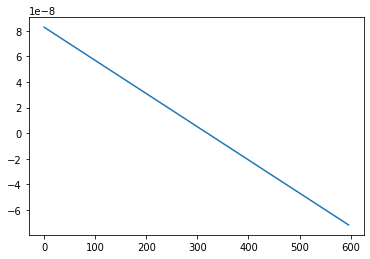

319.3169880709839
Eps = 0.3333333333333333


In [568]:
# 0, 610, 1418
chosen_label = 1418

n = len(valid_elems)

cl_len = len(clusters[chosen_label])
subdists = np.zeros((cl_len, cl_len))
sub_elems_inds = clusters[chosen_label].copy()

for i in tqdm_notebook(range(len(sub_elems_inds))):
    for j in range(len(sub_elems_inds)):
        subdists[i][j] = dists_raw_to_3gram_np[sub_elems_inds[i]][sub_elems_inds[j]]
        
knn_dists(subdists, 2)


In [569]:
# 0.7, 0.55,  0.15
tufano_clustering2 = sklearn.cluster.DBSCAN(eps=0.15, 
                                           min_samples=2, 
                                           metric='precomputed').fit(subdists)

In [570]:
clusters2 = collections.defaultdict(list)
to_label2 = collections.defaultdict(str)

for i in range(len(tufano_clustering2.labels_)):
    clr = tufano_clustering2.labels_[i]
    clusters2[clr].append(sub_elems_inds[i])
    to_label2[i] = clr

In [571]:
print(len(clusters2))
print(len(clusters2[-1]) / len(sub_elems_inds) * 100)

262
14.199482609945385


In [572]:
sorted_clusters_for_raw2 = sorted(clusters2, 
                                  key=lambda clr: len(clusters2[clr]), 
                                  reverse=True)

In [573]:
print("NUM CLUSTERS:", len(sorted_clusters_for_raw2), '\n')
lens = []

more_than_10 = 0

for clr in sorted_clusters_for_raw2:
    if clr == -1:
        print("Outliers")
    else:
        lens.append(len(clusters2[clr]))
    
    if len(clusters2[clr]) >= 10:
        more_than_10 += 1
    
    print("Cluster size:", len(clusters2[clr]))
    print("Cluster label:", clr)
    
    subs = []
    for ind in clusters2[clr][:10]:
        subs.append(valid_elems[ind])
    print(subs)
    print()
    
print(more_than_10)

NUM CLUSTERS: 262 

Outliers
Cluster size: 494
Cluster label: -1
['26', '30', '31', '32', '64', '66', '117', '222', '223', '225']

Cluster size: 464
Cluster label: 3
['44', '152', '158', '173', '210', '247', '283', '303', '307', '331']

Cluster size: 216
Cluster label: 14
['169', '208', '1431', '1436', '1439', '1441', '1442', '1478', '1479', '1532']

Cluster size: 165
Cluster label: 19
['384', '496', '636', '680', '707', '1097', '1103', '2175', '2576', '2732']

Cluster size: 145
Cluster label: 2
['43', '63', '107', '132', '134', '149', '156', '801', '835', '837']

Cluster size: 116
Cluster label: 5
['53', '224', '2707', '3973', '3974', '3981', '8705', '8706', '8707', '8708']

Cluster size: 109
Cluster label: 32
['1520', '4470', '8392', '8854', '10039', '16157', '16391', '16394', '16448', '16449']

Cluster size: 86
Cluster label: 10
['91', '97', '112', '133', '591', '821', '836', '857', '957', '976']

Cluster size: 74
Cluster label: 7
['56', '77', '88', '93', '94', '95', '108', '110', '

In [574]:
len(sub_elems_inds)

3479

In [575]:
del clusters[chosen_label]

In [576]:
max_label = np.array(list(clusters.keys())).max()
max_label

2189

In [577]:
for cl in list(clusters2.keys()):
    if cl != -1:
        clusters[max_label + 1 + cl] = clusters2[cl].copy()

In [578]:
for elem_ind in clusters2[-1]:
    clusters[-1].append(elem_ind)

In [579]:
#len(clusters[chosen_label])

0

In [580]:
#len(clusters[1418])

0

In [581]:
len(clusters[-1]) / n * 100

30.51257253384913

In [613]:
del clusters[1418]

In [614]:
labeled_outliers = []
labeled_inliers = []
inliers_labels = []

for cl in clusters.keys():
    if cl == -1:
        for elem_ind in clusters[cl]:
            label_path = DATASET_PATH + "/" + valid_elems[elem_ind] + "/" + "labeledID.java"
            if os.path.exists(label_path):
                labeled_outliers.append(elem_ind)
        continue
    
    for elem_ind in clusters[cl]:
        label_path = DATASET_PATH + "/" + valid_elems[elem_ind] + "/" + "labeledID.java"
        if os.path.exists(label_path):
            labeled_inliers.append(elem_ind)
            inliers_labels.append(cl)

'''
for i in range(len(valid_elems)):
    label_path = DATASET_PATH + "/" + valid_elems[i] + "/" + "labeledID.java"
    if os.path.exists(label_path):
        labeled_inliers.append(i)
'''

'\nfor i in range(len(valid_elems)):\n    label_path = DATASET_PATH + "/" + valid_elems[i] + "/" + "labeledID.java"\n    if os.path.exists(label_path):\n        labeled_inliers.append(i)\n'

In [615]:
len(labeled_outliers) + len(labeled_inliers)

632

In [616]:
len(labeled_outliers) / 632 * 100 

10.601265822784809

In [617]:
LABELED_PATH = "/Users/aliscafo/Documents/ALINA/WORK/SPbAU/thesis/CodeDiffEditScripts/TufanoDataset"

before_labels = []
after_labels = []

for i in range(len(labeled_inliers)):
    ind = labeled_inliers[i]
    
    ref_path = DATASET_PATH + "/" + valid_elems[ind] + "/" + "labeledID.java"
    ref_file = open(ref_path, "r")
    ref = ref_file.read()
    ref_file.close()
    
    label_path = LABELED_PATH + "/" + ref + "/" + "final_label.txt"
    if not os.path.exists(label_path):
        label_path = LABELED_PATH + "/" + ref + "/" + "label.txt"
        
    label_file = open(label_path, "r")
    label = label_file.read()
    label_file.close()
    
    before_labels.append(label)
    after_labels.append(inliers_labels[i])

In [619]:
adj_rand = 0

tp = 0
tn = 0
fp = 0
fn = 0

for i in range(len(labeled_inliers)):
    for j in range(len(labeled_inliers)):
        if before_labels[i] == "unclear" or before_labels[j] == "unclear":
            continue
            
        if i < j:
            if before_labels[i] == before_labels[j]:
                if after_labels[i] == after_labels[j]:
                    tp += 1
                else:
                    fp += 1
            else:
                if after_labels[i] == after_labels[j]:
                    tn += 1
                else:
                    fn += 1

                    
print(tp, tn, fp, fn)     
#print(tp, tn, fp, fn)
print((tp + fn) / (tp + tn + fp + fn))
print(tp / (tp + tn + fp))


2143 2283 7457 145758
0.938214043300918
0.18034166456282083


In [620]:
sorted_clusters_for_raw = sorted(clusters, 
                                  key=lambda clr: len(clusters[clr]), 
                                  reverse=True)

In [621]:
for cl in sorted_clusters_for_raw:
    print(cl, len(clusters[cl]))

-1 6941
1423 1186
1420 973
1417 528
2193 464
1668 382
1419 231
1443 218
2204 216
1455 203
2209 165
2192 145
1426 142
1494 125
1449 116
2195 116
2222 109
1248 87
2200 86
692 82
2197 74
2110 73
1875 66
2194 57
617 56
656 56
1436 50
1719 45
2196 45
1527 44
1421 43
647 42
1488 42
2219 42
2218 41
2293 41
1492 39
2190 39
1489 36
1460 35
1467 35
1610 33
2213 33
2248 33
2284 33
912 32
2202 32
2206 32
1850 31
1461 30
2208 29
1485 27
2244 27
1514 26
1432 25
1444 25
1501 25
1647 25
2212 25
1425 24
1454 23
1568 23
1345 22
2226 22
62 21
646 21
1755 21
2207 21
2300 21
2346 21
2347 21
112 20
896 20
1511 20
1540 20
1572 20
1601 20
1614 20
1722 20
2214 20
270 19
1523 19
1594 19
1753 19
1496 18
1525 18
1660 18
2259 18
2351 18
629 17
705 17
1459 17
1570 17
1651 17
2058 17
81 16
615 16
948 16
1470 16
1712 16
1772 16
1807 16
2017 16
2120 16
2135 16
2308 16
2357 16
1447 15
1465 15
1587 15
1599 15
1669 15
1698 15
1717 15
2011 15
2299 15
2450 15
9 14
83 14
650 14
726 14
1275 14
1865 14
1882 14
2111 14
2277 14

812 2
813 2
815 2
816 2
817 2
818 2
820 2
821 2
822 2
824 2
826 2
828 2
829 2
830 2
831 2
836 2
837 2
838 2
840 2
841 2
842 2
843 2
844 2
845 2
846 2
849 2
852 2
854 2
856 2
857 2
858 2
859 2
860 2
862 2
863 2
865 2
867 2
871 2
872 2
874 2
875 2
877 2
878 2
879 2
881 2
882 2
884 2
885 2
892 2
895 2
898 2
899 2
900 2
901 2
904 2
905 2
906 2
907 2
908 2
913 2
914 2
915 2
918 2
921 2
922 2
924 2
925 2
927 2
929 2
931 2
933 2
937 2
939 2
940 2
942 2
945 2
946 2
953 2
956 2
957 2
958 2
959 2
964 2
965 2
967 2
973 2
975 2
976 2
978 2
979 2
980 2
981 2
985 2
987 2
988 2
989 2
990 2
992 2
994 2
995 2
996 2
998 2
999 2
1000 2
1002 2
1006 2
1008 2
1011 2
1012 2
1014 2
1015 2
1016 2
1017 2
1018 2
1019 2
1020 2
1022 2
1025 2
1026 2
1028 2
1036 2
1038 2
1040 2
1041 2
1042 2
1043 2
1045 2
1047 2
1048 2
1050 2
1052 2
1053 2
1054 2
1055 2
1056 2
1059 2
1060 2
1061 2
1062 2
1063 2
1064 2
1066 2
1067 2
1070 2
1072 2
1073 2
1074 2
1075 2
1079 2
1082 2
1084 2
1086 2
1088 2
1093 2
1094 2
1095 2
1097 2
1098

In [622]:
file_clusters = open("/Volumes/Seagate/Alina/raw_tufano_clusters_3gram_split-big.txt", "w")

file_clusters.write("NUM CLUSTERS: " + str(len(sorted_clusters_for_raw)) + '\n\n')

num_cluster = 1
lens = []

for clr in tqdm_notebook(sorted_clusters_for_raw):
    file_clusters.write("Cluster " + str(num_cluster) + "\n")
    num_cluster += 1
    
    if clr == -1:
        file_clusters.write("Outliers\n")
    file_clusters.write("Cluster size: " + str(len(clusters[clr])) + "\n")
    
    if clr != -1:
        lens.append(len(clusters[clr]))
    
    elems = []
    for ind in clusters[clr]:
        elems.append(valid_elems[ind])
    
    file_clusters.write(str(elems) + "\n")
    file_clusters.write("\n")
    
file_clusters.close()

In [623]:
lens = np.array(lens)

In [639]:
print(np.median(np.unique(lens)[:45]))
print(np.unique(lens).mean())

24.0
106.2063492063492


In [636]:
np.unique(lens)

array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33, 35, 36, 39,
       41, 42, 43, 44, 45, 50, 56, 57, 66, 73, 74])

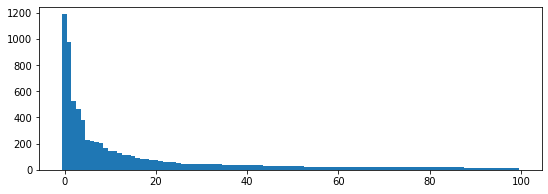

In [628]:
fig, ax = plt.subplots(1, 1, figsize=(9, 3))
ax.bar(range(len(lens[:100])), lens[:100], align="center", width=1)

#ax.format_coord = format_coord
plt.show()

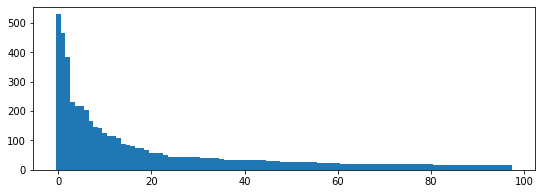

In [629]:
lens = np.array(lens)

fig, ax = plt.subplots(1, 1, figsize=(9, 3))
ax.bar(range(len(lens[2:100])), lens[2:100], align="center", width=1)

#ax.format_coord = format_coord
plt.show()

In [594]:
print(lens.mean())
print(np.median(lens))


6.449204406364749
2.0


In [532]:
print(lens.max())
distr = np.zeros((lens.max() + 1))

for elem in lens:
    distr[elem] += 1
    

1186


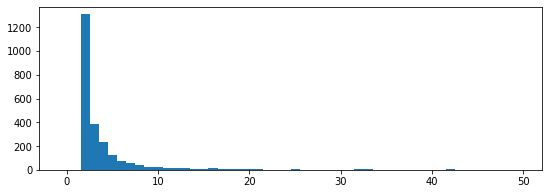

In [533]:
fig, ax = plt.subplots(1, 1, figsize=(9, 3))
ax.bar(range(len(distr[:50])), distr[:50], align="center", width=1)

#ax.format_coord = format_coord
plt.show()

In [ ]:
# Recursive clustering

In [ ]:
# tytytyty

In [ ]:
#choose_threshold(dists_raw_to_5gram_np)

In [60]:
prob1 = get_dists_optimized(concat_hists_to_5gram_raw_np[:20], 
                                         canberra_metric, concat_hists_len_to_5gram_raw)

prob2 = get_dists(concat_hists_to_5gram_raw_np[:20], 
                                         canberra_metric_optimized, concat_hists_len_to_5gram_raw)

(prob1 - prob2).sum()

0.0

In [61]:
prob1

array([[0.        , 1.        , 0.99492219, 1.        , 0.98557692,
        0.99356913, 1.        , 1.        , 0.99166667, 0.99919775,
        1.        , 0.97497076, 1.        , 1.        , 1.        ,
        1.        , 0.97969543, 1.        , 0.99600798, 0.99315955],
       [1.        , 0.        , 0.98621397, 0.98333333, 0.99588477,
        0.99465649, 1.        , 1.        , 1.        , 0.99673053,
        0.9828495 , 1.        , 1.        , 1.        , 1.        ,
        1.        , 1.        , 1.        , 0.98678161, 0.99700214],
       [0.99492219, 0.98621397, 0.        , 0.99630096, 0.99273756,
        0.97869304, 0.99957735, 0.99957735, 0.99017768, 0.98662748,
        0.97744009, 0.99366626, 0.99957735, 0.99957735, 0.99957735,
        0.99620823, 0.99869893, 0.99958045, 0.99235896, 0.98043917],
       [1.        , 0.98333333, 0.99630096, 0.        , 0.96057348,
        0.98769231, 1.        , 1.        , 0.9972973 , 0.99845815,
        0.99987761, 1.        , 1.        , 1

In [36]:
prob1[3][5] = 0.7

In [649]:
patterns_path = "/Volumes/Seagate/Alina/RawTufanoDataset"
patterns_dir = os.fsencode(patterns_path)
len(os.listdir(patterns_dir))


100037

In [1075]:
a = ["UPD 42@@", 
     "INS 25@@ to 8@@ at 2", 
     "INS 27@@ to 25@@ at 0", 
     "MOV 21@@ to 25@@ at 1", 
     "UPD 42@@",
     "UPD 42@@", 
     "INS 42@@ to 27@@ at 0",
     "INS 33@@ to 27@@ at 1",
     "UPD 42@@"]

In [1076]:
b = ["UPD 42@@",
     "INS 25@@ to 8@@ at 1",
     "INS 27@@ to 25@@ at 0",
     "MOV 21@@ to 25@@ at 1",
     "UPD 42@@",
     "INS 42@@ to 27@@ at 0",
     "INS 33@@ to 27@@ at 1",
     "UPD 42@@",
     "UPD 42@@"]

In [1078]:
c = ["UPD 42@@",
     "INS 25@@ to 8@@ at 0",
     "INS 27@@ to 25@@ at 0",
     "MOV 21@@ to 25@@ at 1",
     "INS 42@@ to 27@@ at 0",
     "INS 33@@ to 27@@ at 1",
     "UPD 42@@",
     "UPD 42@@",
     "UPD 42@@"]

In [1077]:
lcs(a, b)

7

In [1079]:
lcs(a, c)

6

In [1080]:
lcs(b, c)

7

a & c:
   
**UPD 42@@**
INS 25@@ to 8@@ at 2
**INS 27@@ to 25@@ at 0**
**MOV 21@@ to 25@@ at 1**
UPD 42@@
UPD 42@@ 
**INS 42@@ to 27@@ at 0**
**INS 33@@ to 27@@ at 1**
**UPD 42@@**


**UPD 42@@**
INS 25@@ to 8@@ at 0
**INS 27@@ to 25@@ at 0**
**MOV 21@@ to 25@@ at 1**
**INS 42@@ to 27@@ at 0**
**INS 33@@ to 27@@ at 1**
**UPD 42@@**
UPD 42@@
UPD 42@@

In [1082]:
a = ["INS 25@@ to 8@@ at 0",
     "INS 27@@ to 25@@ at 0",
     "MOV 21@@ to 25@@ at 1",
     "INS 42@@ to 27@@ at 0",
     "INS 33@@ to 27@@ at 1",
     "UPD 42@@",
     "UPD 42@@",
     "UPD 42@@",
     "UPD 42@@",]

In [1087]:
b = ["INS 25@@ to 8@@ at 3",
     "INS 27@@ to 25@@ at 0",
     "MOV 21@@ to 25@@ at 1",
     "UPD 42@@",
     "UPD 42@@",
     "UPD 42@@",
     "INS 42@@ to 27@@ at 0",
     "INS 33@@ to 27@@ at 1",
     "UPD 42@@"]

In [1086]:
lcs(a, b)

8

In [631]:
a = np.array([[1, 1, 1, 0, 0], [1, 1, 1, 0, 0], [1, 1, 1, 0, 0], [0, 0, 0, 1, 1], [0, 0, 0, 1, 1]], np.float)
#a = a.flatten()
b = np.array([[1, 1, 0, 0, 0], [1, 1, 0, 0, 0], [0, 0, 1, 1, 1], [0, 0, 1, 1, 1], [0, 0, 1, 1, 1]], np.float)
#b = b.flatten()

#res = a @ b / np.sqrt(np.var(a) * np.var(b))
#print(res.mean())
#res = np.correlate(a, b, 'full')

tr_a = []
for i in range(a.shape[0]):
    for j in range(a.shape[1]):
        #if i >= j:
            tr_a.append(a[i][j])
            
tr_b = []
for i in range(b.shape[0]):
    for j in range(b.shape[1]):
        #if i >= j:
            #print(i, j)
            #print(b[i][j])
            tr_b.append(b[i][j])
            
print(tr_a)
print(tr_b)
            
std_a = statistics.stdev(tr_a)
std_b = statistics.stdev(tr_b)

print(std_a, std_b)

cov_ab = np.cov(tr_a, tr_b)[0, 1]
corr_ab = np.corrcoef(tr_a, tr_b)[0, 1]

print("Correlation:", cov_ab / (std_a * std_b))

print()
print(np.cov(tr_a, tr_b))
print()
print(np.corrcoef(tr_a, tr_b))

[1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0]
[1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0]
0.5099019513592785 0.5099019513592785
Correlation: 0.3589743589743588

[[0.26       0.09333333]
 [0.09333333 0.26      ]]

[[1.         0.35897436]
 [0.35897436 1.        ]]


In [630]:
import statistics


a = [0.8, 0.65, 0.7, 0.55, 0.6, 0.9]
b = [1, 0, 0, 0, 0, 1]

std_a = statistics.stdev(a)
std_b = statistics.stdev(b)

cov_ab = np.cov(a, b)[0, 1]

corr_ab = np.corrcoef(a, b)[0, 1]

cov_ab / (std_a * std_b)

0.8911327886790069

In [173]:
cmap = plt.get_cmap('diYG')

ValueError: Colormap diYG is not recognized. Possible values are: Accent, Accent_r, Blues, Blues_r, BrBG, BrBG_r, BuGn, BuGn_r, BuPu, BuPu_r, CMRmap, CMRmap_r, Dark2, Dark2_r, GnBu, GnBu_r, Greens, Greens_r, Greys, Greys_r, OrRd, OrRd_r, Oranges, Oranges_r, PRGn, PRGn_r, Paired, Paired_r, Pastel1, Pastel1_r, Pastel2, Pastel2_r, PiYG, PiYG_r, PuBu, PuBuGn, PuBuGn_r, PuBu_r, PuOr, PuOr_r, PuRd, PuRd_r, Purples, Purples_r, RdBu, RdBu_r, RdGy, RdGy_r, RdPu, RdPu_r, RdYlBu, RdYlBu_r, RdYlGn, RdYlGn_r, Reds, Reds_r, Set1, Set1_r, Set2, Set2_r, Set3, Set3_r, Spectral, Spectral_r, Wistia, Wistia_r, YlGn, YlGnBu, YlGnBu_r, YlGn_r, YlOrBr, YlOrBr_r, YlOrRd, YlOrRd_r, afmhot, afmhot_r, autumn, autumn_r, binary, binary_r, bone, bone_r, brg, brg_r, bwr, bwr_r, cividis, cividis_r, cool, cool_r, coolwarm, coolwarm_r, copper, copper_r, cubehelix, cubehelix_r, flag, flag_r, gist_earth, gist_earth_r, gist_gray, gist_gray_r, gist_heat, gist_heat_r, gist_ncar, gist_ncar_r, gist_rainbow, gist_rainbow_r, gist_stern, gist_stern_r, gist_yarg, gist_yarg_r, gnuplot, gnuplot2, gnuplot2_r, gnuplot_r, gray, gray_r, hot, hot_r, hsv, hsv_r, inferno, inferno_r, jet, jet_r, magma, magma_r, nipy_spectral, nipy_spectral_r, ocean, ocean_r, pink, pink_r, plasma, plasma_r, prism, prism_r, rainbow, rainbow_r, seismic, seismic_r, spring, spring_r, summer, summer_r, tab10, tab10_r, tab20, tab20_r, tab20b, tab20b_r, tab20c, tab20c_r, terrain, terrain_r, twilight, twilight_r, twilight_shifted, twilight_shifted_r, viridis, viridis_r, winter, winter_r